<a href="https://colab.research.google.com/github/kevinroccapriore/STM-notebooks/blob/main/Adatoms_Co3Sn2S2_v4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<font size = 6> Training deep learning model in PyTorch for adatom finding and classifcation in scanning probe microscopy images </font>

Prepared by Kevin Roccapriore with Maxim Ziatdinov

Last updated: 5.15.20

This notebook demonstrates how to train a simple fully convolutional neural network for a multi-class "semantic" segmentation of atomic images. We are going to use a training set [made of synthetic atomic images](https://colab.research.google.com/github/ziatdinovmax/AtomicImageSimulator/blob/master/GenerateTrainingSet.ipynb).

In [ ]:
#@title Imports
import os
import numpy as np
import cv2
from scipy import ndimage
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.nn.functional as F
from skimage import draw
import matplotlib.gridspec as gridspec
from matplotlib.patches import Rectangle
from skimage.transform import resize
from scipy import fftpack
from sklearn.decomposition import NMF
from sklearn.decomposition import PCA

from scipy.ndimage import gaussian_filter
from scipy.ndimage import maximum_filter
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.cbook import get_sample_data
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

from sklearn.cluster import KMeans
from scipy.cluster.hierarchy import linkage, fcluster, dendrogram
from sklearn import mixture
from sklearn import decomposition

# Reproducibility
np.random.seed(1)
torch.manual_seed(0)
torch.backends.cudnn.deterministic = True

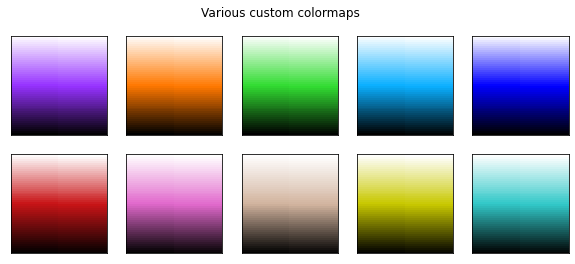

In [ ]:
#@title Functions
size = 512
def gauss2d_atom(x,y,sigma,amp=1,xlen=size,ylen=size,numpix=size):
    xx = np.linspace(0,xlen,numpix)
    yy = np.linspace(0,ylen,numpix)
    mx, my = np.meshgrid(xx,yy)
    return amp*np.exp(-((mx-x)**2+(my-y)**2)/sigma)

def extract_subimages(imgdata, com, d, **kwargs):
    '''Function for cropping images around adatoms'''
    icut = kwargs.get('n')
    if icut == None:
        icut = len(com)
    img_cr_all = np.empty((0, int(d*2), int(d*2)))
    com_ = np.empty((0, 2))
    for i, c in enumerate(com):
        cx = int(np.around(c[0]))
        cy = int(np.around(c[1]))
        img_cr = np.copy(
            imgdata[cx-d:cx+d, cy-d:cy+d])
        if img_cr.shape == (int(d*2), int(d*2)):
            img_cr_all = np.append(img_cr_all, [img_cr], axis=0)
            com_ = np.append(com_, [c], axis=0)
        if i > icut:
            return img_cr_all, com_
    return img_cr_all, com_

def perform_FFT(image):
  "Performs 2D FFT on an image and returns the amplitude"
  FFT0 = fftpack.fft2(image)
  FFT0_shift = fftpack.fftshift(FFT0)
  FFT0_shift_amp_ = np.log(np.abs(FFT0_shift))
  FFT0_shift_amp = (FFT0_shift_amp_ - np.min(FFT0_shift_amp_))/np.ptp(FFT0_shift_amp_)
  return FFT0_shift_amp

def center_crop(image, coordinates, size):
  
  winx, winy = coordinates[1], coordinates[0]
  xlow, xhigh = int(round(winx-size/2)), int(round(winx+size/2))
  ylow, yhigh = int(round(winy-size/2)), int(round(winy+size/2))
  cropped = image[ylow:yhigh, xlow:xhigh]
  return cropped

def center_crop_pad(image, coordinates, size):
  # Pad it directly with same size as half window size 
  # so no matter what coordinate provided (even border coords), it will slice just fine.
  imagepad = np.pad(image, int(size/2)) 
  winx, winy = coordinates[1], coordinates[0]
  xlow, xhigh = int(round(winx)), int(round(winx+size))
  ylow, yhigh = int(round(winy)), int(round(winy+size))
  cropped = imagepad[ylow:yhigh, xlow:xhigh]
  return cropped
  
########################
### Set up colormaps ###
########################

from matplotlib.colors import LinearSegmentedColormap

data1 = np.linspace(0, 1, 2500).reshape((50, 50))

bPw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (150./255,50/255., 1.),(1,1,1)], N=100)
bOw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (1,120./255, 0),(1,1,1)], N=100)
bGw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (50./255,220./255, 50./255),(1,1,1)], N=100)
bBw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (10./255,175/255., 1.),(1,1,1)], N=100)
bDBw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (0/255,0./255, 255/255),(1,1,1)], N=100)
bRw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (200./255,20/255., 20/225.),(1,1,1)], N=100)
bPiw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (225./255,105/255., 180/225.),(1,1,1)], N=100)
bBrw= LinearSegmentedColormap.from_list('list', [(0, 0, 0), (210./255,180/255., 140/225.),(1,1,1)], N=100)
bYw= LinearSegmentedColormap.from_list('list', [(0, 0, 0), (200./255,200/255., 0/225.),(1,1,1)], N=100)
bLGw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (50./255, 200/255, 200/255),(1,1,1)], N=100)

cmaps = [bPw,bOw,bGw,bBw,bDBw,bRw,bPiw,bBrw,bYw,bLGw]

rows = int(np.ceil(float(len(cmaps))/5))
cols = int(np.ceil(float(len(cmaps))/rows))
gs1 = gridspec.GridSpec(rows, cols)
fig = plt.figure(figsize = (2*cols, 2*(1+rows//2)))
fig.suptitle('Various custom colormaps')
for i in range(len(cmaps)):
    ax1 = fig.add_subplot(gs1[i])
    ax1.pcolormesh(data1,cmap=cmaps.pop(0))
    plt.setp([ax1], xticks = [], yticks =[])

Load training data. Here we use data prepared using [this notebook](https://colab.research.google.com/github/ziatdinovmax/AtomicImageSimulator/blob/master/GenerateTrainingSet.ipynb) (if you have your training data stored on a Google drive, mount your drive first or use a ```gdown``` command to download it from your drive into the notebook).

In [ ]:
%%capture
# Import training and test data sets

!gdown https://drive.google.com/uc?id=1-NLj3AMTsAWeVqZF_AzFEA_ER4fdp6hn
!gdown https://drive.google.com/uc?id=1-VelllAyIqxzRc_pJq_D3HASqzRQszVs
!gdown https://drive.google.com/uc?id=1-SNUgHxhVdpL_so7CWfmeT_K-9l14Bca
!gdown https://drive.google.com/uc?id=1-VklTL6HRVlk_0KVzcZNjfKthX4c9jnY

In [ ]:
# Load data (currently this loads the gdown objects from previous cell)

images_all = np.load('X_train.npy')
labels_all_ = np.load('y_train.npy')
images_all_test = np.load('X_test.npy')
labels_all_test_ = np.load('y_test.npy')

Reshape for PyTorch tensors

In [ ]:
labels_all = np.reshape(labels_all_, (labels_all_.shape[0], labels_all_.shape[1], labels_all_.shape[3], labels_all_.shape[4]))
labels_all_test = np.reshape(labels_all_test_, (labels_all_test_.shape[0], labels_all_test_.shape[1], labels_all_test_.shape[3], labels_all_test_.shape[4]))

print(images_all.shape)
print(labels_all.shape,"\n")
print(images_all_test.shape)
print(labels_all_test.shape)

(75, 49, 1, 64, 64)
(75, 49, 64, 64) 

(25, 49, 1, 64, 64)
(25, 49, 64, 64)


Notice we have 75 training batches (with 49 images in each batch), and 25 test batches(also with 49 images in each batch).

* This could be improved by increasing total number of images
* Let's check some random images and their labels (re-run cell to continue to randomize):

Text(0.5, 1.0, 'Labels')

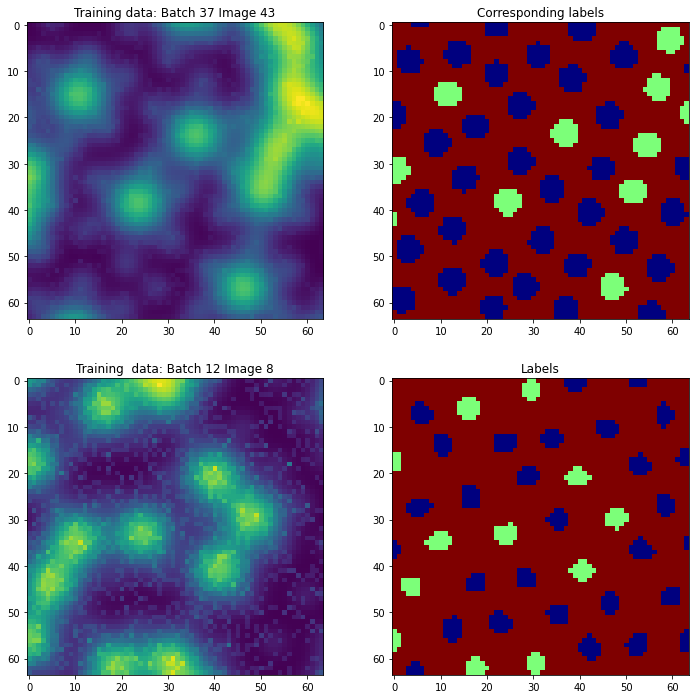

In [ ]:
f,a = plt.subplots(2,2,figsize=(12,12))

i1, j1 = np.random.randint(0,images_all.shape[0]), np.random.randint(0,images_all.shape[1])
i2, j2 = np.random.randint(0,images_all_test.shape[0]), np.random.randint(0,images_all_test.shape[1])

a[0,0].imshow(images_all[i1,j1,0])
a[0,1].imshow(labels_all[i1,j1], cmap = 'jet')
a[1,0].imshow(images_all_test[i2,j2,0])
a[1,1].imshow(labels_all_test[i2,j2], cmap = 'jet')

a[0,0].set_title("Training data: Batch {} Image {}".format(i1,j1))
a[0,1].set_title("Corresponding labels")
a[1,0].set_title("Training  data: Batch {} Image {}".format(i2,j2))
a[1,1].set_title("Labels")

We will construct a very simple encoder-decoder type of fully convolutional neural network. It will three main building blocks: block of convolutional layers activated by ReLU function, max-pooling, and upsampling block. Below we define convolutional and upsampling blocks.

In [ ]:
class conv2dblock(nn.Module):
    '''
    Creates a block consisting of convolutional
    layer, leaky relu and (optionally) dropout and
    batch normalization
    '''
    def __init__(self, nb_layers, input_channels, output_channels,
                 kernel_size=3, stride=1, padding=1, use_batchnorm=False,
                 lrelu_a=0.01, dropout_=0):
        '''Initializes module parameters'''
        super(conv2dblock, self).__init__()
        block = []
        for idx in range(nb_layers):
            input_channels = output_channels if idx > 0 else input_channels
            block.append(nn.Conv2d(input_channels,
                                   output_channels,
                                   kernel_size=kernel_size,
                                   stride=stride,
                                   padding=padding))
            if dropout_ > 0:
                block.append(nn.Dropout(dropout_))
            block.append(nn.LeakyReLU(negative_slope=lrelu_a))
            if use_batchnorm:
                block.append(nn.BatchNorm2d(output_channels))
        self.block = nn.Sequential(*block)

    def forward(self, x):
        '''Forward path'''
        output = self.block(x)
        return output


class upsample_block(nn.Module):
    '''
    Defines upsampling block performed using
    bilinear interpolation followed by 1-by-1
    convolution
    '''
    def __init__(self, input_channels, output_channels,
                 mode='interpolate', kernel_size=1,
                 stride=1, padding=0):
        '''Initalizes model parameters'''
        super(upsample_block, self).__init__()
        self.conv = nn.Conv2d(
            input_channels, output_channels,
            kernel_size=kernel_size,
            stride=stride, padding=padding)

    def forward(self, x):
        '''Defines a forward path'''
        x = F.interpolate(
            x, scale_factor=2,
            mode='bilinear', align_corners=False)
        return self.conv(x) 

We now construct our neural network. Notice that we are using an object-oriented way of defining our neural network as it gives more flexibility. For example, we can easily modify the code below to add skip connections between contracting and expanding paths, which is not possible to do if we define our neural network using 'Sequential' module.

In [ ]:
class atomnet(nn.Module):
    def __init__(self, nb_classes=3, nb_filters=25): 
        '''
        Builds  a fully convolutional neural network model
        (encoder-bottleneck-decoder type of architecture)
        Args:
            nb_classes: number of classes in the data
            nb_filters: number of filters in the first convolutional layer
        '''
        super(atomnet, self).__init__()
        self.pxac = 'softmax' if nb_classes > 1 else 'sigmoid'
        self.c1 = conv2dblock(1, 1, nb_filters)
        self.c2 = conv2dblock(1, nb_filters, nb_filters)
        self.c3 = conv2dblock(1, nb_filters, nb_filters)
        self.px = nn.Conv2d(nb_filters, nb_classes, 1, 1, 0)
               
    def forward(self, x):
        '''Forward path'''
        # Contracting path
        x = self.c3(self.c2(self.c1(x)))
        px = self.px(x)
        if self.pxac == 'sigmoid':
            out = torch.sigmoid(px)
        elif self.pxac == 'softmax':
            out = F.log_softmax(px, dim=1)
        return out

Next we initalize our model and move it to GPU. We also define a loss function and a weight optimizer. Notice that for multiclass sematic segmentation problems, the input batch with images has ```(n_samples, 1, height, width)``` dimensions and the neural network output has```(n_samples, n_classes, height, width)``` dimensions. However, the batch with labels (aka target aka ground truth) has ```(n_samples, height, width)``` dimensions, because of how the cross-entropy loss is calculated in PyTorch (see [here](https://pytorch.org/docs/stable/nn.html#nllloss)). This means that if you have multiple channels corresponding to different classes in your labeled data, you'll need to [map your target classes to tensor indices](https://discuss.pytorch.org/t/multi-class-cross-entropy-loss-function-implementation-in-pytorch/19077/20). Here, we already did this for our labeled data [during the training data preparation stage](https://colab.research.google.com/github/ziatdinovmax/AtomicImageSimulator/blob/master/GenerateTrainingSet.ipynb) and so everything is ready for training.

In [ ]:
# Initialize a model
model = atomnet(nb_filters=16)

# move our model to GPU
model.cuda()

# specify loss function
criterion = torch.nn.NLLLoss()

# specify optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=4e-3)

Finally, we train our model:

In [ ]:
%%time

batch_size = 49 # number of images in one batch
epochs = 5000 # Number of epochs (here 1 epoch == 1 batch)
print_loss = 100 # print loss every m-th epoch.
savedir = './' # dir to save results

# Generate sequence of random numbers for batch selection during training/testing
batch_ridx = [np.random.randint(0, len(images_all)) for _ in range(epochs)]
batch_ridx_t = [np.random.randint(0, len(images_all_test)) for _ in range(epochs)]
# Start training
train_losses, test_losses = [], []
for e in range(epochs):  
    model.train()
    running_loss = 0
    # Generate batch of training images with corresponding ground truth
    images = images_all[batch_ridx[e]][:batch_size]
    labels = labels_all[batch_ridx[e]][:batch_size]
    # Transform images and ground truth to torch tensors and move to GPU
    images = torch.from_numpy(images).float()
    labels = torch.from_numpy(labels).long()
    images, labels = images.cuda(), labels.cuda() 
    # Forward --> Backward --> Optimize
    optimizer.zero_grad() 
    prob = model.forward(images)
    loss = criterion(prob, labels)
    running_loss += loss.item()
    loss.backward()
    optimizer.step()
    train_losses.append(loss.item())
    # Now test the current model state using test data
    model.eval()
    batch_num = np.random.randint(0, len(images_all_test))
    images_ = images_all_test[batch_ridx_t[e]][:batch_size]
    labels_ = labels_all_test[batch_ridx_t[e]][:batch_size]
    images_ = torch.from_numpy(images_).float()
    labels_ = torch.from_numpy(labels_).long()
    images_, labels_ = images_.cuda(), labels_.cuda() 
    prob = model.forward(images_)
    loss = criterion(prob, labels_)
    test_losses.append(loss.item())
    # Print statistics
    if e == 0 or (e+1) % print_loss == 0:
        print('Epoch {} .... Training loss: {} .... Test loss: {}'.format(
            e+1, np.around(train_losses[-1], 8), np.around(test_losses[-1], 8))
        )
    # Save the best model weights
    if e > 100 and test_losses[-1] < min(test_losses[: -1]):
        torch.save(model.state_dict(), 
                   os.path.join(savedir, 'atomsegnet-1-best_weights.pt'))
# Save final weights
torch.save(model.state_dict(), 
           os.path.join(savedir, 'atomsegnet-1-final_weights.pt'))

Epoch 1 .... Training loss: 1.02325809 .... Test loss: 0.99689245
Epoch 100 .... Training loss: 0.46021956 .... Test loss: 0.61624974
Epoch 200 .... Training loss: 0.36614481 .... Test loss: 0.46478283
Epoch 300 .... Training loss: 0.67283118 .... Test loss: 0.35570911
Epoch 400 .... Training loss: 0.4738377 .... Test loss: 0.41872504
Epoch 500 .... Training loss: 0.32748032 .... Test loss: 0.22552191
Epoch 600 .... Training loss: 0.34849623 .... Test loss: 0.33121666
Epoch 700 .... Training loss: 0.26286587 .... Test loss: 0.40544927
Epoch 800 .... Training loss: 0.28748521 .... Test loss: 0.2815825
Epoch 900 .... Training loss: 0.28243774 .... Test loss: 0.68609196
Epoch 1000 .... Training loss: 0.28197676 .... Test loss: 0.28715113
Epoch 1100 .... Training loss: 0.26431596 .... Test loss: 0.28764787
Epoch 1200 .... Training loss: 0.41366687 .... Test loss: 0.26847005
Epoch 1300 .... Training loss: 0.25322637 .... Test loss: 0.25493905
Epoch 1400 .... Training loss: 0.25831118 .... T

Plot train and test losses:

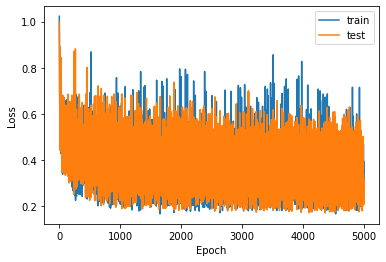

In [ ]:
plt.plot(train_losses, label='train')
plt.plot(test_losses, label='test')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

* While the loss does not appear wonderful, this is likely due to the pixel sizes of the 'atoms' and labels, as well as how close they can be to one another (as is the case in the experimental data).

* Will try to think of how to improve, however, let's evaluate the performance on the test data:

Evaluate model performance on the test data:

Image 45/49 in Batch 13/25


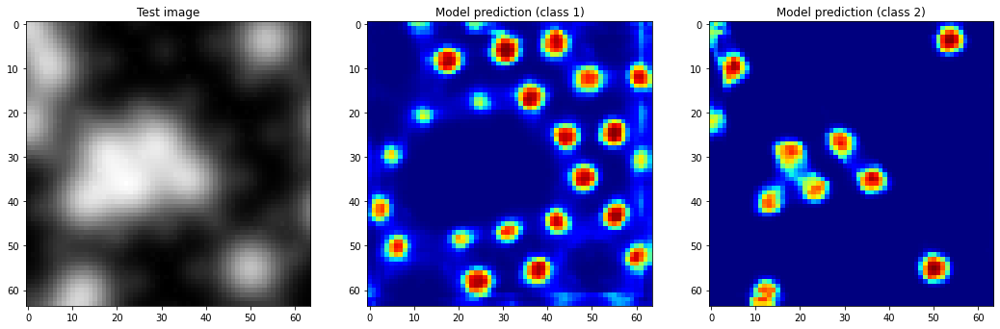

In [ ]:
k, im = np.random.randint(0,25), np.random.randint(0,49)

test_img = images_all_test[k][im]
# Convert to 4D tensor (required, even if it is a single image)
test_img = test_img[np.newaxis, ...]
# Convert to pytorch format
test_img_ = torch.from_numpy(test_img).float().cuda()
# make a prediction
prediction = model.forward(test_img_)
prediction = torch.exp(prediction).cpu().detach().numpy() # that's because we used log_softmax
# plot results
_, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 6))
ax1.imshow(test_img[0,0], cmap='gray')
ax2.imshow(prediction[0,0], cmap='jet')
ax3.imshow(prediction[0,1], cmap='jet')
ax1.set_title('Test image')
ax2.set_title('Model prediction (class 1)')
ax3.set_title('Model prediction (class 2)')

print('Image {}/{} in Batch {}/{}'.format(im,images_all_test.shape[1],k,images_all_test.shape[0]))

We now have a multichannel output of a neural network where each channel corresponds to a different atomic class (+ background). In each channel, we have a set of blobs on a uniform background whose centers correspond to atomic centers (if the network was trained properly). What we have to do now is to convert pixel data from the network output into coordinate data. Below we define a class that will do it.

In [ ]:
class FindAtoms:
    '''
    Transforms pixel data from NN output into coordinate data
    '''
    def __init__(self, nn_output,
                 threshold=0.75, dist_edge=5,
                 dim_order='channel_first'):
        
        if nn_output.shape[-1] == 1: # Add background class for 1-channel data
            nn_output_b = 1 - nn_output
            nn_output = np.concatenate(
                (nn_output[:, :, :, None], nn_output[:, :, :, None]), axis=3)
        if dim_order == 'channel_first':  # make channel dim the last dim
            nn_output = np.transpose(nn_output, (0, 2, 3, 1))
        elif dim_order == 'channel_last':
            pass
        else:
            raise NotImplementedError(
                'For dim_order, use "channel_first" (e.g. pytorch)',
                 'or "channel_last" (e.g. tensorflow)')
        self.nn_output = nn_output
        self.threshold = threshold
        self.dist_edge = dist_edge
                       
    def get_all_coordinates(self):
        '''Extract all atomic coordinates in image
        via CoM method & store data as a dictionary
        (key: frame number)'''
        
        def find_com(image_data):
            '''Find atoms via center of mass methods'''
            labels, nlabels = ndimage.label(image_data)
            coordinates = np.array(
                ndimage.center_of_mass(
                    image_data, labels, np.arange(nlabels) + 1))
            coordinates = coordinates.reshape(coordinates.shape[0], 2)
            return coordinates

        d_coord = {}
        for i, decoded_img in enumerate(self.nn_output):
            coordinates = np.empty((0, 2))
            category = np.empty((0, 1))
            # we assume that class backgrpund is always the last one
            for ch in range(decoded_img.shape[2]-1):
                _, decoded_img_c = cv2.threshold(
                    decoded_img[:, :, ch], self.threshold, 1, cv2.THRESH_BINARY)
                coord = find_com(decoded_img_c)
                coord_ch = self.rem_edge_coord(coord)
                category_ch = np.zeros((coord_ch.shape[0], 1)) + ch
                coordinates = np.append(coordinates, coord_ch, axis=0)
                category = np.append(category, category_ch, axis=0)
            d_coord[i] = np.concatenate((coordinates, category), axis=1)
        return d_coord

    def rem_edge_coord(self, coordinates):
        '''Remove coordinates at the image edges'''

        def coord_edges(coordinates, w, h):
            return [coordinates[0] > w - self.dist_edge,
                    coordinates[0] < self.dist_edge,
                    coordinates[1] > h - self.dist_edge,
                    coordinates[1] < self.dist_edge]

        w, h = self.nn_output.shape[1:3]
        coord_to_rem = [
                        idx for idx, c in enumerate(coordinates) 
                        if any(coord_edges(c, w, h))
                        ]
        coord_to_rem = np.array(coord_to_rem, dtype=int)
        coordinates = np.delete(coordinates, coord_to_rem, axis=0)
        return coordinates

Let's now transform our NN prediction on a test image to coordinates:

In [ ]:
coordinates_im = FindAtoms(prediction).get_all_coordinates()

Plot results:

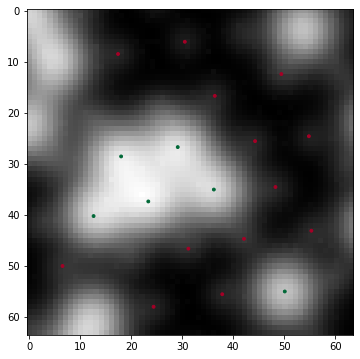

In [ ]:
y, x, c = coordinates_im[0].T
plt.figure(figsize=(6, 6))
plt.imshow(test_img[0,0], cmap='gray')
plt.scatter(x, y, c=c, cmap='RdYlGn', s=8);

# Using trained model:
* Let's use our model on the experimental STS/SPM data:

In [ ]:
!gdown https://drive.google.com/uc?id=1Vkie1YR0kqMIpo3exUwyCagPY8ktI1R5
!gdown https://drive.google.com/uc?id=1yZwv-AIHyVL5Gx6W3iPRVzwLtH9_oD1h
!gdown https://drive.google.com/uc?id=1QzKJXMRJcENgn1nB9dLDUcP6cnZlOT6c

Downloading...
From: https://drive.google.com/uc?id=1Vkie1YR0kqMIpo3exUwyCagPY8ktI1R5
To: /content/z_axis1.npy
100% 932/932 [00:00<00:00, 1.51MB/s]
Downloading...
From: https://drive.google.com/uc?id=1yZwv-AIHyVL5Gx6W3iPRVzwLtH9_oD1h
To: /content/cits_1.npy
13.2MB [00:00, 80.4MB/s]
Downloading...
From: https://drive.google.com/uc?id=1QzKJXMRJcENgn1nB9dLDUcP6cnZlOT6c
To: /content/topography_1.npy
100% 65.7k/65.7k [00:00<00:00, 23.0MB/s]


In [ ]:
exp_topo = np.load('topography_1.npy')
exp_cits = np.load('cits_1.npy')
z_axis = np.load('z_axis1.npy')

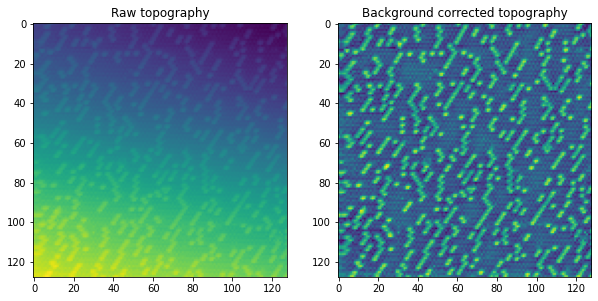

In [ ]:
sigma = 3

filtered = ndimage.gaussian_filter(exp_topo,sigma=sigma)
topo_f = exp_topo - filtered
topo_f_n = (topo_f - np.min(topo_f)) / np.ptp(topo_f)

plt.figure(figsize=(10,5))
gs = gridspec.GridSpec(1,2)
ax1 = plt.subplot(gs[0])
ax2 = plt.subplot(gs[1])
ax1.imshow(exp_topo)
ax2.imshow(topo_f_n)
ax1.set_title('Raw topography')
ax2.set_title('Background corrected topography');

## DOWNsampling data (w.i.p.): 
* testing how poor of resolution we can get away with (in the extreme limits, maybe the NN far outperforms anything else)

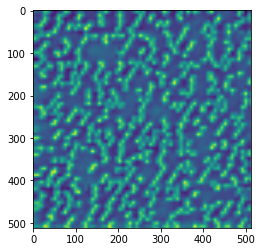

In [ ]:
plt.imshow(topo_f_n)

down_samp = resize(topo_f_n, (64,64))
plt.imshow(down_samp)

down_samp_upped = resize(down_samp, (512,512))
plt.imshow(down_samp_upped)

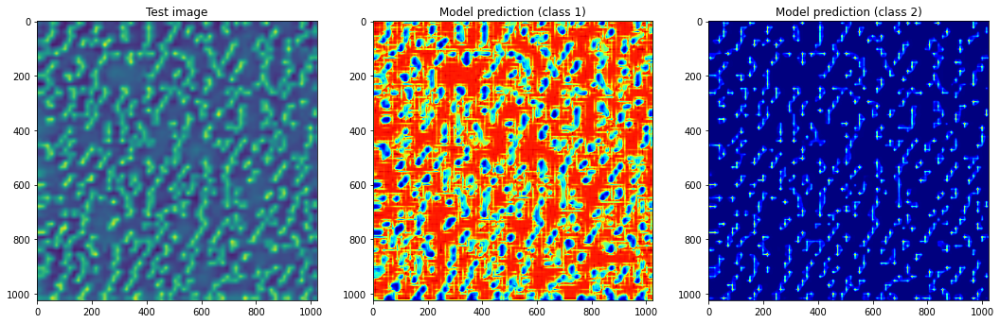

In [ ]:
resized = 1024

test_img0 = down_samp_upped.reshape((1,512,512))
test_img = resize(test_img0,(1,resized,resized))

# Convert to 4D tensor (required, even if it is a single image)
test_img = test_img[np.newaxis, ...]
# Convert to pytorch format
test_img_ = torch.from_numpy(test_img).float().cuda()
# make a prediction
prediction = model.forward(test_img_)
prediction = torch.exp(prediction).cpu().detach().numpy() # that's because we used log_softmax
# plot results
_, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 6))
ax1.imshow(test_img[0,0],interpolation = 'gaussian')
ax2.imshow(prediction[0,0], cmap='jet')
ax3.imshow(prediction[0,1], cmap='jet')
ax1.set_title('Test image')
ax2.set_title('Model prediction (class 1)')
ax3.set_title('Model prediction (class 2)');

## Modify the size of the data
* pixel per atom may be different than was used in the training, so we need to get close to how it was trained by simply resizing the experimental image

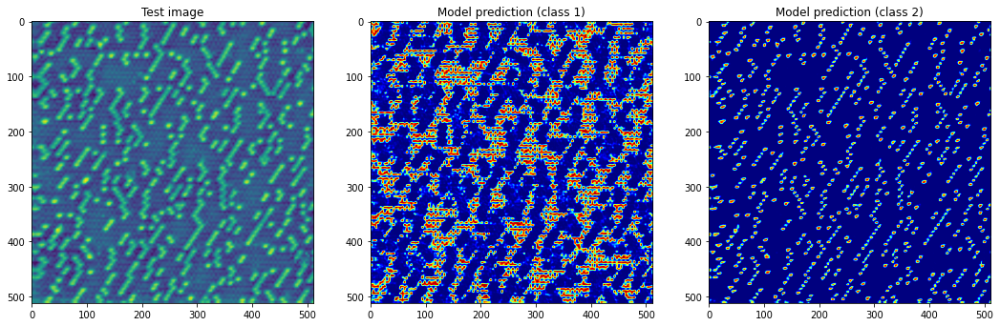

In [ ]:
resized = 512

test_img0 = topo_f_n.reshape((1,topo_f_n.shape[0],topo_f_n.shape[1]))
test_img = resize(test_img0,(1,resized,resized))

# Convert to 4D tensor (required, even if it is a single image)
test_img = test_img[np.newaxis, ...]
# Convert to pytorch format
test_img_ = torch.from_numpy(test_img).float().cuda()
# make a prediction
prediction = model.forward(test_img_)
prediction = torch.exp(prediction).cpu().detach().numpy() # that's because we used log_softmax
# plot results
_, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 6))
ax1.imshow(test_img[0,0])
ax2.imshow(prediction[0,0], cmap='jet')
ax3.imshow(prediction[0,1], cmap='jet')
ax1.set_title('Test image')
ax2.set_title('Model prediction (class 1)')
ax3.set_title('Model prediction (class 2)');

* Adjust threshold, maybe dist_edge, until adatoms properly identified 
* Then, use the coordinates to generate new image soley of adatoms
* <font color = 'crimson'>**Remember, we really only care about the `adatom` identification, the underlying background atoms are not as critical**</font>

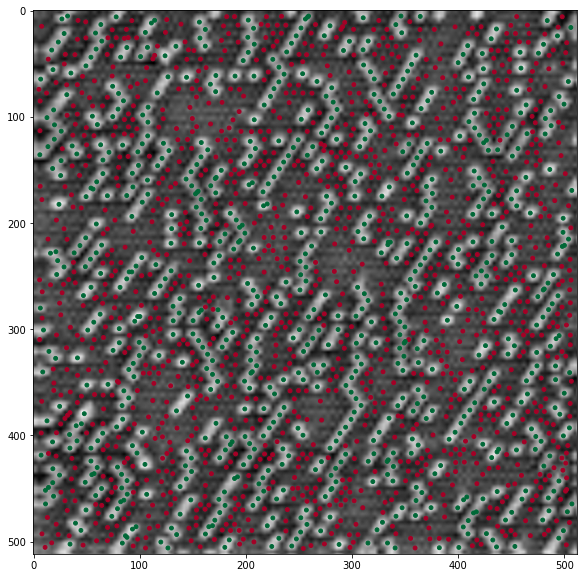

In [ ]:
threshold = 0.7  # originally 0.5

# Idea, put this to ~ 0.75, it finds TOO MANY adatoms 
# BUT, just delete any atoms that are too close to one another (of course, LEAVE one of them)

coordinates_im = FindAtoms(prediction, threshold = threshold).get_all_coordinates()

y, x, c = coordinates_im[0].T
plt.figure(figsize=(10,10))
plt.imshow(test_img[0,0], cmap='gray')
plt.scatter(x, y, c=c, cmap='RdYlGn', s=15);

* Separate the labels, we only want the adatoms

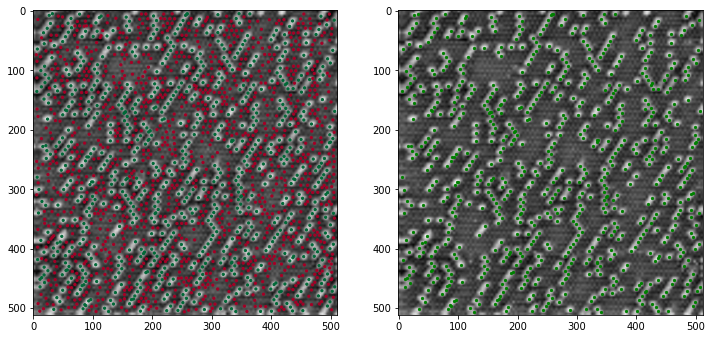

In [ ]:
temp = np.where(coordinates_im[0][:,2]==1)

x_NEW_, y_NEW_ = x[temp], y[temp]

y_NEW = np.reshape(x_NEW_, (x_NEW_.shape[0],1))
x_NEW = np.reshape(y_NEW_, (y_NEW_.shape[0],1))

xycoords_NEW = np.concatenate((x_NEW,y_NEW), axis = 1)

f,a = plt.subplots(1,2,figsize=(12,6))
a[0].imshow(test_img[0,0], cmap='gray')
a[0].scatter(x, y, c=c, cmap='RdYlGn', s=5);

a[1].imshow(test_img[0,0], cmap='gray')
a[1].scatter(y_NEW, x_NEW, c='g', cmap='RdYlGn', s=5);

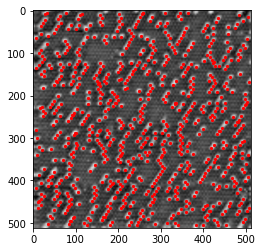

In [ ]:
plt.figure()
plt.imshow(test_img[0,0], cmap='gray')
plt.scatter(xycoords_NEW[:,1], xycoords_NEW[:,0], c='r', s=5)

# Generate cleaned image using (x,y) coords
* This should have (roughly?) the same pixel density as the classes to be defined later
* e.g., 


* **NORMALIZE**!

In [ ]:
size = 512
def gauss2d_atom(x,y,sigma,amp=1,xlen=size,ylen=size,numpix=size):
    xx = np.linspace(0,xlen,numpix)
    yy = np.linspace(0,ylen,numpix)
    mx, my = np.meshgrid(xx,yy)
    return amp*np.exp(-((mx-x)**2+(my-y)**2)/sigma)

In [ ]:
try:
  arrsize = resized  # The same size as the image above
except NameError:
  arrsize = 512

atomsize = 10
amplitude = 1

# # just circles
# radius = 2

try: 
  bloblist = np.zeros(x_NEW.shape[0], dtype=object) 
  for ii in range(x_NEW.shape[0]):
      bloblist[ii] = (x_NEW[ii][0], y_NEW[ii][0])
except NameError:
  print('name error encountered, passing...')
  pass
     
adatoms = np.zeros((arrsize,arrsize))
for kk in range(len(bloblist)):
  adatoms += gauss2d_atom(bloblist[kk][1],bloblist[kk][0], amp = amplitude, sigma = atomsize, xlen = arrsize, ylen=arrsize, numpix = arrsize)

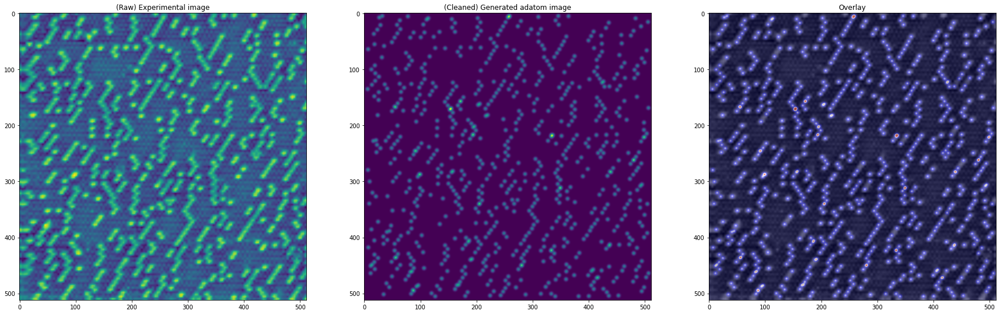

In [ ]:
f,a = plt.subplots(1,3,figsize = (30,10))
a[0].imshow(test_img[0,0])
a[1].imshow(adatoms)
a[2].imshow(test_img[0,0], cmap = 'gray')
a[2].imshow(adatoms, alpha = 0.5, cmap = 'seismic')

a[0].set_title('(Raw) Experimental image')
a[1].set_title('(Cleaned) Generated adatom image')
a[2].set_title('Overlay');

In [ ]:
def extract_subimages(imgdata, com, d, **kwargs):
    '''Function for cropping images around adatoms'''
    icut = kwargs.get('n')
    if icut == None:
        icut = len(com)
    img_cr_all = np.empty((0, int(d*2), int(d*2)))
    com_ = np.empty((0, 2))
    for i, c in enumerate(com):
        cx = int(np.around(c[0]))
        cy = int(np.around(c[1]))
        img_cr = np.copy(
            imgdata[cx-d:cx+d, cy-d:cy+d])
        if img_cr.shape == (int(d*2), int(d*2)):
            img_cr_all = np.append(img_cr_all, [img_cr], axis=0)
            com_ = np.append(com_, [c], axis=0)
        if i > icut:
            return img_cr_all, com_
    return img_cr_all, com_

* Crop image into segments to classify.
* Crop size "crs": likely will be based on pixel density and field of view or resolution

Let's go for:

22 x 22 windows  (`crs = 11`)

In [ ]:
crs = 11 # size of image to crop

topo_f_n_resized = resize(topo_f_n, (resized,resized))
imgstack_, com = extract_subimages(adatoms, xycoords_NEW, crs)
imgstack_.shape

(728, 22, 22)

* Normalize stack

In [ ]:
imgstack = np.zeros_like(imgstack_)
for ii in range(imgstack_.shape[0]):
  imgstack[ii] = (imgstack_[ii] - np.min(imgstack_[ii]))/np.ptp(imgstack_[ii])

708

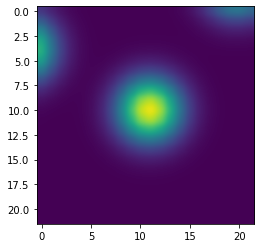

In [ ]:
plt.figure()

ii = np.random.randint(0,imgstack.shape[0])
plt.imshow(imgstack[ii], interpolation = 'gaussian')
# plt.imshow(imgstack[ii])
ii

Viewing the stack in couple different ways

In [ ]:
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.cbook import get_sample_data

(-0.05, 1.05, -0.05, 1.05)

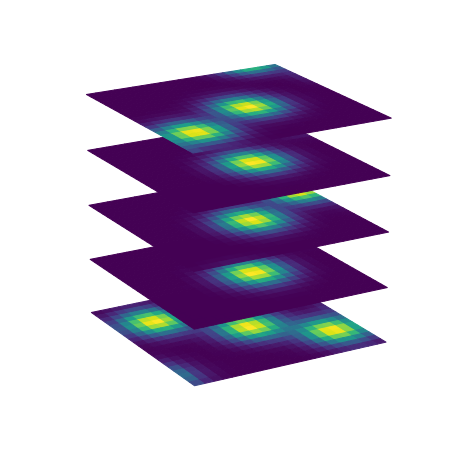

In [ ]:
# Create mesh.
X, Y = np.meshgrid(np.linspace(0,1,22), np.linspace(0,1,22))

# Create some data to plot.
A = np.copy(X);
B = np.copy(Y);
C = np.sqrt(X**2 + Y**2);
D = np.cos(C);
# Normalize data for colormap use.
A -= np.min(A); A /= np.max(A);
B -= np.min(B); B /= np.max(B);
C -= np.min(C); C /= np.max(C);
D -= np.min(D); D /= np.max(D);

data1 = imgstack[52] # 35
data2 = imgstack[26]
data3 = imgstack[2]
data4 = imgstack[26]
data5 = imgstack[35]

# Create flat surface.
Z = np.zeros_like(X);

# Plot
fig = plt.figure(figsize = (8,8));
ax = fig.gca(projection='3d');
ax.plot_surface(X, Y, Z, rstride=1, cstride=1, facecolors = plt.cm.viridis(data1), shade=False);
ax.plot_surface(X, Y, Z+10, rstride=1, cstride=1, facecolors = plt.cm.viridis(data2), shade=False);
ax.plot_surface(X, Y, Z+20, rstride=1, cstride=1, facecolors = plt.cm.viridis(data3), shade=False);
ax.plot_surface(X, Y, Z+30, rstride=1, cstride=1, facecolors = plt.cm.viridis(data4), shade=False);
ax.plot_surface(X, Y, Z+40, rstride=1, cstride=1, facecolors = plt.cm.viridis(data5), shade=False);


ax.view_init(elev = 20, azim = -30)
ax.axis('off')

(-0.05, 1.05, -0.05, 1.05)

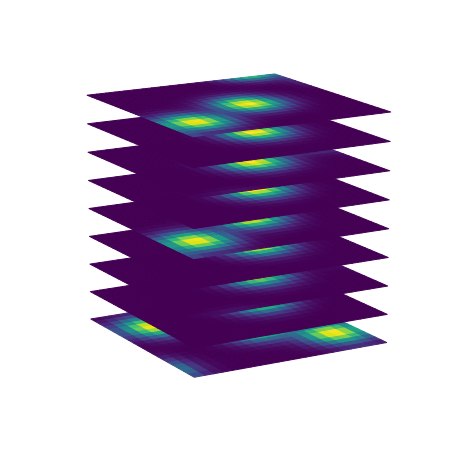

In [ ]:
# Create mesh.

X, Y = np.meshgrid(np.linspace(0,1,22), np.linspace(0,1,22))

# Create some data to plot.
A = np.copy(X);
B = np.copy(Y);
C = np.sqrt(X**2 + Y**2);
D = np.cos(C);
# Normalize data for colormap use.
A -= np.min(A); A /= np.max(A);
B -= np.min(B); B /= np.max(B);
C -= np.min(C); C /= np.max(C);
D -= np.min(D); D /= np.max(D);

data1 = imgstack[52] # 35
data2 = imgstack[26]
data3 = imgstack[2]
data4 = imgstack[26]
data5 = imgstack[35]
data6 = imgstack[26]
data7 = imgstack[2]
data8 = imgstack[26]
data9 = imgstack[35]

# Create flat surface.
Z = np.zeros_like(X);

# Plot
fig = plt.figure(figsize = (8,8));
ax = fig.gca(projection='3d');
ax.plot_surface(X, Y, Z, rstride=1, cstride=1, facecolors = plt.cm.viridis(data1), shade=False);
ax.plot_surface(X, Y, Z+10, rstride=1, cstride=1, facecolors = plt.cm.viridis(data2), shade=False);
ax.plot_surface(X, Y, Z+20, rstride=1, cstride=1, facecolors = plt.cm.viridis(data3), shade=False);
ax.plot_surface(X, Y, Z+30, rstride=1, cstride=1, facecolors = plt.cm.viridis(data4), shade=False);
ax.plot_surface(X, Y, Z+40, rstride=1, cstride=1, facecolors = plt.cm.viridis(data5), shade=False);
ax.plot_surface(X, Y, Z+50, rstride=1, cstride=1, facecolors = plt.cm.viridis(data6), shade=False);
ax.plot_surface(X, Y, Z+60, rstride=1, cstride=1, facecolors = plt.cm.viridis(data7), shade=False);
ax.plot_surface(X, Y, Z+70, rstride=1, cstride=1, facecolors = plt.cm.viridis(data8), shade=False);
ax.plot_surface(X, Y, Z+80, rstride=1, cstride=1, facecolors = plt.cm.viridis(data9), shade=False);


ax.view_init(elev = 15, azim = -30)
ax.axis('off')

# Begin Classification

## GMM (unsupervised)

In [ ]:
#classifying blobs/atoms
from sklearn.cluster import KMeans
from scipy.cluster.hierarchy import linkage, fcluster, dendrogram
from sklearn import mixture
from sklearn import decomposition

In [ ]:
d0, d1, d2 = imgstack.shape
X_vec = imgstack.reshape(d0, d1*d2)  # flatten for pca
X_vec.shape

(728, 484)

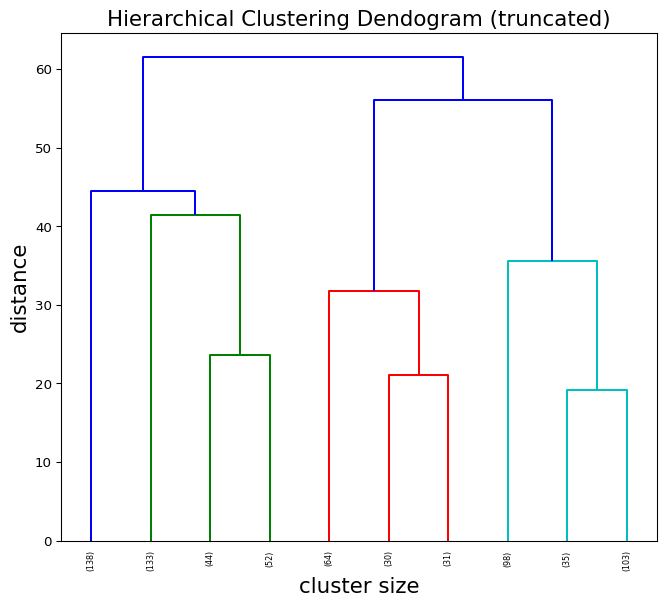

In [ ]:
Z = linkage(X_vec, method='ward')
plt.figure(figsize = (8,7), dpi = 96)
dendrogram(Z, truncate_mode='lastp', p=10, leaf_rotation=90.,leaf_font_size=6.,)
plt.title('Hierarchical Clustering Dendogram (truncated)', fontsize = 16)
plt.xlabel('cluster size', fontsize = 16)
plt.ylabel('distance', fontsize = 16)
plt.show()

(-1.0, 20.0)

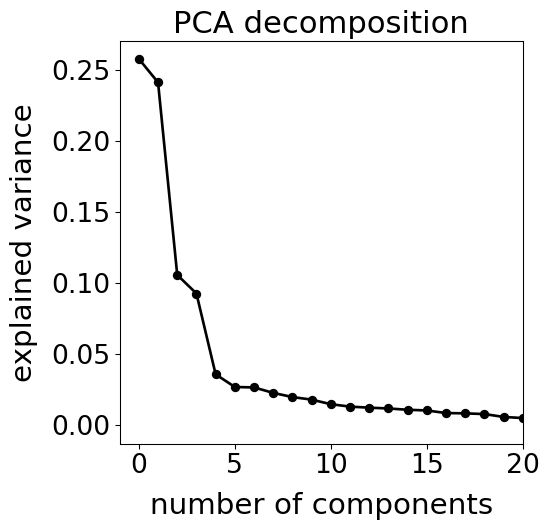

In [ ]:
pca = decomposition.PCA()
pca.fit(X_vec)
plt.figure(1, figsize=(6, 6), dpi = 96)
plt.clf()
plt.axes([.2, .2, .7, .7])
plt.plot(pca.explained_variance_ratio_,'o-', linewidth=2, c = 'black' )
# plt.axis('tight')
plt.xlabel('number of components', fontsize = 22, labelpad = 10)
plt.ylabel('explained variance', fontsize = 22, labelpad = 10)
plt.tick_params(axis='both', labelsize = 20)
plt.title("PCA decomposition", fontsize = 23)
plt.xlim(-1, 20)

In [ ]:
X_vec.shape

(728, 484)

* <font size = 5>`How to choose the number of classes (nc)`</font>
* This step is not automated yet because the result depends a lot on number of classes
* No double counting, no missing classes
* <font color='crimson'>**NEED TO FIGURE IT OUT</font>**
* Currently based on `PCA scree plot` & *a priori* knowledge



In [ ]:
nc = 5
classifier = 'GMM'

if classifier == 'GMM':
    clf = mixture.GaussianMixture(n_components=nc, covariance_type='diag', random_state = 8000).fit(X_vec)
else:
    clf = KMeans(n_clusters=nc).fit(X_vec)

classes = clf.predict(X_vec) + 1

In [ ]:
class1 = np.where(classes==1)[0]
class2 = np.where(classes==2)[0]
class3 = np.where(classes==3)[0]
class4 = np.where(classes==4)[0]
class5 = np.where(classes==5)[0]
# class6 = np.where(classes==6)[0]
# class7 = np.where(classes==7)[0]
# class8 = np.where(classes==8)[0]

In [ ]:
classes

array([1, 4, 2, 1, 2, 2, 4, 2, 2, 3, 2, 1, 1, 1, 2, 4, 1, 1, 1, 2, 2, 2,
       4, 2, 4, 2, 4, 3, 2, 2, 2, 4, 1, 1, 4, 4, 3, 4, 3, 1, 1, 2, 4, 4,
       4, 1, 1, 1, 1, 1, 4, 4, 5, 3, 3, 4, 5, 4, 3, 3, 2, 2, 3, 3, 2, 3,
       3, 3, 4, 3, 4, 1, 2, 1, 4, 2, 4, 3, 3, 3, 2, 4, 5, 1, 4, 3, 1, 4,
       1, 1, 2, 4, 5, 5, 2, 1, 2, 2, 1, 4, 2, 5, 2, 2, 2, 2, 4, 1, 1, 1,
       3, 1, 4, 3, 1, 1, 3, 3, 1, 3, 1, 5, 2, 2, 4, 5, 2, 2, 4, 3, 1, 4,
       3, 5, 1, 4, 2, 3, 4, 1, 3, 1, 5, 5, 5, 2, 1, 2, 4, 5, 5, 2, 1, 4,
       4, 2, 2, 2, 2, 2, 5, 3, 2, 4, 1, 4, 3, 4, 4, 4, 4, 4, 4, 4, 2, 1,
       2, 4, 1, 4, 4, 2, 4, 3, 1, 4, 4, 3, 2, 1, 4, 4, 1, 1, 3, 2, 4, 3,
       1, 4, 2, 5, 4, 4, 4, 4, 1, 5, 4, 5, 5, 1, 1, 2, 2, 1, 4, 4, 2, 4,
       2, 5, 3, 2, 5, 3, 1, 2, 5, 1, 1, 3, 1, 2, 4, 1, 1, 3, 4, 2, 1, 2,
       5, 1, 2, 4, 3, 4, 1, 3, 3, 5, 1, 3, 3, 2, 3, 4, 3, 1, 5, 2, 4, 3,
       4, 5, 3, 5, 3, 1, 3, 1, 1, 3, 2, 2, 2, 3, 3, 1, 4, 3, 3, 3, 3, 2,
       4, 4, 2, 3, 4, 4, 2, 2, 4, 3, 4, 4, 2, 4, 1,

* View classes by their "representative" image (which is an *average* of all images within a class)

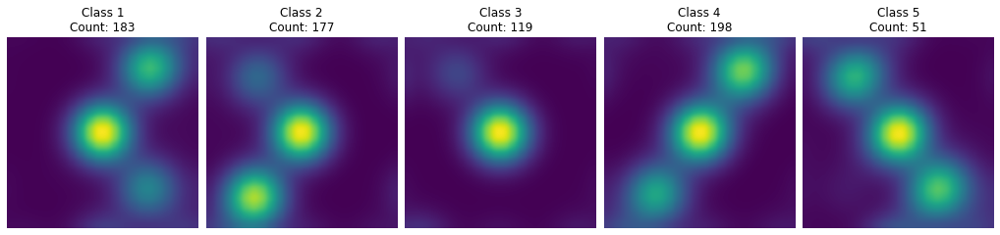

In [ ]:
cla = np.ndarray(shape=(np.amax(classes), int(crs*2), int(crs*2)))
fig = plt.figure(figsize=(18, 10))

rows = int(np.ceil(float(nc)/5))
cols = int(np.ceil(float(np.amax(classes))/rows))

gs1 = gridspec.GridSpec(rows, cols)

for i in range(np.amax(classes)):
    cl = imgstack[classes == i + 1]
    cla[i] = np.mean(cl, axis=0)
    cla_en = np.copy(cla[i])
    ax = fig.add_subplot(gs1[i])
    ax.imshow(cla_en, Interpolation = 'Gaussian')
    
    ax.axis('off')
    ax.set_title('Class ' + str(i + 1) + '\nCount: ' + str(len(cl)))

plt.subplots_adjust(hspace=0.06, wspace=0.04)

This does not capture the desired effects. Namely:
* Some of the classes are overlapping one another, due simply to different rotations counting as different classes
* Even within a class, it is clear there is a bit of variability - note the different relative intensities between atoms

<font size = 6> Overall assessment: `GMM does not perform well for our needs here`</font>

## Onwards to `supervised` learning
* We posit that we must <u>clearly define</u> what we want each class to be

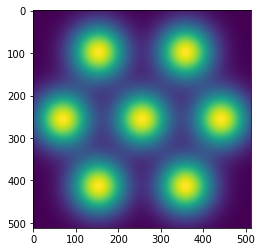

In [ ]:
# Generate a "unit cell" (obviously not a real unit cell) for choosing classes
# We define atom positions relative to the center of the image (where the atom0 resides)
# sigma essentially adjusts the size of the atoms

sigma = 4000 # Default is 3000

centerx, centery = arrsize/2, arrsize/2
atom0 = gauss2d_atom(centerx,centery, sigma = sigma)
atom1 = gauss2d_atom(centerx - arrsize/5,centery - arrsize/3.25, sigma = sigma)
atom2 = gauss2d_atom(centerx + arrsize/5,centery - arrsize/3.25, sigma = sigma)
atom3 = gauss2d_atom(centerx + arrsize/2.75,centery, sigma = sigma)
atom4 = gauss2d_atom(centerx + arrsize/5,centery + arrsize/3.25, sigma = sigma)
atom5 = gauss2d_atom(centerx - arrsize/5,centery + arrsize/3.25, sigma = sigma)
atom6 = gauss2d_atom(centerx - arrsize/2.75,centery, sigma = sigma)

plt.imshow(atom0+atom1+atom2+atom3+atom4+atom5+atom6)

* Here is what we *want (expect)* as the categorized classes:

In [ ]:
class1_dict = {1 : atom0}

class2_dict = {1 : atom0+atom1,
               2 : atom0+atom2,
               3 : atom0+atom3,
               4 : atom0+atom4,
               5 : atom0+atom5,
               6 : atom0+atom6}

class3_dict = {1 : atom0+atom1+atom2,
               2 : atom0+atom2+atom3,
               3 : atom0+atom3+atom4,
               4 : atom0+atom4+atom5,
               5 : atom0+atom5+atom6,
               6 : atom0+atom6+atom1}

class4_dict = {1 : atom0+atom1+atom3,
               2 : atom0+atom2+atom4,
               3 : atom0+atom3+atom5,
               4 : atom0+atom4+atom6,
               5 : atom0+atom5+atom1,
               6 : atom0+atom6+atom2}

class5_dict = {1 : atom0+atom1+atom4,
               2 : atom0+atom2+atom5,
               3 : atom0+atom3+atom6}
               
# For referencing later
classes_all = {1:class1_dict, 
               2:class2_dict,
               3:class3_dict,
               4:class4_dict,
               5:class5_dict}

[]

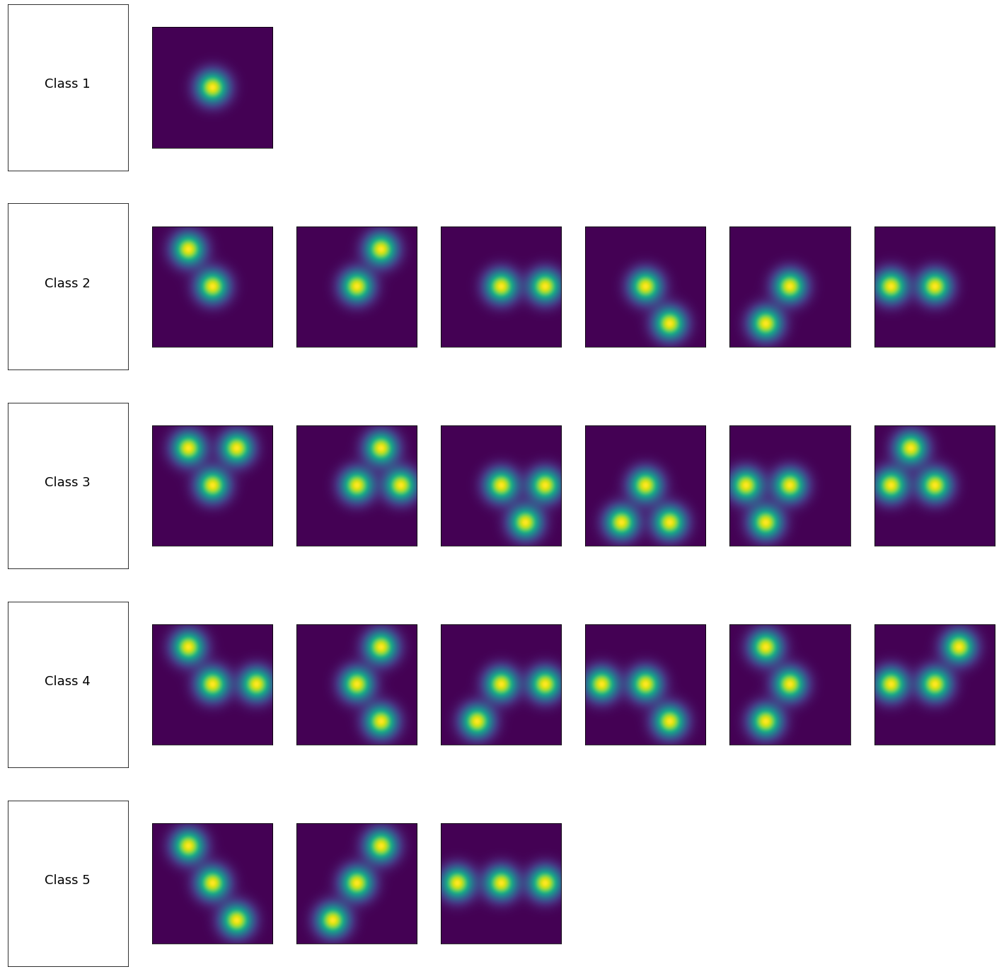

In [ ]:
plt.figure(figsize=(25,25))
gs = gridspec.GridSpec(5,7)
ax10, ax11 = plt.subplot(gs[0,0]), plt.subplot(gs[0,1])
ax20, ax21, ax22 = plt.subplot(gs[1,0]), plt.subplot(gs[1,1]), plt.subplot(gs[1,2])
ax23, ax24, ax25, ax26 = plt.subplot(gs[1,3]), plt.subplot(gs[1,4]), plt.subplot(gs[1,5]), plt.subplot(gs[1,6])
ax30, ax31, ax32 = plt.subplot(gs[2,0]), plt.subplot(gs[2,1]), plt.subplot(gs[2,2])
ax33, ax34, ax35, ax36 = plt.subplot(gs[2,3]), plt.subplot(gs[2,4]), plt.subplot(gs[2,5]), plt.subplot(gs[2,6])
ax40, ax41, ax42 = plt.subplot(gs[3,0]), plt.subplot(gs[3,1]), plt.subplot(gs[3,2])
ax43, ax44, ax45, ax46 = plt.subplot(gs[3,3]), plt.subplot(gs[3,4]), plt.subplot(gs[3,5]), plt.subplot(gs[3,6])
ax50, ax51, ax52, ax53 = plt.subplot(gs[4,0]), plt.subplot(gs[4,1]), plt.subplot(gs[4,2]), plt.subplot(gs[4,3])

#class 1
ax11.imshow(class1_dict[1])

#class 2
ax21.imshow(class2_dict[1])
ax22.imshow(class2_dict[2])
ax23.imshow(class2_dict[3])
ax24.imshow(class2_dict[4])
ax25.imshow(class2_dict[5])
ax26.imshow(class2_dict[6])

#class 3
ax31.imshow(class3_dict[1])
ax32.imshow(class3_dict[2])
ax33.imshow(class3_dict[3])
ax34.imshow(class3_dict[4])
ax35.imshow(class3_dict[5])
ax36.imshow(class3_dict[6])

#class 4
ax41.imshow(class4_dict[1])
ax42.imshow(class4_dict[2])
ax43.imshow(class4_dict[3])
ax44.imshow(class4_dict[4])
ax45.imshow(class4_dict[5])
ax46.imshow(class4_dict[6])

#class 5
ax51.imshow(class5_dict[1])
ax52.imshow(class5_dict[2])
ax53.imshow(class5_dict[3])

ax10.text(0.5,0.5, 'Class 1', ha='center', fontsize = 18)
ax20.text(0.5,0.5, 'Class 2', ha='center', fontsize = 18)
ax30.text(0.5,0.5, 'Class 3', ha='center', fontsize = 18)
ax40.text(0.5,0.5, 'Class 4', ha='center', fontsize = 18)
ax50.text(0.5,0.5, 'Class 5', ha='center', fontsize = 18)

plt.setp([ax10,ax11,ax20,ax21,ax22,ax23,ax24,ax25,ax26,ax30,ax31,
          ax32,ax33,ax34,ax35,ax36,ax40,ax41,ax42,ax43,ax44,ax45,
          ax46,ax50,ax51,ax52,ax53],xticks=[],yticks=[])

Notice that the various rotations of atomic configurations are chosen to be part of the same class. This is one aspect GMM could not reconcile

## Enumerate neighbors ("one hot encoding")

* Let's take a look at a handful of random subimages of adatoms and their neighbors:

[]

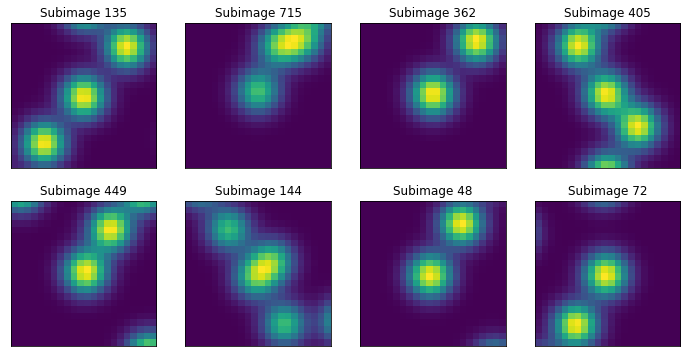

In [ ]:
plt.figure(figsize = (12,6))
gs = gridspec.GridSpec(2,4)
ax00 = plt.subplot(gs[0,0])
ax01 = plt.subplot(gs[0,1])
ax02 = plt.subplot(gs[0,2])
ax03 = plt.subplot(gs[0,3])
ax10 = plt.subplot(gs[1,0])
ax11 = plt.subplot(gs[1,1])
ax12 = plt.subplot(gs[1,2])
ax13 = plt.subplot(gs[1,3])

axdict = {1:ax00, 2:ax01, 3:ax02, 4:ax03, 5:ax10, 6:ax11, 7:ax12, 8:ax13}
for ii in range(1,len(axdict)+1):
  jj = np.random.randint(0,imgstack.shape[0])
  axdict[ii].imshow(imgstack[jj])
  axdict[ii].set_title('Subimage {}'.format(jj))

plt.setp([ax00,ax01,ax02,ax03,ax10,ax11,ax12,ax13], xticks=[], yticks=[])

* Note the adatoms are **centered** in each subimage, so we consider all images 'aligned'
* Additionally, each image has the *same number of pixels*, and each atom is defined by a gaussian (coded above) with the *same size/amplitude*.   We can use this information to our benefit:
* We designate particular regions in the image to be the possible atom positions, and if the intensity total in that region reaches a user specified threshold, then an atom is said to be present.

* 6 regions (ignore center, that's the atom in question, of course it's there)
* if pixels in the region sum to some THRESHOLD, then there is an atom in that position

* <font color = 'crimson'>**Need to generalize this for different ROTATIONS! Will probably need to FFT the original image to get the angle**</font> 
* This also applies to the generation of the classes
* Because our data is already rotationally aligned we do not need to worry about it

R1:  8.009878769431289
R2:  0.25050814842004715
R3:  0.0351485455437527
R4:  11.241314276608211
R5:  8.196400339873433
R6:  0.405435527694184
center:  15.535956779273038


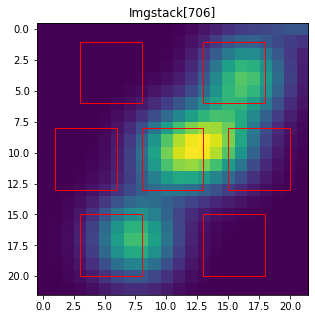

In [ ]:
ii = np.random.randint(0,imgstack.shape[0])

#####################
### region coords ###
#####################
length = 5         # side length of square ROI
r1coords = (3,15)  #
r2coords = (1,8)   #
r3coords = (3,1)   #
r4coords = (13,1)  # 
r5coords = (15,8)  #
r6coords = (13,15) #
r0coords = (8,8)   # center atom

plt.figure(figsize = (10,5))
gs = gridspec.GridSpec(1,1)
ax = plt.subplot(gs[0])
ax.imshow(imgstack[ii])

roidict = {0:r0coords, 1:r1coords, 2:r2coords, 
           3:r3coords, 4:r4coords, 5:r5coords, 6:r6coords}
roilist = [0, 1, 2, 3, 4, 5, 6]
for jj in range(0, len(roidict)):
  roilist[jj] = Rectangle(roidict[jj], length, length, fill = False, color = 'r')
  ax.add_patch(roilist[jj])

ax.set_title('Imgstack[{}]'.format(ii));

print('R1: ', np.sum(imgstack[ii,r1coords[1]:r1coords[1]+length,r1coords[0]:r1coords[0]+length]))
print('R2: ', np.sum(imgstack[ii,r2coords[1]:r2coords[1]+length,r2coords[0]:r2coords[0]+length]))
print('R3: ', np.sum(imgstack[ii,r3coords[1]:r3coords[1]+length,r3coords[0]:r3coords[0]+length]))
print('R4: ', np.sum(imgstack[ii,r4coords[1]:r4coords[1]+length,r4coords[0]:r4coords[0]+length]))
print('R5: ', np.sum(imgstack[ii,r5coords[1]:r5coords[1]+length,r5coords[0]:r5coords[0]+length]))
print('R6: ', np.sum(imgstack[ii,r6coords[1]:r6coords[1]+length,r6coords[0]:r6coords[0]+length]))
print('center: ', np.sum(imgstack[ii,r0coords[1]:r0coords[1]+length,r0coords[0]:r0coords[0]+length]))

* After iterating above a few times, looks like the "THRESHOLD" that should be used is: <font color = 'crimson'> **7** </font>
* Threshold is based on the ATOM SIZE and the size of the ROI. 
  * It should have a relation to these. 
* i.e., if the sum of what's in these ROIs is >= 7, then an atom is deemed to be present in that location

In [ ]:
thresh = 7   # Adjust as needed, 7 seems about right for the given 2D gaussian size and ROI size

####### Note, this threshold value is not unique to each dataset. It simply needs to be "calibrated"
####### for particular gaussian size and ROI size. For what has been chosen, threshold of 7 appears to be reasonable

r1 = np.zeros((imgstack.shape[0]))
r2 = np.zeros((imgstack.shape[0]))
r3 = np.zeros((imgstack.shape[0]))
r4 = np.zeros((imgstack.shape[0]))
r5 = np.zeros((imgstack.shape[0]))
r6 = np.zeros((imgstack.shape[0]))

r1sum = np.zeros((imgstack.shape[0]))
r2sum = np.zeros((imgstack.shape[0]))
r3sum = np.zeros((imgstack.shape[0])) 
r4sum = np.zeros((imgstack.shape[0])) 
r5sum = np.zeros((imgstack.shape[0])) 
r6sum = np.zeros((imgstack.shape[0]))

classified = np.zeros((imgstack.shape[0]))

for ii in range(imgstack.shape[0]):
  r1sum[ii] = np.sum(imgstack[ii,r1coords[1]:r1coords[1]+length,r1coords[0]:r1coords[0]+length])
  r2sum[ii] = np.sum(imgstack[ii,r2coords[1]:r2coords[1]+length,r2coords[0]:r2coords[0]+length])
  r3sum[ii] = np.sum(imgstack[ii,r3coords[1]:r3coords[1]+length,r3coords[0]:r3coords[0]+length])
  r4sum[ii] = np.sum(imgstack[ii,r4coords[1]:r4coords[1]+length,r4coords[0]:r4coords[0]+length])
  r5sum[ii] = np.sum(imgstack[ii,r5coords[1]:r5coords[1]+length,r5coords[0]:r5coords[0]+length])
  r6sum[ii] = np.sum(imgstack[ii,r6coords[1]:r6coords[1]+length,r6coords[0]:r6coords[0]+length])

  if r1sum[ii]>=thresh:
    r1[ii] = 1
  else:
    r1[ii] = 0
  if r2sum[ii]>=thresh:
    r2[ii] = 1
  else:
    r2[ii] = 0
  if r3sum[ii]>=thresh:
    r3[ii] = 1
  else:
    r3[ii] = 0
  if r4sum[ii]>=thresh:
    r4[ii] = 1
  else:
    r4[ii] = 0
  if r5sum[ii]>=thresh:
    r5[ii] = 1
  else:
    r5[ii] = 0
  if r6sum[ii]>=thresh:
    r6[ii] = 1
  else:
    r6[ii] = 0

###############################
### Logic for atom presence ###
###############################

  if  r1[ii] + r2[ii] + r3[ii] + r4[ii] + r5[ii] + r6[ii] == 0:
    classified[ii] = 1
  elif r1[ii] and r2[ii] or r2[ii] and r3[ii] or r3[ii] and r4[ii] or r4[ii] and r5[ii] or r5[ii] and r6[ii] or r6[ii] and r1[ii]:
    classified[ii] = 3
  elif r1[ii] and r3[ii] or r2[ii] and r4[ii] or r3[ii] and r5[ii] or r4[ii] and r6[ii] or r5[ii] and r1[ii] or r6[ii] and r2[ii]:
    classified[ii] = 4
  elif r1[ii] and r4[ii] or r2[ii] and r5[ii] or r3[ii] and r6[ii]:
    classified[ii] = 5
  elif r1[ii] or r2[ii] or r3[ii] or r4[ii] or r5[ii] or r6[ii]:
    classified[ii] = 2
  else:
    classified[ii] = 0

* Let's evaluate how this has performed:

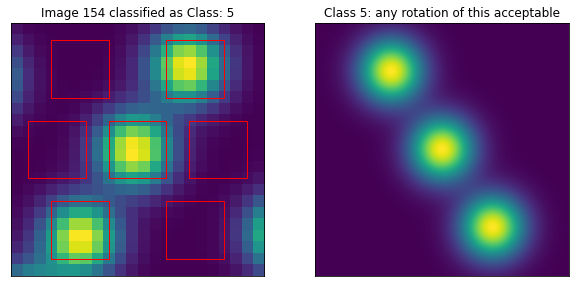

In [ ]:
ii = np.random.randint(0,imgstack.shape[0])
classdetected = int(classified[ii])
whichclass = classes_all[classdetected][1] # select the first subclass rotation, [1], as visual identifier

f,ax = plt.subplots(1,2, figsize = (10,5))
for jj in range(0, len(roidict)):
  roilist[jj] = Rectangle(roidict[jj], length, length, fill = False, color = 'r')
  ax[0].add_patch(roilist[jj])
ax[0].imshow(imgstack[ii])
ax[0].set_title('Image {} classified as Class: {}'.format(ii, classdetected))

ax[1].imshow(whichclass)
ax[1].set_title("Class {}: any rotation of this acceptable".format(classdetected))

# print('Image # {}/{}'.format(ii,imgstack.shape[0]))
# print('Class: {}'.format(classdetected))

plt.setp([ax[0],ax[1]],xticks=[], yticks=[]);

* Recall that this previous classification is based on the "adatom filtered" image. It is not the original data! There:
* Check the REAL (experimental) image with same statistics

In [ ]:
imgstack_exp, com_exp = extract_subimages(topo_f_n_resized, xycoords_NEW, crs)

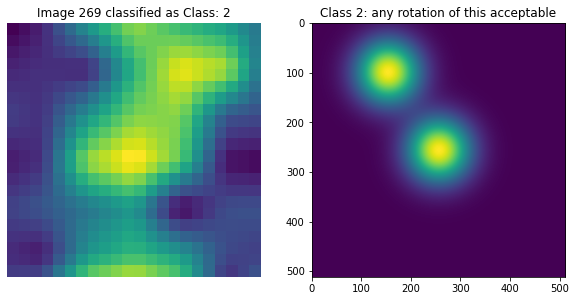

In [ ]:
ii = np.random.randint(0,imgstack.shape[0])
classdetected = int(classified[ii])
whichclass = classes_all[classdetected][1]

r_1 = Rectangle(r1coords, length, length, fill = False, color = 'r')
r_2 = Rectangle(r2coords, length, length, fill = False, color = 'r')
r_3 = Rectangle(r3coords, length, length, fill = False, color = 'r')
r_4 = Rectangle(r4coords, length, length, fill = False, color = 'r')
r_5 = Rectangle(r5coords, length, length, fill = False, color = 'r')
r_6 = Rectangle(r6coords, length, length, fill = False, color = 'r')
r_0 = Rectangle(r0coords, length, length, fill = False, color = 'r')

f,ax = plt.subplots(1,2, figsize = (10,5))
ax[0].imshow(imgstack_exp[ii])
# ax.add_patch(r_1)
# ax.add_patch(r_2)
# ax.add_patch(r_3)
# ax.add_patch(r_4)
# ax.add_patch(r_5)
# ax.add_patch(r_6)
# ax.add_patch(r_0)

ax[0].set_title('Image {} classified as Class: {}'.format(ii, int(classified[ii])))

ax[1].imshow(whichclass)
ax[1].set_title("Class {}: any rotation of this acceptable".format(classdetected))

# print('Image # {}/{}'.format(ii,imgstack_exp.shape[0]))
# print('Class: {}'.format(int(classified[ii])))
# print(r1sum[ii], r2sum[ii], r3sum[ii], r4sum[ii], r5sum[ii], r6sum[ii])
# print(r1[ii], r2[ii], r3[ii], r4[ii], r5[ii], r6[ii])

ax[0].axis('off');

You may re-run the previous cell a few times to check individual classification

* Note, we classified based on the adatom filtered image which is derived directly from the original data. Thus the classification heavily depends on how well the filtered step was done (which was done via atom finding with NN). 
* In other words none of these steps can fail

* Group all classified adatoms into class variables:

In [ ]:
blobclass1 = np.asarray(np.where(classified == 1))[0]
blobclass2 = np.asarray(np.where(classified == 2))[0]
blobclass3 = np.asarray(np.where(classified == 3))[0]
blobclass4 = np.asarray(np.where(classified == 4))[0]
blobclass5 = np.asarray(np.where(classified == 5))[0]
blobclassNONE = np.asarray(np.where(classified == 0))[0]

blobclasses = {1: blobclass1,
               2: blobclass2,
               3: blobclass3,
               4: blobclass4,
               5: blobclass5}

In [ ]:
print('Class 1 adatoms found: {}'.format(blobclass1.shape[0]))
print('Class 2 adatoms found: {}'.format(blobclass2.shape[0]))
print('Class 3 adatoms found: {}'.format(blobclass3.shape[0]))
print('Class 4 adatoms found: {}'.format(blobclass4.shape[0]))
print('Class 5 adatoms found: {}\n'.format(blobclass5.shape[0]))
print('Unclassified: {}'.format(blobclassNONE.shape[0]))

Class 1 adatoms found: 130
Class 2 adatoms found: 330
Class 3 adatoms found: 12
Class 4 adatoms found: 108
Class 5 adatoms found: 148

Unclassified: 0


In [ ]:
# blobclass1.shape[0] + blobclass2.shape[0] + blobclass3.shape[0] + blobclass4.shape[0] + blobclass5.shape[0]

* Show the location of each of these identified classes on the **upscaled** topography

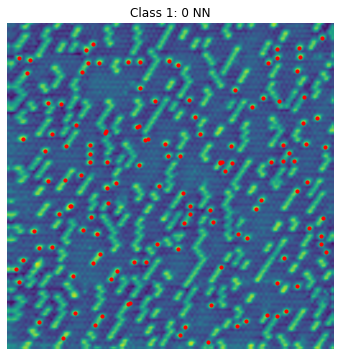

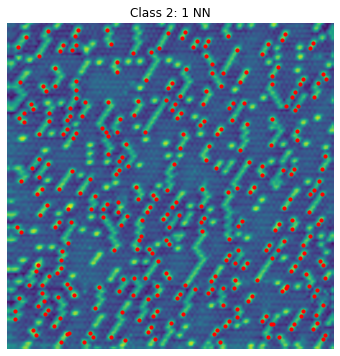

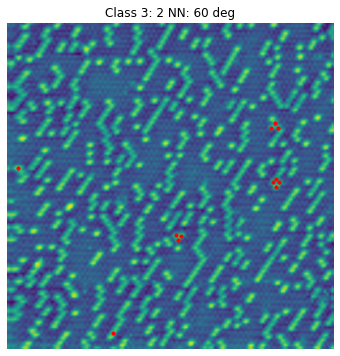

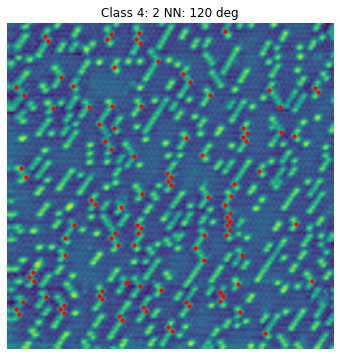

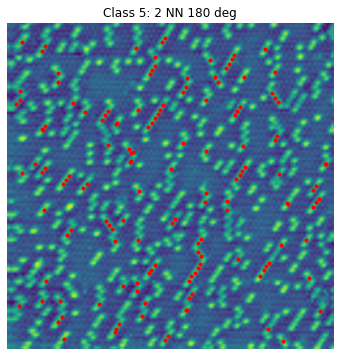

In [ ]:
plt.figure(figsize=(6,6))
plt.imshow(topo_f_n_resized, interpolation = 'gaussian')
for ii in range(blobclass1.shape[0]):
  plt.scatter(com[blobclass1[ii],1], com[blobclass1[ii],0], color = 'r', s = 10)
plt.title('Class 1: 0 NN')
plt.axis('off');

plt.figure(figsize=(6,6))
plt.imshow(topo_f_n_resized, interpolation = 'gaussian')
for ii in range(blobclass2.shape[0]):
  plt.scatter(com[blobclass2[ii],1], com[blobclass2[ii],0], color = 'r', s = 10)
plt.title('Class 2: 1 NN')
plt.axis('off');

plt.figure(figsize=(6,6))
plt.imshow(topo_f_n_resized, interpolation = 'gaussian')
for ii in range(blobclass3.shape[0]):
  plt.scatter(com[blobclass3[ii],1], com[blobclass3[ii],0], color = 'r', s = 10)
plt.title('Class 3: 2 NN: 60 deg')
plt.axis('off');

plt.figure(figsize=(6,6))
plt.imshow(topo_f_n_resized, interpolation = 'gaussian')
for ii in range(blobclass4.shape[0]):
  plt.scatter(com[blobclass4[ii],1], com[blobclass4[ii],0], color = 'r', s = 10)
plt.title('Class 4: 2 NN: 120 deg')
plt.axis('off');

plt.figure(figsize=(6,6))
plt.imshow(topo_f_n_resized, interpolation = 'gaussian')
for ii in range(blobclass5.shape[0]):
  plt.scatter(com[blobclass5[ii],1], com[blobclass5[ii],0], color = 'r', s = 10)
plt.title('Class 5: 2 NN 180 deg')
plt.axis('off');

* Show the location of each of these identified classes on the **original pixel density** topography

In [ ]:
hh = 7
com[blobclass4[hh],1]/4, round(com[blobclass4[hh],1]/4), int(round(com[blobclass4[hh],1]/4)), 

(51.96153846153846, 52.0, 52)

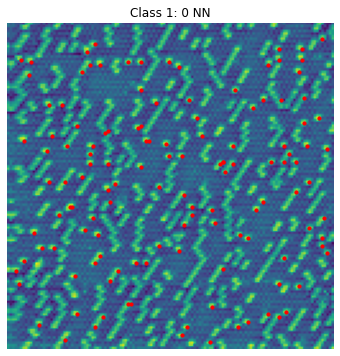

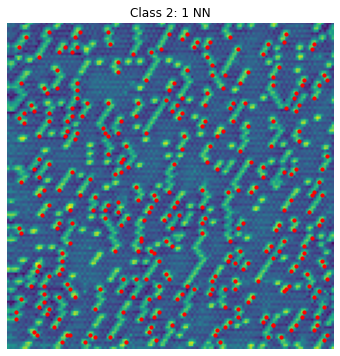

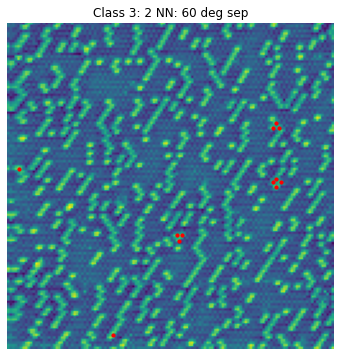

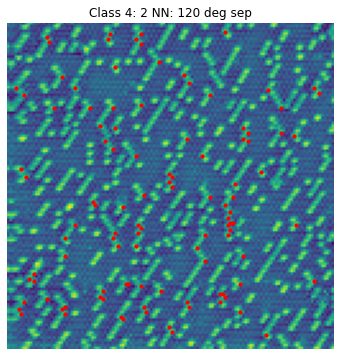

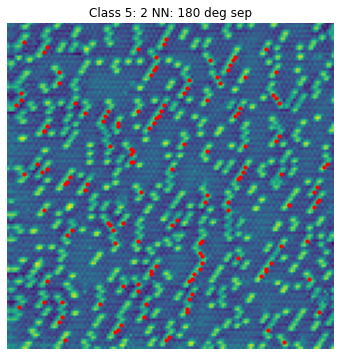

In [ ]:
# topo_f

plt.figure(figsize=(6,6))
plt.imshow(topo_f_n)
for ii in range(blobclass1.shape[0]):
  plt.scatter(int(round(com[blobclass1[ii],1]/4)), int(round(com[blobclass1[ii],0]/4)), color = 'r', s = 10)
plt.title('Class 1: 0 NN')
plt.axis('off');

plt.figure(figsize=(6,6))
plt.imshow(topo_f_n)
for ii in range(blobclass2.shape[0]):
  plt.scatter(int(round(com[blobclass2[ii],1]/4)), int(round(com[blobclass2[ii],0]/4)), color = 'r', s = 10)
plt.title('Class 2: 1 NN')
plt.axis('off');

plt.figure(figsize=(6,6))
plt.imshow(topo_f_n)
for ii in range(blobclass3.shape[0]):
  plt.scatter(int(round(com[blobclass3[ii],1]/4)), int(round(com[blobclass3[ii],0]/4)), color = 'r', s = 10)
plt.title('Class 3: 2 NN: 60 deg sep')
plt.axis('off');

plt.figure(figsize=(6,6))
plt.imshow(topo_f_n)
for ii in range(blobclass4.shape[0]):
  plt.scatter(int(round(com[blobclass4[ii],1]/4)), int(round(com[blobclass4[ii],0]/4)), color = 'r', s = 10)
plt.title('Class 4: 2 NN: 120 deg sep')
plt.axis('off');

plt.figure(figsize=(6,6))
plt.imshow(topo_f_n)
for ii in range(blobclass5.shape[0]):
  plt.scatter(int(round(com[blobclass5[ii],1]/4)), int(round(com[blobclass5[ii],0]/4)), color = 'r', s = 10)
plt.title('Class 5: 2 NN: 180 deg sep')
plt.axis('off');

# Save / load progress [checkpoint]

In [ ]:
##################
### Save Block ###
##################

np.savez("Checkpoint1.npz",
         topo_f_n = topo_f_n,
         imgstack = imgstack,
         com = com,
         imgstack_exp = imgstack_exp,
         com_exp = com_exp,
         classified = classified,
         classes_all = classes_all,
         z_axis = z_axis,
         exp_cits = exp_cits,
         exp_topo = exp_topo,
         blobclasses = blobclasses)

* <font color = 'crimson'>**LOAD previous checkpoint if desired!**</font>

In [ ]:
!gdown https://drive.google.com/uc?id=1i5BR9n982o4njuvdm4N27rQ_zGgD1MgR

Downloading...
From: https://drive.google.com/uc?id=1i5BR9n982o4njuvdm4N27rQ_zGgD1MgR
To: /content/Checkpoint1.npz
65.4MB [00:01, 46.1MB/s]


In [ ]:
##################
### Load Block ###
##################

loadedfile = np.load("Checkpoint1.npz", allow_pickle = True)

# View contents of the loaded file:
print(list(loadedfile.keys()))

# (Re)assign files to appropriate variables
topo_f_n = loadedfile['topo_f_n']
imgstack = loadedfile['imgstack']
com = loadedfile['com']
imgstack_exp = loadedfile['imgstack_exp']
com_exp = loadedfile['com_exp']
classified = loadedfile['classified']
classes_all = loadedfile['classes_all']
z_axis = loadedfile['z_axis']
exp_cits = loadedfile['exp_cits']
exp_topo = loadedfile['exp_topo']
blobclasses = loadedfile['blobclasses']

blobclass1 = blobclasses.tolist()[1]
blobclass2 = blobclasses.tolist()[2]
blobclass3 = blobclasses.tolist()[3]
blobclass4 = blobclasses.tolist()[4]
blobclass5 = blobclasses.tolist()[5]

class1_dict = classes_all.tolist()[1]
class2_dict = classes_all.tolist()[2]
class3_dict = classes_all.tolist()[3]
class4_dict = classes_all.tolist()[4]
class5_dict = classes_all.tolist()[5]

['topo_f_n', 'imgstack', 'com', 'imgstack_exp', 'com_exp', 'classified', 'classes_all', 'z_axis', 'exp_cits', 'exp_topo', 'blobclasses']


# Spectral correlation

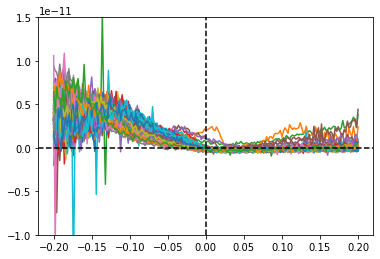

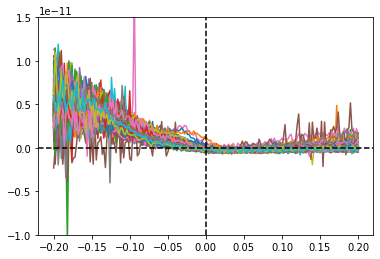

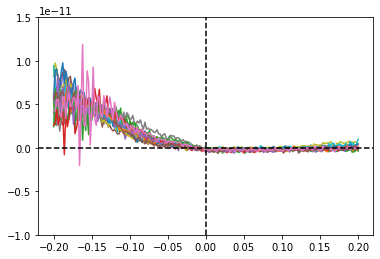

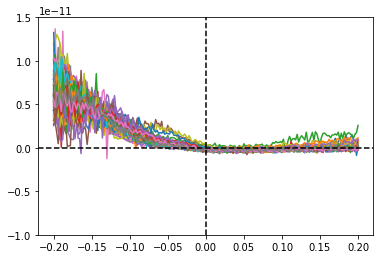

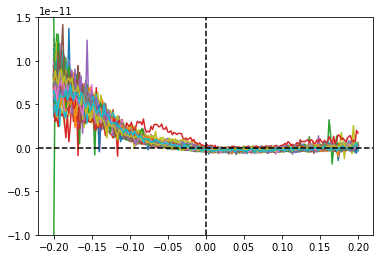

In [ ]:
scalefactor = 4  # to go from 512 to 128 pixels

plt.figure()
for ii in range(blobclass1.shape[0]):
  plt.plot(z_axis,exp_cits[int(round(com[blobclass1[ii],0]/scalefactor)),int(round(com[blobclass1[ii],1]/scalefactor)),:])
plt.ylim(-1E-11,1.5E-11)
plt.axvline(0,c='k',ls='--')
plt.axhline(0,c='k',ls='--')

plt.figure()
for ii in range(blobclass2.shape[0]):
  plt.plot(z_axis,exp_cits[int(round(com[blobclass2[ii],0]/scalefactor)),int(round(com[blobclass2[ii],1]/scalefactor)),:])
plt.ylim(-1E-11,1.5E-11)
plt.axvline(0,c='k',ls='--')
plt.axhline(0,c='k',ls='--')

plt.figure()
for ii in range(blobclass3.shape[0]):
  plt.plot(z_axis,exp_cits[int(round(com[blobclass3[ii],0]/scalefactor)),int(round(com[blobclass3[ii],1]/scalefactor)),:])
plt.ylim(-1E-11,1.5E-11)
plt.axvline(0,c='k',ls='--')
plt.axhline(0,c='k',ls='--')

plt.figure()
for ii in range(blobclass4.shape[0]):
  plt.plot(z_axis,exp_cits[int(round(com[blobclass4[ii],0]/scalefactor)),int(round(com[blobclass4[ii],1]/scalefactor)),:])
plt.ylim(-1E-11,1.5E-11)
plt.axvline(0,c='k',ls='--')
plt.axhline(0,c='k',ls='--')

plt.figure()
for ii in range(blobclass5.shape[0]):
  plt.plot(z_axis,exp_cits[int(round(com[blobclass5[ii],0]/scalefactor)),int(round(com[blobclass5[ii],1]/scalefactor)),:])
plt.ylim(-1E-11,1.5E-11)
plt.axvline(0,c='k',ls='--')
plt.axhline(0,c='k',ls='--')

Text(0, 0.5, 'dI/dV')

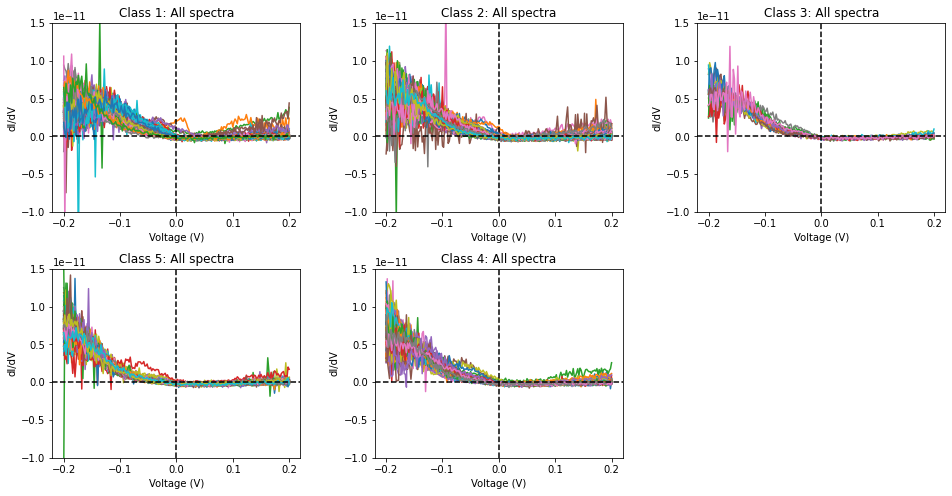

In [ ]:
scalefactor = 4  # to go from 512 to 128 pixels

plt.figure(figsize = (16,8))

gs = gridspec.GridSpec(2,3, hspace = 0.3, wspace = 0.3)
ax1 = plt.subplot(gs[0,0])
ax2 = plt.subplot(gs[0,1])
ax3 = plt.subplot(gs[0,2])
ax4 = plt.subplot(gs[1,1])
ax5 = plt.subplot(gs[1,0])

for ii in range(blobclass1.shape[0]):
  ax1.plot(z_axis,exp_cits[int(round(com[blobclass1[ii],0]/scalefactor)),int(round(com[blobclass1[ii],1]/scalefactor)),:])
ax1.set_ylim(-1E-11,1.5E-11)
ax1.axvline(0,c='k',ls='--')
ax1.axhline(0,c='k',ls='--')
ax1.set_title("Class 1: All spectra")
ax1.set_xlabel('Voltage (V)')
ax1.set_ylabel('dI/dV')

for ii in range(blobclass2.shape[0]):
  ax2.plot(z_axis,exp_cits[int(round(com[blobclass2[ii],0]/scalefactor)),int(round(com[blobclass2[ii],1]/scalefactor)),:])
ax2.set_ylim(-1E-11,1.5E-11)
ax2.axvline(0,c='k',ls='--')
ax2.axhline(0,c='k',ls='--')
ax2.set_title("Class 2: All spectra")
ax2.set_xlabel('Voltage (V)')
ax2.set_ylabel('dI/dV')

for ii in range(blobclass3.shape[0]):
  ax3.plot(z_axis,exp_cits[int(round(com[blobclass3[ii],0]/scalefactor)),int(round(com[blobclass3[ii],1]/scalefactor)),:])
ax3.set_ylim(-1E-11,1.5E-11)
ax3.axvline(0,c='k',ls='--')
ax3.axhline(0,c='k',ls='--')
ax3.set_title("Class 3: All spectra")
ax3.set_xlabel('Voltage (V)')
ax3.set_ylabel('dI/dV')

for ii in range(blobclass4.shape[0]):
  ax4.plot(z_axis,exp_cits[int(round(com[blobclass4[ii],0]/scalefactor)),int(round(com[blobclass4[ii],1]/scalefactor)),:])
ax4.set_ylim(-1E-11,1.5E-11)
ax4.axvline(0,c='k',ls='--')
ax4.axhline(0,c='k',ls='--')
ax4.set_title("Class 4: All spectra")
ax4.set_xlabel('Voltage (V)')
ax4.set_ylabel('dI/dV')

for ii in range(blobclass5.shape[0]):
  ax5.plot(z_axis,exp_cits[int(round(com[blobclass5[ii],0]/scalefactor)),int(round(com[blobclass5[ii],1]/scalefactor)),:])
ax5.set_ylim(-1E-11,1.5E-11)
ax5.axvline(0,c='k',ls='--')
ax5.axhline(0,c='k',ls='--')
ax5.set_title("Class 5: All spectra");
ax5.set_xlabel('Voltage (V)')
ax5.set_ylabel('dI/dV')

Text(0, 0.5, 'dI/dV')

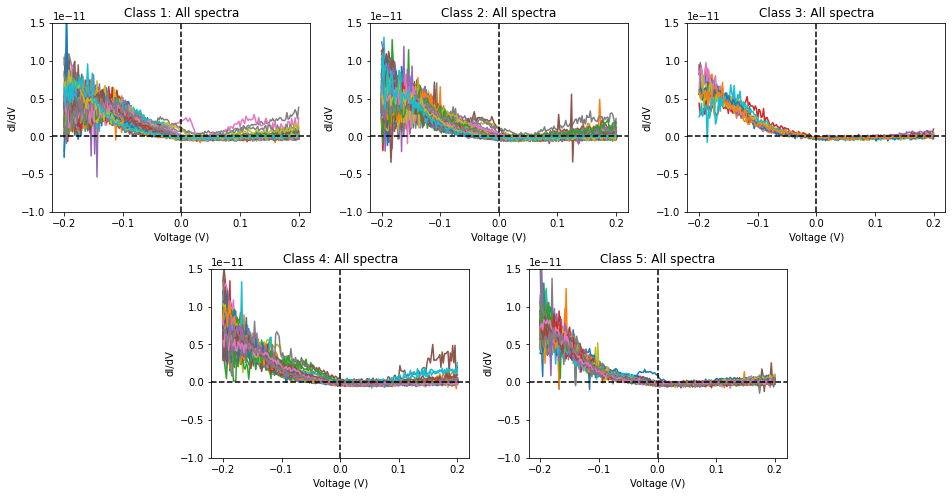

In [ ]:
scalefactor = 4  # to go from 512 to 128 pixels

plt.figure(figsize = (16,8))

gs = gridspec.GridSpec(2,6, hspace = 0.3, wspace = 0.6)
ax1 = plt.subplot(gs[0,0:2])
ax2 = plt.subplot(gs[0,2:4])
ax3 = plt.subplot(gs[0,4:6])
ax4 = plt.subplot(gs[1,1:3])
ax5 = plt.subplot(gs[1,3:5])

for ii in range(blobclass1.shape[0]):
  ax1.plot(z_axis,exp_cits[int(round(com[blobclass1[ii],0]/scalefactor)),int(round(com[blobclass1[ii],1]/scalefactor)),:])
ax1.set_ylim(-1E-11,1.5E-11)
ax1.axvline(0,c='k',ls='--')
ax1.axhline(0,c='k',ls='--')
ax1.set_title("Class 1: All spectra")
ax1.set_xlabel('Voltage (V)')
ax1.set_ylabel('dI/dV')

for ii in range(blobclass2.shape[0]):
  ax2.plot(z_axis,exp_cits[int(round(com[blobclass2[ii],0]/scalefactor)),int(round(com[blobclass2[ii],1]/scalefactor)),:])
ax2.set_ylim(-1E-11,1.5E-11)
ax2.axvline(0,c='k',ls='--')
ax2.axhline(0,c='k',ls='--')
ax2.set_title("Class 2: All spectra")
ax2.set_xlabel('Voltage (V)')
ax2.set_ylabel('dI/dV')

for ii in range(blobclass3.shape[0]):
  ax3.plot(z_axis,exp_cits[int(round(com[blobclass3[ii],0]/scalefactor)),int(round(com[blobclass3[ii],1]/scalefactor)),:])
ax3.set_ylim(-1E-11,1.5E-11)
ax3.axvline(0,c='k',ls='--')
ax3.axhline(0,c='k',ls='--')
ax3.set_title("Class 3: All spectra")
ax3.set_xlabel('Voltage (V)')
ax3.set_ylabel('dI/dV')

for ii in range(blobclass4.shape[0]):
  ax4.plot(z_axis,exp_cits[int(round(com[blobclass4[ii],0]/scalefactor)),int(round(com[blobclass4[ii],1]/scalefactor)),:])
ax4.set_ylim(-1E-11,1.5E-11)
ax4.axvline(0,c='k',ls='--')
ax4.axhline(0,c='k',ls='--')
ax4.set_title("Class 4: All spectra")
ax4.set_xlabel('Voltage (V)')
ax4.set_ylabel('dI/dV')

for ii in range(blobclass5.shape[0]):
  ax5.plot(z_axis,exp_cits[int(round(com[blobclass5[ii],0]/scalefactor)),int(round(com[blobclass5[ii],1]/scalefactor)),:])
ax5.set_ylim(-1E-11,1.5E-11)
ax5.axvline(0,c='k',ls='--')
ax5.axhline(0,c='k',ls='--')
ax5.set_title("Class 5: All spectra");
ax5.set_xlabel('Voltage (V)')
ax5.set_ylabel('dI/dV')

In [ ]:
# # didv_class1 = 
# # exp_cits[int(round(com[blobclass1[ii]/scalefactor]))]
# # ax5.plot(z_axis,exp_cits[int(round(com[blobclass5[ii],0]/scalefactor)),int(round(com[blobclass5[ii],1]/scalefactor)),:])
# didv_class1 = np.zeros((blobclass1.shape[0], 201))
# for ii in range(blobclass1.shape[0]):
#   didv_class1[ii] = exp_cits[int(round(com[blobclass1[ii],0]/scalefactor)), int(round(com[blobclass1[ii],1]/scalefactor))]


In [ ]:
# plt.plot(np.mean(didv_class1[:,:],axis=0))

* Take `average` to get a single "component" for each class

In [ ]:
class1all = np.zeros((blobclass1.shape[0],exp_cits.shape[2]))
for ii in range(blobclass1.shape[0]):
  class1all[ii] = exp_cits[int(round(com[blobclass1[ii],0]/scalefactor)),int(round(com[blobclass1[ii],1]/scalefactor)),:]
class1_mean = np.mean(class1all,axis=0)

class2all = np.zeros((blobclass2.shape[0],exp_cits.shape[2]))
for ii in range(blobclass2.shape[0]):
  class2all[ii] = exp_cits[int(round(com[blobclass2[ii],0]/scalefactor)),int(round(com[blobclass2[ii],1]/scalefactor)),:]
class2_mean = np.mean(class2all,axis=0)

class3all = np.zeros((blobclass3.shape[0],exp_cits.shape[2]))
for ii in range(blobclass3.shape[0]):
  class3all[ii] = exp_cits[int(round(com[blobclass3[ii],0]/scalefactor)),int(round(com[blobclass3[ii],1]/scalefactor)),:]
class3_mean = np.mean(class3all,axis=0)

class4all = np.zeros((blobclass4.shape[0],exp_cits.shape[2]))
for ii in range(blobclass4.shape[0]):
  class4all[ii] = exp_cits[int(round(com[blobclass4[ii],0]/scalefactor)),int(round(com[blobclass4[ii],1]/scalefactor)),:]
class4_mean = np.mean(class4all,axis=0)

class5all = np.zeros((blobclass5.shape[0],exp_cits.shape[2]))
for ii in range(blobclass5.shape[0]):
  class5all[ii] = exp_cits[int(round(com[blobclass5[ii],0]/scalefactor)),int(round(com[blobclass5[ii],1]/scalefactor)),:]
class5_mean = np.mean(class5all,axis=0)

In [ ]:
class_mean1 = np.zeros((5,201))
class_mean1[0] = class1_mean
class_mean1[1] = class2_mean
class_mean1[2] = class3_mean
class_mean1[3] = class4_mean
class_mean1[4] = class5_mean

class1_stdev = np.std(class1all,axis=0)
class2_stdev = np.std(class2all,axis=0)
class3_stdev = np.std(class3all,axis=0)
class4_stdev = np.std(class4all,axis=0)
class5_stdev = np.std(class5all,axis=0)

* Export

In [ ]:
# np.savetxt('c1 spectra.csv', class1all)
# np.savetxt('c2 spectra.csv', class2all)
# np.savetxt('c3 spectra.csv', class3all)
# np.savetxt('c4 spectra.csv', class4all)
# np.savetxt('c5 spectra.csv', class5all)

# np.savetxt('classes mean spectra.csv', class_mean1)

* Perhaps it makes sense to get the standard error as well. Need to think about this...

In [ ]:
class1_err = class1_stdev/(blobclass1.shape[0]**0.5)
class2_err = class2_stdev/(blobclass2.shape[0]**0.5)
class3_err = class3_stdev/(blobclass3.shape[0]**0.5)
class4_err = class4_stdev/(blobclass4.shape[0]**0.5)
class5_err = class5_stdev/(blobclass5.shape[0]**0.5)

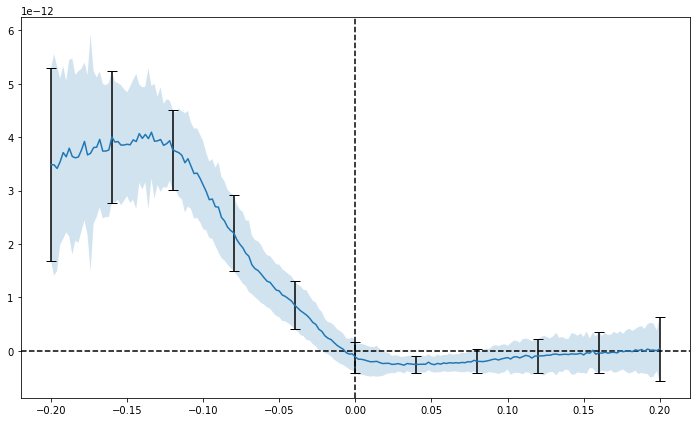

In [ ]:
plt.figure(figsize=(12,7))
plt.errorbar(z_axis, class1_mean, yerr = class1_stdev, ecolor = 'k', errorevery = 20, capsize = 5)
plt.fill_between(z_axis, class1_mean-class1_stdev, class1_mean+class1_stdev, alpha = 0.2)
plt.axvline(0,c='k',ls='--')
plt.axhline(0,c='k',ls='--')

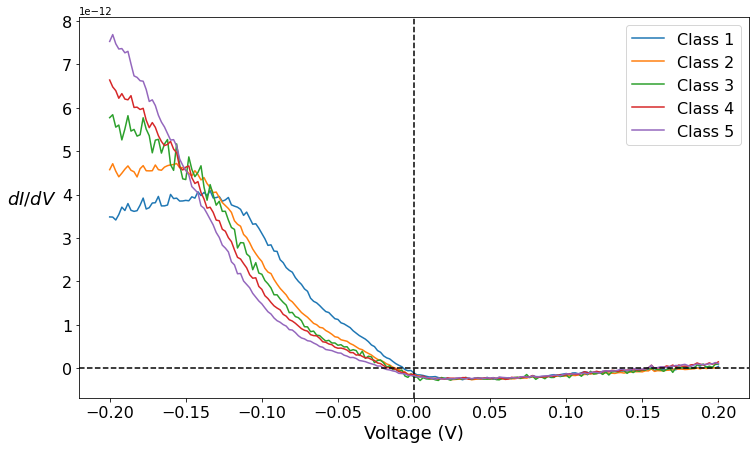

In [ ]:
plt.figure(figsize=(12,7))
plt.plot(z_axis,class1_mean, label = "Class 1")
plt.plot(z_axis,class2_mean, label = "Class 2")
plt.plot(z_axis,class3_mean, label = "Class 3")
plt.plot(z_axis,class4_mean, label = "Class 4")
plt.plot(z_axis,class5_mean, label = "Class 5")
plt.axvline(0,c='k',ls='--')
plt.axhline(0,c='k',ls='--')
plt.legend(fontsize = 16);

plt.xlabel('Voltage (V)', size = 18);
plt.ylabel('$dI/dV$', size = 18, rotation = 0, labelpad = 30);
plt.tick_params(labelsize = 16)

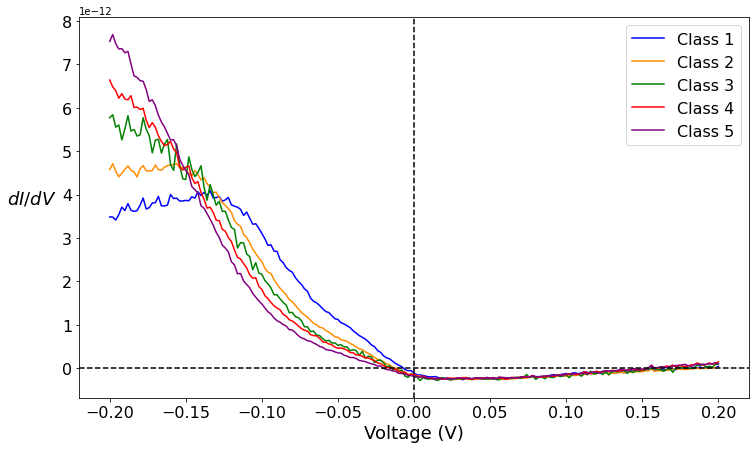

In [ ]:
plt.figure(figsize=(12,7))
plt.plot(z_axis,class1_mean, label = "Class 1", color = 'blue')
plt.plot(z_axis,class2_mean, label = "Class 2", color = 'darkorange')
plt.plot(z_axis,class3_mean, label = "Class 3", color = 'green')
plt.plot(z_axis,class4_mean, label = "Class 4", color = 'red')
plt.plot(z_axis,class5_mean, label = "Class 5", color = 'purple')
plt.axvline(0,c='k',ls='--')
plt.axhline(0,c='k',ls='--')


plt.legend(fontsize = 16)
plt.xlabel('Voltage (V)', size = 18);
plt.ylabel('$dI/dV$', size = 18, rotation = 0, labelpad = 30);
plt.tick_params(labelsize = 16)

# plt.fill_between(z_axis, class1_mean-class1_stdev, class1_mean+class1_stdev, color = 'blue', alpha = 0.2)
# plt.fill_between(z_axis, class2_mean-class2_stdev, class2_mean+class2_stdev, color = 'orange', alpha = 0.2)
# plt.fill_between(z_axis, class3_mean-class3_stdev, class3_mean+class3_stdev, color = 'green', alpha = 0.2)
# plt.fill_between(z_axis, class4_mean-class4_stdev, class4_mean+class4_stdev, color = 'red', alpha = 0.2)
# plt.fill_between(z_axis, class5_mean-class5_stdev, class5_mean+class5_stdev, color = 'purple', alpha = 0.2)

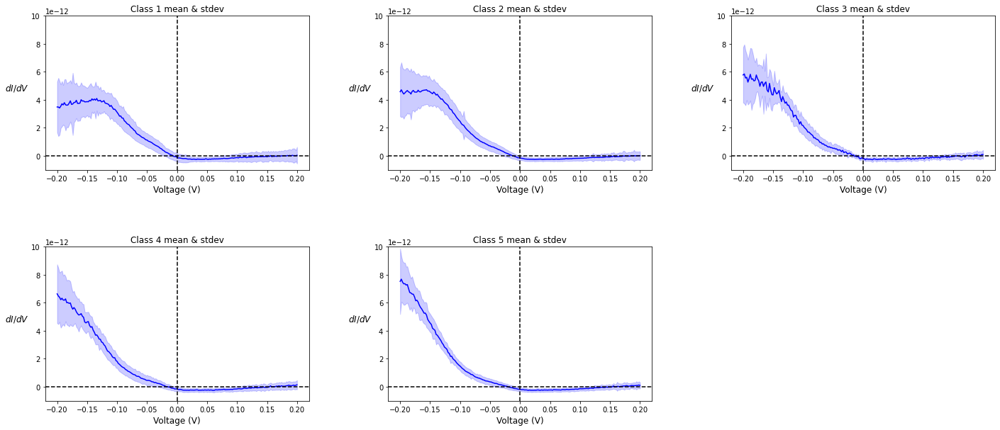

In [ ]:
plt.figure(figsize = (24,10))
gs = gridspec.GridSpec(2,3,hspace = 0.5, wspace = 0.3)
ax1 = plt.subplot(gs[0,0])
ax2 = plt.subplot(gs[0,1])
ax3 = plt.subplot(gs[0,2])
ax4 = plt.subplot(gs[1,0])
ax5 = plt.subplot(gs[1,1])

ax1.plot(z_axis,class1_mean, label = "Class 1", color = 'blue')
ax1.fill_between(z_axis, class1_mean-class1_stdev, class1_mean+class1_stdev, color = 'blue', alpha = 0.2)
ax2.plot(z_axis,class2_mean, label = "Class 2", color = 'blue')
ax2.fill_between(z_axis, class2_mean-class2_stdev, class2_mean+class2_stdev, color = 'blue', alpha = 0.2)
ax3.plot(z_axis,class3_mean, label = "Class 3", color = 'blue')
ax3.fill_between(z_axis, class3_mean-class3_stdev, class3_mean+class3_stdev, color = 'blue', alpha = 0.2)
ax4.plot(z_axis,class4_mean, label = "Class 4", color = 'blue')
ax4.fill_between(z_axis, class4_mean-class4_stdev, class4_mean+class4_stdev, color = 'blue', alpha = 0.2)
ax5.plot(z_axis,class5_mean, label = "Class 5", color = 'blue')
ax5.fill_between(z_axis, class5_mean-class5_stdev, class5_mean+class5_stdev, color = 'blue', alpha = 0.2)

ax1.set_title('Class 1 mean & stdev')
ax2.set_title('Class 2 mean & stdev')
ax3.set_title('Class 3 mean & stdev')
ax4.set_title('Class 4 mean & stdev')
ax5.set_title('Class 5 mean & stdev')

ax1.set_xlabel('Voltage (V)', size = 12);
ax1.set_ylabel('$dI/dV$', size = 12, rotation = 0, labelpad = 20);
ax2.set_xlabel('Voltage (V)', size = 12);
ax2.set_ylabel('$dI/dV$', size = 12, rotation = 0, labelpad = 20);
ax3.set_xlabel('Voltage (V)', size = 12);
ax3.set_ylabel('$dI/dV$', size = 12, rotation = 0, labelpad = 20);
ax4.set_xlabel('Voltage (V)', size = 12);
ax4.set_ylabel('$dI/dV$', size = 12, rotation = 0, labelpad = 20);
ax5.set_xlabel('Voltage (V)', size = 12);
ax5.set_ylabel('$dI/dV$', size = 12, rotation = 0, labelpad = 20);

ax1.axhline(0, ls = '--', c='k')
ax1.axvline(0, ls = '--', c='k')
ax2.axhline(0, ls = '--', c='k')
ax2.axvline(0, ls = '--', c='k')
ax3.axhline(0, ls = '--', c='k')
ax3.axvline(0, ls = '--', c='k')
ax4.axhline(0, ls = '--', c='k')
ax4.axvline(0, ls = '--', c='k')
ax5.axhline(0, ls = '--', c='k')
ax5.axvline(0, ls = '--', c='k')

ax1.set_ylim(-0.1E-11,1E-11)
ax2.set_ylim(-0.1E-11,1E-11)
ax3.set_ylim(-0.1E-11,1E-11)
ax4.set_ylim(-0.1E-11,1E-11)
ax5.set_ylim(-0.1E-11,1E-11);

In [ ]:
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

[]

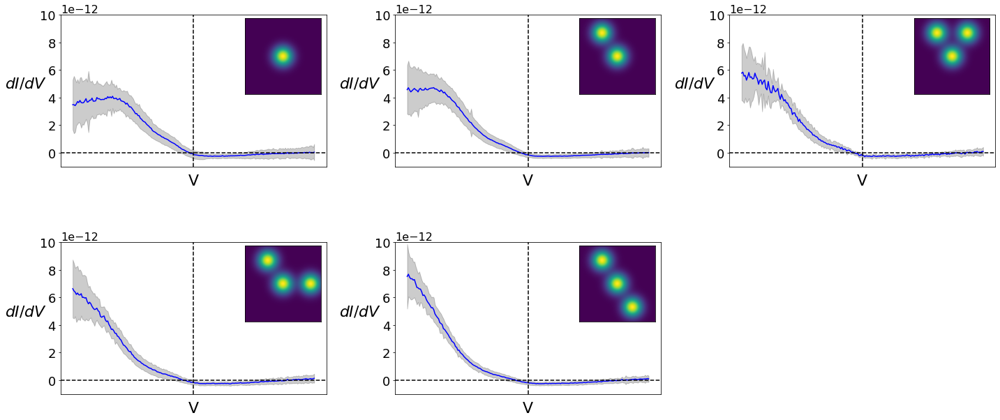

In [ ]:
plt.figure(figsize = (24,10))
gs = gridspec.GridSpec(2,6,hspace = 0.5, wspace = 0.7)
ax1 = plt.subplot(gs[0,0:2])
ax2 = plt.subplot(gs[0,2:4])
ax3 = plt.subplot(gs[0,4:6])
ax4 = plt.subplot(gs[1,0:2])
ax5 = plt.subplot(gs[1,2:4])

ax1.plot(z_axis,class1_mean, label = "Class 1", color = 'blue')
ax1.fill_between(z_axis, class1_mean-class1_stdev, class1_mean+class1_stdev, color = 'k', alpha = 0.2)
ax2.plot(z_axis,class2_mean, label = "Class 2", color = 'blue')
ax2.fill_between(z_axis, class2_mean-class2_stdev, class2_mean+class2_stdev, color = 'k', alpha = 0.2)
ax3.plot(z_axis,class3_mean, label = "Class 3", color = 'blue')
ax3.fill_between(z_axis, class3_mean-class3_stdev, class3_mean+class3_stdev, color = 'k', alpha = 0.2)
ax4.plot(z_axis,class4_mean, label = "Class 4", color = 'blue')
ax4.fill_between(z_axis, class4_mean-class4_stdev, class4_mean+class4_stdev, color = 'k', alpha = 0.2)
ax5.plot(z_axis,class5_mean, label = "Class 5", color = 'blue')
ax5.fill_between(z_axis, class5_mean-class5_stdev, class5_mean+class5_stdev, color = 'k', alpha = 0.2)

axs = [ax1,ax2,ax3,ax4,ax5]
ylim1, ylim2 = -0.1E-11,1E-11
for ii in range(len(axs)):
  axs[ii].set_xlabel('V', size = 22, labelpad = 10)
  axs[ii].set_ylabel('$dI/dV$', size = 22, rotation = 0, labelpad = 20)
  axs[ii].axhline(0, ls = '--', c='k')
  axs[ii].axvline(0, ls = '--', c='k')
  axs[ii].set_ylim(ylim1, ylim2)
  axs[ii].tick_params(labelsize = 18)
  axs[ii].yaxis.get_offset_text().set(size=16)


inset1 = inset_axes(ax1, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax1.transAxes)
inset2 = inset_axes(ax2, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax2.transAxes)
inset3 = inset_axes(ax3, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax3.transAxes)
inset4 = inset_axes(ax4, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax4.transAxes)
inset5 = inset_axes(ax5, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax5.transAxes)

try:
  inset1.imshow(atom0)
  inset2.imshow(atom0 + atom1)
  inset3.imshow(atom0 + atom1 + atom2)
  inset4.imshow(atom0 + atom1 + atom3)
  inset5.imshow(atom0 + atom1 + atom4)
except NameError:
  inset1.imshow(class1_dict[1])
  inset2.imshow(class2_dict[1])
  inset3.imshow(class3_dict[1])
  inset4.imshow(class4_dict[1])
  inset5.imshow(class5_dict[1])
  
plt.setp([inset1, inset2, inset3, inset4, inset5],xticks=[],yticks=[])


plt.setp([axs], xticks=[])

In [ ]:
class1_dict[1]

array([[5.87541323e-15, 6.67771528e-15, 7.58576493e-15, ...,
        7.58576493e-15, 6.67771528e-15, 5.87541323e-15],
       [6.67771528e-15, 7.58957363e-15, 8.62161968e-15, ...,
        8.62161968e-15, 7.58957363e-15, 6.67771528e-15],
       [7.58576493e-15, 8.62161968e-15, 9.79400552e-15, ...,
        9.79400552e-15, 8.62161968e-15, 7.58576493e-15],
       ...,
       [7.58576493e-15, 8.62161968e-15, 9.79400552e-15, ...,
        9.79400552e-15, 8.62161968e-15, 7.58576493e-15],
       [6.67771528e-15, 7.58957363e-15, 8.62161968e-15, ...,
        8.62161968e-15, 7.58957363e-15, 6.67771528e-15],
       [5.87541323e-15, 6.67771528e-15, 7.58576493e-15, ...,
        7.58576493e-15, 6.67771528e-15, 5.87541323e-15]])

In [ ]:
insetclass1 = atom0
insetclass2 = atom0 + atom1
insetclass3 = atom0 + atom1 + atom2
insetclass4 = atom0 + atom1 + atom3
insetclass5 = atom0 + atom1 + atom4

np.save("insetclass1.npy", insetclass1)
np.save("insetclass2.npy", insetclass2)
np.save("insetclass3.npy", insetclass3)
np.save("insetclass4.npy", insetclass4)
np.save("insetclass5.npy", insetclass5)

NameError: ignored

Trying to show image in legend:

In [ ]:
import os

from matplotlib.transforms import TransformedBbox
from matplotlib.image import BboxImage
from matplotlib.legend_handler import HandlerBase
from matplotlib._png import read_png

class ImageHandler(HandlerBase):
    def create_artists(self, legend, orig_handle,
                       xdescent, ydescent, width, height, fontsize,
                       trans):

        # enlarge the image by these margins
        sx, sy = self.image_stretch 

        # create a bounding box to house the image
        bb = Bbox.from_bounds(xdescent - sx,
                              ydescent - sy,
                              width + sx,
                              height + sy)

        tbb = TransformedBbox(bb, trans)
        image = BboxImage(tbb)
        image.set_data(self.image_data)

        self.update_prop(image, orig_handle, legend)

        return [image]

    def set_image(self, image_path, image_stretch=(0, 0)):
        if not os.path.exists(image_path):
            sample = get_sample_data("grace_hopper.png", asfileobj=False)
            self.image_data = read_png(sample)
        else:
            self.image_data = read_png(image_path)

        self.image_stretch = image_stretch

TypeError: ignored

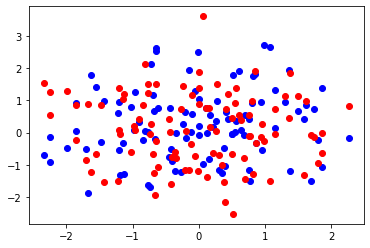

In [ ]:

# random data
x = np.random.randn(100)
y = np.random.randn(100)
y2 = np.random.randn(100)

# plot two series of scatter data
s = plt.scatter(x, y, c='b')
s2 = plt.scatter(x, y2, c='r')

# setup the handler instance for the scattered data
custom_handler = ImageHandler()
custom_handler.set_image("\insetclass1.png",
                         image_stretch=(0, 20)) # this is for grace hopper

# add the legend for the scattered data, mapping the
# scattered points to the custom handler
plt.legend([s, s2],
           ['Scatters 1', 'Scatters 2'],
           handler_map={s: custom_handler, s2: custom_handler},
           labelspacing=2,
           frameon=False)

In [ ]:
plt.figure(figsize=(12,7))
plt.plot(z_axis,class1_mean, label = "Class 1", color = 'blue')
plt.plot(z_axis,class2_mean, label = "Class 2", color = 'darkorange')
plt.plot(z_axis,class3_mean, label = "Class 3", color = 'green')
plt.plot(z_axis,class4_mean, label = "Class 4", color = 'red')
plt.plot(z_axis,class5_mean, label = "Class 5", color = 'purple')
plt.axvline(0,c='k',ls='--')
plt.axhline(0,c='k',ls='--')


plt.legend(fontsize = 16)
plt.xlabel('Voltage (V)', size = 18);
plt.ylabel('$dI/dV$', size = 18, rotation = 0, labelpad = 30);
plt.tick_params(labelsize = 16)

NameError: ignored

<Figure size 864x504 with 0 Axes>

[]

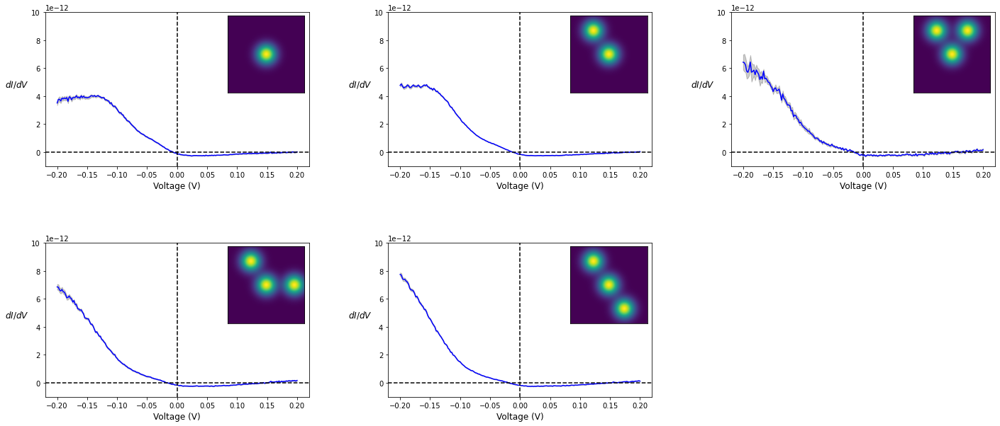

In [ ]:
## STANDARD ERROR instead of STANDARD DEVIATION 

plt.figure(figsize = (24,10))
gs = gridspec.GridSpec(2,3,hspace = 0.5, wspace = 0.3)
ax1 = plt.subplot(gs[0,0])
ax2 = plt.subplot(gs[0,1])
ax3 = plt.subplot(gs[0,2])
ax4 = plt.subplot(gs[1,0])
ax5 = plt.subplot(gs[1,1])

ax1.plot(z_axis,class1_mean, label = "Class 1", color = 'blue')
ax1.fill_between(z_axis, class1_mean-class1_err, class1_mean+class1_err, color = 'k', alpha = 0.2)
ax2.plot(z_axis,class2_mean, label = "Class 2", color = 'blue')
ax2.fill_between(z_axis, class2_mean-class2_err, class2_mean+class2_err, color = 'k', alpha = 0.2)
ax3.plot(z_axis,class3_mean, label = "Class 3", color = 'blue')
ax3.fill_between(z_axis, class3_mean-class3_err, class3_mean+class3_err, color = 'k', alpha = 0.2)
ax4.plot(z_axis,class4_mean, label = "Class 4", color = 'blue')
ax4.fill_between(z_axis, class4_mean-class4_err, class4_mean+class4_err, color = 'k', alpha = 0.2)
ax5.plot(z_axis,class5_mean, label = "Class 5", color = 'blue')
ax5.fill_between(z_axis, class5_mean-class5_err, class5_mean+class5_err, color = 'k', alpha = 0.2)

# ax1.set_title('Class 1: Mean & standard error')
# ax2.set_title('Class 2: Mean & standard error')
# ax3.set_title('Class 3: Mean & standard error')
# ax4.set_title('Class 4: Mean & standard error')
# ax5.set_title('Class 5: Mean & standard error')

ax1.set_xlabel('Voltage (V)', size = 12);
ax1.set_ylabel('$dI/dV$', size = 12, rotation = 0, labelpad = 20);
ax2.set_xlabel('Voltage (V)', size = 12);
ax2.set_ylabel('$dI/dV$', size = 12, rotation = 0, labelpad = 20);
ax3.set_xlabel('Voltage (V)', size = 12);
ax3.set_ylabel('$dI/dV$', size = 12, rotation = 0, labelpad = 20);
ax4.set_xlabel('Voltage (V)', size = 12);
ax4.set_ylabel('$dI/dV$', size = 12, rotation = 0, labelpad = 20);
ax5.set_xlabel('Voltage (V)', size = 12);
ax5.set_ylabel('$dI/dV$', size = 12, rotation = 0, labelpad = 20);

ax1.axhline(0, ls = '--', c='k')
ax1.axvline(0, ls = '--', c='k')
ax2.axhline(0, ls = '--', c='k')
ax2.axvline(0, ls = '--', c='k')
ax3.axhline(0, ls = '--', c='k')
ax3.axvline(0, ls = '--', c='k')
ax4.axhline(0, ls = '--', c='k')
ax4.axvline(0, ls = '--', c='k')
ax5.axhline(0, ls = '--', c='k')
ax5.axvline(0, ls = '--', c='k')

ax1.set_ylim(-0.1E-11,1E-11)
ax2.set_ylim(-0.1E-11,1E-11)
ax3.set_ylim(-0.1E-11,1E-11)
ax4.set_ylim(-0.1E-11,1E-11)
ax5.set_ylim(-0.1E-11,1E-11);

inset1 = inset_axes(ax1, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax1.transAxes)
inset2 = inset_axes(ax2, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax2.transAxes)
inset3 = inset_axes(ax3, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax3.transAxes)
inset4 = inset_axes(ax4, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax4.transAxes)
inset5 = inset_axes(ax5, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax5.transAxes)

inset1.imshow(atom0)
inset2.imshow(atom0 + atom1)
inset3.imshow(atom0 + atom1 + atom2)
inset4.imshow(atom0 + atom1 + atom3)
inset5.imshow(atom0 + atom1 + atom4)

plt.setp([inset1, inset2, inset3, inset4, inset5],xticks=[],yticks=[])

* There seems to be some variation within class 1 (this same subsequent analysis can be done for any class)
* Let's see how PCA works on JUST class 1 cropped images, maybe there is something there we do not understand:

# PCA <font color = 'crimson'>within</font> classes: further classification
* additional analysis that surpasses our initial expectations regarding the existence of 5 distinct classes. 
* It appears there is more to the story within some classes. 
* Let's check this out, starting with class 1 (there seems to be the most variability there)

      --- Process ---
        1. Mask all classes but the one of interest (i.e., set all pixels to   
           zero except those belonging to the class we are deconvolving)
        2. Carry the masking to the spectral (3rd) dimension.
        3. Perform PCA on the <u>masked</u> hyperspectral data, such that we
           only decompose one structural class at a time

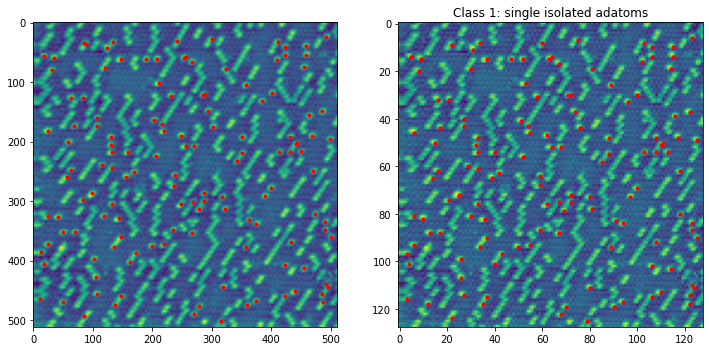

In [ ]:
# get the coordinates from the center of masses for a class. Class 1 first:
class1positions = []

for ii in range(blobclass1.shape[0]):
  class1positions.append((int(round(com[blobclass1[ii],1])),int(round(com[blobclass1[ii],0]))))

# Plot to make sure correct
f,a = plt.subplots(1,2,figsize=(12,6))

for ii in range(len(class1positions)):
  a[0].scatter(class1positions[ii][0], class1positions[ii][1], color = 'r', s = 10)
a[0].imshow(resize(topo_f_n,(512,512)))

a[1].imshow(topo_f_n)
for ii in range(blobclass1.shape[0]):
  a[1].scatter(int(round(com[blobclass1[ii],1]/4)), int(round(com[blobclass1[ii],0]/4)), color = 'r', s = 10)
a[1].set_title('Class 1: single isolated adatoms');

In [ ]:
# x, y, z
# com[blobclass1[ii],1]/4, com[blobclass1[ii],0]/4, exp_cits AT those xy only
# exp_cits.shape
# class1positions[1][0]

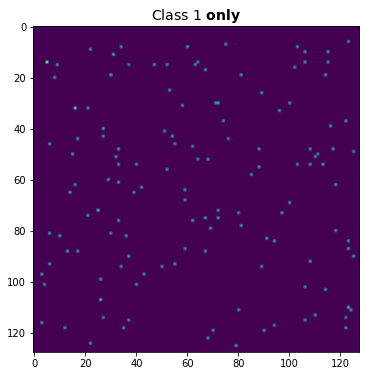

In [ ]:
## Generate array from the (x,y) pairs
Mask1 = np.zeros_like(topo_f_n)
for ii in range(len(class1positions)):
    # Mask1[int(class1positions[ii][0]),int(class1positions[ii][1])] = 1
    Mask1[int(round(com[blobclass1[ii],0]/4)),int(round(com[blobclass1[ii],1]/4))] = 1

## Make sure mask array is correct
# f,a = plt.subplots(1,2,figsize=(14,7))
# a[0].imshow(Mask1,alpha=0.8,cmap='gray_r')
# a[0].imshow(topo_f_n,alpha=0.5)
# a[1].imshow(topo_f_n)

## Mask the SPECTRAL data using the Mask1 array
test1 = np.tile(Mask1, (201,1,1))
test1_ = np.swapaxes(np.swapaxes(test1,0,1), 1,2)
# test1_.shape
class1_masked = test1_*exp_cits

# Flatten this to feed to PCA 
XY = class1_masked.shape[:2]
class1_masked_flat=class1_masked.reshape((np.prod(XY),class1_masked.shape[2]))
# class1_masked_flat.shape

# Show it
plt.figure(figsize=(6,6))
plt.imshow(np.mean(class1_masked[:,:,:],axis=2))
plt.title(r'Class 1 $\bfonly$',fontsize=14);

(128, 128, 201)


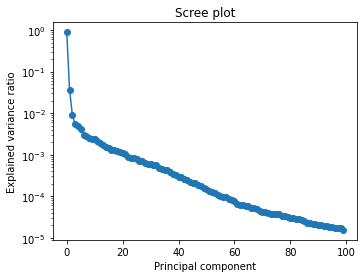

In [ ]:
# Apply PCA to class 1

fig= plt.figure(figsize=(12,4))
gs = gridspec.GridSpec(1,2)
ax1 = plt.subplot(gs[0,0])

pca = PCA()
pca.fit(class1_masked_flat)
explained_var = pca.explained_variance_ratio_

ax1.plot(explained_var[0:100], 'o-')
ax1.semilogy()
ax1.set_xlabel('Principal component')
ax1.set_ylabel('Explained variance ratio');
ax1.set_title('Scree plot')

print(class1_masked.shape)
w, h, n = class1_masked.shape

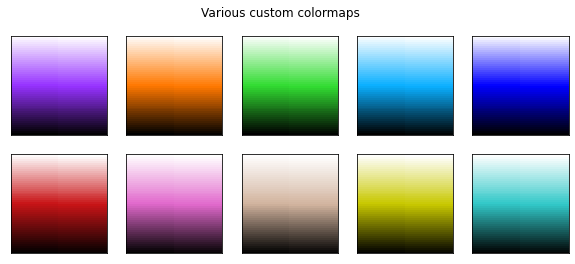

In [ ]:
from matplotlib.colors import LinearSegmentedColormap

data1 = np.linspace(0, 1, 2500).reshape((50, 50))

bPw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (150./255,50/255., 1.),(1,1,1)], N=100)
bOw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (1,120./255, 0),(1,1,1)], N=100)
bGw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (50./255,220./255, 50./255),(1,1,1)], N=100)
bBw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (10./255,175/255., 1.),(1,1,1)], N=100)
bDBw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (0/255,0./255, 255/255),(1,1,1)], N=100)
bRw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (200./255,20/255., 20/225.),(1,1,1)], N=100)
bPiw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (225./255,105/255., 180/225.),(1,1,1)], N=100)
bBrw= LinearSegmentedColormap.from_list('list', [(0, 0, 0), (210./255,180/255., 140/225.),(1,1,1)], N=100)
bYw= LinearSegmentedColormap.from_list('list', [(0, 0, 0), (200./255,200/255., 0/225.),(1,1,1)], N=100)
bLGw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (50./255, 200/255, 200/255),(1,1,1)], N=100)

cmaps = [bPw,bOw,bGw,bBw,bDBw,bRw,bPiw,bBrw,bYw,bLGw]

rows = int(np.ceil(float(len(cmaps))/5))
cols = int(np.ceil(float(len(cmaps))/rows))
gs1 = gridspec.GridSpec(rows, cols)
fig = plt.figure(figsize = (2*cols, 2*(1+rows//2)))
fig.suptitle('Various custom colormaps')
for i in range(len(cmaps)):
    ax1 = fig.add_subplot(gs1[i])
    ax1.pcolormesh(data1,cmap=cmaps.pop(0))
    plt.setp([ax1], xticks = [], yticks =[])

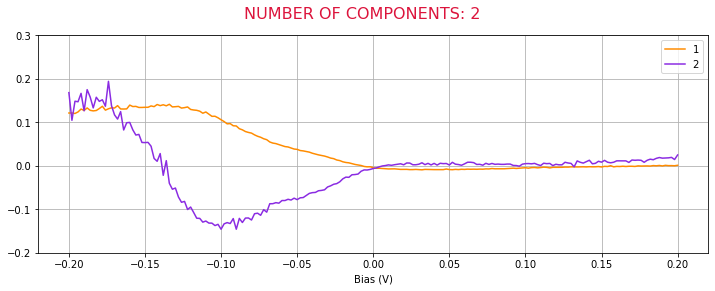

<Figure size 432x288 with 0 Axes>

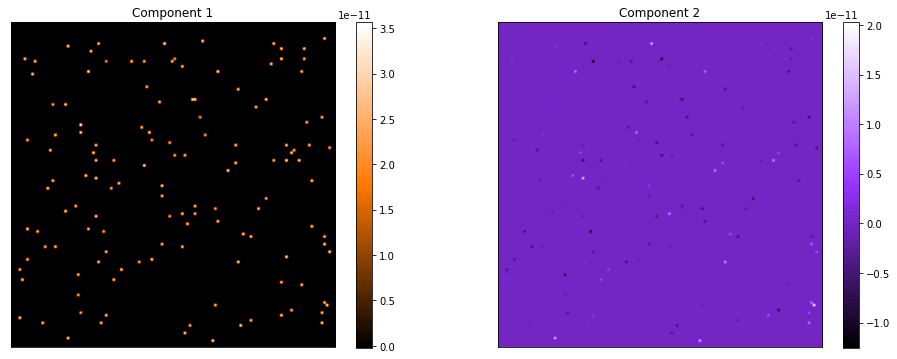

<Figure size 432x288 with 0 Axes>

In [ ]:
nc = 2
cmaps=[bOw, bPw, bBw, bRw, bGw, bBrw, bPiw, bYw, bLGw]
colors=['DarkOrange','BlueViolet','DodgerBlue','Crimson','MediumSeaGreen','Tan','HotPink','Yellow','green', 'black']
clf = PCA(n_components=nc)
X_vec_t = clf.fit_transform(class1_masked_flat)
components = clf.components_
X_vec_t = X_vec_t.reshape(w, h, nc)
rows = int(np.ceil(float(nc)/5))
cols = int(np.ceil(float(nc)/rows))
     
fig1,ax1 = plt.subplots(figsize = (12,4))

plt.suptitle("NUMBER OF COMPONENTS: {}".format(nc), fontsize = 16, color = 'Crimson')
for i in range(nc):
    ax1.plot(z_axis,components[i], color = colors.pop(0), label = i+1)
    ax1.grid(True)
#     ax1.set_xticks(np.arange(0,3.5, step=0.1));
    ax1.set_ylim(-0.2,0.3)
    ax1.set_xlabel('Bias (V)')
    ax1.tick_params(labelsize=10)
    ax1.legend(loc = 'upper right')
plt.show()
plt.savefig("PCA spectra on adatoms only.jpg")

gs2 = gridspec.GridSpec(rows, cols)
fig2 = plt.figure(figsize = (8*cols, 6*(1+rows//2)))   
for i in range(nc):
    ax2 = fig2.add_subplot(gs2[i])
    im2 = ax2.imshow(X_vec_t[:, : ,i],cmap = cmaps.pop(0))
    ax2.set_title('Component ' + str(i + 1))
    plt.colorbar(im2, ax=ax2)
    plt.setp([ax2],xticks=[], yticks=[])
plt.show()
# plt.savefig("PCA spectra on adatoms only")
plt.savefig("PCA loading maps on adatoms only.jpg")

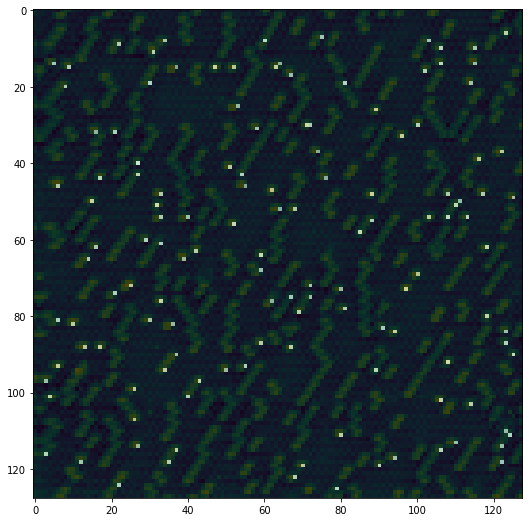

In [ ]:
plt.figure(figsize=(9,9))
plt.imshow(topo_f_n)
plt.imshow(X_vec_t[:,:,0], cmap = 'gray', alpha = 0.7)

## Analyzing PCA on already-classified classes:
1) Threshold an individual component (component 0, for example) to sub-classify the main component based on intensity [[<font color='crimson'>This seems like too much user input here to determine a threshold WITHIN a single component</font>]], or

2) literally use the second PCA component as another class (unclear at the moment, return to this)

### Thresholding component 0 of Class 1

In [ ]:
Class1_PCA0 = X_vec_t[:,:,0]

#normalize [0,1]
Class1_PCA0_n = (Class1_PCA0 - np.min(Class1_PCA0))/np.ptp(Class1_PCA0)

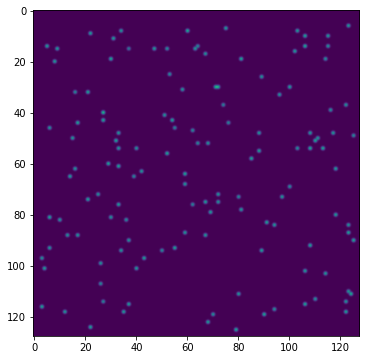

In [ ]:
pca0min = 0
pca0max = 1

plt.figure(figsize=(6,6))
plt.imshow(Class1_PCA0_n, vmin = pca0min, vmax = pca0max, interpolation = 'gaussian')

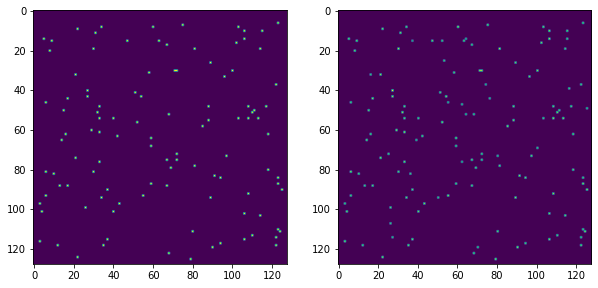

In [ ]:
thresh1 = 0.75
Class1_PCA0_n_c = np.copy(Class1_PCA0_n)
Class1_PCA0_n_c[np.where(Class1_PCA0_n_c >= thresh1)] = 1
Class1_PCA0_n_c[np.where(Class1_PCA0_n_c < thresh1)] = 0

f,a = plt.subplots(1,2,figsize=(10,5))
a[0].imshow(Class1_PCA0_n_c)
a[1].imshow(Class1_PCA0_n)

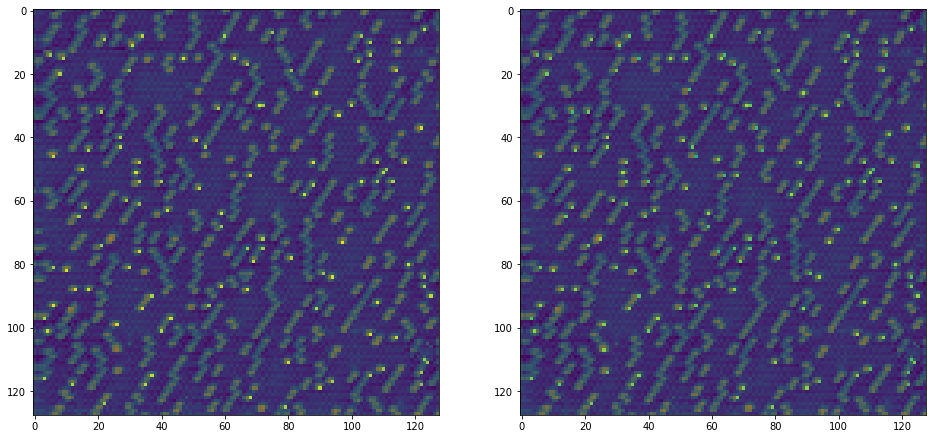

In [ ]:
fig,ax = plt.subplots(1,2,figsize = (16,8))
ax[0].imshow(topo_f_n)
ax[0].imshow(Class1_PCA0_n_c, alpha = 0.5)

ax[1].imshow(topo_f_n)
ax[1].imshow(Class1_PCA0_n, alpha = 0.5)

* How to reasonably choose a threshold? There does not appear a clear way of doing this. Plus, if PCA grouped these as a single component, aren't they essentially spectrally similar?
* Obviously there is some difference within the component (intensity difference???), but there is likely a LARGER difference when comparing to the second PCA component (which is component 1)

### Use <font color = 'crimson'>second PCA component</font> as secondary class (the thresholding component):

* There is still some kind of thresholding that needs to be done here.
* --> That's because every pixel will receive a value, none will strictly be ZERO.
* So, maybe we can threshold this around say, 10 or 20% 
* i.e., if value is above 10 or 20%, count this pixel (this atom) as an additional class, & null others

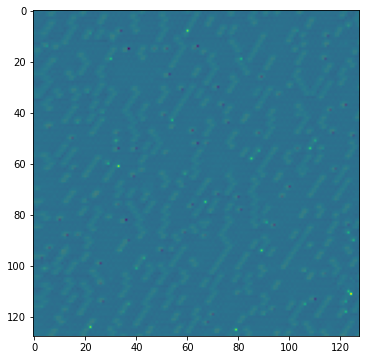

In [ ]:
Class1_PCA0 = X_vec_t[:,:,0]
Class1_PCA1 = X_vec_t[:,:,1]

#normalize [0,1]
Class1_PCA0_n = (Class1_PCA0 - np.min(Class1_PCA0))/np.ptp(Class1_PCA0)
Class1_PCA1_n = (Class1_PCA1 - np.min(Class1_PCA1))/np.ptp(Class1_PCA1)

plt.figure(figsize=(6,6))
plt.imshow(topo_f_n)
plt.imshow(Class1_PCA1_n, vmin = 0, alpha = 0.9)

In [ ]:
# The background should be zero (why is it not?? How can the PCA extrapolate? Seems like just some kind of offset to the background..)
# So, let's multiply these by the mask we generated earlier

(0.0, 1.0)

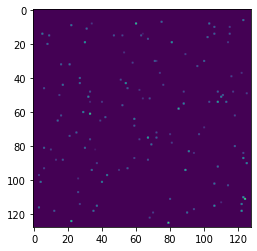

In [ ]:
Class1_PCA1_n_masked = Mask1*Class1_PCA1_n

plt.figure(figsize=(4,4))
plt.imshow(Class1_PCA1_n_masked)
np.min(Class1_PCA1_n_masked), np.max(Class1_PCA1_n_masked)

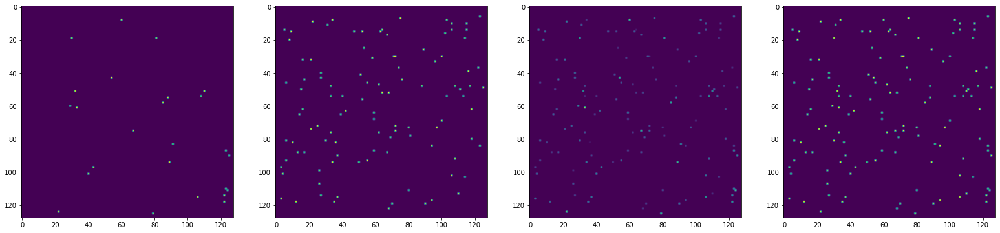

In [ ]:
thresh1 = 0.5
thresh2 = 0.001

# separate the atoms by a threshold value 

# first step is to set all atoms above threshold to 1, and all others to zero.
# This generates a map of only the stronger adatoms (stronger in the PCA component sense)
Class1_PCA1_n_c = np.copy(Class1_PCA1_n_masked)
Class1_PCA1_n_c[np.where(Class1_PCA1_n_c >= thresh1)] = 1
Class1_PCA1_n_c[np.where(Class1_PCA1_n_c < thresh1)] = 0

# Then, to get the remaining atoms, we subtract the ones in previous step from the
# original. And with the original, 

Class1_PCA1_b = Class1_PCA1_n_masked - Class1_PCA1_n_c
Class1_PCA1_b[np.where(Class1_PCA1_b >= thresh2)] = 1
Class1_PCA1_b[np.where(Class1_PCA1_b < thresh2)] = 0


f,a = plt.subplots(1,4,figsize=(27,14))
a[0].imshow(Class1_PCA1_n_c)
a[1].imshow(Class1_PCA1_b)
a[2].imshow(Class1_PCA1_n_masked)
a[3].imshow(Class1_PCA1_n_c + Class1_PCA1_b)

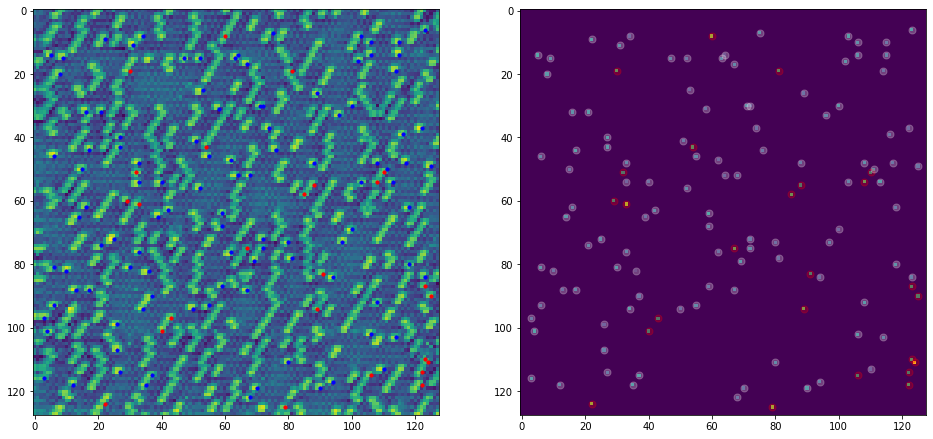

In [ ]:
# Separated Class 1 into two categories: strong PCA1 above 50% intensity in that component (a), and the rest (b)

Class1_PCA1_coords_a = np.argwhere(Class1_PCA1_n_c == 1)
Class1_PCA1_coords_b = np.argwhere(Class1_PCA1_b == 1)

f,a = plt.subplots(1,2,figsize=(16,8))
a[0].imshow(topo_f_n)
for ii in range(Class1_PCA1_coords_a.shape[0]):
  a[0].scatter(Class1_PCA1_coords_a[ii][1], Class1_PCA1_coords_a[ii][0], color = 'r', s = 10)
for ii in range(Class1_PCA1_coords_b.shape[0]): 
  a[0].scatter(Class1_PCA1_coords_b[ii][1], Class1_PCA1_coords_b[ii][0], color = 'b', s = 10)

a[1].imshow(Class1_PCA1_n_masked)
for ii in range(Class1_PCA1_coords_a.shape[0]):
  a[1].scatter(Class1_PCA1_coords_a[ii][1], Class1_PCA1_coords_a[ii][0], color = 'r', s = 50, alpha = 0.25)
for ii in range(Class1_PCA1_coords_b.shape[0]): 
  a[1].scatter(Class1_PCA1_coords_b[ii][1], Class1_PCA1_coords_b[ii][0], color = 'w', s = 50, alpha = 0.25)

In [ ]:
Class1_PCA1_coords_a.shape, Class1_PCA1_coords_b.shape

((25, 2), (106, 2))

In [ ]:
# thresh1 = 0.5

# Class1_PCA1_n_c = np.copy(Class1_PCA1_n_masked)
# Class1_PCA1_n_c[np.where(Class1_PCA1_n_c >= thresh1)] = 1
# Class1_PCA1_n_c[np.where(Class1_PCA1_n_c < thresh1)] = 0

# f,a = plt.subplots(2,2,figsize=(14,14))
# a[0,0].imshow(Class1_PCA1_n_c)
# a[0,1].imshow(Class1_PCA1_n_masked)
# a[1,0].imshow(topo_f_n)
# a[1,1].imshow(topo_f_n,alpha = 0.00001)

# for ii in range(blobclass1.shape[0]):
#   a[1,0].scatter(int(round(com[blobclass1[ii],1]/4)), int(round(com[blobclass1[ii],0]/4)), color = 'r', s = 10, alpha = 1)
#   a[1,1].scatter(int(round(com[blobclass1[ii],1]/4)), int(round(com[blobclass1[ii],0]/4)), color = 'r', s = 10, alpha = 1)
# # a[1,0].imshow(Class1_PCA1_n_c, alpha = 0.6, cmap = 'seismic')

# for ii in range(Class1_PCA1_coords.shape[0]):
#   a[1,1].scatter(Class1_PCA1_coords[ii][1], Class1_PCA1_coords[ii][0], color = 'g', s = 50, alpha = 0.5)


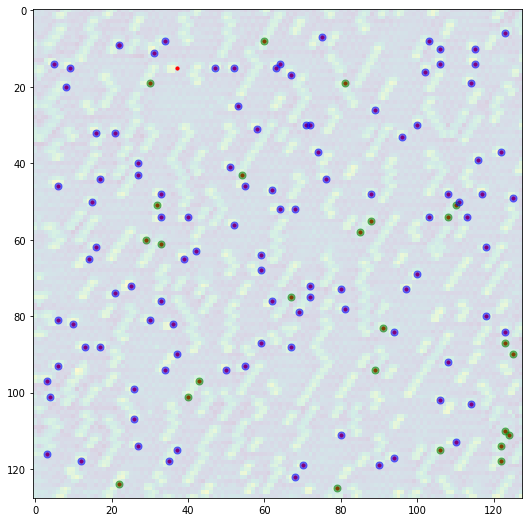

In [ ]:
plt.figure(figsize=(9,9))
plt.imshow(topo_f_n,alpha = 0.2)
for ii in range(blobclass1.shape[0]):
 plt.scatter(int(round(com[blobclass1[ii],1]/4)), int(round(com[blobclass1[ii],0]/4)), color = 'r', s = 10, alpha = 1)

for ii in range(Class1_PCA1_coords_a.shape[0]):
  plt.scatter(Class1_PCA1_coords_a[ii][1], Class1_PCA1_coords_a[ii][0], color = 'g', s = 50, alpha = 0.5)

  
for ii in range(Class1_PCA1_coords_b.shape[0]):
  plt.scatter(Class1_PCA1_coords_b[ii][1], Class1_PCA1_coords_b[ii][0], color = 'b', s = 50, alpha = 0.5)

In [ ]:
### Get the positions of these

# I think the blob detection is WRONG here, because it may (and it does) detect different pixels than 
# were originally within class 1.

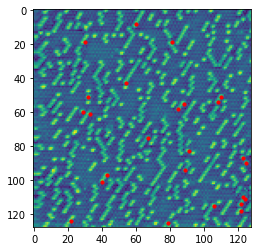

In [ ]:
Class1_PCA1_coords = np.argwhere(Class1_PCA1_n_c == 1)

plt.imshow(topo_f_n)
for ii in range(Class1_PCA1_coords.shape[0]):
  plt.scatter(Class1_PCA1_coords[ii][1], Class1_PCA1_coords[ii][0], color = 'r', s = 10)

In [ ]:
### Using PCA to find the coordinates of supposed spectrally distinct adatoms
### Take the (raw) spectra at all those coordinates and then the mean.
### The mean of these should not be the same as that component, but could be close if they are significant.

### IDEA: Is there a way to iterate this? In other words, this process of thresholding (choosing the amount
### to threshold) to find distinct groups within a class can be iterated until the average of those grouped spectra
### are closest to the PCA component. Would that even work?

scalefactor = 1

class1_pca1 = np.zeros((Class1_PCA1_coords.shape[0],exp_cits.shape[2]))
for ii in range(Class1_PCA1_coords.shape[0]):
  class1_pca1[ii] = exp_cits[int(Class1_PCA1_coords[ii][0]/scalefactor),int(Class1_PCA1_coords[ii][1]/scalefactor),:]
class1_pca1_mean = np.mean(class1_pca1,axis=0)

In [ ]:
thresh2 = 0.001

Class1_PCA0_n_masked = Mask1*Class1_PCA0_n

Class1_PCA0_b = Class1_PCA0_n_masked - Class1_PCA0_n_c
Class1_PCA0_b[np.where(Class1_PCA1_b >= thresh2)] = 1
Class1_PCA0_b[np.where(Class1_PCA1_b < thresh2)] = 0

Class1_PCA0_coords_a = np.argwhere(Class1_PCA0_n_c == 1)
Class1_PCA0_coords_b = np.argwhere(Class1_PCA0_b == 1)

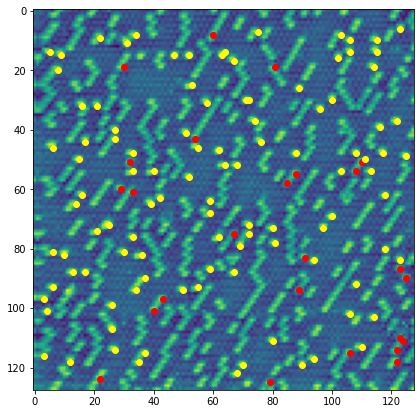

In [ ]:
plt.figure(figsize=(7,7))
plt.imshow(topo_f_n)
plt.scatter(Class1_PCA0_coords_a[:,1], Class1_PCA0_coords_a[:,0], c='r')
plt.scatter(Class1_PCA0_coords_b[:,1], Class1_PCA0_coords_b[:,0], c='yellow')

In [ ]:
Class1_PCA0_coords = np.argwhere(Class1_PCA0_n_c == 1)
class1_pca0 = np.zeros((Class1_PCA0_coords.shape[0],exp_cits.shape[2]))
for ii in range(Class1_PCA0_coords.shape[0]):
  class1_pca0[ii] = exp_cits[int(Class1_PCA0_coords[ii][0]/scalefactor),int(Class1_PCA0_coords[ii][1]/scalefactor),:]
class1_pca0_mean = np.mean(class1_pca0,axis=0)


# into a and b

class1_pca0_a = np.zeros((Class1_PCA0_coords_a.shape[0],exp_cits.shape[2]))
for ii in range(Class1_PCA0_coords_a.shape[0]):
  class1_pca0_a[ii] = exp_cits[int(Class1_PCA0_coords_a[ii][0]/scalefactor),int(Class1_PCA0_coords_a[ii][1]/scalefactor),:]
class1_pca0_a_mean = np.mean(class1_pca0_a,axis=0)

class1_pca0_b = np.zeros((Class1_PCA0_coords_b.shape[0],exp_cits.shape[2]))
for ii in range(Class1_PCA0_coords_b.shape[0]):
  class1_pca0_b[ii] = exp_cits[int(Class1_PCA0_coords_b[ii][0]/scalefactor),int(Class1_PCA0_coords_b[ii][1]/scalefactor),:]
class1_pca0_b_mean = np.mean(class1_pca0_b,axis=0)

In [ ]:
scalefactor = 1

class1_pca1_a = np.zeros((Class1_PCA1_coords_a.shape[0],exp_cits.shape[2]))
for ii in range(Class1_PCA1_coords_a.shape[0]):
  class1_pca1_a[ii] = exp_cits[int(Class1_PCA1_coords_a[ii][0]/scalefactor),int(Class1_PCA1_coords_a[ii][1]/scalefactor),:]
class1_pca1_a_mean = np.mean(class1_pca1_a,axis=0)

class1_pca1_b = np.zeros((Class1_PCA1_coords_b.shape[0],exp_cits.shape[2]))
for ii in range(Class1_PCA1_coords_b.shape[0]):
  class1_pca1_b[ii] = exp_cits[int(Class1_PCA1_coords_b[ii][0]/scalefactor),int(Class1_PCA1_coords_b[ii][1]/scalefactor),:]
class1_pca1_b_mean = np.mean(class1_pca1_b,axis=0)

* Get the standard deviation for a kind of error bar measurement

In [ ]:
class1_pca1_a_stdev = np.std(class1_pca1_a,axis=0)
class1_pca1_b_stdev = np.std(class1_pca1_b,axis=0)

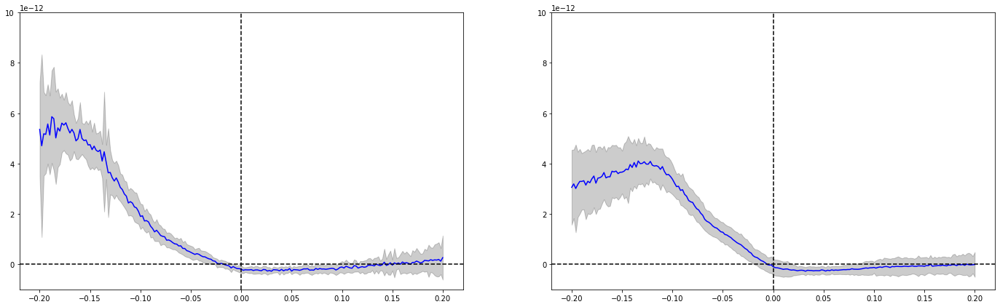

In [ ]:
f,a = plt.subplots(1,2,figsize=(24,7))
a[0].plot(z_axis, class1_pca1_a_mean, color = 'blue')
# plt.errorbar(z_axis, class1_pca1_mean, yerr = class1_pca1_stdev, ecolor = 'k', errorevery = 20, capsize = 5)
a[0].fill_between(z_axis, class1_pca1_a_mean - class1_pca1_a_stdev, class1_pca1_a_mean+class1_pca1_a_stdev, alpha = 0.2, color = 'k')
a[0].axvline(0,c='k',ls='--')
a[0].axhline(0,c='k',ls='--')
a[0].set_ylim(-0.1E-11,1E-11);

a[1].plot(z_axis, class1_pca1_b_mean, color = 'blue')
a[1].fill_between(z_axis, class1_pca1_b_mean - class1_pca1_b_stdev, class1_pca1_b_mean+class1_pca1_b_stdev, alpha = 0.2, color = 'k')
a[1].axvline(0,c='k',ls='--')
a[1].axhline(0,c='k',ls='--')
a[1].set_ylim(-0.1E-11,1E-11);

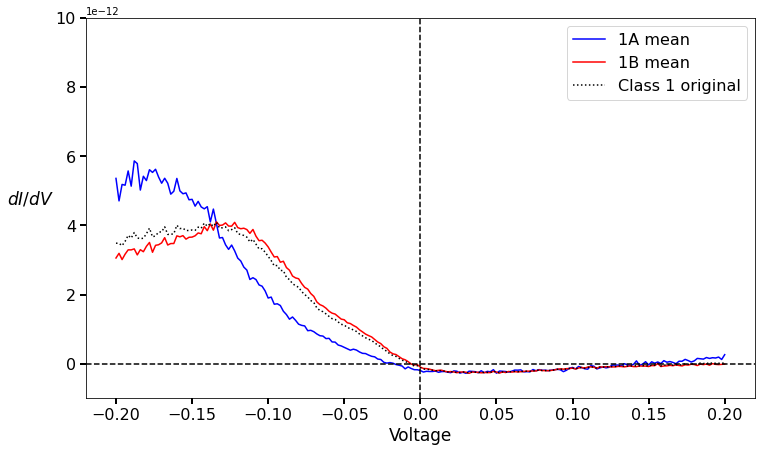

In [ ]:
plt.figure(figsize=(12,7))
plt.plot(z_axis, class1_pca1_a_mean, color = 'blue', label = '1A mean')
plt.plot(z_axis, class1_pca1_b_mean, color = 'r', label = '1B mean')
plt.plot(z_axis, class1_mean, color = 'k', ls = ':', label = 'Class 1 original')
plt.axvline(0,c='k',ls='--')
plt.axhline(0,c='k',ls='--')

plt.ylim(-0.1E-11,1E-11);

plt.tick_params(labelsize = 16, width = 2, length = 6)
plt.xlabel('Voltage', fontsize = 17)
plt.ylabel('$dI/dV$', fontsize = 17, rotation = 0, labelpad = 25)

plt.legend(fontsize = 16)

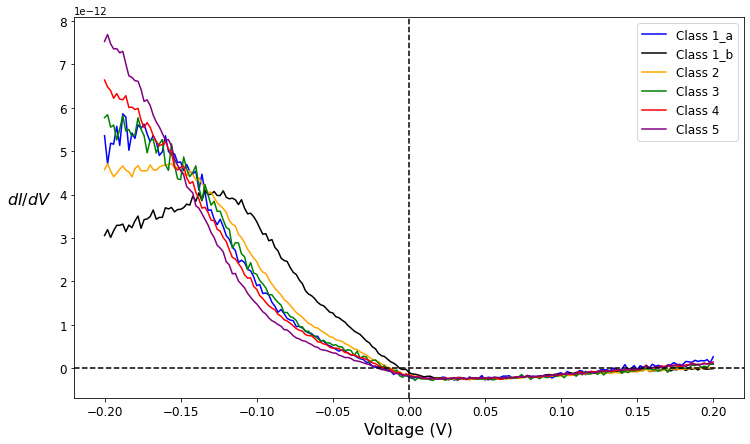

In [ ]:
plt.figure(figsize=(12,7))
plt.plot(z_axis,class1_pca1_a_mean, label = "Class 1_a", color = 'blue')
plt.plot(z_axis,class1_pca1_b_mean, label = "Class 1_b", color = 'k')
plt.plot(z_axis,class2_mean, label = "Class 2", color = 'orange')
plt.plot(z_axis,class3_mean, label = "Class 3", color = 'green')
plt.plot(z_axis,class4_mean, label = "Class 4", color = 'red')
plt.plot(z_axis,class5_mean, label = "Class 5", color = 'purple')
plt.axvline(0,c='k',ls='--')
plt.axhline(0,c='k',ls='--')
plt.legend(fontsize = 12)

plt.xlabel('Voltage (V)', size = 16);
plt.ylabel('$dI/dV$', size = 16, rotation = 0, labelpad = 30);
plt.tick_params(axis='both', labelsize = 12)

# plt.fill_between(z_axis, class1_mean-class1_stdev, class1_mean+class1_stdev, color = 'blue', alpha = 0.2)
# plt.fill_between(z_axis, class2_mean-class2_stdev, class2_mean+class2_stdev, color = 'orange', alpha = 0.2)
# plt.fill_between(z_axis, class3_mean-class3_stdev, class3_mean+class3_stdev, color = 'green', alpha = 0.2)
# plt.fill_between(z_axis, class4_mean-class4_stdev, class4_mean+class4_stdev, color = 'red', alpha = 0.2)
# plt.fill_between(z_axis, class5_mean-class5_stdev, class5_mean+class5_stdev, color = 'purple', alpha = 0.2)

Text(0.5, 1.0, 'Original Class 1')

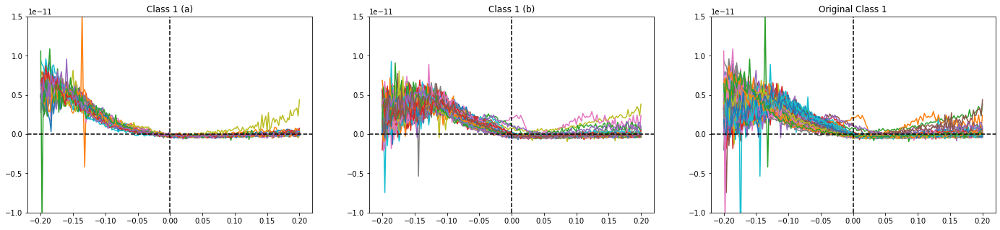

In [ ]:
scalefactor = 4  # to go from 512 to 128 pixels

f,a = plt.subplots(1,3,figsize=(24,5))

for ii in range(class1_pca1_a.shape[0]):
  a[0].plot(z_axis, class1_pca1_a[ii])
a[0].set_ylim(-1E-11,1.5E-11)
a[0].axvline(0,c='k',ls='--')
a[0].axhline(0,c='k',ls='--')
a[0].set_title('Class 1 (a)')

for ii in range(class1_pca1_b.shape[0]):
  a[1].plot(z_axis, class1_pca1_b[ii])
a[1].set_ylim(-1E-11,1.5E-11)
a[1].axvline(0,c='k',ls='--')
a[1].axhline(0,c='k',ls='--')
a[1].set_title('Class 1 (b)')

scalefactor = 4  # to go from 512 to 128 pixels
for ii in range(blobclass1.shape[0]):
  a[2].plot(z_axis,exp_cits[int(round(com[blobclass1[ii],0]/scalefactor)),int(round(com[blobclass1[ii],1]/scalefactor)),:])
a[2].set_ylim(-1E-11,1.5E-11)
a[2].axvline(0,c='k',ls='--')
a[2].axhline(0,c='k',ls='--')
a[2].set_title('Original Class 1')

In [ ]:
Class1_PCA1_coords_a.shape

(25, 2)

### Are they structurally different? Let's look in real space:

In [ ]:
crs = 6 # size of image to crop

imgstack_2a, com2a = extract_subimages(topo_f_n, Class1_PCA1_coords_a, crs)

imgstack_2b, com2b = extract_subimages(topo_f_n, Class1_PCA1_coords_b, crs)

In [ ]:
plt.plot(z_axis,exp_cits[int(round(com2a[ii,0]))

(19, 2)

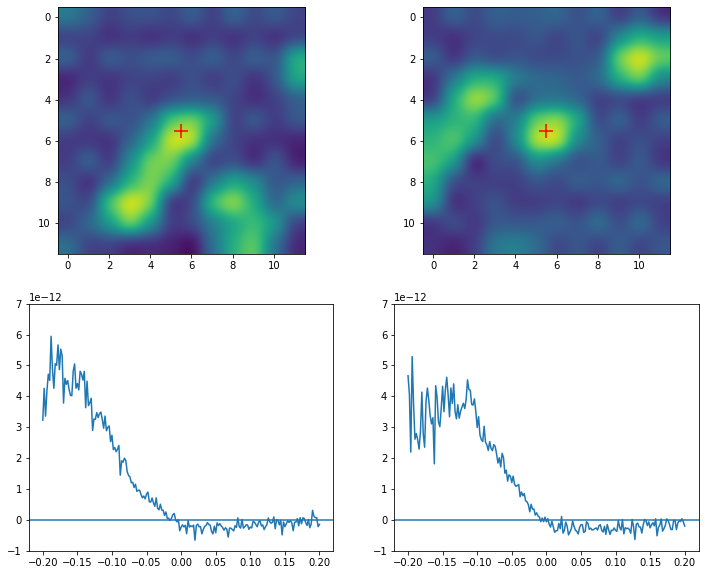

In [ ]:
k1 = 14
k2 = 26

f,a = plt.subplots(2,2,figsize=(12,10))
a[0,0].imshow(imgstack_2a[k1], interpolation = 'gaussian')
a[0,1].imshow(imgstack_2b[k2], interpolation = 'gaussian')
a[0,0].scatter(int(imgstack_2a.shape[2]/2)-0.5, int(imgstack_2a.shape[1]/2)-0.5, marker = '+', c = 'r', s = 200)
a[0,1].scatter(int(imgstack_2a.shape[2]/2)-0.5, int(imgstack_2a.shape[1]/2)-0.5, marker = '+', c = 'r', s = 200)

a[1,0].plot(z_axis,exp_cits[int(round(com2a[k1,0])), int(round(com2a[k1,1])), :])
a[1,1].plot(z_axis,exp_cits[int(round(com2b[k2,0])), int(round(com2b[k2,1])), :])

a[1,0].set_ylim(-1E-12, 7E-12)
a[1,1].set_ylim(-1E-12, 7E-12)

a[1,0].axhline(0)
a[1,1].axhline(0)

Yes, it looks like Class 1a is actually NOT single isolated atoms. So misclassified. 
* Class 1b DOES appear OK

* These DO appear to be structurally different
* It suggests that some of the atoms were structurally misclassified.
* Can use this to fix outliers, but because we are interested in the statistics here, we don't care much about these outliers because of course they should have different spectral characteristics - they are organized different structurally 

* **<font size = 6, color = 'crimson'>Do for ALL classes!!**</font>

In [ ]:
blobclass1.shape[0], blobclass2.shape[0], blobclass3.shape[0], blobclass4.shape[0], blobclass5.shape[0]

(133, 340, 17, 108, 160)

## Repeat with class 2: <font color = 'crimson'> the new information comes here </font>

In [ ]:
print("The greatest number of atoms exist in class 2: {}".format(blobclass2.shape[0]))
print("Let's see if there is any further classification to be done on the largest class")

The greatest number of atoms exist in class 2: 340
Let's see if there is any further classification to be done on the largest class


In [ ]:
class2positions = []

for ii in range(blobclass2.shape[0]):
  class2positions.append((int(round(com[blobclass2[ii],1])),int(round(com[blobclass2[ii],0]))))
# class2positions[0][0]

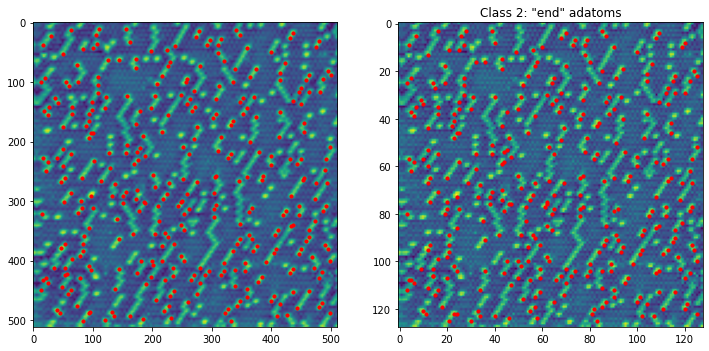

In [ ]:
f,a = plt.subplots(1,2,figsize=(12,6))

for ii in range(len(class2positions)):
  a[0].scatter(class2positions[ii][0], class2positions[ii][1], color = 'r', s = 10)
a[0].imshow(resize(topo_f_n,(512,512)))

a[1].imshow(topo_f_n)
for ii in range(blobclass2.shape[0]):
  a[1].scatter(int(round(com[blobclass2[ii],1]/4)), int(round(com[blobclass2[ii],0]/4)), color = 'r', s = 10)
a[1].set_title('Class 2: "end" adatoms');

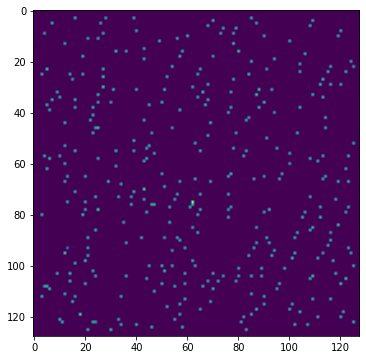

In [ ]:
## Generate array from the (x,y) pairs
Mask2 = np.zeros_like(topo_f_n)
for ii in range(len(class2positions)):
    # Mask1[int(class1positions[ii][0]),int(class1positions[ii][1])] = 1
    Mask2[int(round(com[blobclass2[ii],0]/4)),int(round(com[blobclass2[ii],1]/4))] = 1

## Make sure mask array is correct
# f,a = plt.subplots(1,2,figsize=(14,7))
# a[0].imshow(Mask2,alpha=0.8,cmap='gray_r')
# a[0].imshow(topo_f_n,alpha=0.5)
# a[1].imshow(topo_f_n)

## Mask the SPECTRAL data using the Mask1 array
test2 = np.tile(Mask2, (201,1,1))
test2_ = np.swapaxes(np.swapaxes(test2,0,1), 1,2)
test2_.shape
class2_masked = test2_*exp_cits

# Flatten for PCA
XY2 = class2_masked.shape[:2]
class2_masked_flat=class2_masked.reshape((np.prod(XY2),class2_masked.shape[2]))

# Show
plt.figure(figsize=(6,6))
plt.imshow(np.mean(class2_masked[:,:,:],axis=2))

(128, 128, 201)


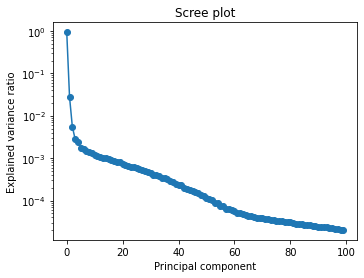

In [ ]:
# PCA on class 2:

fig= plt.figure(figsize=(12,4))
gs = gridspec.GridSpec(1,2)
ax1 = plt.subplot(gs[0,0])

pca = PCA()
pca.fit(class2_masked_flat)
explained_var = pca.explained_variance_ratio_

ax1.plot(explained_var[0:100], 'o-')
ax1.semilogy()
ax1.set_xlabel('Principal component')
ax1.set_ylabel('Explained variance ratio');
ax1.set_title('Scree plot')

print(class2_masked.shape)
w, h, n = class2_masked.shape

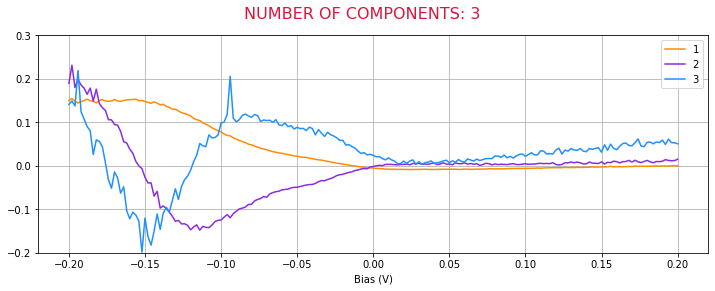

<Figure size 432x288 with 0 Axes>

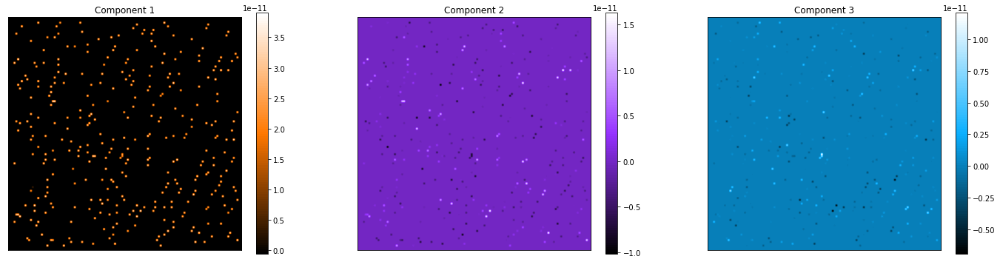

<Figure size 432x288 with 0 Axes>

In [ ]:
nc = 3
cmaps=[bOw, bPw, bBw, bRw, bGw, bBrw, bPiw, bYw, bLGw]
colors=['DarkOrange','BlueViolet','DodgerBlue','Crimson','MediumSeaGreen','Tan','HotPink','Yellow','green', 'black']
clf = PCA(n_components=nc)
X_vec_t = clf.fit_transform(class2_masked_flat)
components = clf.components_
X_vec_t = X_vec_t.reshape(w, h, nc)
rows = int(np.ceil(float(nc)/5))
cols = int(np.ceil(float(nc)/rows))
     
fig1,ax1 = plt.subplots(figsize = (12,4))

plt.suptitle("NUMBER OF COMPONENTS: {}".format(nc), fontsize = 16, color = 'Crimson')
for i in range(nc):
    ax1.plot(z_axis,components[i], color = colors.pop(0), label = i+1)
    ax1.grid(True)
#     ax1.set_xticks(np.arange(0,3.5, step=0.1));
    ax1.set_ylim(-0.2,0.3)
    ax1.set_xlabel('Bias (V)')
    ax1.tick_params(labelsize=10)
    ax1.legend(loc = 'upper right')
plt.show()
plt.savefig("PCA spectra on adatoms only.jpg")

gs2 = gridspec.GridSpec(rows, cols)
fig2 = plt.figure(figsize = (8*cols, 6*(1+rows//2)))   
for i in range(nc):
    ax2 = fig2.add_subplot(gs2[i])
    im2 = ax2.imshow(X_vec_t[:, : ,i],cmap = cmaps.pop(0))
    ax2.set_title('Component ' + str(i + 1))
    plt.colorbar(im2, ax=ax2)
    plt.setp([ax2],xticks=[], yticks=[])
plt.show()
# plt.savefig("PCA spectra on adatoms only")
plt.savefig("PCA loading maps on adatoms only.jpg")

In [ ]:
# plt.figure(figsize=(9,9))
# plt.imshow(topo_f_n)
# plt.imshow(X_vec_t[:,:,1], cmap = 'gray', alpha = 0.7)

## Analyzing PCA on already-classified classes:
1) Threshold an individual component (component 0, for example) to sub-classify the main component based on intensity [[<font color='crimson'>This seems like too much user input here to determine a threshold WITHIN a single component</font>]], or

2) literally use the second PCA component as another class (unclear at the moment, return to this)

### Use <u>second</u> PCA component as secondary class:
* Again note the use of 2nd PCA component and not the first, since first is typically associated with an "average" of sorts. We don't want that, we want the next strongest feature

* There is still some kind of thresholding that needs to be done here.
* --> That's because every pixel will receive a value, none will strictly be ZERO.
* So, maybe we can threshold this around say, 10 or 20% 
* i.e., if value is above 10 or 20%, count this pixel (this atom) as an additional class, & null others

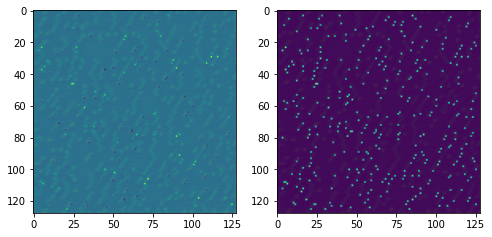

In [ ]:
Class2_PCA0 = X_vec_t[:,:,0]
Class2_PCA1 = X_vec_t[:,:,1]

# normalize [0,1]
Class2_PCA0_n = (Class2_PCA0 - np.min(Class2_PCA0))/np.ptp(Class2_PCA0)
Class2_PCA1_n = (Class2_PCA1 - np.min(Class2_PCA1))/np.ptp(Class2_PCA1)

# plot
f,a = plt.subplots(1,2,figsize=(8,4))
a[0].imshow(topo_f_n)
a[0].imshow(Class2_PCA1_n, vmin = 0, alpha = 0.9)

a[1].imshow(topo_f_n)
a[1].imshow(Class2_PCA0_n, vmin = 0, alpha = 0.9)

In [ ]:
# The background should be zero (why is it not?? How can the PCA extrapolate? Seems like just some kind of offset to the background..)
# So, let's multiply these by the mask we generated earlier

(0.0, 1.0)

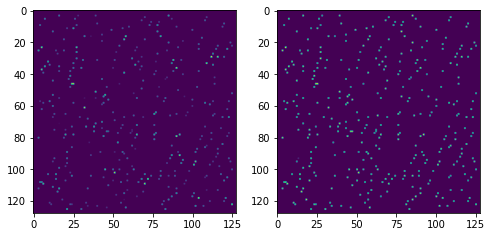

In [ ]:
Class2_PCA1_n_masked = Mask2*Class2_PCA1_n
Class2_PCA0_n_masked = Class2_PCA0_n

f,a = plt.subplots(1,2,figsize=(8,4))
a[0].imshow(Class2_PCA1_n_masked)
a[1].imshow(Class2_PCA0_n_masked)
np.min(Class2_PCA1_n_masked), np.max(Class2_PCA1_n_masked)

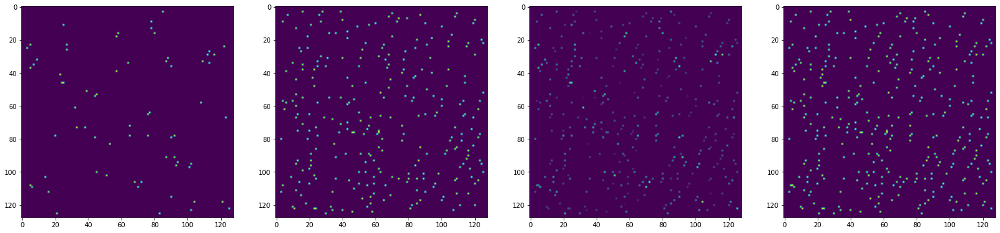

In [ ]:
thresh1 = 0.5
thresh2 = 0.001

# separate the atoms by a threshold value 

# first step is to set all atoms above threshold to 1, and all others to zero.
# This generates a map of only the stronger adatoms (stronger in the PCA component sense)
Class2_PCA1_n_c = np.copy(Class2_PCA1_n_masked)
Class2_PCA1_n_c[np.where(Class2_PCA1_n_c >= thresh1)] = 1
Class2_PCA1_n_c[np.where(Class2_PCA1_n_c < thresh1)] = 0

# Then, to get the remaining atoms, we subtract the ones in previous step from the
# original. And with the original, 

Class2_PCA1_b = Class2_PCA1_n_masked - Class2_PCA1_n_c
Class2_PCA1_b[np.where(Class2_PCA1_b >= thresh2)] = 1
Class2_PCA1_b[np.where(Class2_PCA1_b < thresh2)] = 0


f,a = plt.subplots(1,4,figsize=(27,14))
a[0].imshow(Class2_PCA1_n_c)
a[1].imshow(Class2_PCA1_b)
a[2].imshow(Class2_PCA1_n_masked)
a[3].imshow(Class2_PCA1_n_c + Class2_PCA1_b)

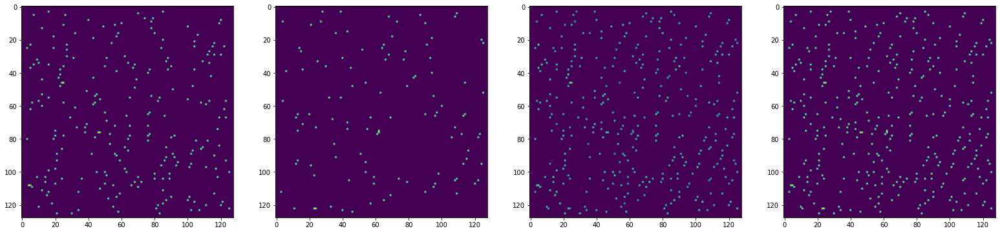

In [ ]:
thresh1 = 0.75
thresh2 = 0.001

# separate the atoms by a threshold value 

# first step is to set all atoms above threshold to 1, and all others to zero.
# This generates a map of only the stronger adatoms (stronger in the PCA component sense)
Class2_PCA0_n_c = np.copy(Class2_PCA0_n_masked)
Class2_PCA0_n_c[np.where(Class2_PCA0_n_c >= thresh1)] = 1
Class2_PCA0_n_c[np.where(Class2_PCA0_n_c < thresh1)] = 0

# Then, to get the remaining atoms, we subtract the ones in previous step from the
# original. And with the original, 

Class2_PCA0_b = Class2_PCA0_n_masked - Class2_PCA0_n_c
Class2_PCA0_b[np.where(Class2_PCA0_b >= thresh2)] = 1
Class2_PCA0_b[np.where(Class2_PCA0_b < thresh2)] = 0


f,a = plt.subplots(1,4,figsize=(27,14))
a[0].imshow(Class2_PCA0_n_c)
a[1].imshow(Class2_PCA0_b)
a[2].imshow(Class2_PCA0_n_masked)
a[3].imshow(Class2_PCA0_n_c + Class2_PCA0_b)

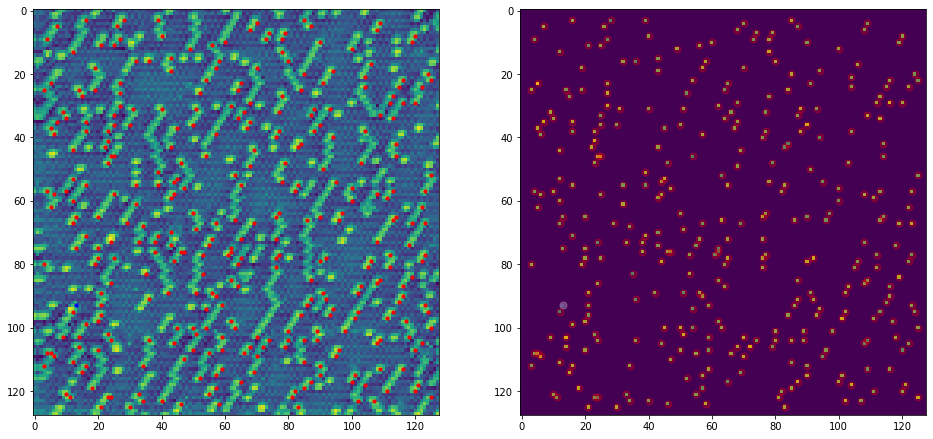

In [ ]:
# Separated Class 2 into two categories: strong PCA0 above 75% intensity in that component (a), and the rest (b)

Class2_PCA0_coords_a = np.argwhere(Class2_PCA0_n_c == 1)
Class2_PCA0_coords_b = np.argwhere(Class2_PCA0_b == 1)

f,a = plt.subplots(1,2,figsize=(16,8))
a[0].imshow(topo_f_n)
for ii in range(Class2_PCA0_coords_a.shape[0]):
  a[0].scatter(Class2_PCA0_coords_a[ii][1], Class2_PCA0_coords_a[ii][0], color = 'r', s = 10)
for ii in range(Class2_PCA0_coords_b.shape[0]): 
  a[0].scatter(Class2_PCA0_coords_b[ii][1], Class2_PCA0_coords_b[ii][0], color = 'b', s = 10)

a[1].imshow(Class2_PCA0_n_masked)
for ii in range(Class2_PCA0_coords_a.shape[0]):
  a[1].scatter(Class2_PCA0_coords_a[ii][1], Class2_PCA0_coords_a[ii][0], color = 'r', s = 50, alpha = 0.25)
for ii in range(Class2_PCA0_coords_b.shape[0]): 
  a[1].scatter(Class2_PCA0_coords_b[ii][1], Class2_PCA0_coords_b[ii][0], color = 'w', s = 50, alpha = 0.25)

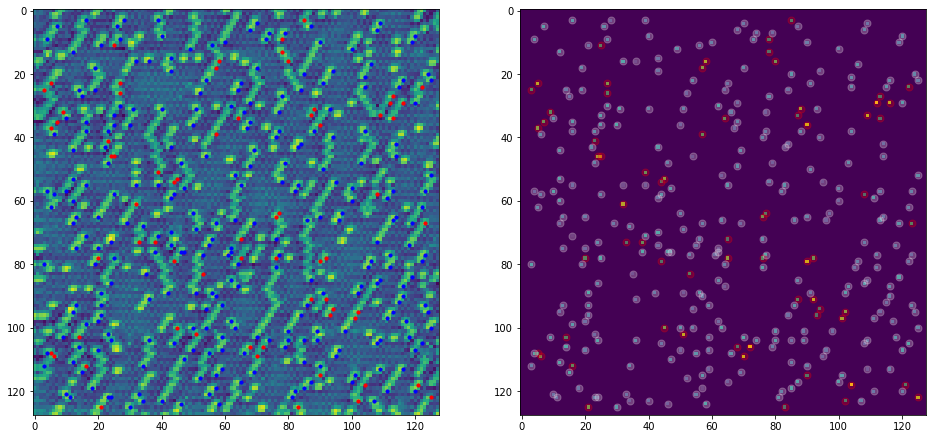

In [ ]:
# Separated Class 2 into two categories: strong PCA1 above 50% intensity in that component (a), and the rest (b)

Class2_PCA1_coords_a = np.argwhere(Class2_PCA1_n_c == 1)
Class2_PCA1_coords_b = np.argwhere(Class2_PCA1_b == 1)

f,a = plt.subplots(1,2,figsize=(16,8))
a[0].imshow(topo_f_n)
for ii in range(Class2_PCA1_coords_a.shape[0]):
  a[0].scatter(Class2_PCA1_coords_a[ii][1], Class2_PCA1_coords_a[ii][0], color = 'r', s = 10)
for ii in range(Class2_PCA1_coords_b.shape[0]): 
  a[0].scatter(Class2_PCA1_coords_b[ii][1], Class2_PCA1_coords_b[ii][0], color = 'b', s = 10)

a[1].imshow(Class2_PCA1_n_masked)
for ii in range(Class2_PCA1_coords_a.shape[0]):
  a[1].scatter(Class2_PCA1_coords_a[ii][1], Class2_PCA1_coords_a[ii][0], color = 'r', s = 50, alpha = 0.25)
for ii in range(Class2_PCA1_coords_b.shape[0]): 
  a[1].scatter(Class2_PCA1_coords_b[ii][1], Class2_PCA1_coords_b[ii][0], color = 'w', s = 50, alpha = 0.25)

In [ ]:
print(Class2_PCA0_coords_a.shape, Class2_PCA0_coords_b.shape)  #75% threshold for PCA 0
print(Class2_PCA1_coords_a.shape, Class2_PCA1_coords_b.shape)  #50% threshold for PCA 1

(338, 2) (1, 2)
(68, 2) (270, 2)


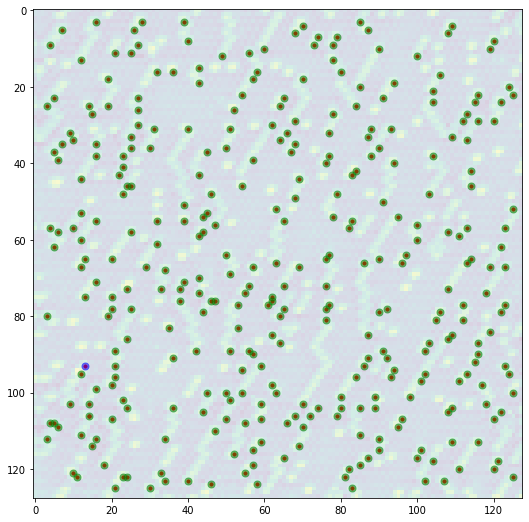

In [ ]:
plt.figure(figsize=(9,9))
plt.imshow(topo_f_n,alpha = 0.2)
for ii in range(blobclass2.shape[0]):
 plt.scatter(int(round(com[blobclass2[ii],1]/4)), int(round(com[blobclass2[ii],0]/4)), color = 'r', s = 10, alpha = 1)

for ii in range(Class2_PCA0_coords_a.shape[0]):
  plt.scatter(Class2_PCA0_coords_a[ii][1], Class2_PCA0_coords_a[ii][0], color = 'g', s = 50, alpha = 0.5)

  
for ii in range(Class2_PCA0_coords_b.shape[0]):
  plt.scatter(Class2_PCA0_coords_b[ii][1], Class2_PCA0_coords_b[ii][0], color = 'b', s = 50, alpha = 0.5)

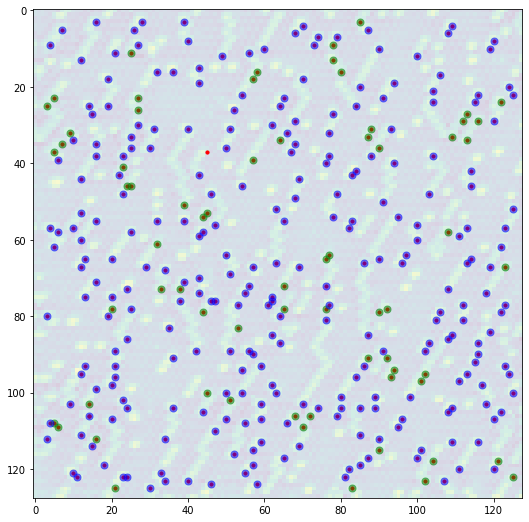

In [ ]:
plt.figure(figsize=(9,9))
plt.imshow(topo_f_n,alpha = 0.2)
for ii in range(blobclass2.shape[0]):
 plt.scatter(int(round(com[blobclass2[ii],1]/4)), int(round(com[blobclass2[ii],0]/4)), color = 'r', s = 10, alpha = 1)

for ii in range(Class2_PCA1_coords_a.shape[0]):
  plt.scatter(Class2_PCA1_coords_a[ii][1], Class2_PCA1_coords_a[ii][0], color = 'g', s = 50, alpha = 0.5)

  
for ii in range(Class2_PCA1_coords_b.shape[0]):
  plt.scatter(Class2_PCA1_coords_b[ii][1], Class2_PCA1_coords_b[ii][0], color = 'b', s = 50, alpha = 0.5)

In [ ]:
scalefactor = 1


## separated PCA 0

class2_pca0_a = np.zeros((Class2_PCA0_coords_a.shape[0],exp_cits.shape[2]))
for ii in range(Class2_PCA0_coords_a.shape[0]):
  class2_pca0_a[ii] = exp_cits[int(Class2_PCA0_coords_a[ii][0]/scalefactor),int(Class2_PCA0_coords_a[ii][1]/scalefactor),:]
class2_pca0_a_mean = np.mean(class2_pca0_a,axis=0)

class2_pca0_b = np.zeros((Class2_PCA0_coords_b.shape[0],exp_cits.shape[2]))
for ii in range(Class2_PCA0_coords_b.shape[0]):
  class2_pca0_b[ii] = exp_cits[int(Class2_PCA0_coords_b[ii][0]/scalefactor),int(Class2_PCA0_coords_b[ii][1]/scalefactor),:]
class2_pca0_b_mean = np.mean(class2_pca0_b,axis=0)

## separated PCA 1

class2_pca1_a = np.zeros((Class2_PCA1_coords_a.shape[0],exp_cits.shape[2]))
for ii in range(Class2_PCA1_coords_a.shape[0]):
  class2_pca1_a[ii] = exp_cits[int(Class2_PCA1_coords_a[ii][0]/scalefactor),int(Class2_PCA1_coords_a[ii][1]/scalefactor),:]
class2_pca1_a_mean = np.mean(class2_pca1_a,axis=0)

class2_pca1_b = np.zeros((Class2_PCA1_coords_b.shape[0],exp_cits.shape[2]))
for ii in range(Class2_PCA1_coords_b.shape[0]):
  class2_pca1_b[ii] = exp_cits[int(Class2_PCA1_coords_b[ii][0]/scalefactor),int(Class2_PCA1_coords_b[ii][1]/scalefactor),:]
class2_pca1_b_mean = np.mean(class2_pca1_b,axis=0)

Including IV

In [ ]:
scalefactor

1

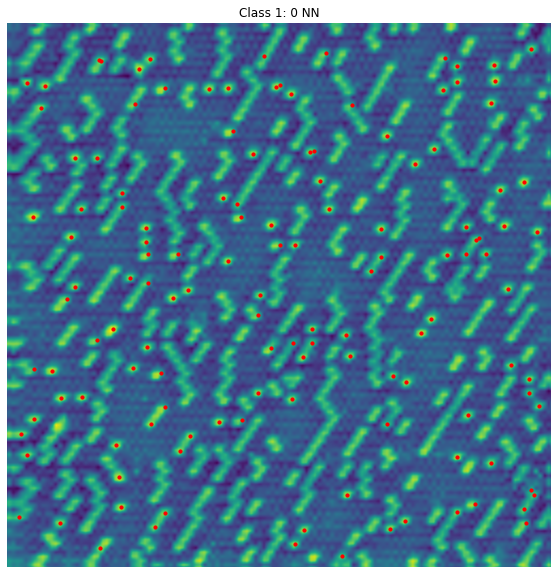

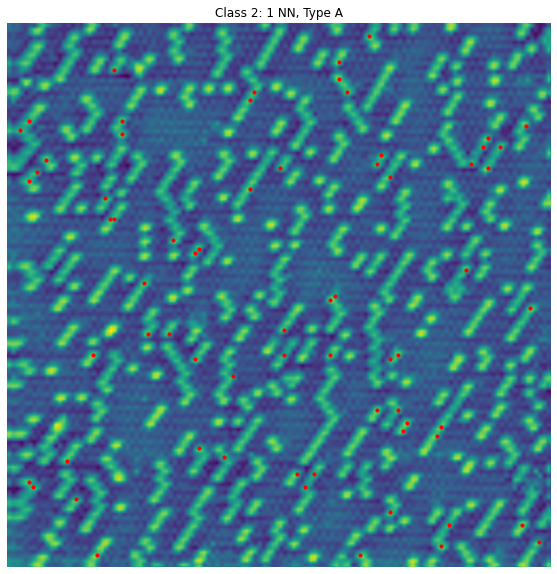

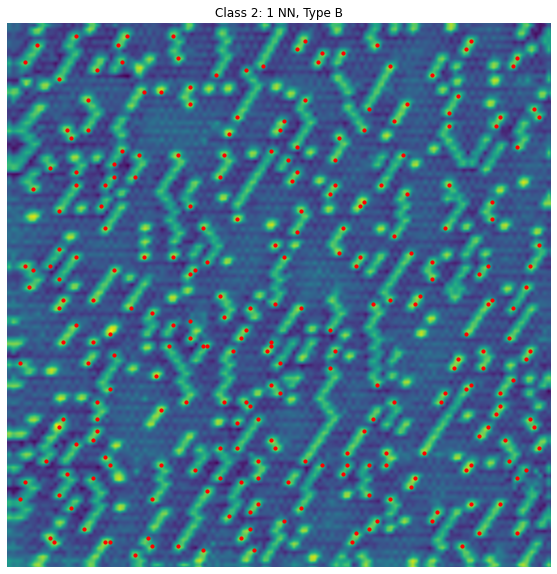

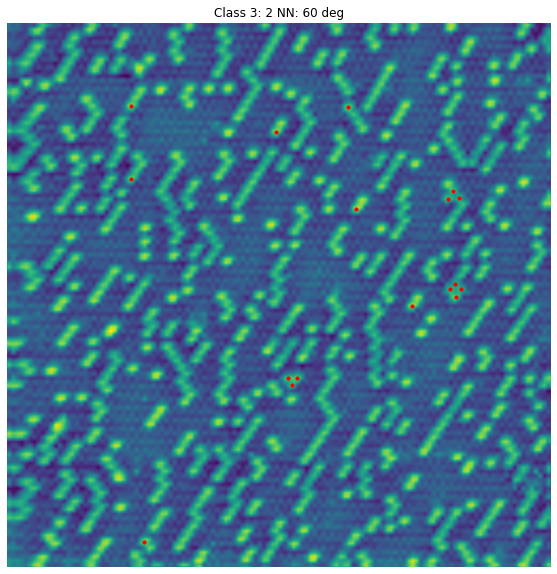

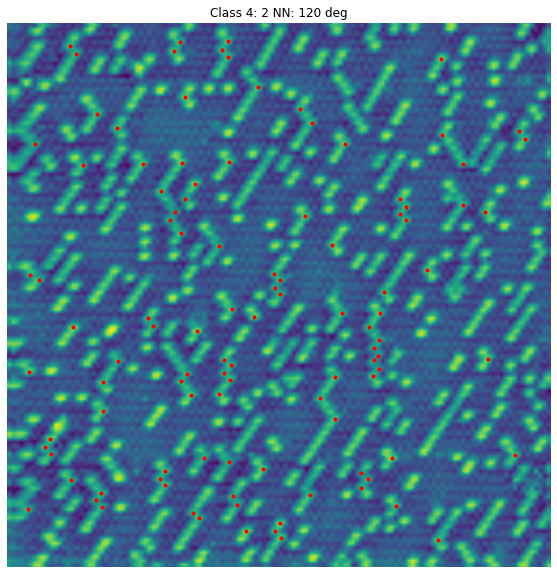

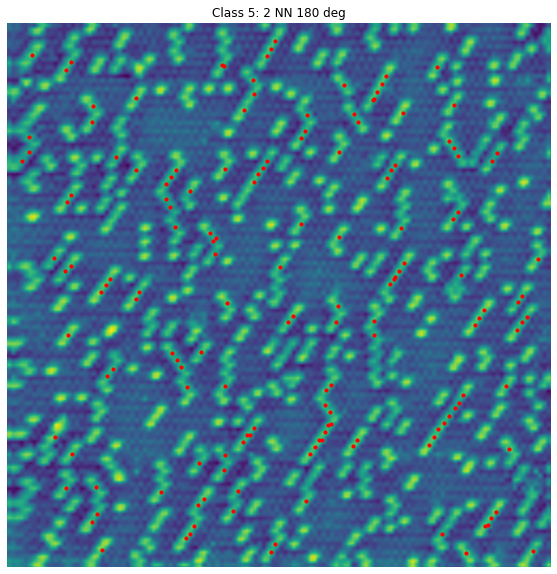

In [ ]:
scalefactor = 4
plt.figure(figsize=(10,10))
plt.imshow(topo_f_n_resized, interpolation = 'gaussian')
for ii in range(blobclass1.shape[0]):
  plt.scatter(com[blobclass1[ii],1], com[blobclass1[ii],0], color = 'r', s = 10)
plt.title('Class 1: 0 NN')
plt.axis('off');

plt.figure(figsize=(10,10))
plt.imshow(topo_f_n_resized, interpolation = 'gaussian')
for ii in range(Class2_PCA1_coords_a.shape[0]):
  plt.scatter(Class2_PCA1_coords_a[ii,1]*scalefactor, Class2_PCA1_coords_a[ii,0]*scalefactor, color = 'r', s = 10)
plt.title('Class 2: 1 NN, Type A')
plt.axis('off');

plt.figure(figsize=(10,10))
plt.imshow(topo_f_n_resized, interpolation = 'gaussian')
for ii in range(Class2_PCA1_coords_b.shape[0]):
  plt.scatter(Class2_PCA1_coords_b[ii,1]*scalefactor, Class2_PCA1_coords_b[ii,0]*scalefactor, color = 'r', s = 10)
plt.title('Class 2: 1 NN, Type B')
plt.axis('off');

plt.figure(figsize=(10,10))
plt.imshow(topo_f_n_resized, interpolation = 'gaussian')
for ii in range(blobclass3.shape[0]):
  plt.scatter(com[blobclass3[ii],1], com[blobclass3[ii],0], color = 'r', s = 10)
plt.title('Class 3: 2 NN: 60 deg')
plt.axis('off');

plt.figure(figsize=(10,10))
plt.imshow(topo_f_n_resized, interpolation = 'gaussian')
for ii in range(blobclass4.shape[0]):
  plt.scatter(com[blobclass4[ii],1], com[blobclass4[ii],0], color = 'r', s = 10)
plt.title('Class 4: 2 NN: 120 deg')
plt.axis('off');

plt.figure(figsize=(10,10))
plt.imshow(topo_f_n_resized, interpolation = 'gaussian')
for ii in range(blobclass5.shape[0]):
  plt.scatter(com[blobclass5[ii],1], com[blobclass5[ii],0], color = 'r', s = 10)
plt.title('Class 5: 2 NN 180 deg')
plt.axis('off');

In [ ]:
# !gdown https://drive.google.com/uc?id=10GMs6NqOng2m68tFvxccFExvLThtsllO

In [ ]:
# IV = np.load('IV.npy')

# class2_pca1_a_IV = np.zeros((Class2_PCA1_coords_a.shape[0],exp_cits.shape[2]))
# for ii in range(Class2_PCA1_coords_a.shape[0]):
#   class2_pca1_a[ii] = IV[int(Class2_PCA1_coords_a[ii][0]/scalefactor),int(Class2_PCA1_coords_a[ii][1]/scalefactor),:]
# class2_pca1_a_mean_IV = np.mean(class2_pca1_a,axis=0)

# class2_pca1_b_IV = np.zeros((Class2_PCA1_coords_b.shape[0],exp_cits.shape[2]))
# for ii in range(Class2_PCA1_coords_b.shape[0]):
#   class2_pca1_b[ii] = IV[int(Class2_PCA1_coords_b[ii][0]/scalefactor),int(Class2_PCA1_coords_b[ii][1]/scalefactor),:]
# class2_pca1_b_mean_IV = np.mean(class2_pca1_b,axis=0)

# plt.plot(z_axis, class2_pca1_mean_IV[0])
# plt.plot(z_axis, class2_pca1_mean_IV[1])

Export

In [ ]:
class2_pca1_a_mean.shape

(201,)

In [ ]:
# class2_pca1_mean = np.zeros((2,201))
# class2_pca1_mean[0] = class2_pca1_a_mean
# class2_pca1_mean[1] = class2_pca1_b_mean

# class2_pca1_mean_IV = np.zeros((2,201))
# class2_pca1_mean_IV[0] = class2_pca1_a_mean_IV
# class2_pca1_mean_IV[1] = class2_pca1_b_mean_IV

In [ ]:
# np.savetxt('c2A spectra.csv',class2_pca1_a)
# np.savetxt('c2B spectra.csv',class2_pca1_b)
# np.savetxt('class2_pca1_mean.csv',class2_pca1_mean)
# np.savetxt('voltage_axis.csv',z_axis)

In [ ]:
## I/V
# np.savetxt('class2_pca1_mean_IV.csv',class2_pca1_mean_IV)

In [ ]:
# scalefactor = 4
# class1all_IV = np.zeros((blobclass1.shape[0],IV.shape[2]))
# for ii in range(blobclass1.shape[0]):
#   class1all_IV[ii] = IV[int(round(com[blobclass1[ii],0]/scalefactor)),int(round(com[blobclass1[ii],1]/scalefactor)),:]
# class1_mean_IV = np.mean(class1all_IV,axis=0)

# class2all_IV = np.zeros((blobclass2.shape[0],IV.shape[2]))
# for ii in range(blobclass2.shape[0]):
#   class2all_IV[ii] = IV[int(round(com[blobclass2[ii],0]/scalefactor)),int(round(com[blobclass2[ii],1]/scalefactor)),:]
# class2_mean_IV = np.mean(class2all_IV,axis=0)

# class3all_IV = np.zeros((blobclass3.shape[0],IV.shape[2]))
# for ii in range(blobclass3.shape[0]):
#   class3all_IV[ii] = IV[int(round(com[blobclass3[ii],0]/scalefactor)),int(round(com[blobclass3[ii],1]/scalefactor)),:]
# class3_mean_IV = np.mean(class3all_IV,axis=0)

# class4all_IV = np.zeros((blobclass4.shape[0],IV.shape[2]))
# for ii in range(blobclass4.shape[0]):
#   class4all_IV[ii] = IV[int(round(com[blobclass4[ii],0]/scalefactor)),int(round(com[blobclass4[ii],1]/scalefactor)),:]
# class4_mean_IV = np.mean(class4all_IV,axis=0)

# class5all_IV = np.zeros((blobclass5.shape[0],IV.shape[2]))
# for ii in range(blobclass5.shape[0]):
#   class5all_IV[ii] = IV[int(round(com[blobclass5[ii],0]/scalefactor)),int(round(com[blobclass5[ii],1]/scalefactor)),:]
# class5_mean_IV = np.mean(class5all_IV,axis=0)

In [ ]:
# class_mean1_IV = np.zeros((5,201))
# class_mean1_IV[0] = class1_mean_IV
# class_mean1_IV[1] = class2_mean_IV
# class_mean1_IV[2] = class3_mean_IV
# class_mean1_IV[3] = class4_mean_IV
# class_mean1_IV[4] = class5_mean_IV

* Export

In [ ]:
# np.savetxt('classes mean spectra_IV.csv', class_mean1_IV)

* Get the standard deviation for a kind of error bar measurement

In [ ]:
class2_pca0_a_stdev = np.std(class2_pca0_a,axis=0)
class2_pca0_b_stdev = np.std(class2_pca0_b,axis=0)

class2_pca1_a_stdev = np.std(class2_pca1_a,axis=0)
class2_pca1_b_stdev = np.std(class2_pca1_b,axis=0)

In [ ]:
class2_pca0_b.shape

(1, 201)

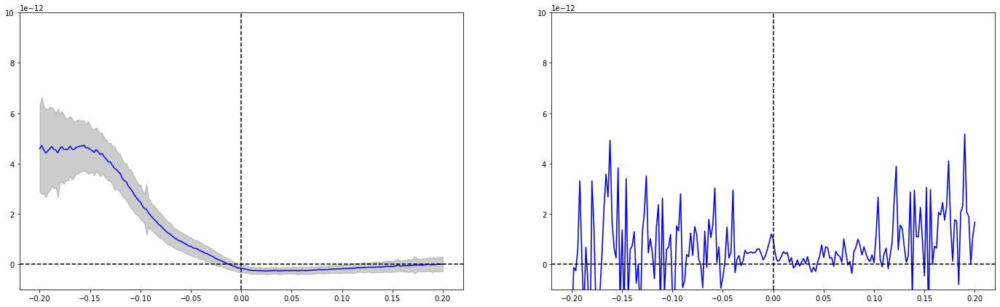

In [ ]:
f,a = plt.subplots(1,2,figsize=(24,7))
a[0].plot(z_axis, class2_pca0_a_mean, color = 'blue')
a[0].fill_between(z_axis, class2_pca0_a_mean - class2_pca0_a_stdev, class2_pca0_a_mean+class2_pca0_a_stdev, alpha = 0.2, color = 'k')
a[0].axvline(0,c='k',ls='--')
a[0].axhline(0,c='k',ls='--')
a[0].set_ylim(-0.1E-11,1E-11);

a[1].plot(z_axis, class2_pca0_b_mean, color = 'blue')
a[1].fill_between(z_axis, class2_pca0_b_mean - class2_pca0_b_stdev, class2_pca0_b_mean+class2_pca0_b_stdev, alpha = 0.2, color = 'k')
a[1].axvline(0,c='k',ls='--')
a[1].axhline(0,c='k',ls='--')
a[1].set_ylim(-0.1E-11,1E-11);

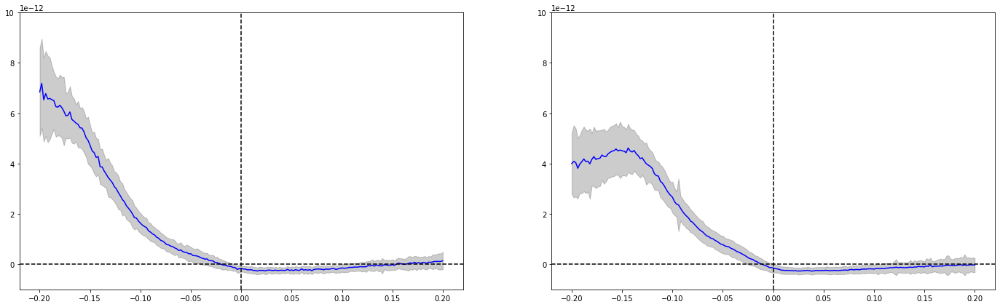

In [ ]:
f,a = plt.subplots(1,2,figsize=(24,7))
a[0].plot(z_axis, class2_pca1_a_mean, color = 'blue')
a[0].fill_between(z_axis, class2_pca1_a_mean - class2_pca1_a_stdev, class2_pca1_a_mean+class2_pca1_a_stdev, alpha = 0.2, color = 'k')
a[0].axvline(0,c='k',ls='--')
a[0].axhline(0,c='k',ls='--')
a[0].set_ylim(-0.1E-11,1E-11);

a[1].plot(z_axis, class2_pca1_b_mean, color = 'blue')
a[1].fill_between(z_axis, class2_pca1_b_mean - class2_pca1_b_stdev, class2_pca1_b_mean+class2_pca1_b_stdev, alpha = 0.2, color = 'k')
a[1].axvline(0,c='k',ls='--')
a[1].axhline(0,c='k',ls='--')
a[1].set_ylim(-0.1E-11,1E-11);

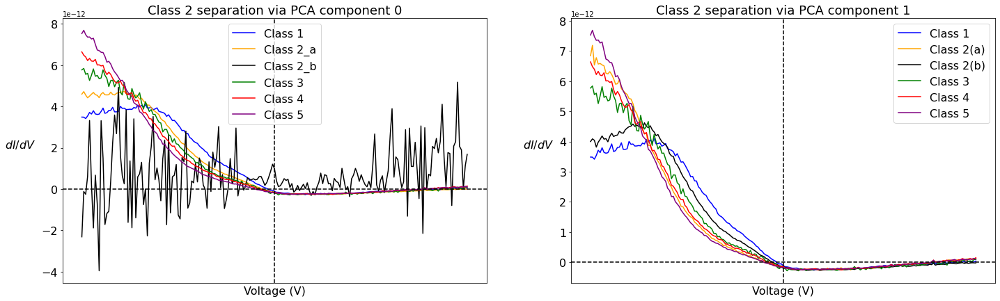

In [ ]:
f,a = plt.subplots(1,2,figsize=(24,7))

a[0].plot(z_axis,class1_mean, label = "Class 1", color = 'blue')
a[0].plot(z_axis,class2_pca0_a_mean, label = "Class 2_a", color = 'orange')
a[0].plot(z_axis,class2_pca0_b_mean, label = "Class 2_b", color = 'k')
# plt.plot(z_axis,class2_mean, label = "Class 2", color = 'orange')
a[0].plot(z_axis,class3_mean, label = "Class 3", color = 'green')
a[0].plot(z_axis,class4_mean, label = "Class 4", color = 'red')
a[0].plot(z_axis,class5_mean, label = "Class 5", color = 'purple')
a[0].axvline(0,c='k',ls='--')
a[0].axhline(0,c='k',ls='--')
a[0].legend(fontsize = 12)

a[0].set_xlabel('Voltage (V)', size = 16);
a[0].set_ylabel('$dI/dV$', size = 16, rotation = 0, labelpad = 30);
a[0].tick_params(axis='both', labelsize = 12)

a[1].plot(z_axis,class1_mean, label = "Class 1", color = 'blue')
a[1].plot(z_axis,class2_pca1_a_mean, label = "Class 2(a)", color = 'orange')
a[1].plot(z_axis,class2_pca1_b_mean, label = "Class 2(b)", color = 'k')
# plt.plot(z_axis,class2_mean, label = "Class 2", color = 'orange')
a[1].plot(z_axis,class3_mean, label = "Class 3", color = 'green')
a[1].plot(z_axis,class4_mean, label = "Class 4", color = 'red')
a[1].plot(z_axis,class5_mean, label = "Class 5", color = 'purple')
a[1].axvline(0,c='k',ls='--')
a[1].axhline(0,c='k',ls='--')

a[0].legend(fontsize = 16)
a[1].legend(fontsize = 16)

a[1].set_xlabel('Voltage (V)', size = 16);
a[1].set_ylabel('$dI/dV$', size = 16, rotation = 0, labelpad = 30);
a[1].tick_params(axis='both', labelsize = 12)

a[0].set_title("Class 2 separation via PCA component 0", fontsize = 18)
a[1].set_title("Class 2 separation via PCA component 1", fontsize = 18);

a[0].tick_params(labelsize=16)
a[1].tick_params(labelsize=16)

plt.setp([a[0],a[1]], xticks=[]);

* Separation using PCA component 0 seems to just shuffle potentially misclassified (structurally) misclassified atoms into already existing class.
* Note that in this plot (left), there are still essentially 5 spectra
* However, separation via PCA component 1 appears to show a new spectral feature, shown in black curve (Right)

Comparsion (before and after separation)

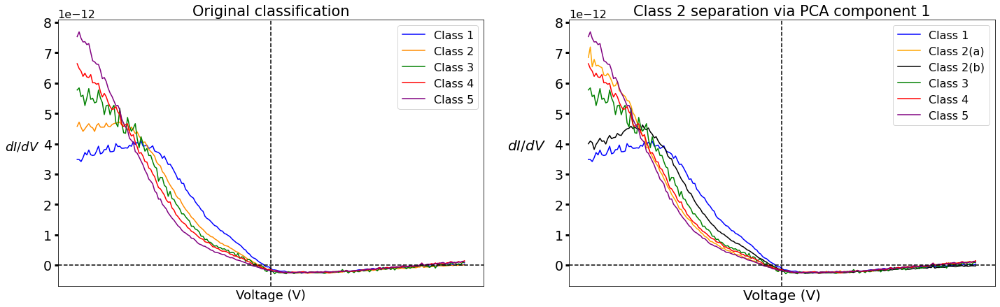

In [ ]:
fig,a = plt.subplots(1,2,figsize=(24,7))
a[0].plot(z_axis,class1_mean, label = "Class 1", color = 'blue')
a[0].plot(z_axis,class2_mean, label = "Class 2", color = 'darkorange')
a[0].plot(z_axis,class3_mean, label = "Class 3", color = 'green')
a[0].plot(z_axis,class4_mean, label = "Class 4", color = 'red')
a[0].plot(z_axis,class5_mean, label = "Class 5", color = 'purple')
a[0].axvline(0,c='k',ls='--')
a[0].axhline(0,c='k',ls='--')



a[0].set_xlabel('Voltage (V)', size = 18);
a[0].set_ylabel('$dI/dV$', size = 18, rotation = 0, labelpad = 30);
a[0].tick_params(labelsize = 16)

# plt.fill_between(z_axis, class1_mean-class1_stdev, class1_mean+class1_stdev, color = 'blue', alpha = 0.2)
# plt.fill_between(z_axis, class2_mean-class2_stdev, class2_mean+class2_stdev, color = 'orange', alpha = 0.2)
# plt.fill_between(z_axis, class3_mean-class3_stdev, class3_mean+class3_stdev, color = 'green', alpha = 0.2)
# plt.fill_between(z_axis, class4_mean-class4_stdev, class4_mean+class4_stdev, color = 'red', alpha = 0.2)
# plt.fill_between(z_axis, class5_mean-class5_stdev, class5_mean+class5_stdev, color = 'purple', alpha = 0.2)

a[1].plot(z_axis,class1_mean, label = "Class 1", color = 'blue')
a[1].plot(z_axis,class2_pca1_a_mean, label = "Class 2(a)", color = 'orange')
a[1].plot(z_axis,class2_pca1_b_mean, label = "Class 2(b)", color = 'k')
# plt.plot(z_axis,class2_mean, label = "Class 2", color = 'orange')
a[1].plot(z_axis,class3_mean, label = "Class 3", color = 'green')
a[1].plot(z_axis,class4_mean, label = "Class 4", color = 'red')
a[1].plot(z_axis,class5_mean, label = "Class 5", color = 'purple')
a[1].axvline(0,c='k',ls='--')
a[1].axhline(0,c='k',ls='--')

a[0].legend(fontsize = 16)
a[1].legend(fontsize = 16)

a[1].set_xlabel('Voltage (V)', size = 20);
a[1].set_ylabel('$dI/dV$', size = 20, rotation = 0, labelpad = 40);
# a[1].tick_params(axis='both', labelsize = 16)

a[0].set_title("Original classification", fontsize = 21)
a[1].set_title("Class 2 separation via PCA component 1", fontsize = 21);

a[0].tick_params(labelsize=19, width = 3, size = 5)
a[1].tick_params(labelsize=19, width = 3, size = 5)

a[0].yaxis.get_offset_text().set(size=16)
a[1].yaxis.get_offset_text().set(size=16)

plt.setp([a[0],a[1]], xticks=[]);

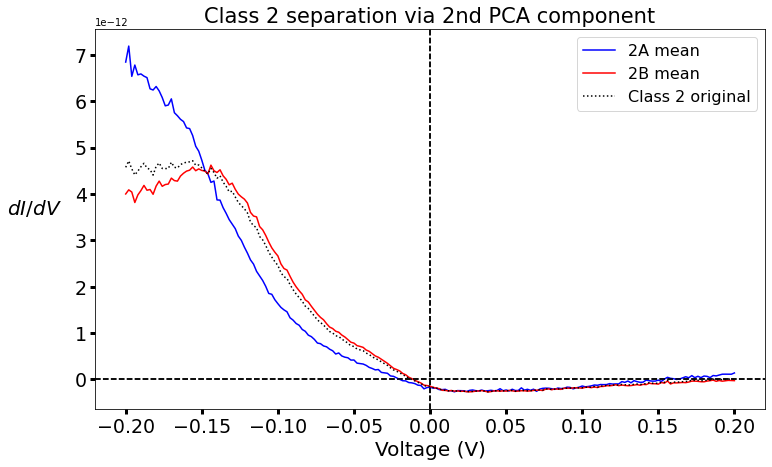

In [ ]:
plt.figure(figsize=(12,7))
# plt.plot(z_axis,class1_mean, label = "Class 1", color = 'blue')
# plt.plot(z_axis,class2_mean, label = "Class 2", color = 'darkorange')
# plt.plot(z_axis,class3_mean, label = "Class 3", color = 'green')
# plt.plot(z_axis,class4_mean, label = "Class 4", color = 'red')
# plt.plot(z_axis,class5_mean, label = "Class 5", color = 'purple')
plt.axvline(0,c='k',ls='--')
plt.axhline(0,c='k',ls='--')


plt.tick_params(labelsize = 16)

# plt.plot(z_axis,class1_mean, label = "Class 1", color = 'blue')

plt.plot(z_axis,class2_pca1_a_mean, label = "2A mean", color = 'blue')
plt.plot(z_axis,class2_pca1_b_mean, label = "2B mean", color = 'r')
plt.plot(z_axis,class2_mean, color = 'k', ls = ':', label = 'Class 2 original')

# plt.plot(z_axis,class2_mean, label = "Class 2", color = 'orange')
# plt.plot(z_axis,class3_mean, label = "Class 3", color = 'green')
# plt.plot(z_axis,class4_mean, label = "Class 4", color = 'red')
# plt.plot(z_axis,class5_mean, label = "Class 5", color = 'purple')
plt.axvline(0,c='k',ls='--')
plt.axhline(0,c='k',ls='--')

plt.legend(fontsize = 16)
plt.legend(fontsize = 16)

plt.xlabel('Voltage (V)', size = 20);
plt.ylabel('$dI/dV$', size = 20, rotation = 0, labelpad = 40);
# plt.tick_params(axis='both', labelsize = 16)

plt.title("Class 2 separation via 2nd PCA component", fontsize = 21);

plt.tick_params(labelsize=19, width = 3, size = 5)
plt.tick_params(labelsize=19, width = 3, size = 5)


Text(0.5, 1.0, 'Original Class 2')

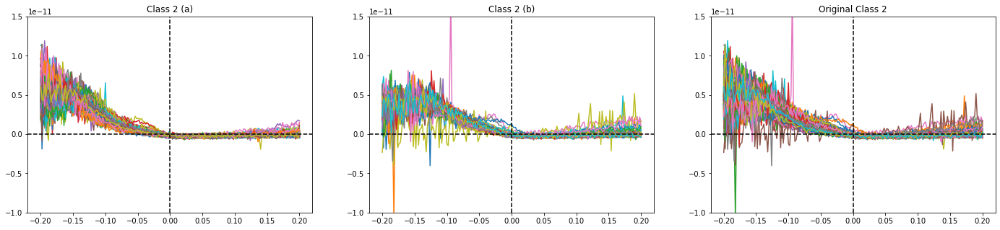

In [ ]:
scalefactor = 4  # to go from 512 to 128 pixels

f,a = plt.subplots(1,3,figsize=(24,5))

for ii in range(class2_pca0_a.shape[0]):
  a[0].plot(z_axis, class2_pca0_a[ii])
a[0].set_ylim(-1E-11,1.5E-11)
a[0].axvline(0,c='k',ls='--')
a[0].axhline(0,c='k',ls='--')
a[0].set_title('Class 2 (a)')

for ii in range(class2_pca0_b.shape[0]):
  a[1].plot(z_axis, class2_pca0_b[ii])
a[1].set_ylim(-1E-11,1.5E-11)
a[1].axvline(0,c='k',ls='--')
a[1].axhline(0,c='k',ls='--')
a[1].set_title('Class 2 (b)')

scalefactor = 4  # to go from 512 to 128 pixels
for ii in range(blobclass2.shape[0]):
  a[2].plot(z_axis,exp_cits[int(round(com[blobclass2[ii],0]/scalefactor)),int(round(com[blobclass2[ii],1]/scalefactor)),:])
a[2].set_ylim(-1E-11,1.5E-11)
a[2].axvline(0,c='k',ls='--')
a[2].axhline(0,c='k',ls='--')
a[2].set_title('Original Class 2')

Text(0.5, 1.0, 'Original Class 2')

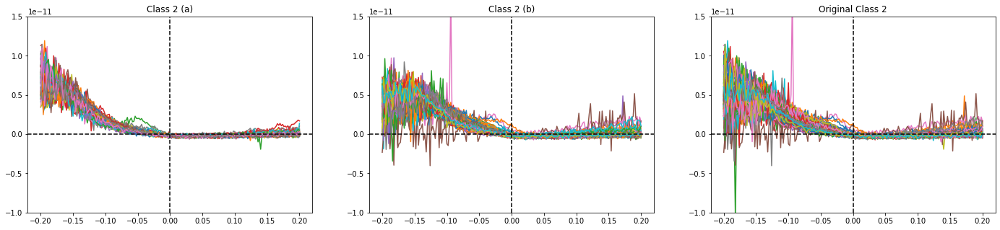

In [ ]:
scalefactor = 4  # to go from 512 to 128 pixels

f,a = plt.subplots(1,3,figsize=(24,5))

for ii in range(class2_pca1_a.shape[0]):
  a[0].plot(z_axis, class2_pca1_a[ii])
a[0].set_ylim(-1E-11,1.5E-11)
a[0].axvline(0,c='k',ls='--')
a[0].axhline(0,c='k',ls='--')
a[0].set_title('Class 2 (a)')

for ii in range(class2_pca1_b.shape[0]):
  a[1].plot(z_axis, class2_pca1_b[ii])
a[1].set_ylim(-1E-11,1.5E-11)
a[1].axvline(0,c='k',ls='--')
a[1].axhline(0,c='k',ls='--')
a[1].set_title('Class 2 (b)')

scalefactor = 4  # to go from 512 to 128 pixels
for ii in range(blobclass2.shape[0]):
  a[2].plot(z_axis,exp_cits[int(round(com[blobclass2[ii],0]/scalefactor)),int(round(com[blobclass2[ii],1]/scalefactor)),:])
a[2].set_ylim(-1E-11,1.5E-11)
a[2].axvline(0,c='k',ls='--')
a[2].axhline(0,c='k',ls='--')
a[2].set_title('Original Class 2')

In [ ]:
Class2_PCA1_coords_b.shape

(270, 2)

### Are they structurally different? 
### Let's look in real space: first in adatom-only image, then in real image

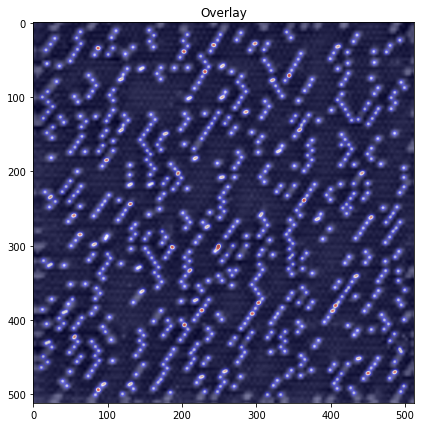

In [ ]:
try:
  adatoms
except NameError:
  resized = 512
  topo_f_n_resized = resize(topo_f_n, (resized,resized))
  arrsize = resized  # The same size as the image above
  atomsize = 10
  amplitude = 1
  adatoms = np.zeros((arrsize,arrsize))
  for kk in range(len(com)):
    adatoms += gauss2d_atom(com[kk][1],com[kk][0], amp = amplitude, sigma = atomsize, xlen = arrsize, ylen=arrsize, numpix = arrsize)


f,a = plt.subplots(1,figsize = (7,7))
a.imshow(topo_f_n_resized, cmap = 'gray')
a.imshow(adatoms, alpha = 0.5, cmap = 'seismic')
a.set_title('Overlay');

In [ ]:
crs = 6 # size of image to crop

imgstack_2a, com2a = extract_subimages(topo_f_n, Class2_PCA1_coords_a, crs)

imgstack_2b, com2b = extract_subimages(topo_f_n, Class2_PCA1_coords_b, crs)

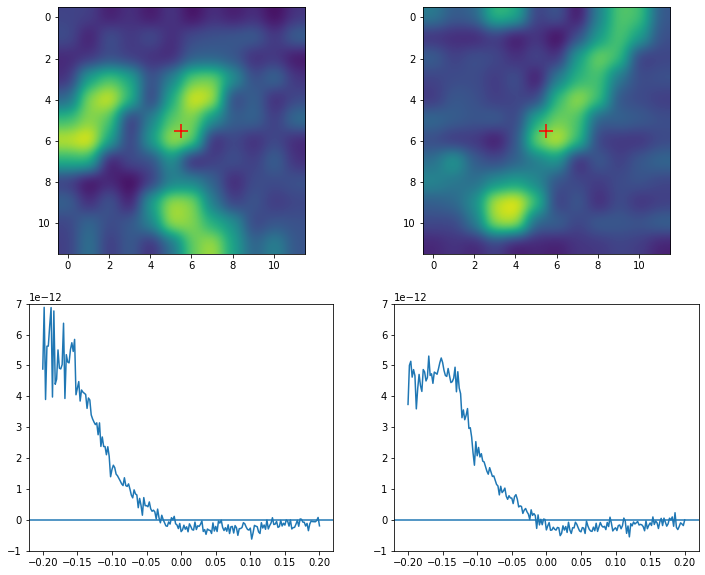

In [ ]:
k1 = 0
k2 = 26

f,a = plt.subplots(2,2,figsize=(12,10))
a[0,0].imshow(imgstack_2a[k1], interpolation = 'gaussian')
a[0,1].imshow(imgstack_2b[k2], interpolation = 'gaussian')
a[0,0].scatter(int(imgstack_2a.shape[2]/2)-0.5, int(imgstack_2a.shape[1]/2)-0.5, marker = '+', c = 'r', s = 200)
a[0,1].scatter(int(imgstack_2a.shape[2]/2)-0.5, int(imgstack_2a.shape[1]/2)-0.5, marker = '+', c = 'r', s = 200)

a[1,0].plot(z_axis,exp_cits[int(round(com2a[k1,0])), int(round(com2a[k1,1])), :])
a[1,1].plot(z_axis,exp_cits[int(round(com2b[k2,0])), int(round(com2b[k2,1])), :])

a[1,0].set_ylim(-1E-12, 7E-12)
a[1,1].set_ylim(-1E-12, 7E-12)

a[1,0].axhline(0)
a[1,1].axhline(0)

In [ ]:
# crs = 6 # size of image to crop

# imgstack_2a_adatoms, comadatoms2a = extract_subimages(adatoms, Class2_PCA1_coords_a*4, crs*4)
# imgstack_2b_adatoms, comadatoms2b = extract_subimages(adatoms, Class2_PCA1_coords_b*4, crs*4)

# imgstack_2a_rawimage, comraw2a = extract_subimages(topo_f_n, Class2_PCA1_coords_a, crs)
# imgstack_2b_rawimage, comraw2b = extract_subimages(topo_f_n, Class2_PCA1_coords_b, crs)

NameError: ignored

In [ ]:
# imgstack_2a_rawimage.shape, comadatoms2a.shape


((58, 12, 12), (58, 2))

[]

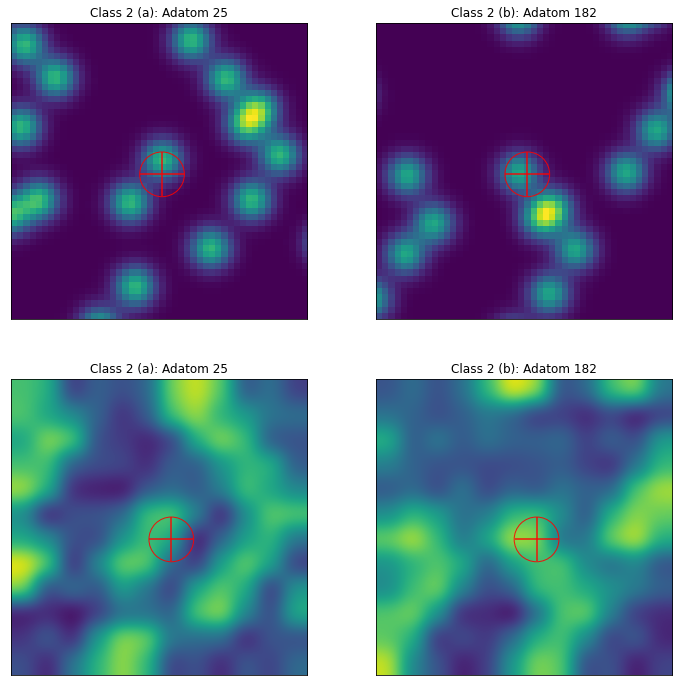

In [ ]:
# hh = np.random.randint(0,imgstack_2a_adatoms.shape[0])
# kk = np.random.randint(0,imgstack_2b_adatoms.shape[0])
hh = 25
kk = 182

f,a = plt.subplots(2,2,figsize=(12,12))
a[0,0].scatter(imgstack_2a_adatoms.shape[1]/2,imgstack_2a_adatoms.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
a[0,0].scatter(imgstack_2a_adatoms.shape[1]/2,imgstack_2a_adatoms.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
a[0,1].scatter(imgstack_2b_adatoms.shape[1]/2,imgstack_2b_adatoms.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
a[0,1].scatter(imgstack_2b_adatoms.shape[1]/2,imgstack_2b_adatoms.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
a[1,0].scatter(imgstack_2a_rawimage.shape[1]/2,imgstack_2a_rawimage.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
a[1,0].scatter(imgstack_2a_rawimage.shape[1]/2,imgstack_2a_rawimage.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
a[1,1].scatter(imgstack_2b_rawimage.shape[1]/2,imgstack_2b_rawimage.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
a[1,1].scatter(imgstack_2b_rawimage.shape[1]/2,imgstack_2b_rawimage.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')

a[0,0].imshow(imgstack_2a_adatoms[hh])
a[0,1].imshow(imgstack_2b_adatoms[kk])

a[1,0].imshow(imgstack_2a_rawimage[hh], interpolation = 'gaussian')
a[1,1].imshow(imgstack_2b_rawimage[kk], interpolation = 'gaussian')

a[0,0].set_title('Class 2 (a): Adatom {}'.format(hh))
a[0,1].set_title('Class 2 (b): Adatom {}'.format(kk))
a[1,0].set_title('Class 2 (a): Adatom {}'.format(hh))
a[1,1].set_title('Class 2 (b): Adatom {}'.format(kk));

plt.setp([a[0,0], a[0,1], a[1,0], a[1,1]], xticks = [], yticks = [])

* Ehm, these all look like the intended class 2, aside from some slight misalignment off the atom in some cases of the real image (remember, the top row is the adatom generated image which comes from the network output)
* In other words, these are <font color='crimson'> structurally classified correctly </font>, but appear to have different spectral behavior according to our PCA analysis
* Let's have a DIRECT look at the **SPECTRA** of these


* Need to get the spectra from the imagestack that I created. Didn't I do this already somewhere before for the original classification??
* USE THE COM!

(-1e-12, 9e-12)

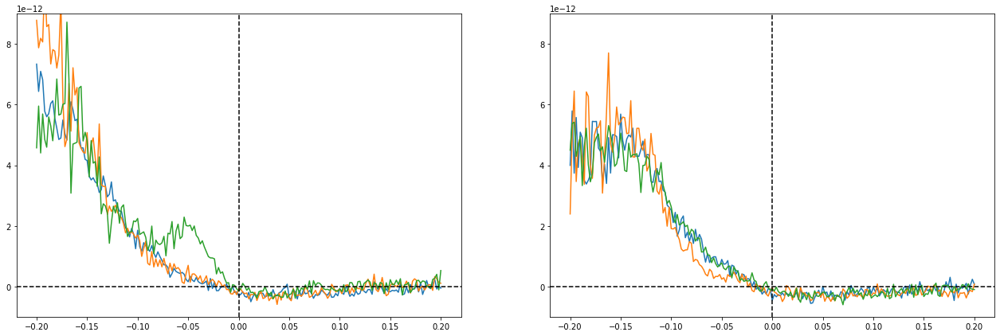

In [ ]:
f,a = plt.subplots(1,2,figsize = (22,7))
a[0].plot(z_axis, exp_cits[int(round(comraw2a[16][0])), int(round(comraw2a[16][1])),:], label = 'Class 2a (21)')
a[0].plot(z_axis, exp_cits[int(round(comraw2a[23][0])), int(round(comraw2a[23][1])),:], label = 'Class 2a (23)')
a[0].plot(z_axis, exp_cits[int(round(comraw2a[9][0])), int(round(comraw2a[9][1])),:], label = 'Class 2a (31)')
a[0].axhline(0, ls = '--', c = 'k')
a[0].axvline(0, ls = '--', c = 'k')

a[1].plot(z_axis, exp_cits[int(round(comraw2b[153][0])), int(round(comraw2b[153][1])),:], label = 'Class 2b (150)')
a[1].plot(z_axis, exp_cits[int(round(comraw2b[156][0])), int(round(comraw2b[156][1])),:], label = 'Class 2b (156)')
a[1].plot(z_axis, exp_cits[int(round(comraw2b[77][0])), int(round(comraw2b[77][1])),:], label = 'Class 2b (48)')
a[1].axhline(0, ls = '--', c = 'k')
a[1].axvline(0, ls = '--', c = 'k')

a[0].set_ylim(-1E-12, 9E-12)
a[1].set_ylim(-1E-12, 9E-12)

* Oh yes, they are vastly different!

### Let's look at a few SPECIFIC images that we choose, and corresponding spectra 

[]

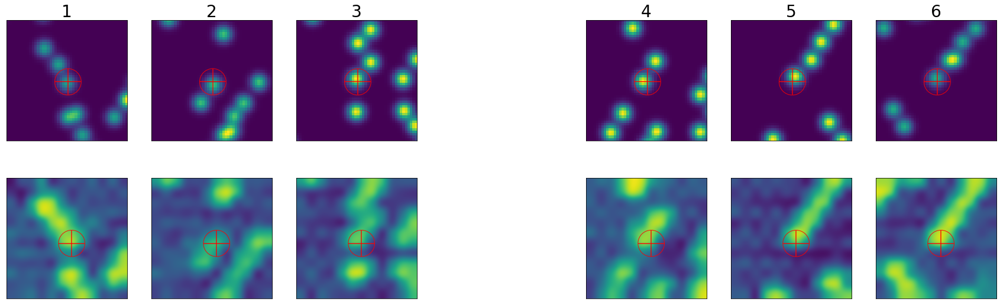

In [ ]:
i1, i2, i3 = 4, 12, 32    ######### ORIGINALLY 7 was 28. But I like 7 better.
k1, k2, k3 = 31, 125, 233


plt.figure(figsize=(30,9))
gs = gridspec.GridSpec(2,7)
ax00 = plt.subplot(gs[0,0])
ax01 = plt.subplot(gs[0,1])
ax02 = plt.subplot(gs[0,2])
ax03 = plt.subplot(gs[0,4])
ax04 = plt.subplot(gs[0,5])
ax05 = plt.subplot(gs[0,6])
ax10 = plt.subplot(gs[1,0])
ax11 = plt.subplot(gs[1,1])
ax12 = plt.subplot(gs[1,2])
ax13 = plt.subplot(gs[1,4])
ax14 = plt.subplot(gs[1,5])
ax15 = plt.subplot(gs[1,6])

ax00.scatter(imgstack_2a_adatoms.shape[1]/2,imgstack_2a_adatoms.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax00.scatter(imgstack_2a_adatoms.shape[1]/2,imgstack_2a_adatoms.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax01.scatter(imgstack_2b_adatoms.shape[1]/2,imgstack_2b_adatoms.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax01.scatter(imgstack_2b_adatoms.shape[1]/2,imgstack_2b_adatoms.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax02.scatter(imgstack_2a_adatoms.shape[1]/2,imgstack_2a_adatoms.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax02.scatter(imgstack_2a_adatoms.shape[1]/2,imgstack_2a_adatoms.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax03.scatter(imgstack_2b_adatoms.shape[1]/2,imgstack_2b_adatoms.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax03.scatter(imgstack_2b_adatoms.shape[1]/2,imgstack_2b_adatoms.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax04.scatter(imgstack_2a_adatoms.shape[1]/2,imgstack_2a_adatoms.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax04.scatter(imgstack_2a_adatoms.shape[1]/2,imgstack_2a_adatoms.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax05.scatter(imgstack_2b_adatoms.shape[1]/2,imgstack_2b_adatoms.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax05.scatter(imgstack_2b_adatoms.shape[1]/2,imgstack_2b_adatoms.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax10.scatter(imgstack_2a_rawimage.shape[1]/2,imgstack_2a_rawimage.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax10.scatter(imgstack_2a_rawimage.shape[1]/2,imgstack_2a_rawimage.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax11.scatter(imgstack_2b_rawimage.shape[1]/2,imgstack_2b_rawimage.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax11.scatter(imgstack_2b_rawimage.shape[1]/2,imgstack_2b_rawimage.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax12.scatter(imgstack_2a_rawimage.shape[1]/2,imgstack_2a_rawimage.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax12.scatter(imgstack_2a_rawimage.shape[1]/2,imgstack_2a_rawimage.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax13.scatter(imgstack_2b_rawimage.shape[1]/2,imgstack_2b_rawimage.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax13.scatter(imgstack_2b_rawimage.shape[1]/2,imgstack_2b_rawimage.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax14.scatter(imgstack_2a_rawimage.shape[1]/2,imgstack_2a_rawimage.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax14.scatter(imgstack_2a_rawimage.shape[1]/2,imgstack_2a_rawimage.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax15.scatter(imgstack_2b_rawimage.shape[1]/2,imgstack_2b_rawimage.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax15.scatter(imgstack_2b_rawimage.shape[1]/2,imgstack_2b_rawimage.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')

ax00.imshow(imgstack_2a_adatoms[i1])
ax01.imshow(imgstack_2a_adatoms[i2])
ax02.imshow(imgstack_2a_adatoms[i3])
ax03.imshow(imgstack_2b_adatoms[k1])
ax04.imshow(imgstack_2b_adatoms[k2])
ax05.imshow(imgstack_2b_adatoms[k3])
ax10.imshow(imgstack_2a_rawimage[i1], interpolation = 'gaussian')
ax11.imshow(imgstack_2a_rawimage[i2], interpolation = 'gaussian')
ax12.imshow(imgstack_2a_rawimage[i3], interpolation = 'gaussian')
ax13.imshow(imgstack_2b_rawimage[k1], interpolation = 'gaussian')
ax14.imshow(imgstack_2b_rawimage[k2], interpolation = 'gaussian')
ax15.imshow(imgstack_2b_rawimage[k3], interpolation = 'gaussian')

# ax00.set_title('2A: {}'.format(i1))
# ax01.set_title('2A:  {}'.format(i2))
# ax02.set_title('2A: {}'.format(i3))
# ax03.set_title('2B: {}'.format(k1))
# ax04.set_title('2B: Adatom {}'.format(k2))
# ax05.set_title('2B: Adatom {}'.format(k3))
# ax10.set_title('2A: Adatom {}'.format(i1))
# ax11.set_title('2A: Adatom {}'.format(i2))
# ax12.set_title('2A: Adatom {}'.format(i3))
# ax13.set_title('2B: Adatom {}'.format(k1))
# ax14.set_title('2B: Adatom {}'.format(k2))
# ax15.set_title('2B: Adatom {}'.format(k3));

ax00.set_title('1', fontsize = 28)
ax01.set_title('2', fontsize = 28)
ax02.set_title('3', fontsize = 28)
ax03.set_title('4', fontsize = 28)
ax04.set_title('5', fontsize = 28)
ax05.set_title('6', fontsize = 28)


plt.setp([ax00, ax01, ax02, ax03, ax04, ax05, ax10, ax11, ax12, ax13, ax14, ax15], xticks = [], yticks = [])

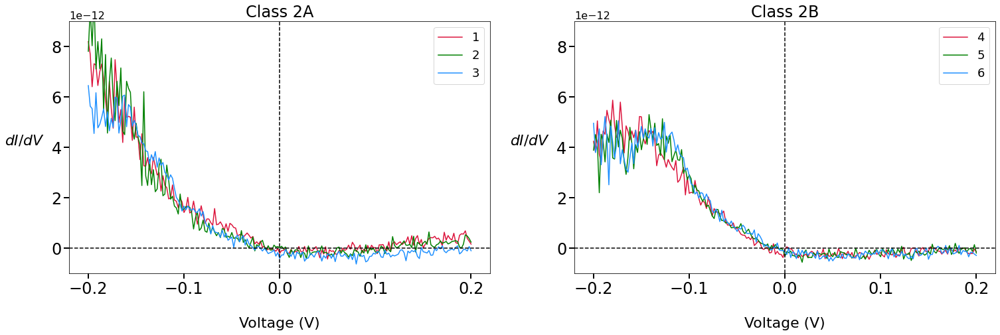

In [ ]:
f,a = plt.subplots(1,2,figsize = (25,7))
# a[0].plot(z_axis, exp_cits[int(round(comraw2a[i1][0])), int(round(comraw2a[i1][1])),:], label = 'Adatom #{}'.format(i1))
a[0].plot(z_axis, exp_cits[int(round(comraw2a[i1][0])), int(round(comraw2a[i1][1])),:], label = '1', color = 'crimson')
a[0].plot(z_axis, exp_cits[int(round(comraw2a[i2][0])), int(round(comraw2a[i2][1])),:], label = '2', color = 'g')
a[0].plot(z_axis, exp_cits[int(round(comraw2a[i3][0])), int(round(comraw2a[i3][1])),:], label = '3', color = 'dodgerblue')
a[0].axhline(0, ls = '--', c = 'k')
a[0].axvline(0, ls = '--', c = 'k')

# a[1].plot(z_axis, exp_cits[int(round(comraw2b[k1][0])), int(round(comraw2b[k1][1])),:], label = 'Adatom #{}'.format(k1))
a[1].plot(z_axis, exp_cits[int(round(comraw2b[k1][0])), int(round(comraw2b[k1][1])),:], label = '4', color = 'crimson')
a[1].plot(z_axis, exp_cits[int(round(comraw2b[k2][0])), int(round(comraw2b[k2][1])),:], label = '5', color = 'g')
a[1].plot(z_axis, exp_cits[int(round(comraw2b[k3][0])), int(round(comraw2b[k3][1])),:], label = '6', color = 'dodgerblue')
a[1].axhline(0, ls = '--', c = 'k')
a[1].axvline(0, ls = '--', c = 'k')


a[0].legend(fontsize = 18)
a[1].legend(fontsize = 18)

a[0].set_ylim(-1E-12, 9E-12)
a[1].set_ylim(-1E-12, 9E-12)

a[0].set_xlabel('Voltage (V)', fontsize = 22, labelpad = 30)
a[1].set_xlabel('Voltage (V)', fontsize = 22, labelpad = 30)
a[0].set_ylabel('$dI/dV$', rotation = 0, fontsize = 22, labelpad = 40)
a[1].set_ylabel('$dI/dV$', rotation = 0, fontsize = 22, labelpad = 40)

a[0].set_title('Class 2A', fontsize = 24)
a[1].set_title('Class 2B', fontsize = 24);

a[0].tick_params(labelsize = 24, size = 8, width = 2)
a[1].tick_params(labelsize = 24, size = 8, width = 2)

a[0].yaxis.get_offset_text().set(size=16)
a[1].yaxis.get_offset_text().set(size=16)

## Repeat with class 4: <font color = 'crimson'> (skipped 3, too few adatoms)</font>

In [ ]:
print("Number of adatoms in class 4: {}".format(blobclass4.shape[0]))

Number of adatoms in class 4: 108


In [ ]:
class4positions = []

for ii in range(blobclass4.shape[0]):
  class4positions.append((int(round(com[blobclass4[ii],1])),int(round(com[blobclass4[ii],0]))))

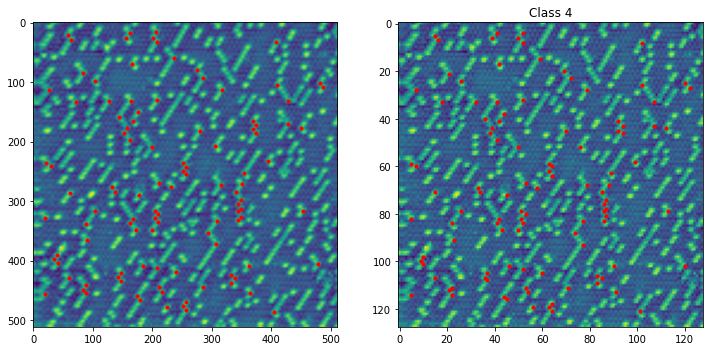

In [ ]:
f,a = plt.subplots(1,2,figsize=(12,6))

for ii in range(len(class4positions)):
  a[0].scatter(class4positions[ii][0], class4positions[ii][1], color = 'r', s = 10)
a[0].imshow(resize(topo_f_n,(512,512)))

a[1].imshow(topo_f_n)
for ii in range(blobclass4.shape[0]):
  a[1].scatter(int(round(com[blobclass4[ii],1]/4)), int(round(com[blobclass4[ii],0]/4)), color = 'r', s = 10)
a[1].set_title('Class 4');

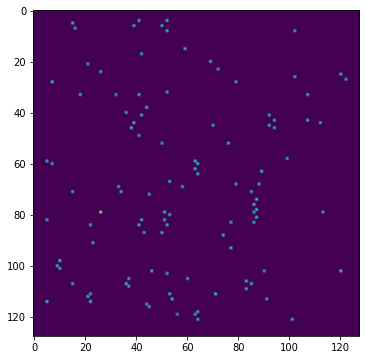

In [ ]:
## Generate array from the (x,y) pairs
Mask4 = np.zeros_like(topo_f_n)
for ii in range(len(class4positions)):
    # Mask1[int(class1positions[ii][0]),int(class1positions[ii][1])] = 1
    Mask4[int(round(com[blobclass4[ii],0]/4)),int(round(com[blobclass4[ii],1]/4))] = 1

## Mask the SPECTRAL data using the Mask1 array
test4 = np.tile(Mask4, (201,1,1))
test4_ = np.swapaxes(np.swapaxes(test4,0,1), 1,2)
test4_.shape
class4_masked = test4_*exp_cits

# Flatten for PCA
XY4 = class4_masked.shape[:2]
class4_masked_flat=class4_masked.reshape((np.prod(XY4),class4_masked.shape[2]))

# Show
plt.figure(figsize=(6,6))
plt.imshow(np.mean(class4_masked[:,:,:],axis=2))

(128, 128, 201)


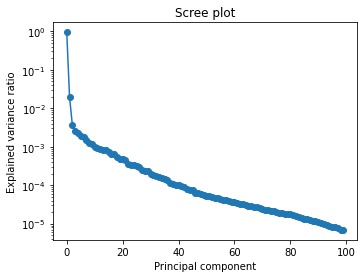

In [ ]:
# PCA on class 4:

fig= plt.figure(figsize=(12,4))
gs = gridspec.GridSpec(1,2)
ax1 = plt.subplot(gs[0,0])

pca = PCA()
pca.fit(class4_masked_flat)
explained_var = pca.explained_variance_ratio_

ax1.plot(explained_var[0:100], 'o-')
ax1.semilogy()
ax1.set_xlabel('Principal component')
ax1.set_ylabel('Explained variance ratio');
ax1.set_title('Scree plot')

print(class4_masked.shape)
w, h, n = class4_masked.shape

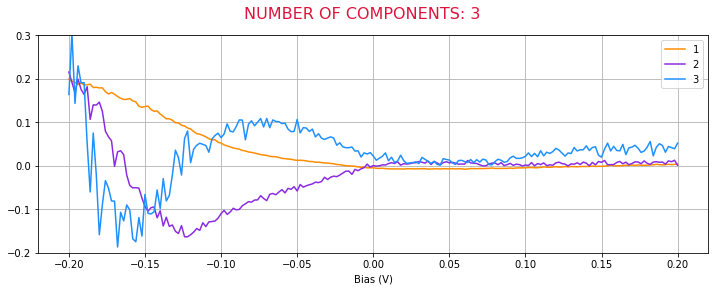

<Figure size 432x288 with 0 Axes>

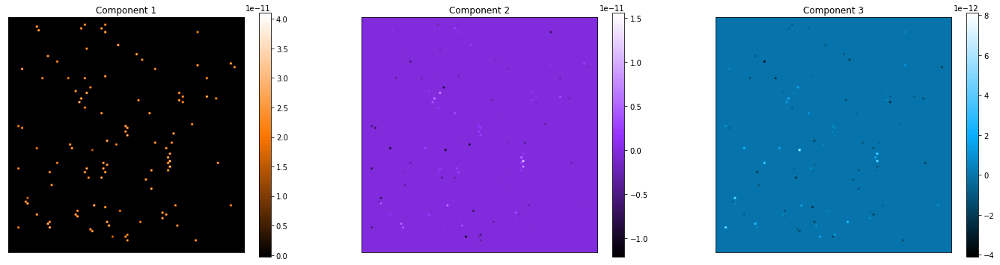

<Figure size 432x288 with 0 Axes>

In [ ]:
nc = 3
cmaps=[bOw, bPw, bBw, bRw, bGw, bBrw, bPiw, bYw, bLGw]
colors=['DarkOrange','BlueViolet','DodgerBlue','Crimson','MediumSeaGreen','Tan','HotPink','Yellow','green', 'black']
clf = PCA(n_components=nc)
X_vec_t = clf.fit_transform(class4_masked_flat)
components = clf.components_
X_vec_t = X_vec_t.reshape(w, h, nc)
rows = int(np.ceil(float(nc)/5))
cols = int(np.ceil(float(nc)/rows))
     
fig1,ax1 = plt.subplots(figsize = (12,4))

plt.suptitle("NUMBER OF COMPONENTS: {}".format(nc), fontsize = 16, color = 'Crimson')
for i in range(nc):
    ax1.plot(z_axis,components[i], color = colors.pop(0), label = i+1)
    ax1.grid(True)
#     ax1.set_xticks(np.arange(0,3.5, step=0.1));
    ax1.set_ylim(-0.2,0.3)
    ax1.set_xlabel('Bias (V)')
    ax1.tick_params(labelsize=10)
    ax1.legend(loc = 'upper right')
plt.show()
plt.savefig("PCA spectra on adatoms only.jpg")

gs2 = gridspec.GridSpec(rows, cols)
fig2 = plt.figure(figsize = (8*cols, 6*(1+rows//2)))   
for i in range(nc):
    ax2 = fig2.add_subplot(gs2[i])
    im2 = ax2.imshow(X_vec_t[:, : ,i],cmap = cmaps.pop(0))
    ax2.set_title('Component ' + str(i + 1))
    plt.colorbar(im2, ax=ax2)
    plt.setp([ax2],xticks=[], yticks=[])
plt.show()
# plt.savefig("PCA spectra on adatoms only")
plt.savefig("PCA loading maps on adatoms only.jpg")

In [ ]:
# plt.figure(figsize=(9,9))
# plt.imshow(topo_f_n)
# plt.imshow(X_vec_t[:,:,1], cmap = 'gray', alpha = 0.7)

## Analyzing PCA on already-classified classes:
1) Threshold an individual component (component 0, for example) to sub-classify the main component based on intensity [[<font color='crimson'>This seems like too much user input here to determine a threshold WITHIN a single component</font>]], or

2) literally use the second PCA component as another class (unclear at the moment, return to this)

### Use <u>second</u> PCA component as secondary class:
* Again note the use of 2nd PCA component and not the first, since first is typically associated with an "average" of sorts. We don't want that, we want the next strongest feature

* There is still some kind of thresholding that needs to be done here.
* --> That's because every pixel will receive a value, none will strictly be ZERO.
* So, maybe we can threshold this around say, 10 or 20% 
* i.e., if value is above 10 or 20%, count this pixel (this atom) as an additional class, & null others

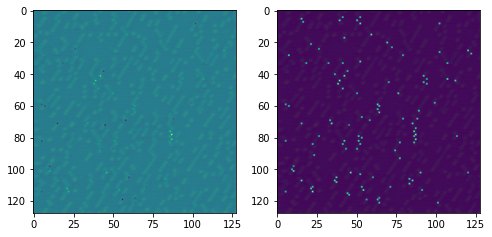

In [ ]:
Class4_PCA0 = X_vec_t[:,:,0]
Class4_PCA1 = X_vec_t[:,:,1]

# normalize [0,1]
Class4_PCA0_n = (Class4_PCA0 - np.min(Class4_PCA0))/np.ptp(Class4_PCA0)
Class4_PCA1_n = (Class4_PCA1 - np.min(Class4_PCA1))/np.ptp(Class4_PCA1)

# plot
f,a = plt.subplots(1,2,figsize=(8,4))
a[0].imshow(topo_f_n)
a[0].imshow(Class4_PCA1_n, vmin = 0, alpha = 0.9)

a[1].imshow(topo_f_n)
a[1].imshow(Class4_PCA0_n, vmin = 0, alpha = 0.9)

In [ ]:
Class4_PCA1_n.min(), Class4_PCA1_n.max()

(0.0, 1.0)

In [ ]:
Mask4.min(), Mask4.max(), 

(0.0, 1.0)

In [ ]:
# The background should be zero (why is it not?? How can the PCA extrapolate? Seems like just some kind of offset to the background..)
# So, let's multiply these by the mask we generated earlier

(0.0, 1.0)

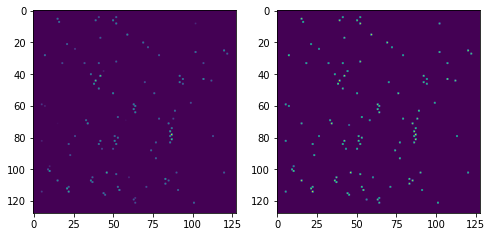

In [ ]:
Class4_PCA1_n_masked = Mask4*Class4_PCA1_n
Class4_PCA0_n_masked = Class4_PCA0_n

f,a = plt.subplots(1,2,figsize=(8,4))
a[0].imshow(Class4_PCA1_n_masked)
a[1].imshow(Class4_PCA0_n_masked)
np.min(Class4_PCA1_n_masked), np.max(Class4_PCA1_n_masked)

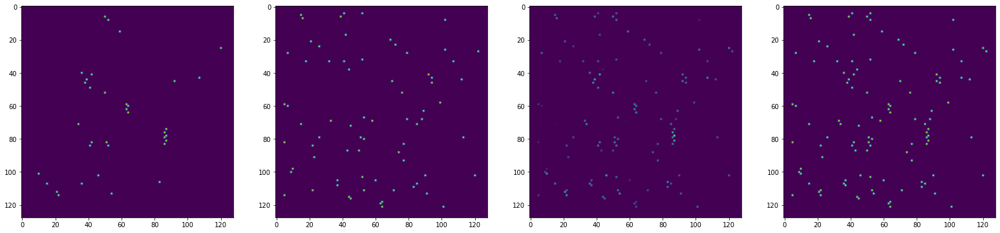

In [ ]:
thresh1 = 0.5
thresh2 = 0.001

# separate the atoms by a threshold value 

# first step is to set all atoms above threshold to 1, and all others to zero.
# This generates a map of only the stronger adatoms (stronger in the PCA component sense)
Class4_PCA1_n_c = np.copy(Class4_PCA1_n_masked)
Class4_PCA1_n_c[np.where(Class4_PCA1_n_c >= thresh1)] = 1
Class4_PCA1_n_c[np.where(Class4_PCA1_n_c < thresh1)] = 0

# Then, to get the remaining atoms, we subtract the ones in previous step from the
# original. And with the original, 

Class4_PCA1_b = Class4_PCA1_n_masked - Class4_PCA1_n_c
Class4_PCA1_b[np.where(Class4_PCA1_b >= thresh2)] = 1
Class4_PCA1_b[np.where(Class4_PCA1_b < thresh2)] = 0


f,a = plt.subplots(1,4,figsize=(27,14))
a[0].imshow(Class4_PCA1_n_c)
a[1].imshow(Class4_PCA1_b)
a[2].imshow(Class4_PCA1_n_masked)
a[3].imshow(Class4_PCA1_n_c + Class4_PCA1_b)

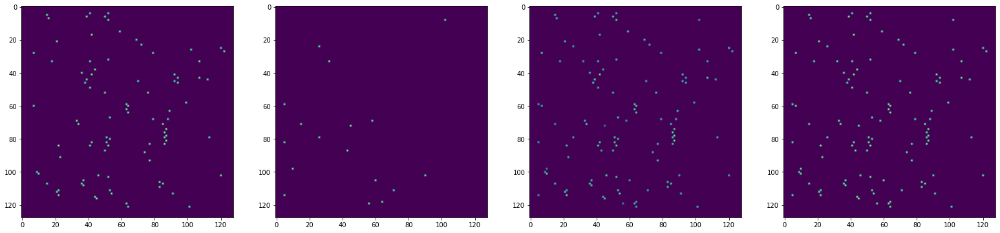

In [ ]:
thresh1 = 0.75
thresh2 = 0.001

# separate the atoms by a threshold value 

# first step is to set all atoms above threshold to 1, and all others to zero.
# This generates a map of only the stronger adatoms (stronger in the PCA component sense)
Class4_PCA0_n_c = np.copy(Class4_PCA0_n_masked)
Class4_PCA0_n_c[np.where(Class4_PCA0_n_c >= thresh1)] = 1
Class4_PCA0_n_c[np.where(Class4_PCA0_n_c < thresh1)] = 0

# Then, to get the remaining atoms, we subtract the ones in previous step from the
# original. And with the original, 

Class4_PCA0_b = Class4_PCA0_n_masked - Class4_PCA0_n_c
Class4_PCA0_b[np.where(Class4_PCA0_b >= thresh2)] = 1
Class4_PCA0_b[np.where(Class4_PCA0_b < thresh2)] = 0


f,a = plt.subplots(1,4,figsize=(27,14))
a[0].imshow(Class4_PCA0_n_c)
a[1].imshow(Class4_PCA0_b)
a[2].imshow(Class4_PCA0_n_masked)
a[3].imshow(Class4_PCA0_n_c + Class4_PCA0_b)

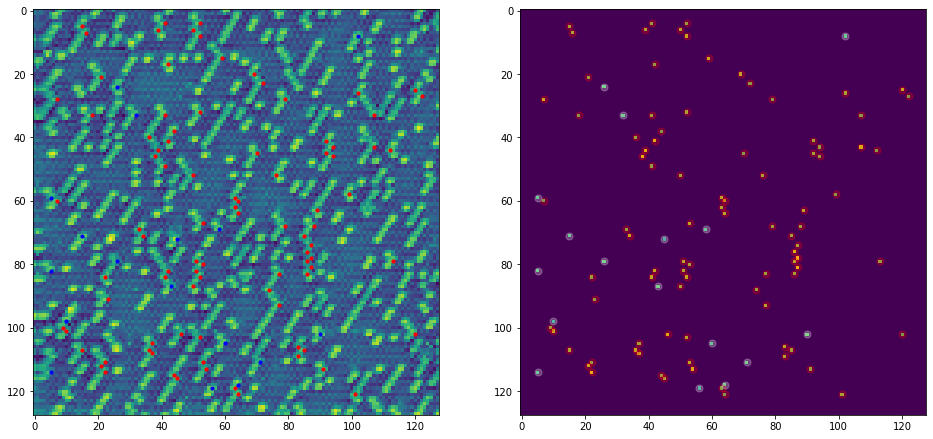

In [ ]:
# Separated Class 2 into two categories: strong PCA0 above 75% intensity in that component (a), and the rest (b)

Class4_PCA0_coords_a = np.argwhere(Class4_PCA0_n_c == 1)
Class4_PCA0_coords_b = np.argwhere(Class4_PCA0_b == 1)

f,a = plt.subplots(1,2,figsize=(16,8))
a[0].imshow(topo_f_n)
for ii in range(Class4_PCA0_coords_a.shape[0]):
  a[0].scatter(Class4_PCA0_coords_a[ii][1], Class4_PCA0_coords_a[ii][0], color = 'r', s = 10)
for ii in range(Class4_PCA0_coords_b.shape[0]): 
  a[0].scatter(Class4_PCA0_coords_b[ii][1], Class4_PCA0_coords_b[ii][0], color = 'b', s = 10)

a[1].imshow(Class4_PCA0_n_masked)
for ii in range(Class4_PCA0_coords_a.shape[0]):
  a[1].scatter(Class4_PCA0_coords_a[ii][1], Class4_PCA0_coords_a[ii][0], color = 'r', s = 50, alpha = 0.25)
for ii in range(Class4_PCA0_coords_b.shape[0]): 
  a[1].scatter(Class4_PCA0_coords_b[ii][1], Class4_PCA0_coords_b[ii][0], color = 'w', s = 50, alpha = 0.25)

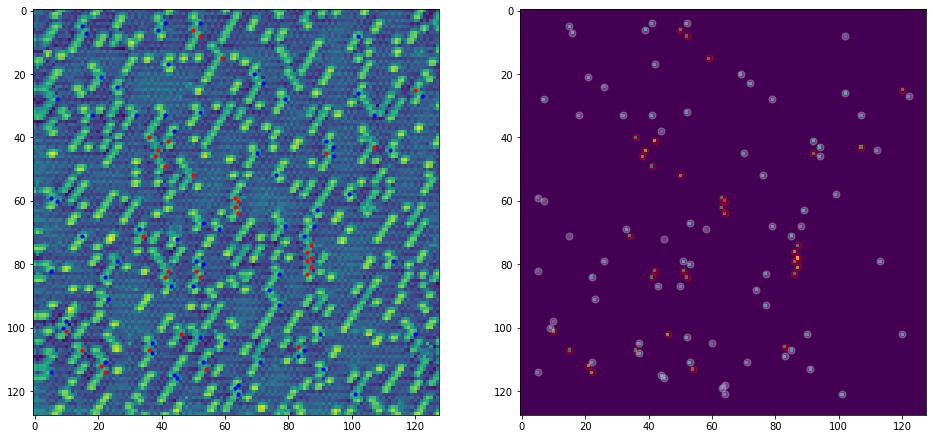

In [ ]:
# Separated Class 2 into two categories: strong PCA1 above 50% intensity in that component (a), and the rest (b)

Class4_PCA1_coords_a = np.argwhere(Class4_PCA1_n_c == 1)
Class4_PCA1_coords_b = np.argwhere(Class4_PCA1_b == 1)

f,a = plt.subplots(1,2,figsize=(16,8))
a[0].imshow(topo_f_n)
for ii in range(Class4_PCA1_coords_a.shape[0]):
  a[0].scatter(Class4_PCA1_coords_a[ii][1], Class4_PCA1_coords_a[ii][0], color = 'r', s = 10)
for ii in range(Class4_PCA1_coords_b.shape[0]): 
  a[0].scatter(Class4_PCA1_coords_b[ii][1], Class4_PCA1_coords_b[ii][0], color = 'b', s = 10)

a[1].imshow(Class4_PCA1_n_masked)
for ii in range(Class4_PCA1_coords_a.shape[0]):
  a[1].scatter(Class4_PCA1_coords_a[ii][1], Class4_PCA1_coords_a[ii][0], color = 'r', s = 50, alpha = 0.25)
for ii in range(Class4_PCA1_coords_b.shape[0]): 
  a[1].scatter(Class4_PCA1_coords_b[ii][1], Class4_PCA1_coords_b[ii][0], color = 'w', s = 50, alpha = 0.25)

In [ ]:
print(Class4_PCA0_coords_a.shape, Class4_PCA0_coords_b.shape)  #75% threshold for PCA 0
print(Class4_PCA1_coords_a.shape, Class4_PCA1_coords_b.shape)  #50% threshold for PCA 1

(91, 2) (17, 2)
(35, 2) (72, 2)


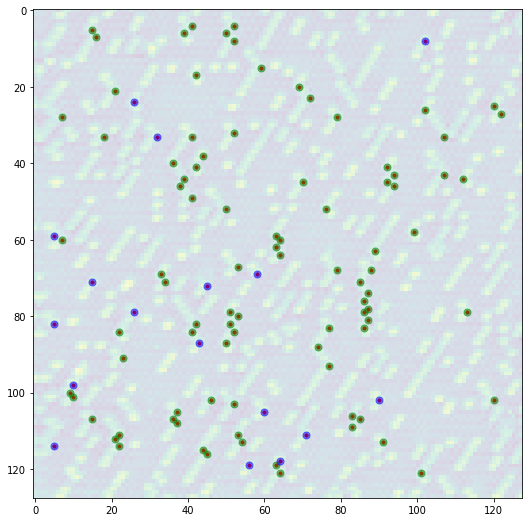

In [ ]:
plt.figure(figsize=(9,9))
plt.imshow(topo_f_n,alpha = 0.2)
for ii in range(blobclass4.shape[0]):
 plt.scatter(int(round(com[blobclass4[ii],1]/4)), int(round(com[blobclass4[ii],0]/4)), color = 'r', s = 10, alpha = 1)

for ii in range(Class4_PCA0_coords_a.shape[0]):
  plt.scatter(Class4_PCA0_coords_a[ii][1], Class4_PCA0_coords_a[ii][0], color = 'g', s = 50, alpha = 0.5)

  
for ii in range(Class4_PCA0_coords_b.shape[0]):
  plt.scatter(Class4_PCA0_coords_b[ii][1], Class4_PCA0_coords_b[ii][0], color = 'b', s = 50, alpha = 0.5)

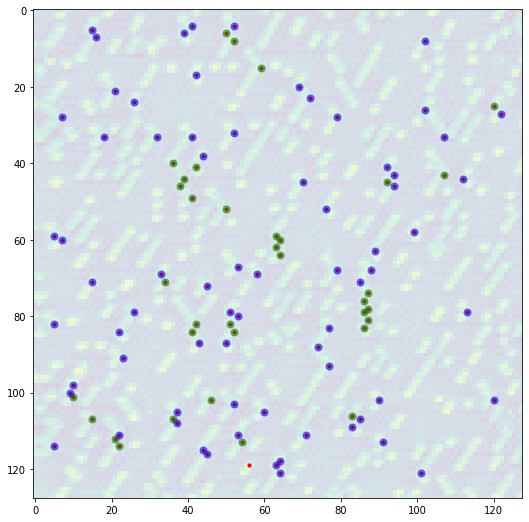

In [ ]:
plt.figure(figsize=(9,9))
plt.imshow(topo_f_n,alpha = 0.2)
for ii in range(blobclass4.shape[0]):
 plt.scatter(int(round(com[blobclass4[ii],1]/4)), int(round(com[blobclass4[ii],0]/4)), color = 'r', s = 10, alpha = 1)

for ii in range(Class4_PCA1_coords_a.shape[0]):
  plt.scatter(Class4_PCA1_coords_a[ii][1], Class4_PCA1_coords_a[ii][0], color = 'g', s = 50, alpha = 0.5)

  
for ii in range(Class4_PCA1_coords_b.shape[0]):
  plt.scatter(Class4_PCA1_coords_b[ii][1], Class4_PCA1_coords_b[ii][0], color = 'b', s = 50, alpha = 0.5)

In [ ]:
scalefactor = 1


## separated PCA 0

class4_pca0_a = np.zeros((Class4_PCA0_coords_a.shape[0],exp_cits.shape[2]))
for ii in range(Class4_PCA0_coords_a.shape[0]):
  class4_pca0_a[ii] = exp_cits[int(Class4_PCA0_coords_a[ii][0]/scalefactor),int(Class4_PCA0_coords_a[ii][1]/scalefactor),:]
class4_pca0_a_mean = np.mean(class4_pca0_a,axis=0)

class4_pca0_b = np.zeros((Class4_PCA0_coords_b.shape[0],exp_cits.shape[2]))
for ii in range(Class4_PCA0_coords_b.shape[0]):
  class4_pca0_b[ii] = exp_cits[int(Class4_PCA0_coords_b[ii][0]/scalefactor),int(Class4_PCA0_coords_b[ii][1]/scalefactor),:]
class4_pca0_b_mean = np.mean(class4_pca0_b,axis=0)

## separated PCA 1

class4_pca1_a = np.zeros((Class4_PCA1_coords_a.shape[0],exp_cits.shape[2]))
for ii in range(Class4_PCA1_coords_a.shape[0]):
  class4_pca1_a[ii] = exp_cits[int(Class4_PCA1_coords_a[ii][0]/scalefactor),int(Class4_PCA1_coords_a[ii][1]/scalefactor),:]
class4_pca1_a_mean = np.mean(class4_pca1_a,axis=0)

class4_pca1_b = np.zeros((Class4_PCA1_coords_b.shape[0],exp_cits.shape[2]))
for ii in range(Class4_PCA1_coords_b.shape[0]):
  class4_pca1_b[ii] = exp_cits[int(Class4_PCA1_coords_b[ii][0]/scalefactor),int(Class4_PCA1_coords_b[ii][1]/scalefactor),:]
class4_pca1_b_mean = np.mean(class4_pca1_b,axis=0)

* Get the standard deviation for a kind of error bar measurement

In [ ]:
class4_pca0_a_stdev = np.std(class4_pca0_a,axis=0)
class4_pca0_b_stdev = np.std(class4_pca0_b,axis=0)

class4_pca1_a_stdev = np.std(class4_pca1_a,axis=0)
class4_pca1_b_stdev = np.std(class4_pca1_b,axis=0)

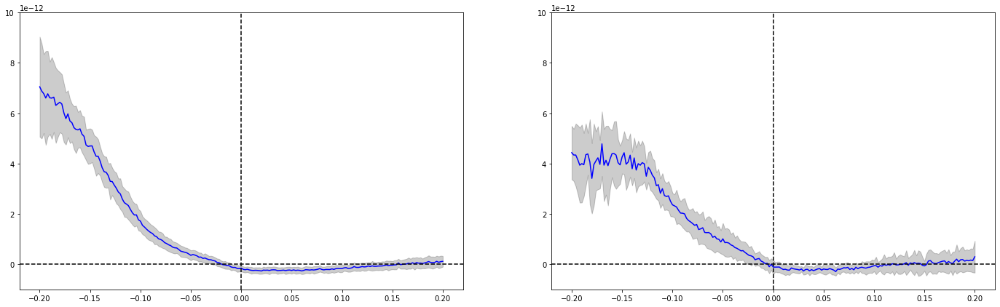

In [ ]:
f,a = plt.subplots(1,2,figsize=(24,7))
a[0].plot(z_axis, class4_pca0_a_mean, color = 'blue')
a[0].fill_between(z_axis, class4_pca0_a_mean - class4_pca0_a_stdev, class4_pca0_a_mean+class4_pca0_a_stdev, alpha = 0.2, color = 'k')
a[0].axvline(0,c='k',ls='--')
a[0].axhline(0,c='k',ls='--')
a[0].set_ylim(-0.1E-11,1E-11);

a[1].plot(z_axis, class4_pca0_b_mean, color = 'blue')
a[1].fill_between(z_axis, class4_pca0_b_mean - class4_pca0_b_stdev, class4_pca0_b_mean+class4_pca0_b_stdev, alpha = 0.2, color = 'k')
a[1].axvline(0,c='k',ls='--')
a[1].axhline(0,c='k',ls='--')
a[1].set_ylim(-0.1E-11,1E-11);

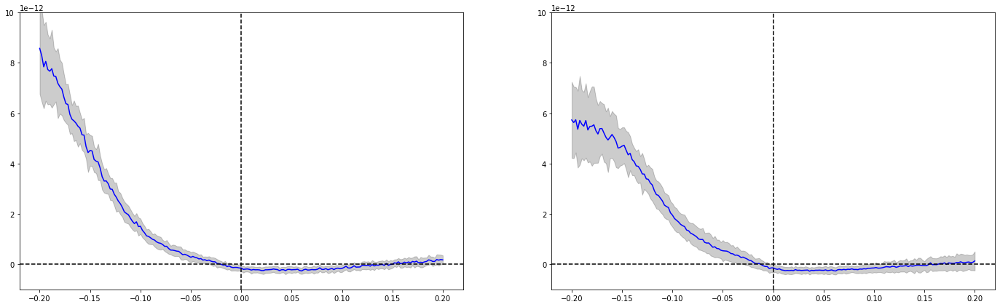

In [ ]:
f,a = plt.subplots(1,2,figsize=(24,7))
a[0].plot(z_axis, class4_pca1_a_mean, color = 'blue')
a[0].fill_between(z_axis, class4_pca1_a_mean - class4_pca1_a_stdev, class4_pca1_a_mean+class4_pca1_a_stdev, alpha = 0.2, color = 'k')
a[0].axvline(0,c='k',ls='--')
a[0].axhline(0,c='k',ls='--')
a[0].set_ylim(-0.1E-11,1E-11);

a[1].plot(z_axis, class4_pca1_b_mean, color = 'blue')
a[1].fill_between(z_axis, class4_pca1_b_mean - class4_pca1_b_stdev, class4_pca1_b_mean+class4_pca1_b_stdev, alpha = 0.2, color = 'k')
a[1].axvline(0,c='k',ls='--')
a[1].axhline(0,c='k',ls='--')
a[1].set_ylim(-0.1E-11,1E-11);

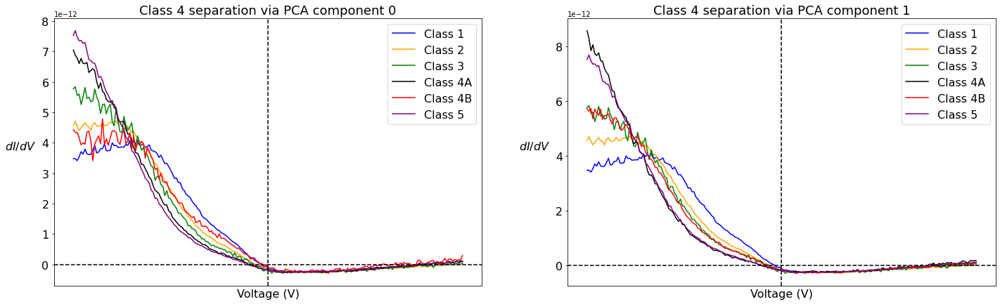

In [ ]:
f,a = plt.subplots(1,2,figsize=(24,7))

a[0].plot(z_axis,class1_mean, label = "Class 1", color = 'blue')
a[0].plot(z_axis,class2_mean, label = "Class 2", color = 'orange')
a[0].plot(z_axis,class3_mean, label = "Class 3", color = 'green')
a[0].plot(z_axis,class4_pca0_a_mean, label = "Class 4A", color = 'k')
a[0].plot(z_axis,class4_pca0_b_mean, label = "Class 4B", color = 'red')
a[0].plot(z_axis,class5_mean, label = "Class 5", color = 'purple')
a[0].axvline(0,c='k',ls='--')
a[0].axhline(0,c='k',ls='--')
a[0].legend(fontsize = 12)

a[0].set_xlabel('Voltage (V)', size = 16);
a[0].set_ylabel('$dI/dV$', size = 16, rotation = 0, labelpad = 30);
a[0].tick_params(axis='both', labelsize = 12)

a[1].plot(z_axis,class1_mean, label = "Class 1", color = 'blue')
a[1].plot(z_axis,class2_mean, label = "Class 2", color = 'orange')
a[1].plot(z_axis,class3_mean, label = "Class 3", color = 'green')
a[1].plot(z_axis,class4_pca1_a_mean, label = "Class 4A", color = 'k')
a[1].plot(z_axis,class4_pca1_b_mean, label = "Class 4B", color = 'red')
a[1].plot(z_axis,class5_mean, label = "Class 5", color = 'purple')
a[1].axvline(0,c='k',ls='--')
a[1].axhline(0,c='k',ls='--')

a[0].legend(fontsize = 16)
a[1].legend(fontsize = 16)

a[1].set_xlabel('Voltage (V)', size = 16);
a[1].set_ylabel('$dI/dV$', size = 16, rotation = 0, labelpad = 30);
a[1].tick_params(axis='both', labelsize = 12)

a[0].set_title("Class 4 separation via PCA component 0", fontsize = 18)
a[1].set_title("Class 4 separation via PCA component 1", fontsize = 18);

a[0].tick_params(labelsize=16)
a[1].tick_params(labelsize=16)

plt.setp([a[0],a[1]], xticks=[]);

* Separation using PCA component 0 seems to just shuffle potentially misclassified (structurally) misclassified atoms into already existing class.
* Note that in this plot (left), there are still essentially 5 spectra
* However, separation via PCA component 1 appears to show a new spectral feature, shown in black curve (Right)

Comparsion (before and after separation)

(-1e-12, 9e-12)

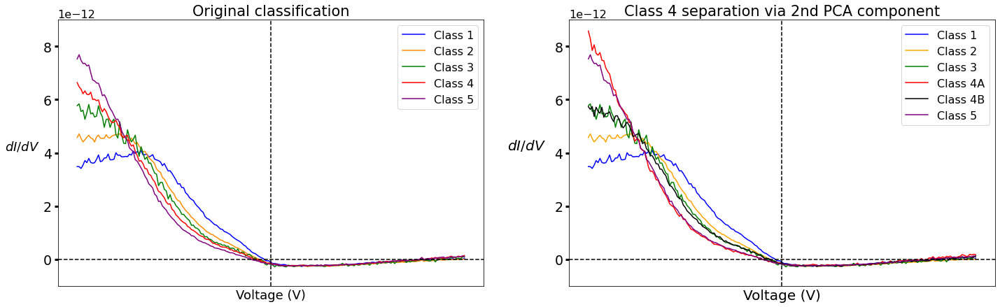

In [ ]:
fig,a = plt.subplots(1,2,figsize=(24,7))
a[0].plot(z_axis,class1_mean, label = "Class 1", color = 'blue')
a[0].plot(z_axis,class2_mean, label = "Class 2", color = 'darkorange')
a[0].plot(z_axis,class3_mean, label = "Class 3", color = 'green')
a[0].plot(z_axis,class4_mean, label = "Class 4", color = 'red')
a[0].plot(z_axis,class5_mean, label = "Class 5", color = 'purple')
a[0].axvline(0,c='k',ls='--')
a[0].axhline(0,c='k',ls='--')



a[0].set_xlabel('Voltage (V)', size = 18);
a[0].set_ylabel('$dI/dV$', size = 18, rotation = 0, labelpad = 30);
a[0].tick_params(labelsize = 16)

# plt.fill_between(z_axis, class1_mean-class1_stdev, class1_mean+class1_stdev, color = 'blue', alpha = 0.2)
# plt.fill_between(z_axis, class2_mean-class2_stdev, class2_mean+class2_stdev, color = 'orange', alpha = 0.2)
# plt.fill_between(z_axis, class3_mean-class3_stdev, class3_mean+class3_stdev, color = 'green', alpha = 0.2)
# plt.fill_between(z_axis, class4_mean-class4_stdev, class4_mean+class4_stdev, color = 'red', alpha = 0.2)
# plt.fill_between(z_axis, class5_mean-class5_stdev, class5_mean+class5_stdev, color = 'purple', alpha = 0.2)

a[1].plot(z_axis,class1_mean, label = "Class 1", color = 'blue')
a[1].plot(z_axis,class2_mean, label = "Class 2", color = 'orange')
a[1].plot(z_axis,class3_mean, label = "Class 3", color = 'green')
a[1].plot(z_axis,class4_pca1_a_mean, label = "Class 4A", color = 'red')
a[1].plot(z_axis,class4_pca1_b_mean, label = "Class 4B", color = 'k')
a[1].plot(z_axis,class5_mean, label = "Class 5", color = 'purple')
a[1].axvline(0,c='k',ls='--')
a[1].axhline(0,c='k',ls='--')

a[0].legend(fontsize = 16)
a[1].legend(fontsize = 16)

a[1].set_xlabel('Voltage (V)', size = 20);
a[1].set_ylabel('$dI/dV$', size = 20, rotation = 0, labelpad = 40);
# a[1].tick_params(axis='both', labelsize = 16)

a[0].set_title("Original classification", fontsize = 21)
a[1].set_title("Class 4 separation via 2nd PCA component", fontsize = 21);

a[0].tick_params(labelsize=19, width = 3, size = 5)
a[1].tick_params(labelsize=19, width = 3, size = 5)

a[0].yaxis.get_offset_text().set(size=16)
a[1].yaxis.get_offset_text().set(size=16)

plt.setp([a[0],a[1]], xticks=[]);

a[0].set_ylim(-1E-12, 9E-12)
a[1].set_ylim(-1E-12, 9E-12)

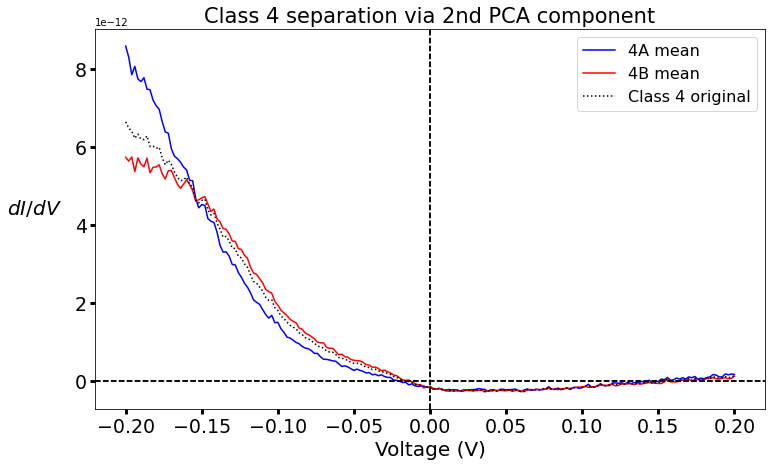

In [ ]:
plt.figure(figsize=(12,7))
plt.axvline(0,c='k',ls='--')
plt.axhline(0,c='k',ls='--')


plt.tick_params(labelsize = 16)

plt.plot(z_axis,class4_pca1_a_mean, label = "4A mean", color = 'blue')
plt.plot(z_axis,class4_pca1_b_mean, label = "4B mean", color = 'r')
plt.plot(z_axis,class4_mean, color = 'k', ls = ':', label = 'Class 4 original')

plt.axvline(0,c='k',ls='--')
plt.axhline(0,c='k',ls='--')

plt.legend(fontsize = 16)
plt.legend(fontsize = 16)

plt.xlabel('Voltage (V)', size = 20);
plt.ylabel('$dI/dV$', size = 20, rotation = 0, labelpad = 40);
# plt.tick_params(axis='both', labelsize = 16)

plt.title("Class 4 separation via 2nd PCA component", fontsize = 21);

plt.tick_params(labelsize=19, width = 3, size = 5)
plt.tick_params(labelsize=19, width = 3, size = 5)


### Are they structurally different? 
### Let's look in real space

In [ ]:
crs = 6 # size of image to crop

imgstack_4a, com4a = extract_subimages(topo_f_n, Class4_PCA1_coords_a, crs)

imgstack_4b, com4b = extract_subimages(topo_f_n, Class4_PCA1_coords_b, crs)

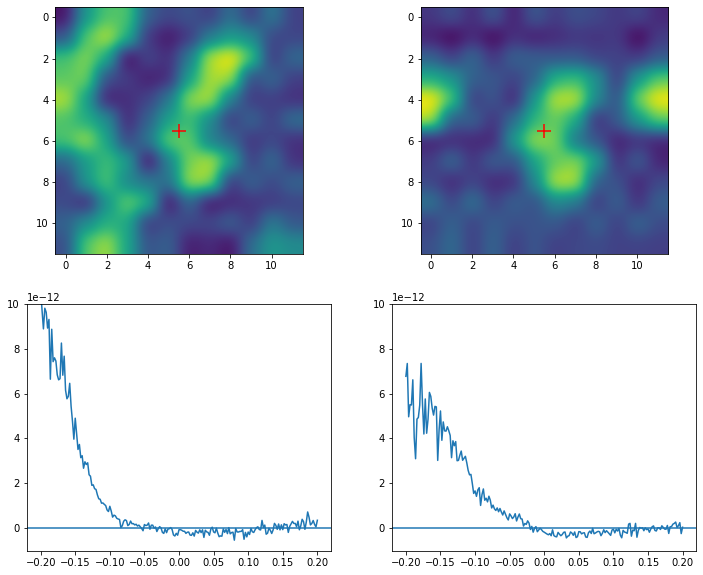

In [ ]:
k1 = 5
k2 = 3

f,a = plt.subplots(2,2,figsize=(12,10))
a[0,0].imshow(imgstack_4a[k1], interpolation = 'gaussian')
a[0,1].imshow(imgstack_4b[k2], interpolation = 'gaussian')
a[0,0].scatter(int(imgstack_4a.shape[2]/2)-0.5, int(imgstack_4a.shape[1]/2)-0.5, marker = '+', c = 'r', s = 200)
a[0,1].scatter(int(imgstack_4a.shape[2]/2)-0.5, int(imgstack_4a.shape[1]/2)-0.5, marker = '+', c = 'r', s = 200)

a[1,0].plot(z_axis,exp_cits[int(round(com4a[k1,0])), int(round(com4a[k1,1])), :])
a[1,1].plot(z_axis,exp_cits[int(round(com4b[k2,0])), int(round(com4b[k2,1])), :])

a[1,0].set_ylim(-1E-12, 10E-12)
a[1,1].set_ylim(-1E-12, 10E-12)

a[1,0].axhline(0)
a[1,1].axhline(0)

## Repeat with class 5:

In [ ]:
print("Number of adatoms in class 5: {}".format(blobclass5.shape[0]))

Number of adatoms in class 5: 160


In [ ]:
class5positions = []

for ii in range(blobclass5.shape[0]):
  class5positions.append((int(round(com[blobclass5[ii],1])),int(round(com[blobclass5[ii],0]))))

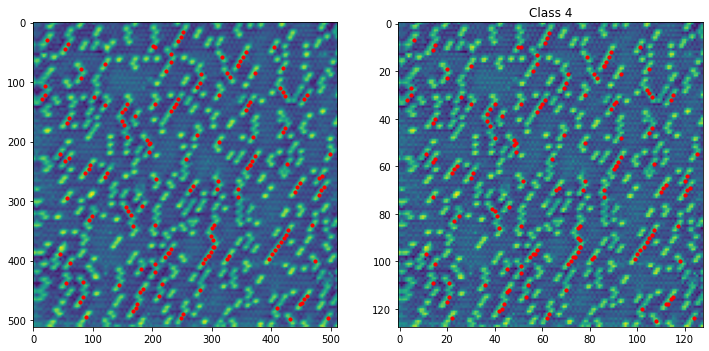

In [ ]:
f,a = plt.subplots(1,2,figsize=(12,6))

for ii in range(len(class5positions)):
  a[0].scatter(class5positions[ii][0], class5positions[ii][1], color = 'r', s = 10)
a[0].imshow(resize(topo_f_n,(512,512)))

a[1].imshow(topo_f_n)
for ii in range(blobclass5.shape[0]):
  a[1].scatter(int(round(com[blobclass5[ii],1]/4)), int(round(com[blobclass5[ii],0]/4)), color = 'r', s = 10)
a[1].set_title('Class 4');

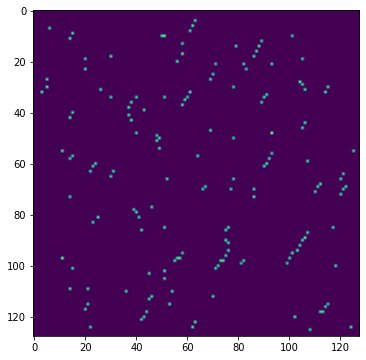

In [ ]:
## Generate array from the (x,y) pairs
Mask5 = np.zeros_like(topo_f_n)
for ii in range(len(class5positions)):
    Mask5[int(round(com[blobclass5[ii],0]/4)),int(round(com[blobclass5[ii],1]/4))] = 1

## Mask the SPECTRAL data using the Mask1 array
test5 = np.tile(Mask5, (201,1,1))
test5_ = np.swapaxes(np.swapaxes(test5,0,1), 1,2)
test5_.shape
class5_masked = test5_*exp_cits

# Flatten for PCA
XY5 = class5_masked.shape[:2]
class5_masked_flat=class5_masked.reshape((np.prod(XY5),class5_masked.shape[2]))

# Show
plt.figure(figsize=(6,6))
plt.imshow(np.mean(class5_masked[:,:,:],axis=2))

(128, 128, 201)


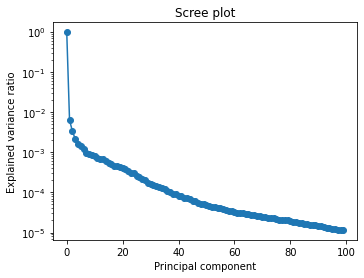

In [ ]:
# PCA on class 5:

fig= plt.figure(figsize=(12,4))
gs = gridspec.GridSpec(1,2)
ax1 = plt.subplot(gs[0,0])

pca = PCA()
pca.fit(class5_masked_flat)
explained_var = pca.explained_variance_ratio_

ax1.plot(explained_var[0:100], 'o-')
ax1.semilogy()
ax1.set_xlabel('Principal component')
ax1.set_ylabel('Explained variance ratio');
ax1.set_title('Scree plot')

print(class5_masked.shape)
w, h, n = class5_masked.shape

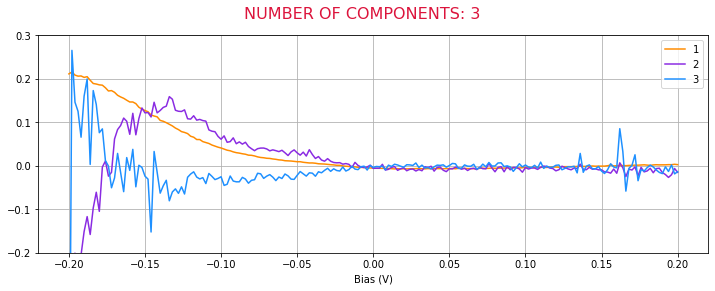

<Figure size 432x288 with 0 Axes>

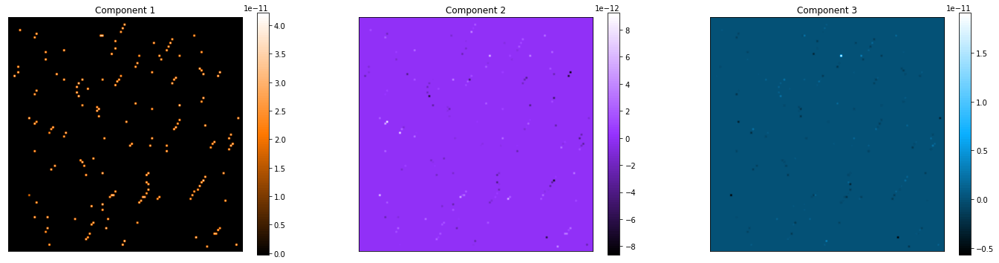

<Figure size 432x288 with 0 Axes>

In [ ]:
nc = 3
cmaps=[bOw, bPw, bBw, bRw, bGw, bBrw, bPiw, bYw, bLGw]
colors=['DarkOrange','BlueViolet','DodgerBlue','Crimson','MediumSeaGreen','Tan','HotPink','Yellow','green', 'black']
clf = PCA(n_components=nc)
X_vec_t = clf.fit_transform(class5_masked_flat)
components = clf.components_
X_vec_t = X_vec_t.reshape(w, h, nc)
rows = int(np.ceil(float(nc)/5))
cols = int(np.ceil(float(nc)/rows))
     
fig1,ax1 = plt.subplots(figsize = (12,4))

plt.suptitle("NUMBER OF COMPONENTS: {}".format(nc), fontsize = 16, color = 'Crimson')
for i in range(nc):
    ax1.plot(z_axis,components[i], color = colors.pop(0), label = i+1)
    ax1.grid(True)
#     ax1.set_xticks(np.arange(0,3.5, step=0.1));
    ax1.set_ylim(-0.2,0.3)
    ax1.set_xlabel('Bias (V)')
    ax1.tick_params(labelsize=10)
    ax1.legend(loc = 'upper right')
plt.show()
plt.savefig("PCA spectra on adatoms only.jpg")

gs2 = gridspec.GridSpec(rows, cols)
fig2 = plt.figure(figsize = (8*cols, 6*(1+rows//2)))   
for i in range(nc):
    ax2 = fig2.add_subplot(gs2[i])
    im2 = ax2.imshow(X_vec_t[:, : ,i],cmap = cmaps.pop(0))
    ax2.set_title('Component ' + str(i + 1))
    plt.colorbar(im2, ax=ax2)
    plt.setp([ax2],xticks=[], yticks=[])
plt.show()
# plt.savefig("PCA spectra on adatoms only")
plt.savefig("PCA loading maps on adatoms only.jpg")

In [ ]:
# plt.figure(figsize=(9,9))
# plt.imshow(topo_f_n)
# plt.imshow(X_vec_t[:,:,1], cmap = 'gray', alpha = 0.7)

## Analyzing PCA on already-classified classes:
1) Threshold an individual component (component 0, for example) to sub-classify the main component based on intensity [[<font color='crimson'>This seems like too much user input here to determine a threshold WITHIN a single component</font>]], or

2) literally use the second PCA component as another class (unclear at the moment, return to this)

### Use <u>second</u> PCA component as secondary class:
* Again note the use of 2nd PCA component and not the first, since first is typically associated with an "average" of sorts. We don't want that, we want the next strongest feature

* There is still some kind of thresholding that needs to be done here.
* --> That's because every pixel will receive a value, none will strictly be ZERO.
* So, maybe we can threshold this around say, 10 or 20% 
* i.e., if value is above 10 or 20%, count this pixel (this atom) as an additional class, & null others

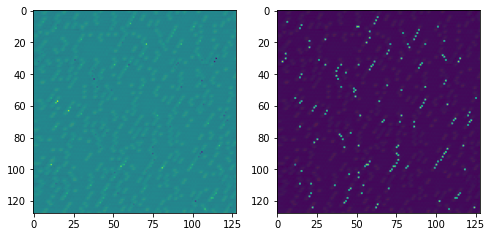

In [ ]:
Class5_PCA0 = X_vec_t[:,:,0]
Class5_PCA1 = X_vec_t[:,:,1]

# normalize [0,1]
Class5_PCA0_n = (Class5_PCA0 - np.min(Class5_PCA0))/np.ptp(Class5_PCA0)
Class5_PCA1_n = (Class5_PCA1 - np.min(Class5_PCA1))/np.ptp(Class5_PCA1)

# plot
f,a = plt.subplots(1,2,figsize=(8,4))
a[0].imshow(topo_f_n)
a[0].imshow(Class5_PCA1_n, vmin = 0, alpha = 0.9)

a[1].imshow(topo_f_n)
a[1].imshow(Class5_PCA0_n, vmin = 0, alpha = 0.9)

In [ ]:
Class5_PCA1_n.min(), Class5_PCA1_n.max()

(0.0, 1.0)

In [ ]:
# The background should be zero (why is it not?? How can the PCA extrapolate? Seems like just some kind of offset to the background..)
# So, let's multiply these by the mask we generated earlier

(0.0, 1.0)

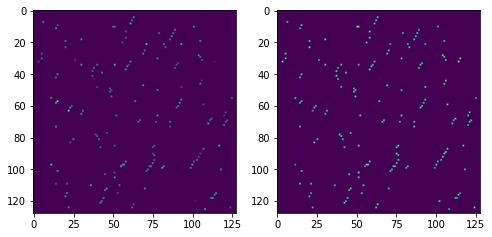

In [ ]:
Class5_PCA1_n_masked = Mask5*Class5_PCA1_n
Class5_PCA0_n_masked = Class5_PCA0_n

f,a = plt.subplots(1,2,figsize=(8,4))
a[0].imshow(Class5_PCA1_n_masked)
a[1].imshow(Class5_PCA0_n_masked)
np.min(Class5_PCA1_n_masked), np.max(Class5_PCA1_n_masked)

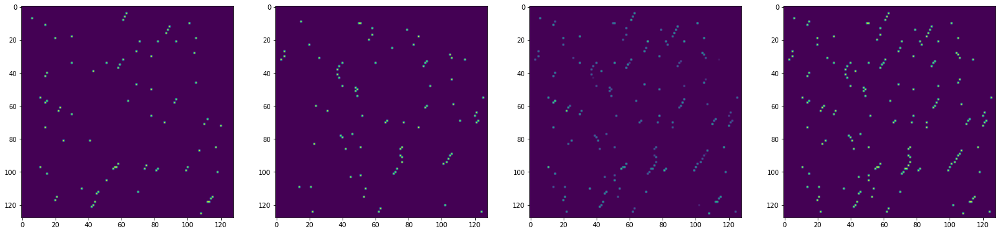

In [ ]:
thresh1 = 0.5
thresh2 = 0.001

# separate the atoms by a threshold value 

# first step is to set all atoms above threshold to 1, and all others to zero.
# This generates a map of only the stronger adatoms (stronger in the PCA component sense)
Class5_PCA1_n_c = np.copy(Class5_PCA1_n_masked)
Class5_PCA1_n_c[np.where(Class5_PCA1_n_c >= thresh1)] = 1
Class5_PCA1_n_c[np.where(Class5_PCA1_n_c < thresh1)] = 0

# Then, to get the remaining atoms, we subtract the ones in previous step from the
# original. And with the original, 

Class5_PCA1_b = Class5_PCA1_n_masked - Class5_PCA1_n_c
Class5_PCA1_b[np.where(Class5_PCA1_b >= thresh2)] = 1
Class5_PCA1_b[np.where(Class5_PCA1_b < thresh2)] = 0


f,a = plt.subplots(1,4,figsize=(27,14))
a[0].imshow(Class5_PCA1_n_c)
a[1].imshow(Class5_PCA1_b)
a[2].imshow(Class5_PCA1_n_masked)
a[3].imshow(Class5_PCA1_n_c + Class5_PCA1_b)

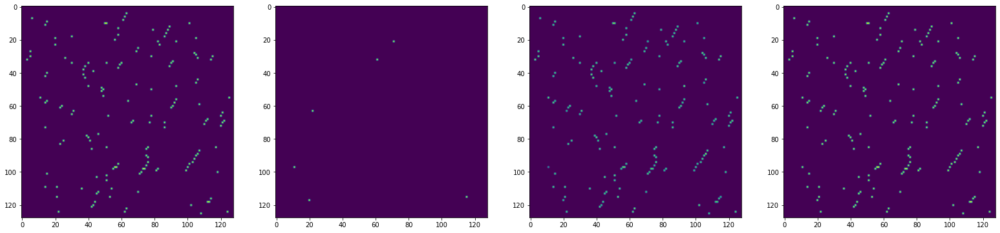

In [ ]:
thresh1 = 0.75
thresh2 = 0.001

# separate the atoms by a threshold value 

# first step is to set all atoms above threshold to 1, and all others to zero.
# This generates a map of only the stronger adatoms (stronger in the PCA component sense)
Class5_PCA0_n_c = np.copy(Class5_PCA0_n_masked)
Class5_PCA0_n_c[np.where(Class5_PCA0_n_c >= thresh1)] = 1
Class5_PCA0_n_c[np.where(Class5_PCA0_n_c < thresh1)] = 0

# Then, to get the remaining atoms, we subtract the ones in previous step from the
# original. And with the original, 

Class5_PCA0_b = Class5_PCA0_n_masked - Class5_PCA0_n_c
Class5_PCA0_b[np.where(Class5_PCA0_b >= thresh2)] = 1
Class5_PCA0_b[np.where(Class5_PCA0_b < thresh2)] = 0


f,a = plt.subplots(1,4,figsize=(27,14))
a[0].imshow(Class5_PCA0_n_c)
a[1].imshow(Class5_PCA0_b)
a[2].imshow(Class5_PCA0_n_masked)
a[3].imshow(Class5_PCA0_n_c + Class5_PCA0_b)

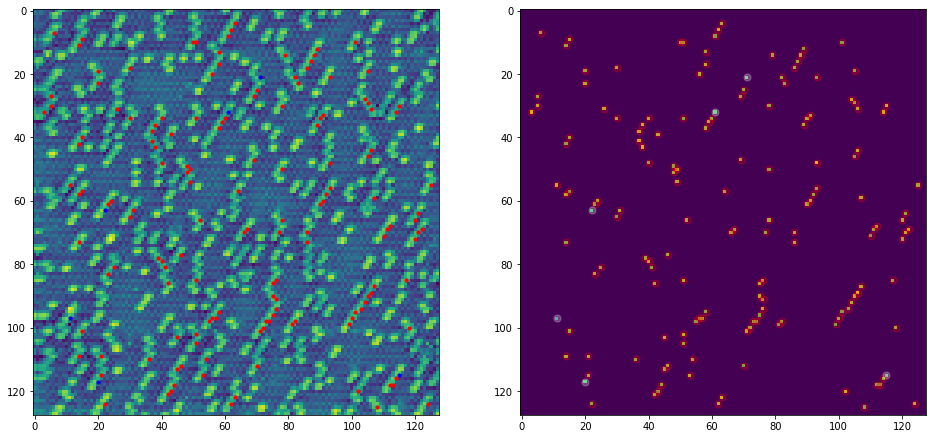

In [ ]:
# Separated Class 2 into two categories: strong PCA0 above 75% intensity in that component (a), and the rest (b)

Class5_PCA0_coords_a = np.argwhere(Class5_PCA0_n_c == 1)
Class5_PCA0_coords_b = np.argwhere(Class5_PCA0_b == 1)

f,a = plt.subplots(1,2,figsize=(16,8))
a[0].imshow(topo_f_n)
for ii in range(Class5_PCA0_coords_a.shape[0]):
  a[0].scatter(Class5_PCA0_coords_a[ii][1], Class5_PCA0_coords_a[ii][0], color = 'r', s = 10)
for ii in range(Class5_PCA0_coords_b.shape[0]): 
  a[0].scatter(Class5_PCA0_coords_b[ii][1], Class5_PCA0_coords_b[ii][0], color = 'b', s = 10)

a[1].imshow(Class5_PCA0_n_masked)
for ii in range(Class5_PCA0_coords_a.shape[0]):
  a[1].scatter(Class5_PCA0_coords_a[ii][1], Class5_PCA0_coords_a[ii][0], color = 'r', s = 50, alpha = 0.25)
for ii in range(Class5_PCA0_coords_b.shape[0]): 
  a[1].scatter(Class5_PCA0_coords_b[ii][1], Class5_PCA0_coords_b[ii][0], color = 'w', s = 50, alpha = 0.25)

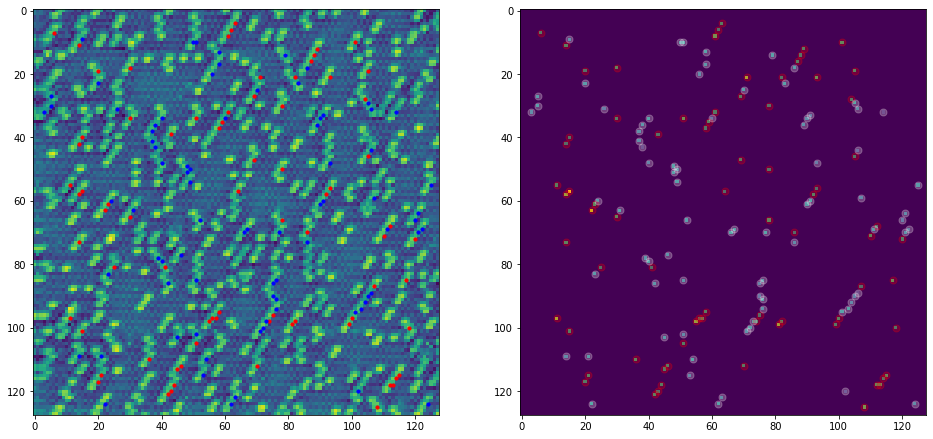

In [ ]:
# Separated Class 2 into two categories: strong PCA1 above 50% intensity in that component (a), and the rest (b)

Class5_PCA1_coords_a = np.argwhere(Class5_PCA1_n_c == 1)
Class5_PCA1_coords_b = np.argwhere(Class5_PCA1_b == 1)

f,a = plt.subplots(1,2,figsize=(16,8))
a[0].imshow(topo_f_n)
for ii in range(Class5_PCA1_coords_a.shape[0]):
  a[0].scatter(Class5_PCA1_coords_a[ii][1], Class5_PCA1_coords_a[ii][0], color = 'r', s = 10)
for ii in range(Class5_PCA1_coords_b.shape[0]): 
  a[0].scatter(Class5_PCA1_coords_b[ii][1], Class5_PCA1_coords_b[ii][0], color = 'b', s = 10)

a[1].imshow(Class5_PCA1_n_masked)
for ii in range(Class5_PCA1_coords_a.shape[0]):
  a[1].scatter(Class5_PCA1_coords_a[ii][1], Class5_PCA1_coords_a[ii][0], color = 'r', s = 50, alpha = 0.25)
for ii in range(Class5_PCA1_coords_b.shape[0]): 
  a[1].scatter(Class5_PCA1_coords_b[ii][1], Class5_PCA1_coords_b[ii][0], color = 'w', s = 50, alpha = 0.25)

In [ ]:
print(Class5_PCA0_coords_a.shape, Class5_PCA0_coords_b.shape)  #75% threshold for PCA 0
print(Class5_PCA1_coords_a.shape, Class5_PCA1_coords_b.shape)  #50% threshold for PCA 1

(151, 2) (6, 2)
(76, 2) (80, 2)


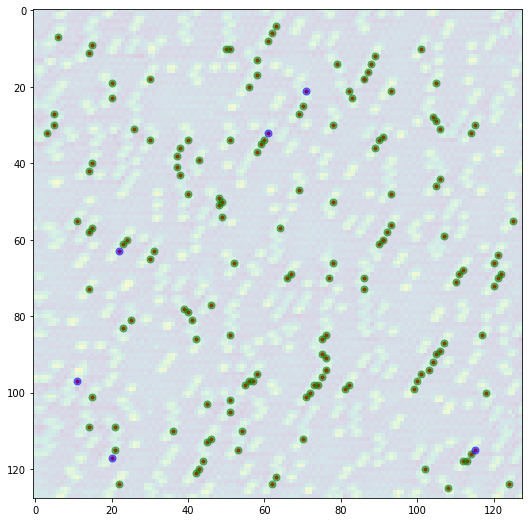

In [ ]:
plt.figure(figsize=(9,9))
plt.imshow(topo_f_n,alpha = 0.2)
for ii in range(blobclass5.shape[0]):
 plt.scatter(int(round(com[blobclass5[ii],1]/4)), int(round(com[blobclass5[ii],0]/4)), color = 'r', s = 10, alpha = 1)

for ii in range(Class5_PCA0_coords_a.shape[0]):
  plt.scatter(Class5_PCA0_coords_a[ii][1], Class5_PCA0_coords_a[ii][0], color = 'g', s = 50, alpha = 0.5)

  
for ii in range(Class5_PCA0_coords_b.shape[0]):
  plt.scatter(Class5_PCA0_coords_b[ii][1], Class5_PCA0_coords_b[ii][0], color = 'b', s = 50, alpha = 0.5)

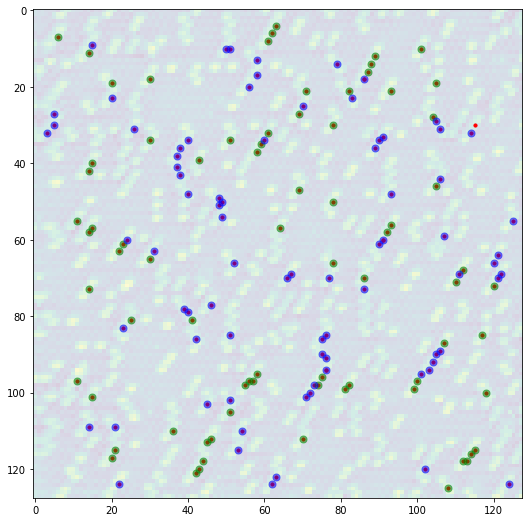

In [ ]:
plt.figure(figsize=(9,9))
plt.imshow(topo_f_n,alpha = 0.2)
for ii in range(blobclass5.shape[0]):
 plt.scatter(int(round(com[blobclass5[ii],1]/4)), int(round(com[blobclass5[ii],0]/4)), color = 'r', s = 10, alpha = 1)

for ii in range(Class5_PCA1_coords_a.shape[0]):
  plt.scatter(Class5_PCA1_coords_a[ii][1], Class5_PCA1_coords_a[ii][0], color = 'g', s = 50, alpha = 0.5)

  
for ii in range(Class5_PCA1_coords_b.shape[0]):
  plt.scatter(Class5_PCA1_coords_b[ii][1], Class5_PCA1_coords_b[ii][0], color = 'b', s = 50, alpha = 0.5)

In [ ]:
scalefactor = 1


## separated PCA 0

class5_pca0_a = np.zeros((Class5_PCA0_coords_a.shape[0],exp_cits.shape[2]))
for ii in range(Class5_PCA0_coords_a.shape[0]):
  class5_pca0_a[ii] = exp_cits[int(Class5_PCA0_coords_a[ii][0]/scalefactor),int(Class5_PCA0_coords_a[ii][1]/scalefactor),:]
class5_pca0_a_mean = np.mean(class5_pca0_a,axis=0)

class5_pca0_b = np.zeros((Class5_PCA0_coords_b.shape[0],exp_cits.shape[2]))
for ii in range(Class5_PCA0_coords_b.shape[0]):
  class5_pca0_b[ii] = exp_cits[int(Class5_PCA0_coords_b[ii][0]/scalefactor),int(Class5_PCA0_coords_b[ii][1]/scalefactor),:]
class5_pca0_b_mean = np.mean(class5_pca0_b,axis=0)

## separated PCA 1

class5_pca1_a = np.zeros((Class5_PCA1_coords_a.shape[0],exp_cits.shape[2]))
for ii in range(Class5_PCA1_coords_a.shape[0]):
  class5_pca1_a[ii] = exp_cits[int(Class5_PCA1_coords_a[ii][0]/scalefactor),int(Class5_PCA1_coords_a[ii][1]/scalefactor),:]
class5_pca1_a_mean = np.mean(class5_pca1_a,axis=0)

class5_pca1_b = np.zeros((Class5_PCA1_coords_b.shape[0],exp_cits.shape[2]))
for ii in range(Class5_PCA1_coords_b.shape[0]):
  class5_pca1_b[ii] = exp_cits[int(Class5_PCA1_coords_b[ii][0]/scalefactor),int(Class5_PCA1_coords_b[ii][1]/scalefactor),:]
class5_pca1_b_mean = np.mean(class5_pca1_b,axis=0)

* Get the standard deviation for a kind of error bar measurement

In [ ]:
class5_pca0_a_stdev = np.std(class5_pca0_a,axis=0)
class5_pca0_b_stdev = np.std(class5_pca0_b,axis=0)

class5_pca1_a_stdev = np.std(class5_pca1_a,axis=0)
class5_pca1_b_stdev = np.std(class5_pca1_b,axis=0)

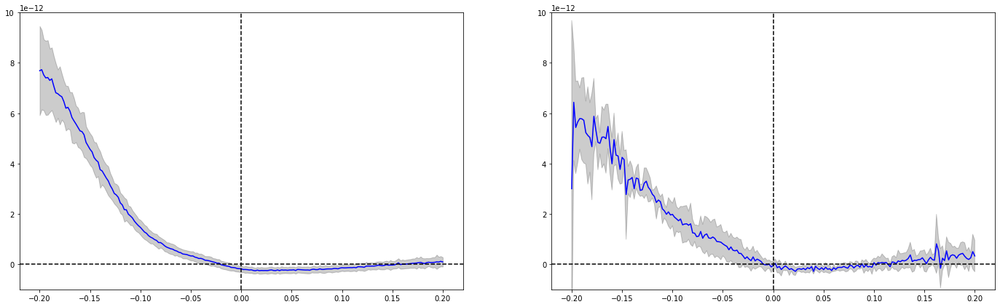

In [ ]:
f,a = plt.subplots(1,2,figsize=(24,7))
a[0].plot(z_axis, class5_pca0_a_mean, color = 'blue')
a[0].fill_between(z_axis, class5_pca0_a_mean - class5_pca0_a_stdev, class5_pca0_a_mean+class5_pca0_a_stdev, alpha = 0.2, color = 'k')
a[0].axvline(0,c='k',ls='--')
a[0].axhline(0,c='k',ls='--')
a[0].set_ylim(-0.1E-11,1E-11);

a[1].plot(z_axis, class5_pca0_b_mean, color = 'blue')
a[1].fill_between(z_axis, class5_pca0_b_mean - class5_pca0_b_stdev, class5_pca0_b_mean+class5_pca0_b_stdev, alpha = 0.2, color = 'k')
a[1].axvline(0,c='k',ls='--')
a[1].axhline(0,c='k',ls='--')
a[1].set_ylim(-0.1E-11,1E-11);

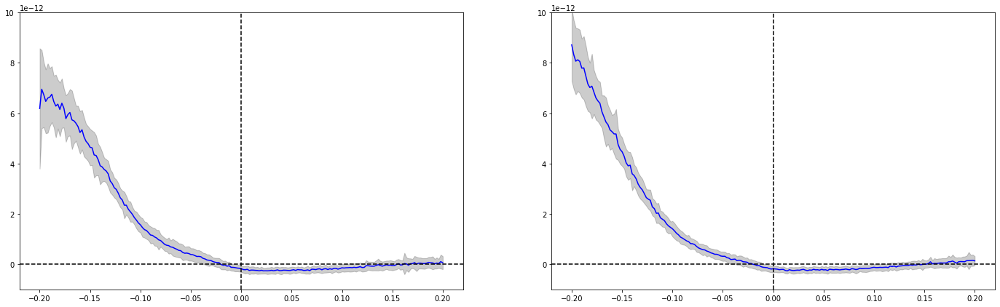

In [ ]:
f,a = plt.subplots(1,2,figsize=(24,7))
a[0].plot(z_axis, class5_pca1_a_mean, color = 'blue')
a[0].fill_between(z_axis, class5_pca1_a_mean - class5_pca1_a_stdev, class5_pca1_a_mean+class5_pca1_a_stdev, alpha = 0.2, color = 'k')
a[0].axvline(0,c='k',ls='--')
a[0].axhline(0,c='k',ls='--')
a[0].set_ylim(-0.1E-11,1E-11);

a[1].plot(z_axis, class5_pca1_b_mean, color = 'blue')
a[1].fill_between(z_axis, class5_pca1_b_mean - class5_pca1_b_stdev, class5_pca1_b_mean+class5_pca1_b_stdev, alpha = 0.2, color = 'k')
a[1].axvline(0,c='k',ls='--')
a[1].axhline(0,c='k',ls='--')
a[1].set_ylim(-0.1E-11,1E-11);

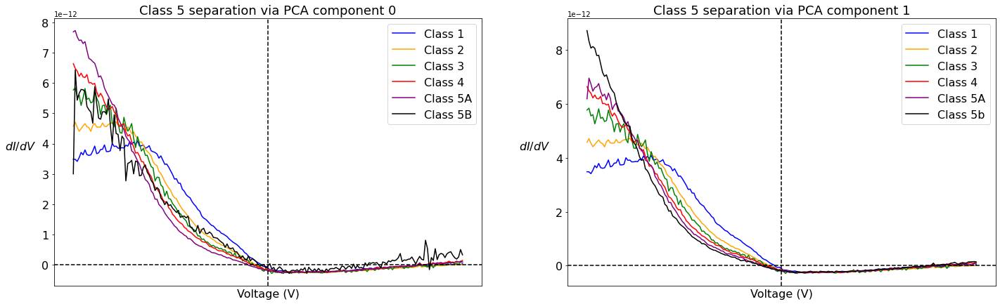

In [ ]:
f,a = plt.subplots(1,2,figsize=(24,7))

a[0].plot(z_axis,class1_mean, label = "Class 1", color = 'blue')
a[0].plot(z_axis,class2_mean, label = "Class 2", color = 'orange')
a[0].plot(z_axis,class3_mean, label = "Class 3", color = 'green')
a[0].plot(z_axis,class4_mean, label = "Class 4", color = 'r')
a[0].plot(z_axis,class5_pca0_a_mean, label = "Class 5A", color = 'purple')
a[0].plot(z_axis,class5_pca0_b_mean, label = "Class 5B", color = 'k')

a[0].axvline(0,c='k',ls='--')
a[0].axhline(0,c='k',ls='--')
a[0].legend(fontsize = 12)

a[0].set_xlabel('Voltage (V)', size = 16);
a[0].set_ylabel('$dI/dV$', size = 16, rotation = 0, labelpad = 30);
a[0].tick_params(axis='both', labelsize = 12)

a[1].plot(z_axis,class1_mean, label = "Class 1", color = 'blue')
a[1].plot(z_axis,class2_mean, label = "Class 2", color = 'orange')
a[1].plot(z_axis,class3_mean, label = "Class 3", color = 'green')
a[1].plot(z_axis,class4_mean, label = "Class 4", color = 'red')
a[1].plot(z_axis,class5_pca1_a_mean, label = "Class 5A", color = 'purple')
a[1].plot(z_axis,class5_pca1_b_mean, label = "Class 5b", color = 'k')

a[1].axvline(0,c='k',ls='--')
a[1].axhline(0,c='k',ls='--')

a[0].legend(fontsize = 16)
a[1].legend(fontsize = 16)

a[1].set_xlabel('Voltage (V)', size = 16);
a[1].set_ylabel('$dI/dV$', size = 16, rotation = 0, labelpad = 30);
a[1].tick_params(axis='both', labelsize = 12)

a[0].set_title("Class 5 separation via PCA component 0", fontsize = 18)
a[1].set_title("Class 5 separation via PCA component 1", fontsize = 18);

a[0].tick_params(labelsize=16)
a[1].tick_params(labelsize=16)

plt.setp([a[0],a[1]], xticks=[]);

* Separation using PCA component 0 seems to just shuffle potentially misclassified (structurally) misclassified atoms into already existing class.
* Note that in this plot (left), there are still essentially 5 spectra
* However, separation via PCA component 1 appears to show a new spectral feature, shown in black curve (Right)

Comparsion (before and after separation)

(-1e-12, 9e-12)

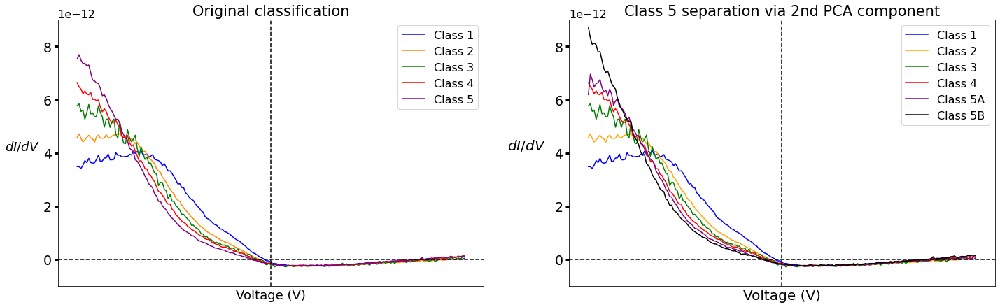

In [ ]:
fig,a = plt.subplots(1,2,figsize=(24,7))
a[0].plot(z_axis,class1_mean, label = "Class 1", color = 'blue')
a[0].plot(z_axis,class2_mean, label = "Class 2", color = 'darkorange')
a[0].plot(z_axis,class3_mean, label = "Class 3", color = 'green')
a[0].plot(z_axis,class4_mean, label = "Class 4", color = 'red')
a[0].plot(z_axis,class5_mean, label = "Class 5", color = 'purple')
a[0].axvline(0,c='k',ls='--')
a[0].axhline(0,c='k',ls='--')



a[0].set_xlabel('Voltage (V)', size = 18);
a[0].set_ylabel('$dI/dV$', size = 18, rotation = 0, labelpad = 30);
a[0].tick_params(labelsize = 16)

# plt.fill_between(z_axis, class1_mean-class1_stdev, class1_mean+class1_stdev, color = 'blue', alpha = 0.2)
# plt.fill_between(z_axis, class2_mean-class2_stdev, class2_mean+class2_stdev, color = 'orange', alpha = 0.2)
# plt.fill_between(z_axis, class3_mean-class3_stdev, class3_mean+class3_stdev, color = 'green', alpha = 0.2)
# plt.fill_between(z_axis, class4_mean-class4_stdev, class4_mean+class4_stdev, color = 'red', alpha = 0.2)
# plt.fill_between(z_axis, class5_mean-class5_stdev, class5_mean+class5_stdev, color = 'purple', alpha = 0.2)

a[1].plot(z_axis,class1_mean, label = "Class 1", color = 'blue')
a[1].plot(z_axis,class2_mean, label = "Class 2", color = 'orange')
a[1].plot(z_axis,class3_mean, label = "Class 3", color = 'green')
a[1].plot(z_axis,class4_mean, label = "Class 4", color = 'red')
a[1].plot(z_axis,class5_pca1_a_mean, label = "Class 5A", color = 'purple')
a[1].plot(z_axis,class5_pca1_b_mean, label = "Class 5B", color = 'k')
a[1].axvline(0,c='k',ls='--')
a[1].axhline(0,c='k',ls='--')

a[0].legend(fontsize = 16)
a[1].legend(fontsize = 16)

a[1].set_xlabel('Voltage (V)', size = 20);
a[1].set_ylabel('$dI/dV$', size = 20, rotation = 0, labelpad = 40);
# a[1].tick_params(axis='both', labelsize = 16)

a[0].set_title("Original classification", fontsize = 21)
a[1].set_title("Class 5 separation via 2nd PCA component", fontsize = 21);

a[0].tick_params(labelsize=19, width = 3, size = 5)
a[1].tick_params(labelsize=19, width = 3, size = 5)

a[0].yaxis.get_offset_text().set(size=16)
a[1].yaxis.get_offset_text().set(size=16)

plt.setp([a[0],a[1]], xticks=[]);

a[0].set_ylim(-1E-12, 9E-12)
a[1].set_ylim(-1E-12, 9E-12)

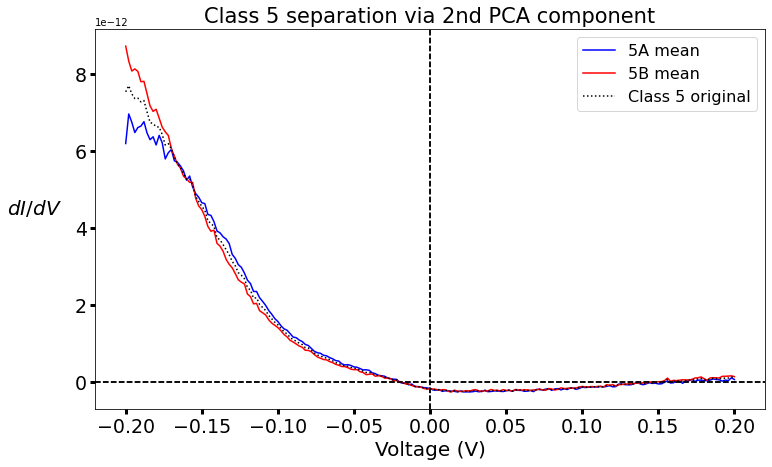

In [ ]:
plt.figure(figsize=(12,7))
plt.axvline(0,c='k',ls='--')
plt.axhline(0,c='k',ls='--')


plt.tick_params(labelsize = 16)

plt.plot(z_axis,class5_pca1_a_mean, label = "5A mean", color = 'blue')
plt.plot(z_axis,class5_pca1_b_mean, label = "5B mean", color = 'r')
plt.plot(z_axis,class5_mean, color = 'k', ls = ':', label = 'Class 5 original')

plt.axvline(0,c='k',ls='--')
plt.axhline(0,c='k',ls='--')

plt.legend(fontsize = 16)
plt.legend(fontsize = 16)

plt.xlabel('Voltage (V)', size = 20);
plt.ylabel('$dI/dV$', size = 20, rotation = 0, labelpad = 40);
# plt.tick_params(axis='both', labelsize = 16)

plt.title("Class 5 separation via 2nd PCA component", fontsize = 21);

plt.tick_params(labelsize=19, width = 3, size = 5)
plt.tick_params(labelsize=19, width = 3, size = 5)


### Are they structurally different? 
### Let's look in real space

In [ ]:
crs = 6 # size of image to crop

imgstack_5a, com5a = extract_subimages(topo_f_n, Class5_PCA1_coords_a, crs)

imgstack_5b, com5b = extract_subimages(topo_f_n, Class5_PCA1_coords_b, crs)

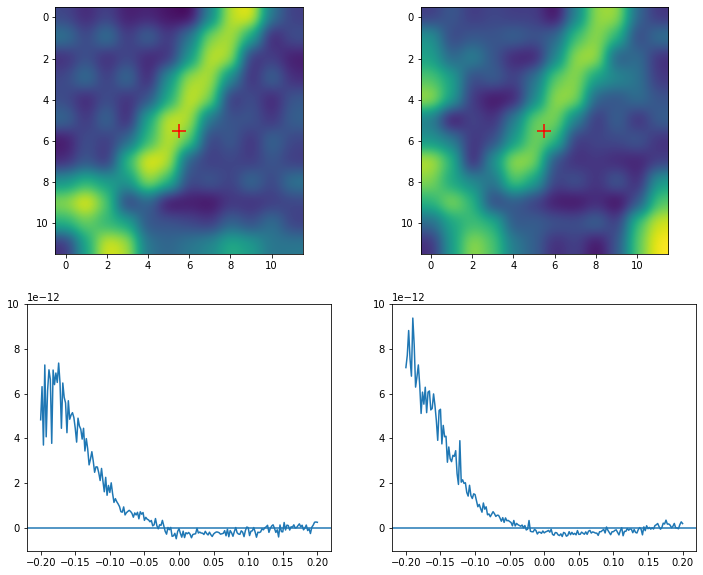

In [ ]:
k1 = 2
k2 = 6

f,a = plt.subplots(2,2,figsize=(12,10))
a[0,0].imshow(imgstack_5a[k1], interpolation = 'gaussian')
a[0,1].imshow(imgstack_5b[k2], interpolation = 'gaussian')
a[0,0].scatter(int(imgstack_5a.shape[2]/2)-0.5, int(imgstack_5a.shape[1]/2)-0.5, marker = '+', c = 'r', s = 200)
a[0,1].scatter(int(imgstack_5a.shape[2]/2)-0.5, int(imgstack_5a.shape[1]/2)-0.5, marker = '+', c = 'r', s = 200)

a[1,0].plot(z_axis,exp_cits[int(round(com5a[k1,0])), int(round(com5a[k1,1])), :])
a[1,1].plot(z_axis,exp_cits[int(round(com5b[k2,0])), int(round(com5b[k2,1])), :])

a[1,0].set_ylim(-1E-12, 10E-12)
a[1,1].set_ylim(-1E-12, 10E-12)

a[1,0].axhline(0)
a[1,1].axhline(0)

# LDOS calc and plot

Is this even correct? 

LDOS = (dI/dV) / (I/V)


In [ ]:
# class_mean2_IV = np.zeros((6,201))
# class_mean2 = np.zeros((6,201))

# class_mean2[0] = class1_mean

# class_mean2[0] = class1_mean
# class_mean2[1] = class2_pca1_a_mean
# class_mean2[2] = class2_pca1_b_mean
# class_mean2[3] = class3_mean
# class_mean2[4] = class4_mean
# class_mean2[5] = class5_mean

# class_mean2_IV[0] = class1_mean_IV
# class_mean2_IV[1] = class2_pca1_a_mean_IV
# class_mean2_IV[2] = class2_pca1_b_mean_IV
# class_mean2_IV[3] = class3_mean_IV
# class_mean2_IV[4] = class4_mean_IV
# class_mean2_IV[5] = class5_mean_IV

In [ ]:
# LDOS=np.zeros((6,201))
# LDOS[0] = class_mean2[0]/class_mean2_IV[0]
# LDOS[1] = class_mean2[1]/class_mean2_IV[1]
# LDOS[2] = class_mean2[2]/class_mean2_IV[2]
# LDOS[3] = class_mean2[3]/class_mean2_IV[3]
# LDOS[4] = class_mean2[4]/class_mean2_IV[4]
# LDOS[5] = class_mean2[5]/class_mean2_IV[5]

(-0.25, 0.25)

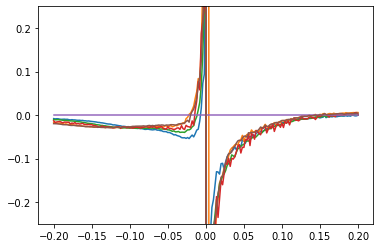

In [ ]:
# plt.plot(z_axis, LDOS[0])
# plt.plot(z_axis, LDOS[1])
# plt.plot(z_axis, LDOS[2])
# plt.plot(z_axis, LDOS[3])
# plt.plot(z_axis, LDOS[4])
# plt.plot(z_axis, LDOS[5])

# plt.ylim(-0.25,0.25)

# want to try something...

In [ ]:
## blur all spectra

bluramount = 5

exp_cits_blurred = np.zeros_like(exp_cits)
for ii in range(exp_cits.shape[0]):
  for jj in range(exp_cits.shape[1]):
    exp_cits_blurred[ii,jj,:] = ndimage.gaussian_filter(exp_cits[ii,jj,:], sigma = bluramount)

## take maximum of the range of first few energy pixels

blurmax = np.zeros((exp_cits.shape[0], exp_cits.shape[1]))
for ii in range(exp_cits_blurred.shape[0]):
  for jj in range(exp_cits_blurred.shape[1]):
    blurmax[ii,jj] = np.max(exp_cits_blurred[ii,jj,0:20])



## in real space, plot the maximums. Does it show anything?


In [ ]:
np.min(blurmax), np.max(blurmax)

(-9.387719551376406e-13, 3.150956578990005e-11)

In [ ]:
## Here we only really care about the range of 0 to, say, 1E-11

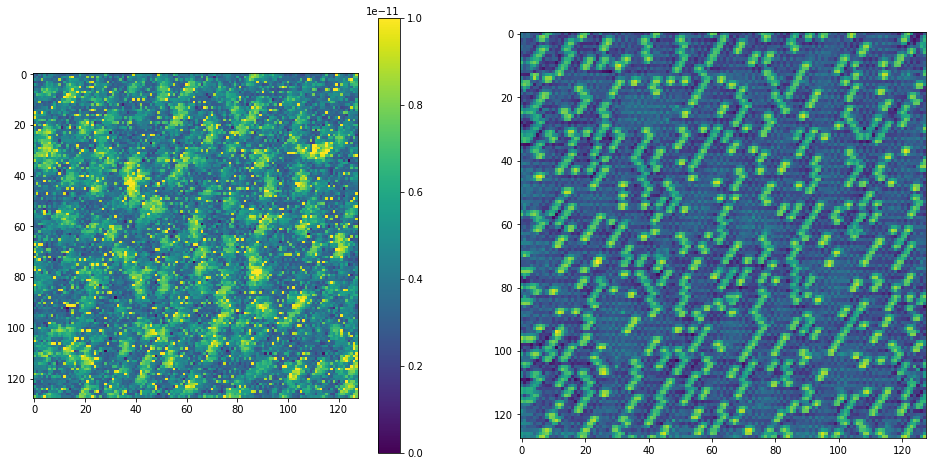

In [ ]:
f,a = plt.subplots(1,2,figsize=(16,8))
im0 = a[0].imshow(blurmax, vmin = 0, vmax = 1E-11, cmap = 'viridis')
a[1].imshow(topo_f_n)
plt.colorbar(im0, ax = [a[0]])

In [ ]:
# This looks like some of the PCA components when running PCA on the entire dataset.
# Clearly the spectra are difficult to localize to the individual atoms..  

# last try here, let's  plot a few of those above with different vmin vmax:

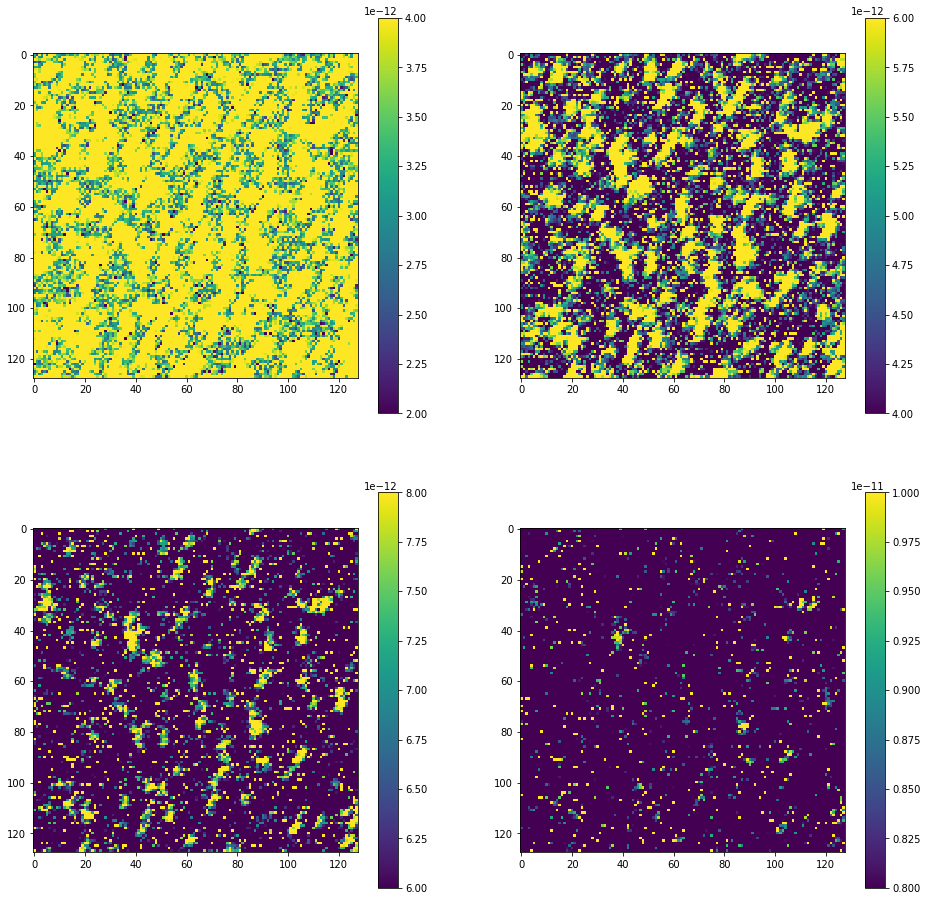

In [ ]:
f,a = plt.subplots(2,2,figsize=(16,16))
im00 = a[0,0].imshow(blurmax, vmin = 2E-12, vmax = 4E-12, cmap = 'viridis')
im01 = a[0,1].imshow(blurmax, vmin = 4E-12, vmax = 6E-12, cmap = 'viridis')
im10 = a[1,0].imshow(blurmax, vmin = 6E-12, vmax = 8E-12, cmap = 'viridis')
im11 = a[1,1].imshow(blurmax, vmin = 8E-12, vmax = 1E-11, cmap = 'viridis')
plt.colorbar(im00, ax = [a[0,0]])
plt.colorbar(im01, ax = [a[0,1]])
plt.colorbar(im10, ax = [a[1,0]])
plt.colorbar(im11, ax = [a[1,1]])

In [ ]:
# What does it tell us?

# Just seems to show that some signals are slightly more delocalized than others.
# But it's so difficult to analyze what's going on here. Right? Maybe I am wrong..

In [ ]:
blob4positions = np.zeros((blobclass4.shape[0], 2))
for hh in range(blobclass4.shape[0]):
  blob4positions[hh,1] = int(round(com[blobclass4[hh],1]/4))
  blob4positions[hh,0] = int(round(com[blobclass4[hh],0]/4))

# com[blobclass4[hh],1]/4, round(com[blobclass4[hh],1]/4), int(round(com[blobclass4[hh],1]/4)), 

In [ ]:
# scratch work for generating figure image:

crs = 6 # size of image to crop

imgstack_4_adatoms, comadatoms4 = extract_subimages(adatoms, blob4positions*4, crs*4)
imgstack_4_rawimage, comraw4 = extract_subimages(topo_f_n, blob4positions, crs)


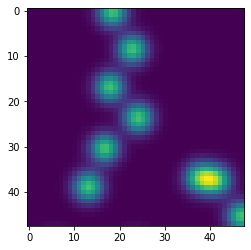

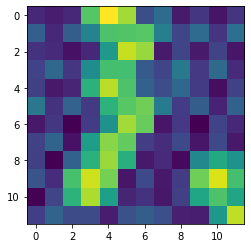

In [ ]:
plt.imshow(imgstack_4_adatoms[3])
imgstack_4_adatoms.shape
plt.figure()
plt.imshow(imgstack_4_rawimage[3])

[]

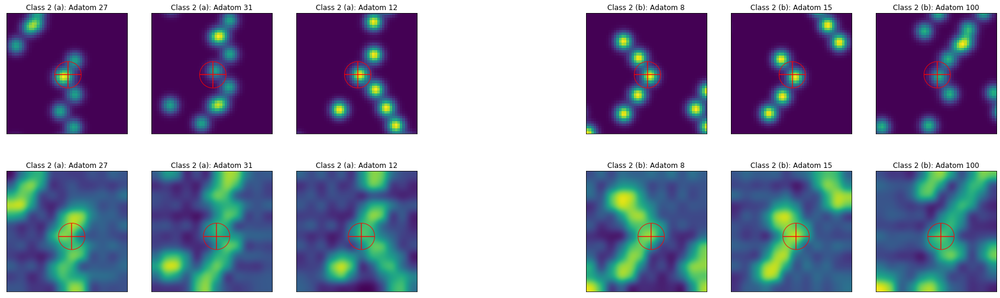

In [ ]:
i1, i2, i3 = 27, 31, 12
k1, k2, k3 = 8, 15, 100


plt.figure(figsize=(30,9))
gs = gridspec.GridSpec(2,7)
ax00 = plt.subplot(gs[0,0])
ax01 = plt.subplot(gs[0,1])
ax02 = plt.subplot(gs[0,2])
ax03 = plt.subplot(gs[0,4])
ax04 = plt.subplot(gs[0,5])
ax05 = plt.subplot(gs[0,6])
ax10 = plt.subplot(gs[1,0])
ax11 = plt.subplot(gs[1,1])
ax12 = plt.subplot(gs[1,2])
ax13 = plt.subplot(gs[1,4])
ax14 = plt.subplot(gs[1,5])
ax15 = plt.subplot(gs[1,6])

ax00.scatter(imgstack_4_adatoms.shape[1]/2,imgstack_4_adatoms.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax00.scatter(imgstack_4_adatoms.shape[1]/2,imgstack_4_adatoms.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax01.scatter(imgstack_4_adatoms.shape[1]/2,imgstack_4_adatoms.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax01.scatter(imgstack_4_adatoms.shape[1]/2,imgstack_4_adatoms.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax02.scatter(imgstack_4_adatoms.shape[1]/2,imgstack_4_adatoms.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax02.scatter(imgstack_4_adatoms.shape[1]/2,imgstack_4_adatoms.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax03.scatter(imgstack_4_adatoms.shape[1]/2,imgstack_4_adatoms.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax03.scatter(imgstack_4_adatoms.shape[1]/2,imgstack_4_adatoms.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax04.scatter(imgstack_4_adatoms.shape[1]/2,imgstack_4_adatoms.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax04.scatter(imgstack_4_adatoms.shape[1]/2,imgstack_4_adatoms.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax05.scatter(imgstack_4_adatoms.shape[1]/2,imgstack_4_adatoms.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax05.scatter(imgstack_4_adatoms.shape[1]/2,imgstack_4_adatoms.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax10.scatter(imgstack_4_rawimage.shape[1]/2,imgstack_4_rawimage.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax10.scatter(imgstack_4_rawimage.shape[1]/2,imgstack_4_rawimage.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax11.scatter(imgstack_4_rawimage.shape[1]/2,imgstack_4_rawimage.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax11.scatter(imgstack_4_rawimage.shape[1]/2,imgstack_4_rawimage.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax12.scatter(imgstack_4_rawimage.shape[1]/2,imgstack_4_rawimage.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax12.scatter(imgstack_4_rawimage.shape[1]/2,imgstack_4_rawimage.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax13.scatter(imgstack_4_rawimage.shape[1]/2,imgstack_4_rawimage.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax13.scatter(imgstack_4_rawimage.shape[1]/2,imgstack_4_rawimage.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax14.scatter(imgstack_4_rawimage.shape[1]/2,imgstack_4_rawimage.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax14.scatter(imgstack_4_rawimage.shape[1]/2,imgstack_4_rawimage.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
ax15.scatter(imgstack_4_rawimage.shape[1]/2,imgstack_4_rawimage.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
ax15.scatter(imgstack_4_rawimage.shape[1]/2,imgstack_4_rawimage.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')

ax00.imshow(imgstack_4_adatoms[i1])
ax01.imshow(imgstack_4_adatoms[i2])
ax02.imshow(imgstack_4_adatoms[i3])
ax03.imshow(imgstack_4_adatoms[k1])
ax04.imshow(imgstack_4_adatoms[k2])
ax05.imshow(imgstack_4_adatoms[k3])
ax10.imshow(imgstack_4_rawimage[i1], interpolation = 'gaussian')
ax11.imshow(imgstack_4_rawimage[i2], interpolation = 'gaussian')
ax12.imshow(imgstack_4_rawimage[i3], interpolation = 'gaussian')
ax13.imshow(imgstack_4_rawimage[k1], interpolation = 'gaussian')
ax14.imshow(imgstack_4_rawimage[k2], interpolation = 'gaussian')
ax15.imshow(imgstack_4_rawimage[k3], interpolation = 'gaussian')

ax00.set_title('Class 2 (a): Adatom {}'.format(i1))
ax01.set_title('Class 2 (a): Adatom {}'.format(i2))
ax02.set_title('Class 2 (a): Adatom {}'.format(i3))
ax03.set_title('Class 2 (b): Adatom {}'.format(k1))
ax04.set_title('Class 2 (b): Adatom {}'.format(k2))
ax05.set_title('Class 2 (b): Adatom {}'.format(k3))
ax10.set_title('Class 2 (a): Adatom {}'.format(i1))
ax11.set_title('Class 2 (a): Adatom {}'.format(i2))
ax12.set_title('Class 2 (a): Adatom {}'.format(i3))
ax13.set_title('Class 2 (b): Adatom {}'.format(k1))
ax14.set_title('Class 2 (b): Adatom {}'.format(k2))
ax15.set_title('Class 2 (b): Adatom {}'.format(k3));

plt.setp([ax00, ax01, ax02, ax03, ax04, ax05, ax10, ax11, ax12, ax13, ax14, ax15], xticks = [], yticks = [])

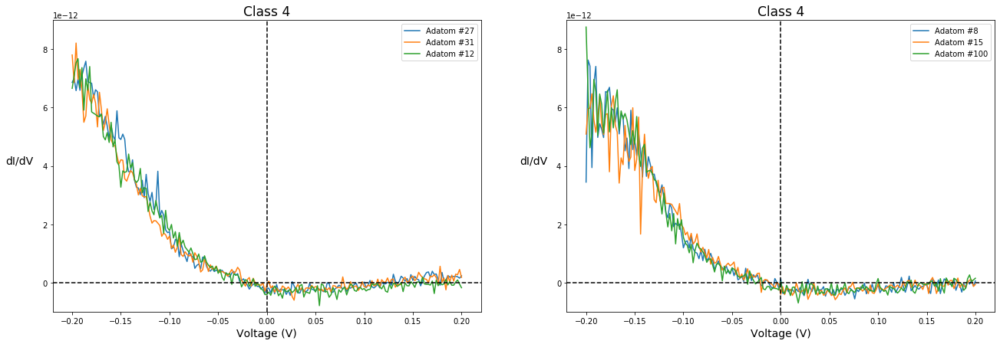

In [ ]:
f,a = plt.subplots(1,2,figsize = (22,7))
a[0].plot(z_axis, exp_cits[int(round(comraw4[i1][0])), int(round(comraw4[i1][1])),:], label = 'Adatom #{}'.format(i1))
a[0].plot(z_axis, exp_cits[int(round(comraw4[i2][0])), int(round(comraw4[i2][1])),:], label = 'Adatom #{}'.format(i2))
a[0].plot(z_axis, exp_cits[int(round(comraw4[i3][0])), int(round(comraw4[i3][1])),:], label = 'Adatom #{}'.format(i3))
a[0].axhline(0, ls = '--', c = 'k')
a[0].axvline(0, ls = '--', c = 'k')

a[1].plot(z_axis, exp_cits[int(round(comraw4[k1][0])), int(round(comraw4[k1][1])),:], label = 'Adatom #{}'.format(k1))
a[1].plot(z_axis, exp_cits[int(round(comraw4[k2][0])), int(round(comraw4[k2][1])),:], label = 'Adatom #{}'.format(k2))
a[1].plot(z_axis, exp_cits[int(round(comraw4[k3][0])), int(round(comraw4[k3][1])),:], label = 'Adatom #{}'.format(k3))
a[1].axhline(0, ls = '--', c = 'k')
a[1].axvline(0, ls = '--', c = 'k')


a[0].legend()
a[1].legend()

a[0].set_ylim(-1E-12, 9E-12)
a[1].set_ylim(-1E-12, 9E-12)

a[0].set_xlabel('Voltage (V)', fontsize = 14)
a[1].set_xlabel('Voltage (V)', fontsize = 14)
a[0].set_ylabel('dI/dV', rotation = 0, fontsize = 14, labelpad = 30)
a[1].set_ylabel('dI/dV', rotation = 0, fontsize = 14, labelpad = 30)

a[0].set_title('Class 4', fontsize = 17)
a[1].set_title('Class 4', fontsize = 17);

(-0.5, 127.5, 127.5, -0.5)

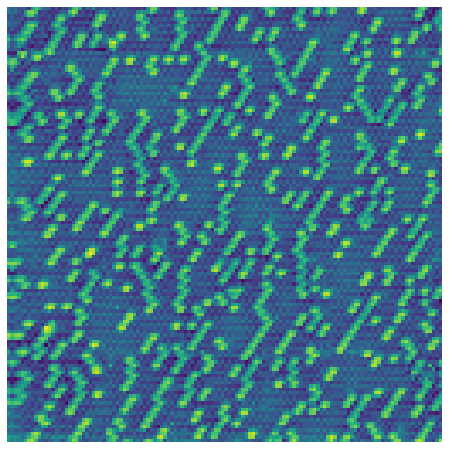

In [ ]:
plt.figure(figsize=(8,8))
plt.imshow(topo_f_n)
plt.axis('off')

#### These "newly" separated adatoms (the left spectra above):
* Have similar spectra to Class 4, the kinked atom (atom at a bend)
* Interesting...
* It also seems (As we see more below) :

1) that the spectra are collected slightly OFF the atom (eh...) and 

2) perhaps more than the first nearest neighbors affect density of states (?? is that unheard of? idk.)

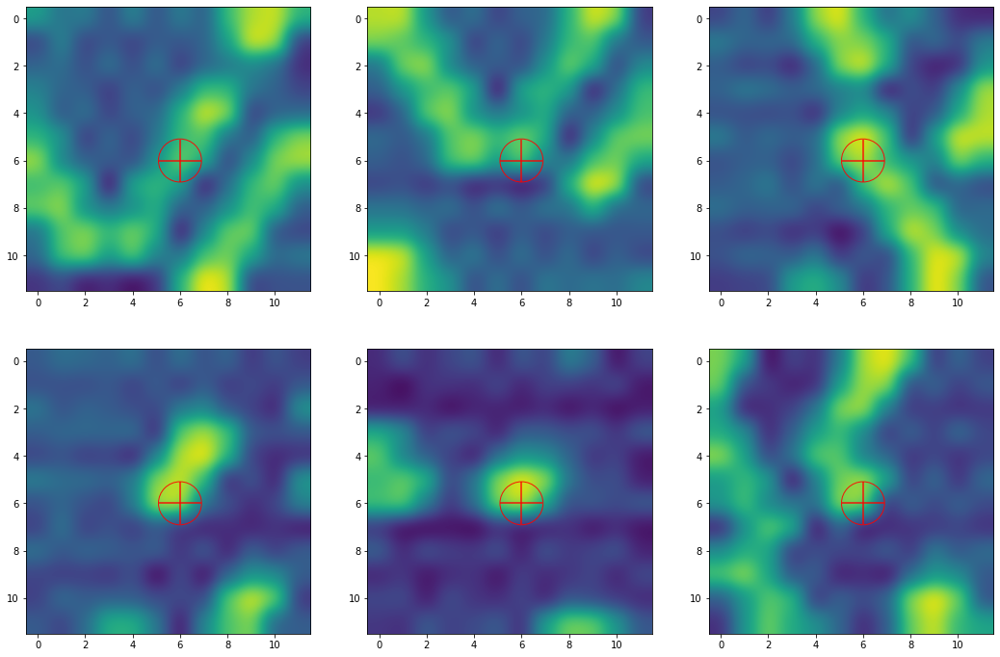

In [ ]:
f,a = plt.subplots(2,3,figsize=(18,12))
a[0,0].imshow(imgstack_2a_rawimage[16], interpolation = 'gaussian')
a[0,1].imshow(imgstack_2a_rawimage[23], interpolation = 'gaussian')
a[0,2].imshow(imgstack_2a_rawimage[9], interpolation = 'gaussian')

a[1,0].imshow(imgstack_2b_rawimage[153], interpolation = 'gaussian')
a[1,1].imshow(imgstack_2b_rawimage[156], interpolation = 'gaussian')
a[1,2].imshow(imgstack_2b_rawimage[77], interpolation = 'gaussian')

a[0,0].scatter(imgstack_2a_rawimage.shape[1]/2,imgstack_2a_rawimage.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
a[0,0].scatter(imgstack_2a_rawimage.shape[1]/2,imgstack_2a_rawimage.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
a[0,1].scatter(imgstack_2a_rawimage.shape[1]/2,imgstack_2a_rawimage.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
a[0,1].scatter(imgstack_2a_rawimage.shape[1]/2,imgstack_2a_rawimage.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
a[0,2].scatter(imgstack_2a_rawimage.shape[1]/2,imgstack_2a_rawimage.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
a[0,2].scatter(imgstack_2a_rawimage.shape[1]/2,imgstack_2a_rawimage.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
a[1,0].scatter(imgstack_2b_rawimage.shape[1]/2,imgstack_2b_rawimage.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
a[1,0].scatter(imgstack_2b_rawimage.shape[1]/2,imgstack_2b_rawimage.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
a[1,1].scatter(imgstack_2b_rawimage.shape[1]/2,imgstack_2b_rawimage.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
a[1,1].scatter(imgstack_2b_rawimage.shape[1]/2,imgstack_2b_rawimage.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')
a[1,2].scatter(imgstack_2b_rawimage.shape[1]/2,imgstack_2b_rawimage.shape[2]/2, marker = '+' ,color = 'r', s=2000, alpha = 0.9)
a[1,2].scatter(imgstack_2b_rawimage.shape[1]/2,imgstack_2b_rawimage.shape[2]/2 ,color = 'r', s=2000, alpha = 0.9, facecolors = 'none')

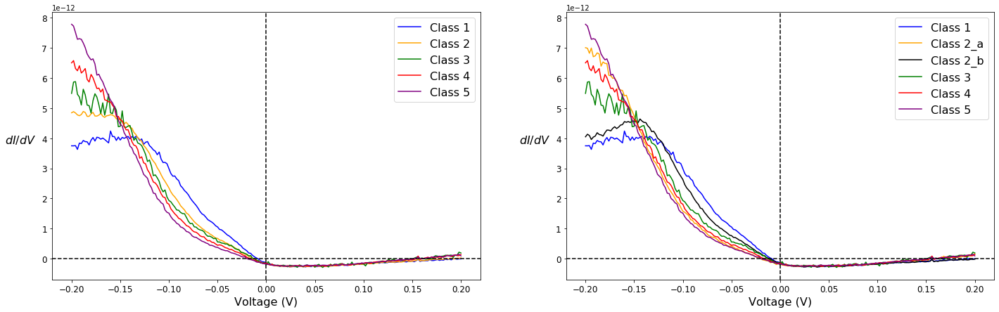

In [ ]:
f,a = plt.subplots(1,2,figsize=(24,7))

a[0].plot(z_axis,class1_mean, label = "Class 1", color = 'blue')
a[0].plot(z_axis,class2_mean, label = "Class 2", color = 'orange')
a[0].plot(z_axis,class3_mean, label = "Class 3", color = 'green')
a[0].plot(z_axis,class4_mean, label = "Class 4", color = 'red')
a[0].plot(z_axis,class5_mean, label = "Class 5", color = 'purple')
a[0].axvline(0,c='k',ls='--')
a[0].axhline(0,c='k',ls='--')
a[0].legend(fontsize = 16)

a[0].set_xlabel('Voltage (V)', size = 16);
a[0].set_ylabel('$dI/dV$', size = 16, rotation = 0, labelpad = 30);
a[0].tick_params(axis='both', labelsize = 12)

a[1].plot(z_axis,class1_mean, label = "Class 1", color = 'blue')
a[1].plot(z_axis,class2_pca1_a_mean, label = "Class 2_a", color = 'orange')
a[1].plot(z_axis,class2_pca1_b_mean, label = "Class 2_b", color = 'k')
# plt.plot(z_axis,class2_mean, label = "Class 2", color = 'orange')
a[1].plot(z_axis,class3_mean, label = "Class 3", color = 'green')
a[1].plot(z_axis,class4_mean, label = "Class 4", color = 'red')
a[1].plot(z_axis,class5_mean, label = "Class 5", color = 'purple')
a[1].axvline(0,c='k',ls='--')
a[1].axhline(0,c='k',ls='--')
a[1].legend(fontsize = 16)

a[1].set_xlabel('Voltage (V)', size = 16);
a[1].set_ylabel('$dI/dV$', size = 16, rotation = 0, labelpad = 30);
a[1].tick_params(axis='both', labelsize = 12)

# a[0].set_title("Original classification")
# a[1].set_title("Class 2 separation via PCA component 1");

In [ ]:
class2_pca1_a = np.zeros((Class2_PCA1_coords_a.shape[0],exp_cits.shape[2]))
for ii in range(Class2_PCA1_coords_a.shape[0]):
  class2_pca1_a[ii] = exp_cits[int(Class2_PCA1_coords_a[ii][0]/scalefactor),int(Class2_PCA1_coords_a[ii][1]/scalefactor),:]
class2_pca1_a_mean = np.mean(class2_pca1_a,axis=0)

class2_pca1_b = np.zeros((Class2_PCA1_coords_b.shape[0],exp_cits.shape[2]))
for ii in range(Class2_PCA1_coords_b.shape[0]):
  class2_pca1_b[ii] = exp_cits[int(Class2_PCA1_coords_b[ii][0]/scalefactor),int(Class2_PCA1_coords_b[ii][1]/scalefactor),:]
class2_pca1_b_mean = np.mean(class2_pca1_b,axis=0)

In [ ]:
# class2_pca0

NameError: ignored

In [ ]:
# scalefactor = 4  # to go from 512 to 128 pixels

# plt.figure(figsize=(12,5))

#   a[0].plot(z_axis, class2_pca0_a[ii])
# a[0].set_ylim(-1E-11,1.5E-11)
# a[0].axvline(0,c='k',ls='--')
# a[0].axhline(0,c='k',ls='--')
# a[0].set_title('Class 2 (a)')

# for ii in range(class2_pca0_b.shape[0]):
#   a[1].plot(z_axis, class2_pca0_b[ii])
# a[1].set_ylim(-1E-11,1.5E-11)
# a[1].axvline(0,c='k',ls='--')
# a[1].axhline(0,c='k',ls='--')
# a[1].set_title('Class 2 (b)')

# scalefactor = 4  # to go from 512 to 128 pixels
# for ii in range(blobclass2.shape[0]):
#   a[2].plot(z_axis,exp_cits[int(round(com[blobclass2[ii],0]/scalefactor)),int(round(com[blobclass2[ii],1]/scalefactor)),:])
# a[2].set_ylim(-1E-11,1.5E-11)
# a[2].axvline(0,c='k',ls='--')
# a[2].axhline(0,c='k',ls='--')
# a[2].set_title('Original Class 2')

# PCA on the unclassified data
* This is just to show what happens if we blindly throw a machine learning tool such as PCA at the data. 
* Many times PCA *does* reveal features with minimal to no user input, however, here we will see that while PCA does indicate there are some spectral features of interest, it fails to say "This spectral feature arises when we have a group of 3 atoms at a 120 degree angle" for example

In [ ]:
## Flatten the spectral data
cits_flat = np.reshape(exp_cits, (exp_cits.shape[0]*exp_cits.shape[1], exp_cits.shape[2]))
print(exp_cits.shape)
print(cits_flat.shape)

(128, 128, 201)
(16384, 201)


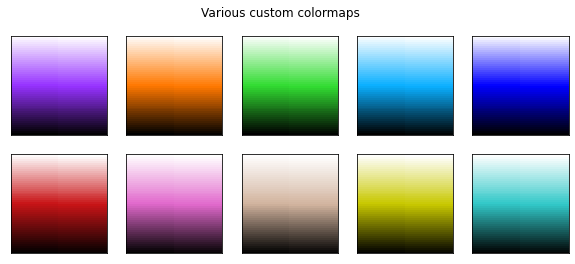

In [ ]:
from matplotlib.colors import LinearSegmentedColormap

data1 = np.linspace(0, 1, 2500).reshape((50, 50))

bPw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (150./255,50/255., 1.),(1,1,1)], N=100)
bOw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (1,120./255, 0),(1,1,1)], N=100)
bGw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (50./255,220./255, 50./255),(1,1,1)], N=100)
bBw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (10./255,175/255., 1.),(1,1,1)], N=100)
bDBw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (0/255,0./255, 255/255),(1,1,1)], N=100)
bRw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (200./255,20/255., 20/225.),(1,1,1)], N=100)
bPiw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (225./255,105/255., 180/225.),(1,1,1)], N=100)
bBrw= LinearSegmentedColormap.from_list('list', [(0, 0, 0), (210./255,180/255., 140/225.),(1,1,1)], N=100)
bYw= LinearSegmentedColormap.from_list('list', [(0, 0, 0), (200./255,200/255., 0/225.),(1,1,1)], N=100)
bLGw = LinearSegmentedColormap.from_list('list', [(0, 0, 0), (50./255, 200/255, 200/255),(1,1,1)], N=100)

cmaps = [bPw,bOw,bGw,bBw,bDBw,bRw,bPiw,bBrw,bYw,bLGw]

rows = int(np.ceil(float(len(cmaps))/5))
cols = int(np.ceil(float(len(cmaps))/rows))
gs1 = gridspec.GridSpec(rows, cols)
fig = plt.figure(figsize = (2*cols, 2*(1+rows//2)))
fig.suptitle('Various custom colormaps')
for i in range(len(cmaps)):
    ax1 = fig.add_subplot(gs1[i])
    ax1.pcolormesh(data1,cmap=cmaps.pop(0))
    plt.setp([ax1], xticks = [], yticks =[])

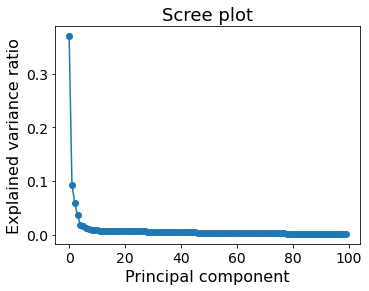

In [ ]:
fig= plt.figure(figsize=(12,4))
gs = gridspec.GridSpec(1,2)
ax1 = plt.subplot(gs[0,0])

pca = PCA()
pca.fit(cits_flat)
explained_var = pca.explained_variance_ratio_

ax1.plot(explained_var[0:100], 'o-')
# ax1.semilogy()
ax1.set_xlabel('Principal component', fontsize = 16)
ax1.set_ylabel('Explained variance ratio', fontsize = 16);
ax1.set_title('Scree plot', fontsize = 18)
ax1.tick_params(labelsize = 14)

In [ ]:
print(exp_cits.shape)
w, h, n = exp_cits.shape

(128, 128, 201)


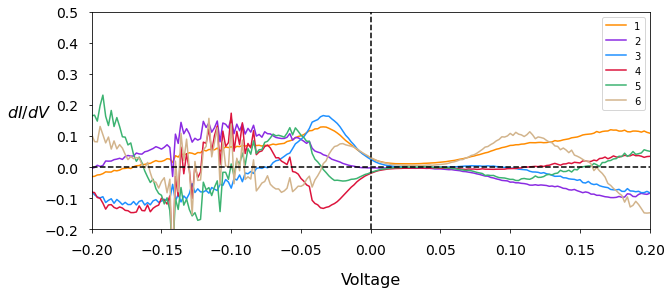

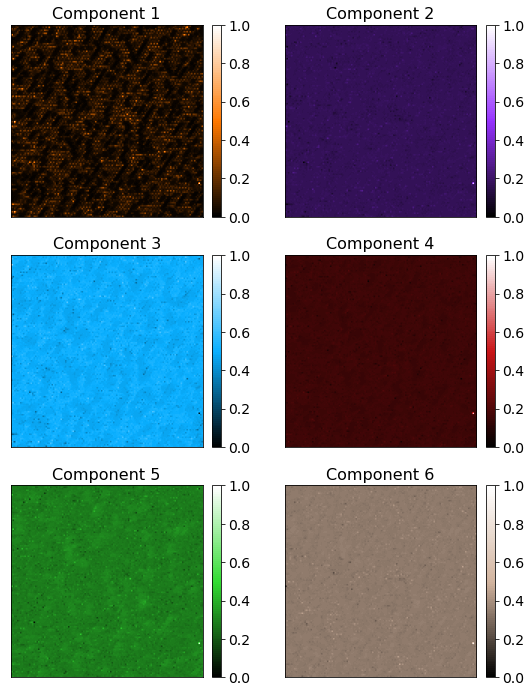

In [ ]:
nc = 6
cmaps=[bOw, bPw, bBw, bRw, bGw, bBrw, bPiw, bYw]
colors=['DarkOrange','BlueViolet','DodgerBlue','Crimson','MediumSeaGreen','Tan','HotPink','Yellow','Black']
clf = PCA(n_components=nc)
X_vec_t = clf.fit_transform(cits_flat)
components = clf.components_
X_vec_t = X_vec_t.reshape(w, h, nc)

# NORMALIZE these suckers (makes plotting smoother)
X_vec_t_n = np.copy(X_vec_t)
for ii in range(X_vec_t.shape[2]):
  X_vec_t_n[:,:,ii] = (X_vec_t[:,:,ii] - np.min(X_vec_t[:,:,ii])) / (np.ptp(X_vec_t[:,:,ii]))

rows = int(np.ceil(float(nc)/2))
cols = int(np.ceil(float(nc)/rows))
     
fig1,ax1 = plt.subplots(figsize = (10,4))

# plt.suptitle("NUMBER OF COMPONENTS: {}".format(nc), fontsize = 16, color = 'Crimson')
for i in range(nc):
    ax1.plot(z_axis,components[i], color = colors.pop(0), label = i+1)
    # ax1.grid(True)
    # ax1.set_xticks(np.arange(-0.2,0.2, step=0.02));
    ax1.set_xlim(-0.2,0.2)
    ax1.set_ylim(-0.2,0.5)
    ax1.tick_params(labelsize=10)
    ax1.legend(loc = 1)
    ax1.set_xlabel("Voltage", fontsize = 16, labelpad = 15)
    ax1.set_ylabel("$dI/dV$", rotation = 0, labelpad = 15, fontsize = 16)
    ax1.tick_params(labelsize = 14, pad = 10)
plt.axhline(0, color = 'k', ls = '--')
plt.axvline(0, color = 'k', ls = '--')
plt.show()


gs2 = gridspec.GridSpec(rows, cols)
fig2 = plt.figure(figsize = (4.5*cols, 3*(1+rows//1)))   
for i in range(nc):
    ax2 = fig2.add_subplot(gs2[i])
    im = ax2.imshow(X_vec_t_n[:, : ,i],cmap = cmaps.pop(0))
    ax2.set_title('Component ' + str(i + 1), fontsize = 16)
    plt.setp([ax2],xticks=[], yticks=[])
    cbar = plt.colorbar(im, ax = ax2, fraction=0.046, pad=0.04)
    cbar.ax.tick_params(labelsize = 14)
plt.show()

More carefully.. with playing with contrast in these maps

In [ ]:
cmaps=[bOw, bPw, bDBw, bRw, bGw, bBrw, bPiw, bYw, bBw]

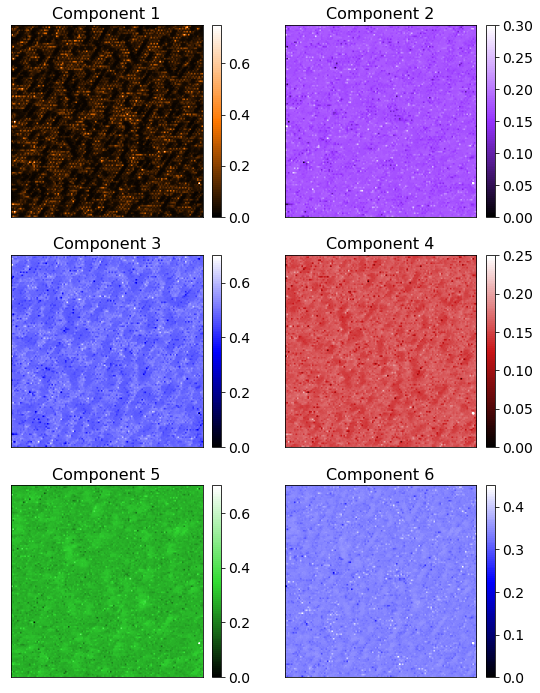

In [ ]:
plt.figure(figsize = (4.5*cols, 3*(1+rows//1)))   
gs = gridspec.GridSpec(3,2)
ax00, ax01 = plt.subplot(gs[0,0]), plt.subplot(gs[0,1])
ax10, ax11 = plt.subplot(gs[1,0]), plt.subplot(gs[1,1])
ax20, ax21 = plt.subplot(gs[2,0]), plt.subplot(gs[2,1])

im00 = ax00.imshow(X_vec_t_n[:, : ,0],cmap = cmaps[0], vmax = 0.75)
im01 = ax01.imshow(X_vec_t_n[:, : ,1],cmap = cmaps[1], vmax = 0.3)
im10 = ax10.imshow(X_vec_t_n[:, : ,2],cmap = bDBw, vmax = 0.7)
im11 = ax11.imshow(X_vec_t_n[:, : ,3],cmap = cmaps[3], vmax = 0.25)
im20 = ax20.imshow(X_vec_t_n[:, : ,4],cmap = cmaps[4], vmax = 0.7)
im21 = ax21.imshow(X_vec_t_n[:, : ,5],cmap = bDBw, vmin = 0.0, vmax = 0.45)

axs = [ax00, ax01, ax10, ax11, ax20, ax21]
ims = [im00, im01, im10, im11, im20, im21]
plt.setp([axs],xticks=[], yticks=[])

for ii in range(X_vec_t_n.shape[2]):
  cbar = plt.colorbar(ims[ii], ax = axs[ii], fraction=0.046, pad=0.04)
  cbar.ax.tick_params(labelsize = 14)
  axs[ii].set_title('Component ' + str(ii + 1), fontsize = 16)

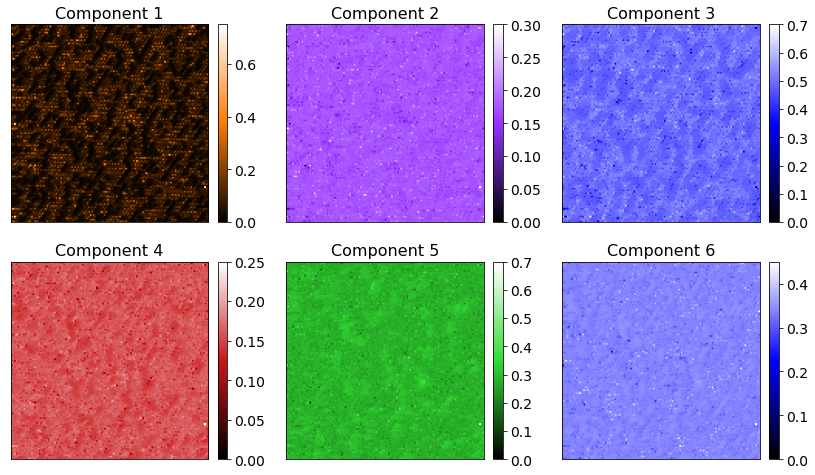

In [ ]:
plt.figure(figsize = (7*cols, 2*(1+rows//1)))   
gs = gridspec.GridSpec(2,3)
ax00, ax01, ax02 = plt.subplot(gs[0,0]), plt.subplot(gs[0,1]), plt.subplot(gs[0,2])
ax10, ax11, ax12 = plt.subplot(gs[1,0]), plt.subplot(gs[1,1]), plt.subplot(gs[1,2])

im00 = ax00.imshow(X_vec_t_n[:, : ,0],cmap = cmaps[0], vmax = 0.75)
im01 = ax01.imshow(X_vec_t_n[:, : ,1],cmap = cmaps[1], vmax = 0.3)
im02 = ax02.imshow(X_vec_t_n[:, : ,2],cmap = bDBw, vmax = 0.7)
im10 = ax10.imshow(X_vec_t_n[:, : ,3],cmap = cmaps[3], vmax = 0.25)
im11 = ax11.imshow(X_vec_t_n[:, : ,4],cmap = cmaps[4], vmax = 0.7)
im12 = ax12.imshow(X_vec_t_n[:, : ,5],cmap = bDBw, vmin = 0.0, vmax = 0.45)

axs = [ax00, ax01, ax02, ax10, ax11, ax12]
ims = [im00, im01, im02, im10, im11, im12]
plt.setp([axs],xticks=[], yticks=[])

for ii in range(X_vec_t_n.shape[2]):
  cbar = plt.colorbar(ims[ii], ax = axs[ii], fraction=0.046, pad=0.04)
  cbar.ax.tick_params(labelsize = 14)
  axs[ii].set_title('Component ' + str(ii + 1), fontsize = 16)

In [ ]:
def perform_FFT(image):
  "Performs 2D FFT on an image and returns the amplitude"
  FFT0 = fftpack.fft2(image)
  FFT0_shift = fftpack.fftshift(FFT0)
  FFT0_shift_amp_ = np.log(np.abs(FFT0_shift))
  FFT0_shift_amp = (FFT0_shift_amp_ - np.min(FFT0_shift_amp_))/np.ptp(FFT0_shift_amp_)
  return FFT0_shift_amp

In [ ]:
FFT_comps = np.zeros((X_vec_t_n.shape[2], X_vec_t_n.shape[0], X_vec_t_n.shape[1]))
for ii in range(FFT_comps.shape[0]):
  FFT_comps[ii] = perform_FFT(X_vec_t_n[:, : ,ii])

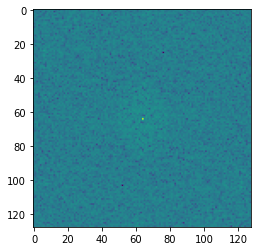

In [ ]:
plt.imshow(FFT_comps[1])

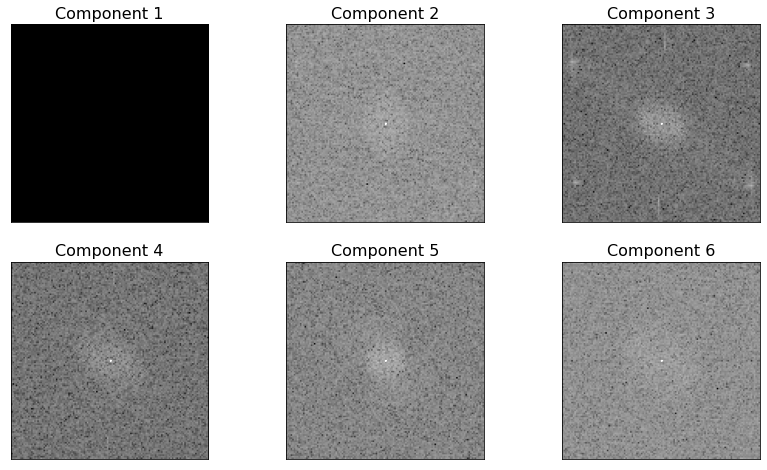

In [ ]:
plt.figure(figsize = (7*cols, 2*(1+rows//1)))   
# vertical plotting
# gs = gridspec.GridSpec(3,2)
# ax00, ax01 = plt.subplot(gs[0,0]), plt.subplot(gs[0,1])
# ax10, ax11 = plt.subplot(gs[1,0]), plt.subplot(gs[1,1])
# ax20, ax21 = plt.subplot(gs[2,0]), plt.subplot(gs[2,1])

# horiz plotting
gs = gridspec.GridSpec(2,3)
ax00, ax01, ax02 = plt.subplot(gs[0,0]), plt.subplot(gs[0,1]), plt.subplot(gs[0,2])
ax10, ax11, ax12 = plt.subplot(gs[1,0]), plt.subplot(gs[1,1]), plt.subplot(gs[1,2])

colmap = 'gray'
im00 = ax00.imshow(FFT_comps[0],cmap = colmap, vmax = 0.75)
im01 = ax01.imshow(FFT_comps[1],cmap = colmap, vmax = 0.75)
im02 = ax02.imshow(FFT_comps[2],cmap = colmap, vmax = 0.75)
im10 = ax10.imshow(FFT_comps[3],cmap = colmap, vmax = 0.75)
im11 = ax11.imshow(FFT_comps[4],cmap = colmap, vmax = 0.75)
im12 = ax12.imshow(FFT_comps[5],cmap = colmap, vmax = 0.75)

axs = [ax00, ax01, ax02, ax10, ax11, ax12]
plt.setp([axs], xticks=[], yticks = [])
for ii in range(X_vec_t_n.shape[2]):
  axs[ii].set_title('Component ' + str(ii + 1), fontsize = 16)

In [ ]:
# make FFTs clearer:

from scipy.ndimage import gaussian_filter
from scipy.ndimage import maximum_filter
# from scipy.ndimage import median_filter
# from scipy.ndimage import sobel

In [ ]:
FFT0_.min(), FFT0_.max()
FFT0.min(), FFT0.max()
FFT_comps[0].min(), FFT_comps[0].max()

(0.0, 0.0)

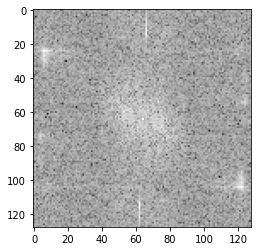

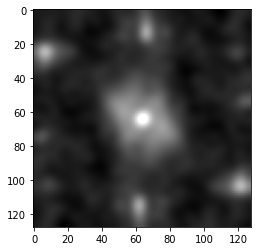

In [ ]:
# thresh1 = 0.5
# thresh2 = 0.75
FFT0 = np.copy(FFT_comps[0])
# FFT0[np.where(FFT0 < thresh1)] = 0
# FFT0[np.where(FFT0 > thresh2)] = 0
# FFT0[np.where(FFT0 <= np.max(FFT0)-0.01] = 1
# FFT0[np.where(FFT0 >= thresh1)] = 1 
plt.figure()
# plt.imshow(FFT0, cmap = 'gray', vmin = 0.5, vmax = 0.75)
plt.imshow(FFT0, cmap = 'gray', vmax = 0.75)

# # Gaussian blur
# plt.figure()
# plt.imshow(gaussian_filter(FFT0, sigma = 3), cmap = 'gray', vmax = 0.75)

# # max filter
# plt.figure()
# plt.imshow(maximum_filter(FFT0, size = 5), cmap = 'gray', vmax = 0.75)

# max filter --> gaussian blur 
plt.figure()
plt.imshow(gaussian_filter(maximum_filter(FFT0, size = 5), sigma = 3), cmap = 'gray', vmax = 0.75)

# # sobel filter
# plt.figure()
# plt.imshow(sobel(gaussian_filter(maximum_filter(FFT0, size = 5), sigma = 3)), cmap = 'gray')

In [ ]:
FFT0 = np.copy(FFT_comps[0])
FFT1 = np.copy(FFT_comps[1])
FFT2 = np.copy(FFT_comps[2])
FFT3 = np.copy(FFT_comps[3])
FFT4 = np.copy(FFT_comps[4])
FFT5 = np.copy(FFT_comps[5])

FFT0 = gaussian_filter(maximum_filter(FFT0, size = 5), sigma = 3)
FFT1 = gaussian_filter(maximum_filter(FFT1, size = 5), sigma = 3)
FFT2 = gaussian_filter(maximum_filter(FFT2, size = 5), sigma = 3)
FFT3 = gaussian_filter(maximum_filter(FFT3, size = 5), sigma = 3)
FFT4 = gaussian_filter(maximum_filter(FFT4, size = 5), sigma = 3)
FFT5 = gaussian_filter(maximum_filter(FFT5, size = 5), sigma = 3)

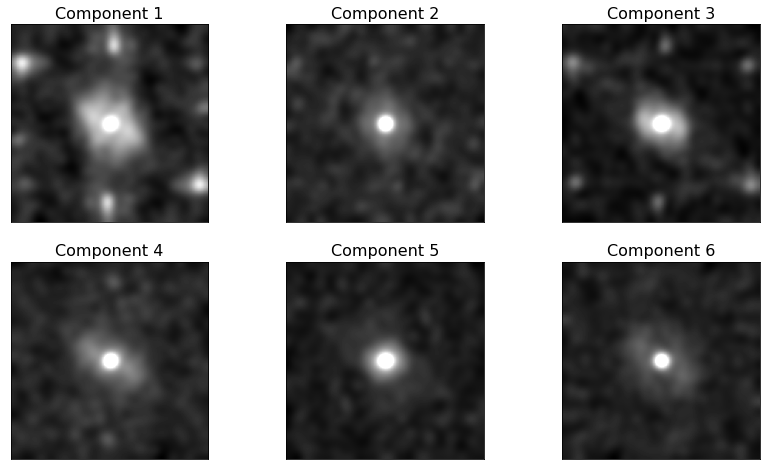

In [ ]:
plt.figure(figsize = (7*cols, 2*(1+rows//1)))   
gs = gridspec.GridSpec(2,3)
ax00, ax01, ax02 = plt.subplot(gs[0,0]), plt.subplot(gs[0,1]), plt.subplot(gs[0,2])
ax10, ax11, ax12 = plt.subplot(gs[1,0]), plt.subplot(gs[1,1]), plt.subplot(gs[1,2])

colmap = 'gray'
im00 = ax00.imshow(FFT0,cmap = colmap, vmax = 0.7)
im01 = ax01.imshow(FFT1,cmap = colmap, vmax = 0.6)
im02 = ax02.imshow(FFT2,cmap = colmap, vmax = 0.55)
im10 = ax10.imshow(FFT3,cmap = colmap, vmax = 0.55)
im11 = ax11.imshow(FFT4,cmap = colmap, vmax = 0.6)
im12 = ax12.imshow(FFT5,cmap = colmap, vmax = 0.6)

axs = [ax00, ax01, ax02, ax10, ax11, ax12]
plt.setp([axs], xticks=[], yticks = [])
for ii in range(X_vec_t_n.shape[2]):
  axs[ii].set_title('Component ' + str(ii + 1), fontsize = 16)

* Comps 1 and 3 have the hexagonal symmetry
* Comp 4 has SOME 2-fold symmetry (top / bottom)
* Commps 2, 5 and 6 show no perodicity

In [ ]:
# Clip these so that we don't need to keep applying vmin vmax:

FFT0 = np.clip(FFT0, 0, 0.7)
FFT1 = np.clip(FFT1, 0, 0.6)
FFT2 = np.clip(FFT2, 0, 0.55)
FFT3 = np.clip(FFT3, 0, 0.55)
FFT4 = np.clip(FFT4, 0, 0.6)
FFT5 = np.clip(FFT5, 0, 0.6)

FFT_all = [FFT0, FFT1, FFT2, FFT3, FFT4, FFT5]

In [ ]:
# The same for the PCA loading maps

Map0 = np.clip(X_vec_t_n[:, : ,0], 0, 0.75)
Map1 = np.clip(X_vec_t_n[:, : ,1], 0, 0.3)
Map2 = np.clip(X_vec_t_n[:, : ,2], 0, 0.7)
Map3 = np.clip(X_vec_t_n[:, : ,3], 0, 0.25)
Map4 = np.clip(X_vec_t_n[:, : ,4], 0, 0.7)
Map5 = np.clip(X_vec_t_n[:, : ,5], 0, 0.45)

Maps_all = [Map0, Map1, Map2, Map3, Map4, Map5]

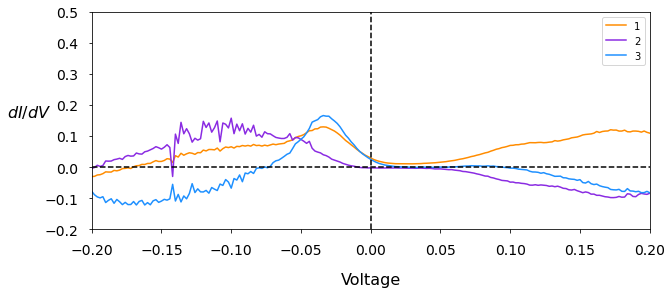

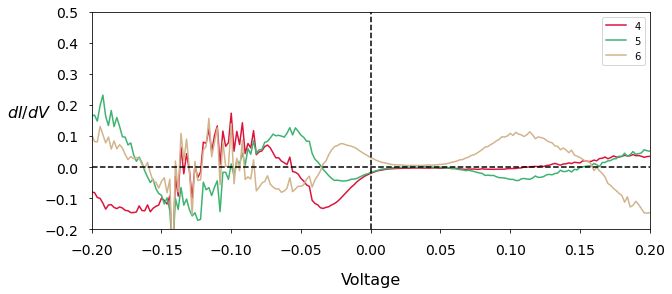

In [ ]:
fig1,ax1 = plt.subplots(figsize = (10,4))
colors=['DarkOrange','BlueViolet','DodgerBlue','Crimson','MediumSeaGreen','Tan','HotPink','Yellow','Black']

# plt.suptitle("NUMBER OF COMPONENTS: {}".format(nc), fontsize = 16, color = 'Crimson')
for i in range(0, int(nc/2)):
    ax1.plot(z_axis,components[i], color = colors[i], label = i+1)
    # ax1.grid(True)
    # ax1.set_xticks(np.arange(-0.2,0.2, step=0.02));
    ax1.set_xlim(-0.2,0.2)
    ax1.set_ylim(-0.2,0.5)
    ax1.tick_params(labelsize=10)
    ax1.legend(loc = 1)
    ax1.set_xlabel("Voltage", fontsize = 16, labelpad = 15)
    ax1.set_ylabel("$dI/dV$", rotation = 0, labelpad = 15, fontsize = 16)
    ax1.tick_params(labelsize = 14, pad = 10)
plt.axhline(0, color = 'k', ls = '--')
plt.axvline(0, color = 'k', ls = '--')
plt.show()

fig2,ax2 = plt.subplots(figsize = (10,4))
# colors2=['Crimson','MediumSeaGreen','Tan','HotPink','Yellow','Black']

# plt.suptitle("NUMBER OF COMPONENTS: {}".format(nc), fontsize = 16, color = 'Crimson')
for i in range(int(nc/2),nc):
    ax2.plot(z_axis,components[i], color = colors[i], label = i+1)
    # ax1.grid(True)
    # ax1.set_xticks(np.arange(-0.2,0.2, step=0.02));
    ax2.set_xlim(-0.2,0.2)
    ax2.set_ylim(-0.2,0.5)
    ax2.tick_params(labelsize=10)
    ax2.legend(loc = 1)
    ax2.set_xlabel("Voltage", fontsize = 16, labelpad = 15)
    ax2.set_ylabel("$dI/dV$", rotation = 0, labelpad = 15, fontsize = 16)
    ax2.tick_params(labelsize = 14, pad = 10)
plt.axhline(0, color = 'k', ls = '--')
plt.axvline(0, color = 'k', ls = '--')
plt.show()


[]

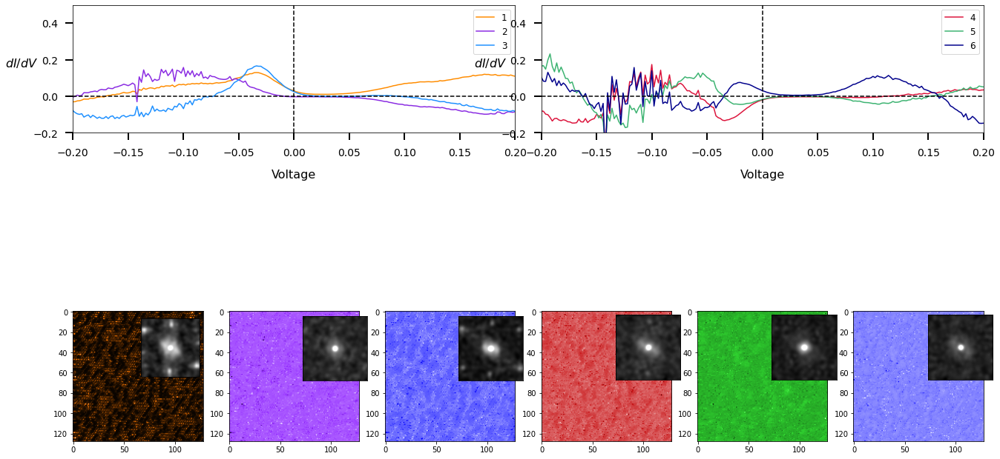

In [ ]:
# Shown as INSETS

# Paper Figure 1:

colors=['DarkOrange','BlueViolet','DodgerBlue','Crimson','MediumSeaGreen','darkBlue','HotPink','Yellow','Black']


plt.figure(figsize = (22,14))
gs = gridspec.GridSpec(2,6, height_ratios = [1,3])
ax00, ax01 = plt.subplot(gs[0,0:3]), plt.subplot(gs[0,3:6])
ax10, ax11, ax12 = plt.subplot(gs[1,0]), plt.subplot(gs[1,1]), plt.subplot(gs[1,2])
ax13, ax14, ax15 = plt.subplot(gs[1,3]), plt.subplot(gs[1,4]), plt.subplot(gs[1,5])

for i in range(0, int(nc/2)):
    ax00.plot(z_axis,components[i], color = colors[i], label = i+1)
    ax00.set_xlim(-0.2,0.2)
    ax00.set_ylim(-0.2,0.5)
    ax00.tick_params(labelsize=10)
    ax00.legend(loc = 1, fontsize = 12)
    ax00.set_xlabel("Voltage", fontsize = 16, labelpad = 15)
    ax00.set_ylabel("$dI/dV$", rotation = 0, labelpad = 15, fontsize = 16)
    ax00.tick_params(labelsize = 14, pad = 10, width = 2, size = 10)
ax00.axhline(0, color = 'k', ls = '--')
ax00.axvline(0, color = 'k', ls = '--')

for i in range(int(nc/2),nc):
    ax01.plot(z_axis,components[i], color = colors[i], label = i+1)
    ax01.set_xlim(-0.2,0.2)
    ax01.set_ylim(-0.2,0.5)
    ax01.tick_params(labelsize=10)
    ax01.legend(loc = 1, fontsize = 12)
    ax01.set_xlabel("Voltage", fontsize = 16, labelpad = 15)
    ax01.set_ylabel("$dI/dV$", rotation = 0, labelpad = 15, fontsize = 16)
    ax01.tick_params(labelsize = 14, pad = 10, width = 2, size = 10)
ax01.axhline(0, color = 'k', ls = '--')
ax01.axvline(0, color = 'k', ls = '--')

ax10.imshow(Map0, cmap = cmaps[0])
ax11.imshow(Map1, cmap = cmaps[1])
ax12.imshow(Map2, cmap = cmaps[2])
ax13.imshow(Map3, cmap = cmaps[3])
ax14.imshow(Map4, cmap = cmaps[4])
ax15.imshow(Map5, cmap = cmaps[2])


inset0 = inset_axes(ax10, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 0.9, 1), bbox_transform = ax10.transAxes)
inset1 = inset_axes(ax11, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 0.99, 0.99), bbox_transform = ax11.transAxes)
inset2 = inset_axes(ax12, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 0.99, 0.99), bbox_transform = ax12.transAxes)
inset3 = inset_axes(ax13, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax13.transAxes)
inset4 = inset_axes(ax14, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax14.transAxes)
inset5 = inset_axes(ax15, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax15.transAxes)

inset0.imshow(FFT0, cmap = 'gray')
inset1.imshow(FFT1, cmap = 'gray')
inset2.imshow(FFT2, cmap = 'gray')
inset3.imshow(FFT3, cmap = 'gray')
inset4.imshow(FFT4, cmap = 'gray')
inset5.imshow(FFT5, cmap = 'gray')
    
plt.setp([inset0, inset1, inset2, inset3, inset4, inset5],xticks=[],yticks=[])

In [ ]:
Map0, Map1, Map2, Map3, Map4, Map5 = Maps_all[0],Maps_all[1],Maps_all[2],Maps_all[3],Maps_all[4],Maps_all[5]
FFT0, FFT1, FFT2, FFT3, FFT4, FFT5 = FFT_all[0],FFT_all[1],FFT_all[2],FFT_all[3],FFT_all[4],FFT_all[5]
cmaps=[bOw, bPw, bDBw, bRw, bGw, bBrw, bPiw, bYw, bBw]

In [ ]:
for i in range(0, int(nc/2)):
  print(i)

0
1
2


[]

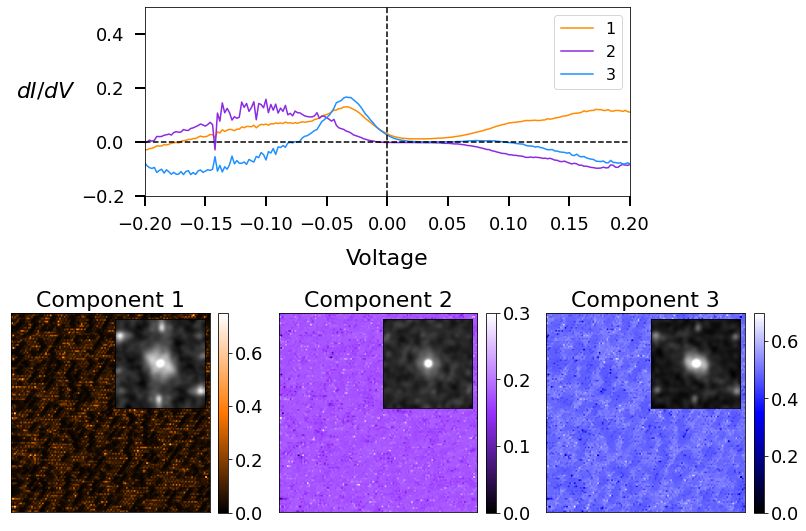

In [ ]:
# Easier to just split this into TWO figures in python (join later)
try:
  nc/1
except NameError:
  nc = 6
# Shown as INSETS

# Paper Figure 1:

colors=['DarkOrange','BlueViolet','DodgerBlue','Crimson','MediumSeaGreen','darkBlue','HotPink','Yellow','Black']

figscale = 0.75
plt.figure(figsize = (18*figscale,14*figscale))
gs = gridspec.GridSpec(2,6, height_ratios = [1,1.75], wspace = 0.6)
ax00 = plt.subplot(gs[0,1:5])
ax10, ax11, ax12 = plt.subplot(gs[1,0:2]), plt.subplot(gs[1,2:4]), plt.subplot(gs[1,4:6])

for i in range(0, int(nc/2)):
    ax00.plot(z_axis,components[i], color = colors[i], label = i+1)
    ax00.set_xlim(-0.2,0.2)
    ax00.set_ylim(-0.2,0.5)
    ax00.tick_params(labelsize=14)
    ax00.legend(loc = 1, fontsize = 16)
    ax00.set_xlabel("Voltage", fontsize = 22, labelpad = 15)
    ax00.set_ylabel("$dI/dV$", rotation = 0, labelpad = 35, fontsize = 22)
    ax00.tick_params(labelsize = 18, pad = 10, width = 2, size = 10)
ax00.axhline(0, color = 'k', ls = '--')
ax00.axvline(0, color = 'k', ls = '--')


im10 = ax10.imshow(Map0, cmap = cmaps[0])
im11 = ax11.imshow(Map1, cmap = cmaps[1])
im12 = ax12.imshow(Map2, cmap = cmaps[2])

axs=[ax10,ax11,ax12]
ims = [im10, im11, im12]
for ii in range(len(ims)):
  cbar = plt.colorbar(ims[ii], ax = axs[ii], fraction=0.046, pad=0.04)
  cbar.ax.tick_params(labelsize = 18)
  axs[ii].set_title('Component ' + str(ii + 1), fontsize = 22)


inset0 = inset_axes(ax10, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 0.9, 1.03), bbox_transform = ax10.transAxes)
inset1 = inset_axes(ax11, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 0.9, 1.03), bbox_transform = ax11.transAxes)
inset2 = inset_axes(ax12, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 0.9, 1.03), bbox_transform = ax12.transAxes)

inset0.imshow(FFT0, cmap = 'gray')
inset1.imshow(FFT1, cmap = 'gray')
inset2.imshow(FFT2, cmap = 'gray')

plt.setp([ax10,ax11,ax12],xticks=[],yticks=[])
plt.setp([inset0, inset1, inset2],xticks=[],yticks=[])

[]

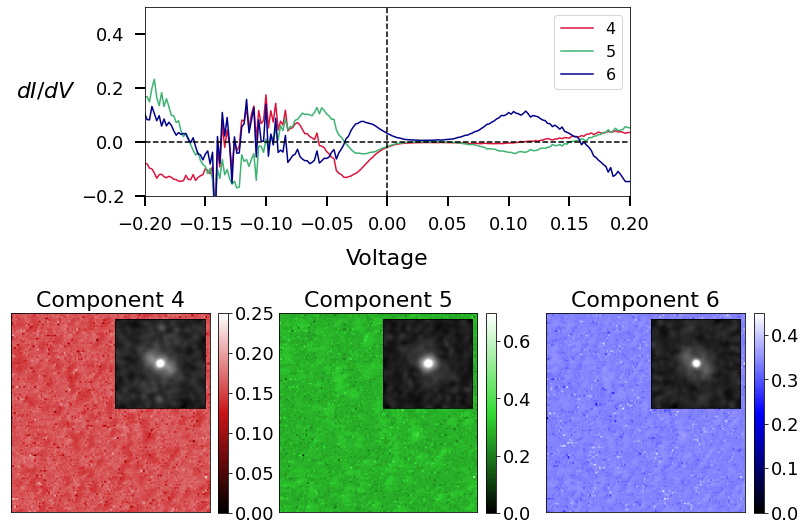

In [ ]:
# Easier to just split this into TWO figures in python (join later)

# Shown as INSETS

# Paper Figure 1:

colors=['DarkOrange','BlueViolet','DodgerBlue','Crimson','MediumSeaGreen','darkBlue','HotPink','Yellow','Black']

figscale = 0.75

plt.figure(figsize = (18*figscale,14*figscale))
gs = gridspec.GridSpec(2,6, height_ratios = [1,1.75], wspace = 0.6)
ax00 = plt.subplot(gs[0,1:5])
ax10, ax11, ax12 = plt.subplot(gs[1,0:2]), plt.subplot(gs[1,2:4]), plt.subplot(gs[1,4:6])

for i in range(int(nc/2), nc):
    ax00.plot(z_axis,components[i], color = colors[i], label = i+1)
    ax00.set_xlim(-0.2,0.2)
    ax00.set_ylim(-0.2,0.5)
    ax00.tick_params(labelsize=14)
    ax00.legend(loc = 1, fontsize = 16)
    ax00.set_xlabel("Voltage", fontsize = 22, labelpad = 15)
    ax00.set_ylabel("$dI/dV$", rotation = 0, labelpad = 35, fontsize = 22)
    ax00.tick_params(labelsize = 18, pad = 10, width = 2, size = 10)
ax00.axhline(0, color = 'k', ls = '--')
ax00.axvline(0, color = 'k', ls = '--')


im10 = ax10.imshow(Map3, cmap = cmaps[3])
im11 = ax11.imshow(Map4, cmap = cmaps[4])
im12 = ax12.imshow(Map5, cmap = cmaps[2])

axs=[ax10,ax11,ax12]
ims = [im10, im11, im12]
for ii in range(len(ims)):
  cbar = plt.colorbar(ims[ii], ax = axs[ii], fraction=0.046, pad=0.04)
  cbar.ax.tick_params(labelsize = 18)
  axs[ii].set_title('Component ' + str(ii + 4), fontsize = 22)



inset0 = inset_axes(ax10, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 0.9, 1.03), bbox_transform = ax10.transAxes)
inset1 = inset_axes(ax11, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 0.9, 1.03), bbox_transform = ax11.transAxes)
inset2 = inset_axes(ax12, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 0.9, 1.03), bbox_transform = ax12.transAxes)

inset0.imshow(FFT3, cmap = 'gray')
inset1.imshow(FFT4, cmap = 'gray')
inset2.imshow(FFT5, cmap = 'gray')

plt.setp([ax10,ax11,ax12],xticks=[],yticks=[])
plt.setp([inset0, inset1, inset2],xticks=[],yticks=[])

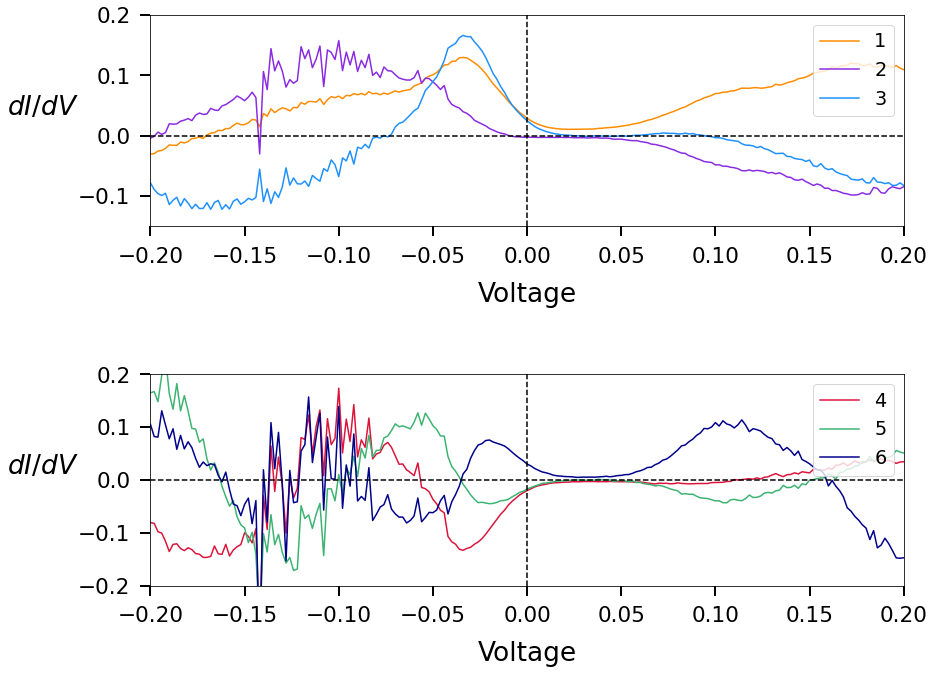

In [ ]:
# flip the figure around:
try:
  nc/1
except NameError:
  nc = 6
# Shown as INSETS

# Paper Figure 1:

colors=['DarkOrange','BlueViolet','DodgerBlue','Crimson','MediumSeaGreen','darkBlue','HotPink','Yellow','Black']

figscale = 0.75
fontscale = 1.2
plt.figure(figsize = (18*figscale,14*figscale))
gs = gridspec.GridSpec(2,3, height_ratios = [1,1], wspace = 0.6, hspace = 0.7)
ax1, ax2 = plt.subplot(gs[0,0:3]), plt.subplot(gs[1,0:3])

for i in range(0, int(nc/2)):
    ax1.plot(z_axis,components[i], color = colors[i], label = i+1)
    ax1.set_xlim(-0.2,0.2)
    ax1.set_ylim(-0.15,0.2)
    ax1.tick_params(labelsize=14*fontscale)
    ax1.legend(loc = 1, fontsize = 16*fontscale)
    ax1.set_xlabel("Voltage", fontsize = 22*fontscale, labelpad = 15)
    ax1.set_ylabel("$dI/dV$", rotation = 0, labelpad = 35, fontsize = 22*fontscale)
    ax1.tick_params(labelsize = 18*fontscale, pad = 10, width = 2, size = 10)
ax1.axhline(0, color = 'k', ls = '--')
ax1.axvline(0, color = 'k', ls = '--')

for i in range(int(nc/2), nc):
    ax2.plot(z_axis,components[i], color = colors[i], label = i+1)
    ax2.set_xlim(-0.2,0.2)
    ax2.set_ylim(-0.2,0.2)
    ax2.tick_params(labelsize=14*fontscale)
    ax2.legend(loc = 1, fontsize = 16*fontscale)
    ax2.set_xlabel("Voltage", fontsize = 22*fontscale, labelpad = 15)
    ax2.set_ylabel("$dI/dV$", rotation = 0, labelpad = 35, fontsize = 22*fontscale)
    ax2.tick_params(labelsize = 18*fontscale, pad = 10, width = 2, size = 10)
ax2.axhline(0, color = 'k', ls = '--')
ax2.axvline(0, color = 'k', ls = '--')

In [ ]:
Map0, Map1, Map2, Map3, Map4, Map5 = Maps_all[0],Maps_all[1],Maps_all[2],Maps_all[3],Maps_all[4],Maps_all[5]
FFT0, FFT1, FFT2, FFT3, FFT4, FFT5 = FFT_all[0],FFT_all[1],FFT_all[2],FFT_all[3],FFT_all[4],FFT_all[5]
cmaps=[bOw, bPw, bDBw, bRw, bGw, bBrw, bPiw, bYw, bBw]

[]

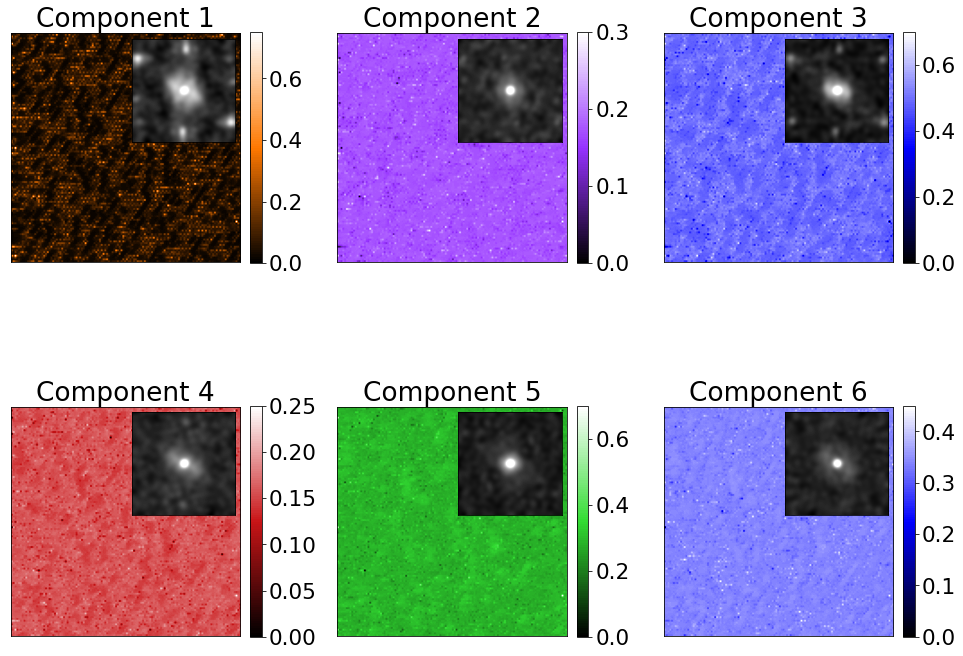

In [ ]:
figscale = 0.9
# fontscale = 1.2
plt.figure(figsize = (18*figscale, 14*figscale))
gs = gridspec.GridSpec(2,3, wspace = 0.3)
ax00, ax01, ax02 = plt.subplot(gs[0,0]), plt.subplot(gs[0,1]), plt.subplot(gs[0,2])
ax10, ax11, ax12 = plt.subplot(gs[1,0]), plt.subplot(gs[1,1]), plt.subplot(gs[1,2])

im00 = ax00.imshow(Map0, cmap = cmaps[0])
im01 = ax01.imshow(Map1, cmap = cmaps[1])
im02 = ax02.imshow(Map2, cmap = cmaps[2])

ax0s=[ax00,ax01,ax02]
im0s = [im00, im01, im02]
for ii in range(len(im0s)):
  cbar = plt.colorbar(im0s[ii], ax = ax0s[ii], fraction=0.046, pad=0.04)
  cbar.ax.tick_params(labelsize = 18*fontscale)
  ax0s[ii].set_title('Component ' + str(ii + 1), fontsize = 22*fontscale)

im10 = ax10.imshow(Map3, cmap = cmaps[3])
im11 = ax11.imshow(Map4, cmap = cmaps[4])
im12 = ax12.imshow(Map5, cmap = cmaps[2])
ax1s=[ax10,ax11,ax12]
im1s = [im10, im11, im12]
for ii in range(len(im1s)):
  cbar = plt.colorbar(im1s[ii], ax = ax1s[ii], fraction=0.046, pad=0.04)
  cbar.ax.tick_params(labelsize = 18*fontscale)
  ax1s[ii].set_title('Component ' + str(ii + 4), fontsize = 22*fontscale)

inset0 = inset_axes(ax00, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 0.9, 1.03), bbox_transform = ax00.transAxes)
inset1 = inset_axes(ax01, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 0.9, 1.03), bbox_transform = ax01.transAxes)
inset2 = inset_axes(ax02, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 0.9, 1.03), bbox_transform = ax02.transAxes)
inset3 = inset_axes(ax10, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 0.9, 1.03), bbox_transform = ax10.transAxes)
inset4 = inset_axes(ax11, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 0.9, 1.03), bbox_transform = ax11.transAxes)
inset5 = inset_axes(ax12, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 0.9, 1.03), bbox_transform = ax12.transAxes)
inset0.imshow(FFT0, cmap = 'gray')
inset1.imshow(FFT1, cmap = 'gray')
inset2.imshow(FFT2, cmap = 'gray')
inset3.imshow(FFT3, cmap = 'gray')
inset4.imshow(FFT4, cmap = 'gray')
inset5.imshow(FFT5, cmap = 'gray')

plt.setp([ax00,ax01,ax02,ax10,ax11,ax12],xticks=[],yticks=[])
plt.setp([inset0, inset1, inset2, inset3, inset4, inset5],xticks=[],yticks=[])

Save progress

In [ ]:
# Package things into dicts/lists if haven't already:
# Class
CoordsbyPCA = {'C1P0' : np.array([Class1_PCA0_coords_a,Class1_PCA0_coords_b]),
               'C1P1' : np.array([Class1_PCA1_coords_a,Class1_PCA1_coords_b]),
               'C2P0' : np.array([Class2_PCA0_coords_a,Class2_PCA0_coords_b]),
               'C2P1' : np.array([Class2_PCA1_coords_a,Class2_PCA1_coords_b])}

SpectrabyPCA = {'C1P0' : np.array([class1_pca0_a,class1_pca0_b]),
                'C1P1' : np.array([class1_pca1_a,class1_pca1_b]),
                'C2P0' : np.array([class2_pca0_a,class2_pca0_b]),
                'C2P1' : np.array([class2_pca1_a,class2_pca1_b])}

In [ ]:
# coords of PCA separated components is really the only thing I need. From that I can extract the spectra, the maps, the mean, etc.
# But let's package the at the minimum the coordinates and individual spectra. I don't need those maps and we can calculate mean if needed

np.savez("Checkpoint2.npz",
         CoordsbyPCA = CoordsbyPCA,
         SpectrabyPCA = SpectrabyPCA,
         FFT_all = FFT_all,
         Maps_all = Maps_all,
         components = components)

# CHECKPOINT 2

Load progress

In [ ]:
!gdown https://drive.google.com/uc?id=1y3OgiN4qitgMJCracVRqedDoUXrTMeXm
!gdown https://drive.google.com/uc?id=1i5BR9n982o4njuvdm4N27rQ_zGgD1MgR

Downloading...
From: https://drive.google.com/uc?id=1y3OgiN4qitgMJCracVRqedDoUXrTMeXm
To: /content/Checkpoint2.npz
3.25MB [00:00, 51.1MB/s]
Downloading...
From: https://drive.google.com/uc?id=1i5BR9n982o4njuvdm4N27rQ_zGgD1MgR
To: /content/Checkpoint1.npz
65.4MB [00:01, 55.6MB/s]


In [ ]:
##################
### Load Block ###
##################
loadedfile1 = np.load("Checkpoint1.npz", allow_pickle = True)
loadedfile2 = np.load("Checkpoint2.npz", allow_pickle = True)

# View contents of the loaded file:
print(list(loadedfile1.keys()))
print(list(loadedfile2.keys()))

# (Re)assign files to appropriate variables
# For file #1
topo_f_n = loadedfile1['topo_f_n']
imgstack = loadedfile1['imgstack']
com = loadedfile1['com']
imgstack_exp = loadedfile1['imgstack_exp']
com_exp = loadedfile1['com_exp']
classified = loadedfile1['classified']
classes_all = loadedfile1['classes_all']
z_axis = loadedfile1['z_axis']
exp_cits = loadedfile1['exp_cits']
exp_topo = loadedfile1['exp_topo']
blobclasses = loadedfile1['blobclasses']
blobclass1 = blobclasses.tolist()[1]
blobclass2 = blobclasses.tolist()[2]
blobclass3 = blobclasses.tolist()[3]
blobclass4 = blobclasses.tolist()[4]
blobclass5 = blobclasses.tolist()[5]
class1_dict = classes_all.tolist()[1]
class2_dict = classes_all.tolist()[2]
class3_dict = classes_all.tolist()[3]
class4_dict = classes_all.tolist()[4]
class5_dict = classes_all.tolist()[5]

# For file #2
components = loadedfile2['components']
CoordsbyPCA = loadedfile2['CoordsbyPCA']
SpectrabyPCA = loadedfile2['SpectrabyPCA']
FFT_all = loadedfile2['FFT_all']
Maps_all = loadedfile2['Maps_all']
Coords_C1P0_a = CoordsbyPCA.tolist()['C1P0'][0]
Coords_C1P1_a = CoordsbyPCA.tolist()['C1P1'][0]
Coords_C2P0_a = CoordsbyPCA.tolist()['C2P0'][0]
Coords_C2P1_a = CoordsbyPCA.tolist()['C2P1'][0]
Coords_C1P0_b = CoordsbyPCA.tolist()['C1P0'][1]
Coords_C1P1_b = CoordsbyPCA.tolist()['C1P1'][1]
Coords_C2P0_b = CoordsbyPCA.tolist()['C2P0'][1]
Coords_C2P1_b = CoordsbyPCA.tolist()['C2P1'][1]
Spectra_C1P0_a = SpectrabyPCA.tolist()['C1P0'][0]
Spectra_C1P1_a = SpectrabyPCA.tolist()['C1P1'][0]
Spectra_C2P0_a = SpectrabyPCA.tolist()['C2P0'][0]
Spectra_C2P1_a = SpectrabyPCA.tolist()['C2P1'][0]
Spectra_C1P0_b = SpectrabyPCA.tolist()['C1P0'][1]
Spectra_C1P1_b = SpectrabyPCA.tolist()['C1P1'][1]
Spectra_C2P0_b = SpectrabyPCA.tolist()['C2P0'][1]
Spectra_C2P1_b = SpectrabyPCA.tolist()['C2P1'][1]

['topo_f_n', 'imgstack', 'com', 'imgstack_exp', 'com_exp', 'classified', 'classes_all', 'z_axis', 'exp_cits', 'exp_topo', 'blobclasses']
['CoordsbyPCA', 'SpectrabyPCA', 'FFT_all', 'Maps_all', 'components']


In [ ]:
np.savez("temp_STS_files.npz",
        z_axis = z_axis,
        exp_cits = exp_cits,
        exp_topo = exp_topo)

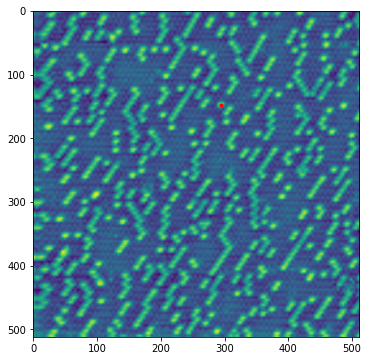

In [ ]:
k = 200

try:
  scalefactor / 1
except NameError:
  scalefactor = 4
topo_f_n_resized = resize(topo_f_n, (topo_f_n.shape[0]*scalefactor, topo_f_n.shape[1]*scalefactor))
plt.figure(figsize = (6,6))
plt.imshow(topo_f_n_resized)
plt.scatter(com[k][1], com[k][0], c='r', s = 10)

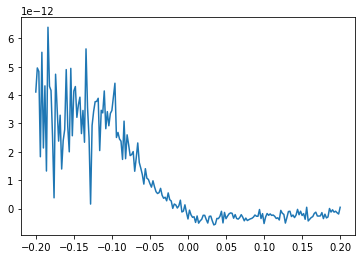

In [ ]:
plt.plot(z_axis, exp_cits[int(round(com[k][0])/4), int(round(com[k][1])/4)])

In [ ]:
derps =exp_cits[int(round(com[k][0])/4), int(round(com[k][1])/4)]
derps.shape
blobclass1[0]

14

# Spectral behavior of "everything else"

In [ ]:
# You know what I've never looked at really closely, is the spectra of ALL unclassified pixels.
# In other words, those of the surface. I never looked at them all plotted together, or the average of it, or even PCA.
# Let's try this quickly

# Note that each atom (so, about 700) likely has a pixel or a few pixels surrounding it which will still give similar spectra.
# So, we may want to assume that each coordinate is exactly centered on all atoms 
# (if only atom finding were this good, likely this is not the case, but I'm not sure how to do better)
# And with that, the 8 pixels in the immediate neighborhood of that atom (bounding square) also belong to the same atom.
# Therefore, the remaining pixels are actually: (128x128) - (700x8) --> Still plenty more of 'background'. 
# and taking a look at the topography, it still looks like there are more pixels devoted to adatoms that this assumption. Nevertheless.. 
# we could continue to expand the atom radius in pixels to exclude

# Another interesting idea would be to 
# 1) average the 8 pixels + center to get less noisy spectra for each atom
# 2) analyze the immediate pixel neighborhood of each adatom (WITHOUT the center atom)
# with this second one, we could start to see some other dependencies perhaps...

In [ ]:
# There are 128x128 pixels in the original hyperspectral dataset. 
# About 700 of them or so are identified as atoms, the rest are the substrate or 'in between' spaces
# lets get coordinates for everywhere but adatoms:

# all coords
all_coords = np.zeros((128,128,2)) # object so we can store tuples in the array elements
for m in range(all_coords.shape[0]):
  for n in range(all_coords.shape[1]):
    all_coords[m,n,0] = m
    all_coords[m,n,1] = n

# adatom coords:
# For now, using com as estimates for atom coordinates (which is what I use for extracting spectra)



# remaining coords:
other_coords = np.copy(all_coords)

# subtract the adatom_coords from the all_coords array

In [ ]:
adatom_coords = np.zeros((len(com), 2))
for k in range(len(adatom_coords)):
  adatom_coords[k,0] = int(round(com[k,0]/scalefactor))
  adatom_coords[k,1] = int(round(com[k,1]/scalefactor))

In [ ]:
# adatom_coords[0] np.isin all_coords

In [ ]:
# (0,4) in all_coords[0,5].all()

# and 4 in all_coords[0,5,1]

# But I need to check ALL the all_coords at once, not just a specific element like [1,5], I need to do [:,:] 
# [1,5][0] == all_coords[1,5,0]  and [1,5][1] == all_coords[1,5,1]

# if [5,][0] in all_coords[:,:]

In [ ]:
all_coords2 = np.reshape(all_coords, (all_coords.shape[0]*all_coords.shape[1], 2))
other_coords2 = np.copy(all_coords2)
other_coords2.shape


for ii in range(len(other_coords2)): 
  for kk in range(len(adatom_coords)):
    if (other_coords2[ii] == adatom_coords[kk]).all():
      other_coords2[ii] = np.nan

In [ ]:

for ii in range(len(other_coords2)): 
  for kk in range(len(adatom_coords)):
    if (other_coords2[ii] == adatom_coords[kk]).all():
      other_coords2[ii] = np.nan
      # test.append(kk)

In [ ]:
# len(test) # should be same as atom_coords length

In [ ]:
# remove nan
other_coords2_ = other_coords2[~np.isnan(other_coords2)]

# Reshape
other_coords3 = np.reshape(other_coords2_, (int(other_coords2_.shape[0]/2), 2))

In [ ]:
other_coords2.shape, other_coords3.shape

((16384, 2), (15634, 2))

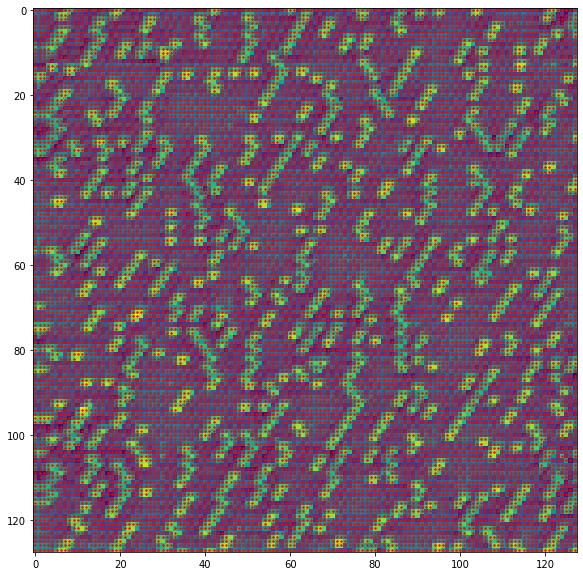

In [ ]:
plt.figure(figsize=(10,10))
plt.imshow(topo_f_n)
plt.scatter(other_coords3[:,1], other_coords3[:,0], c='r', s= 2)

* `other_coords2`: still contains NaNs (appropriate SIZE for 128x128)
* `other_coords3`: NaNs removed

In [ ]:
# Unclassified pixels (everything else)

# First make new array of all coordinates of the input hyperspectral array

# all coords
all_coords = np.zeros((exp_cits.shape[0],exp_cits.shape[1],2)) # object so we can store tuples in the array elements
for m in range(all_coords.shape[0]):
  for n in range(all_coords.shape[1]):
    all_coords[m,n,0] = m
    all_coords[m,n,1] = n

# Second, make same kind of array of coordinates, but only for those classified atoms' positions
adatom_coords = np.zeros((len(com), 2))
for k in range(len(adatom_coords)):
  adatom_coords[k,0] = int(round(com[k,0]/scalefactor))
  adatom_coords[k,1] = int(round(com[k,1]/scalefactor))

# Flatten the "all coords"
# Copy it to ... what. Why? Probably was for testing
all_coords2 = np.reshape(all_coords, (all_coords.shape[0]*all_coords.shape[1], 2))
other_coords2 = np.copy(all_coords2)

for ii in range(len(other_coords2)): 
  for kk in range(len(adatom_coords)):
    if (other_coords2[ii] == adatom_coords[kk]).all():
      other_coords2[ii] = np.nan

# remove nan
other_coords2_ = other_coords2[~np.isnan(other_coords2)]

# Reshape after NaN removal (it totally flattens it, but we need it to be still of coordinates)
# How to know if this even resahpes the correct combinations?
# I don't need to remove NaN for the averaging later. I can just use np.nanmean or something.
# It's the same. Good.
other_coords3 = np.reshape(other_coords2_, (int(other_coords2_.shape[0]/2), 2))

otheratoms_spec = np.zeros((len(other_coords3), exp_cits.shape[2]))
for ii in range(len(otheratoms_spec)):
  otheratoms_spec[ii] = exp_cits[int(other_coords3[ii,0]), int(other_coords3[ii,1])]

In [ ]:
# otheratoms_spec = np.zeros((len(other_coords3), exp_cits.shape[2]))
# for ii in range(len(otheratoms_spec)):
#   otheratoms_spec[ii] = exp_cits[int(other_coords3[ii,0]), int(other_coords3[ii,1])]

In [ ]:
# otheratoms_spec2 = np.zeros((len(other_coords2), exp_cits.shape[2]))
# for ii in range(len(otheratoms_spec2)):
#   try:
#     otheratoms_spec2[ii] = exp_cits[int(other_coords2[ii,0]), int(other_coords2[ii,1])]
#   except ValueError:
#     otheratoms_spec2[ii] = np.nan

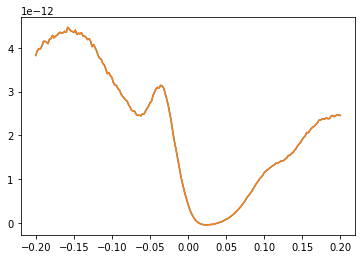

In [ ]:
# otheratoms_spec2_mean = np.nanmean(otheratoms_spec2, axis = 0)
# otheratoms_spec2_std = np.nanstd(otheratoms_spec2, axis = 0)


# plt.figure()
# plt.plot(z_axis, otheratoms_spec2_mean)
# plt.plot(z_axis, otheratoms_spec_mean)

In [ ]:
plt.figure()
for ii in range(len(otheratoms_spec)):
  plt.plot(z_axis, otheratoms_spec[ii,:])

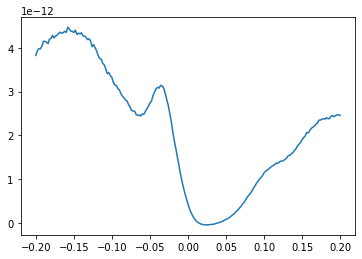

In [ ]:
otheratoms_spec_mean = np.mean(otheratoms_spec, axis = 0)
otheratoms_spec_std = np.std(otheratoms_spec, axis = 0)


plt.figure()
plt.plot(z_axis, otheratoms_spec_mean)

In [ ]:
# otheratoms_spec.shape

In [ ]:
# other_coords2[0,0]

In [ ]:
# # DO PCA
# _, ax1 = plt.subplots(1, figsize=(7,6))

# pca = PCA()
# pca.fit(otheratoms_spec)
# explained_var = pca.explained_variance_ratio_


# ax1.plot(explained_var[0:100], 'o-')
# # ax1.semilogy()
# ax1.set_xlabel('Principal component', fontsize = 16)
# ax1.set_ylabel('Explained variance ratio', fontsize = 16);
# ax1.set_title('Scree plot', fontsize = 18)
# ax1.tick_params(labelsize = 14)

I think to do the PCA correctly and get the appropriate loading maps, we need to MASK the original data, not cut it out like I did.


In [ ]:
# I need another "exp_cits" with just zeros or NaN for the positions that were classified as atoms (only like 700 of the 16k points):
# Like masking basically
exp_cits_noatoms = np.copy(exp_cits)

for k in range(len(adatom_coords)):
  exp_cits_noatoms[int(adatom_coords[k][0]), int(adatom_coords[k][1])] = 0

In [ ]:
exp_cits_noatoms_flat = np.reshape(exp_cits_noatoms, (exp_cits_noatoms.shape[0]*exp_cits_noatoms.shape[1], exp_cits_noatoms.shape[2]))
exp_cits_noatoms_flat.shape

(16384, 201)

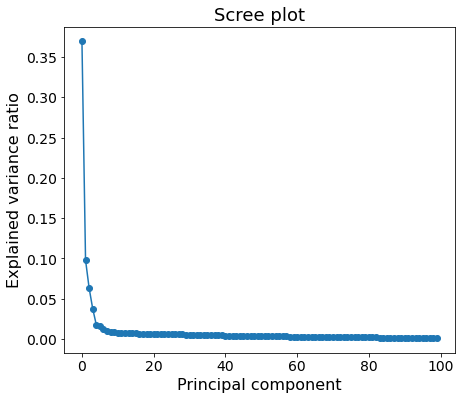

In [ ]:
# DO PCA
_, ax1 = plt.subplots(1, figsize=(7,6))

pca = PCA()
pca.fit(exp_cits_noatoms_flat)
explained_var = pca.explained_variance_ratio_


ax1.plot(explained_var[0:100], 'o-')
# ax1.semilogy()
ax1.set_xlabel('Principal component', fontsize = 16)
ax1.set_ylabel('Explained variance ratio', fontsize = 16);
ax1.set_title('Scree plot', fontsize = 18)
ax1.tick_params(labelsize = 14)

In [ ]:
print(exp_cits_noatoms.shape)
w, h, n = exp_cits_noatoms.shape

(128, 128, 201)


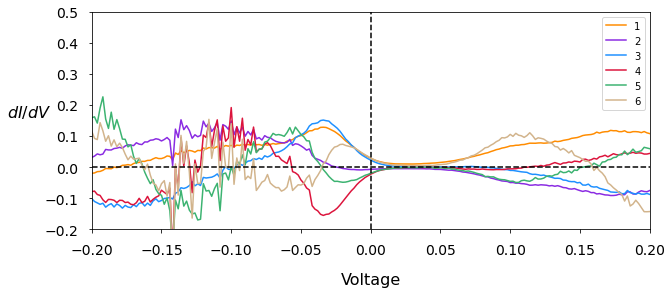

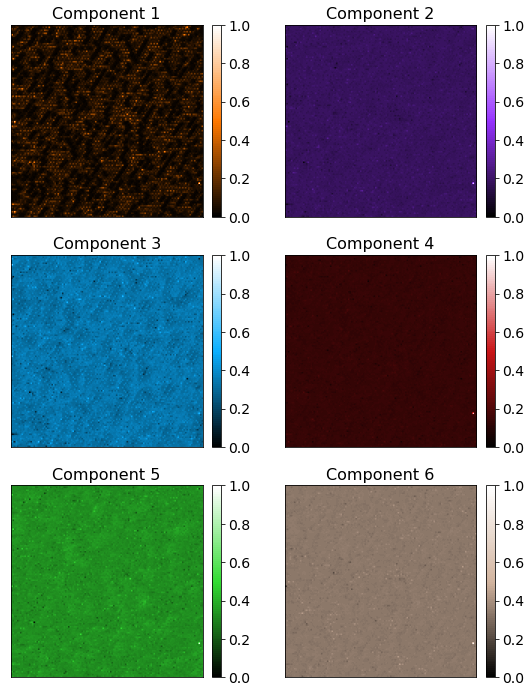

In [ ]:
nc = 6
cmaps=[bOw, bPw, bBw, bRw, bGw, bBrw, bPiw, bYw]
colors=['DarkOrange','BlueViolet','DodgerBlue','Crimson','MediumSeaGreen','Tan','HotPink','Yellow','Black']
clf = PCA(n_components=nc)
X_vec_t = clf.fit_transform(exp_cits_noatoms_flat)
components = clf.components_
X_vec_t = X_vec_t.reshape(w, h, nc)

# NORMALIZE these suckers (makes plotting smoother)
X_vec_t_n = np.copy(X_vec_t)
for ii in range(X_vec_t.shape[2]):
  X_vec_t_n[:,:,ii] = (X_vec_t[:,:,ii] - np.min(X_vec_t[:,:,ii])) / (np.ptp(X_vec_t[:,:,ii]))

rows = int(np.ceil(float(nc)/2))
cols = int(np.ceil(float(nc)/rows))
     
fig1,ax1 = plt.subplots(figsize = (10,4))

# plt.suptitle("NUMBER OF COMPONENTS: {}".format(nc), fontsize = 16, color = 'Crimson')
for i in range(nc):
    ax1.plot(z_axis,components[i], color = colors.pop(0), label = i+1)
    # ax1.grid(True)
    # ax1.set_xticks(np.arange(-0.2,0.2, step=0.02));
    ax1.set_xlim(-0.2,0.2)
    ax1.set_ylim(-0.2,0.5)
    ax1.tick_params(labelsize=10)
    ax1.legend(loc = 1)
    ax1.set_xlabel("Voltage", fontsize = 16, labelpad = 15)
    ax1.set_ylabel("$dI/dV$", rotation = 0, labelpad = 15, fontsize = 16)
    ax1.tick_params(labelsize = 14, pad = 10)
plt.axhline(0, color = 'k', ls = '--')
plt.axvline(0, color = 'k', ls = '--')
plt.show()


gs2 = gridspec.GridSpec(rows, cols)
fig2 = plt.figure(figsize = (4.5*cols, 3*(1+rows//1)))   
for i in range(nc):
    ax2 = fig2.add_subplot(gs2[i])
    im = ax2.imshow(X_vec_t_n[:, : ,i],cmap = cmaps.pop(0))
    ax2.set_title('Component ' + str(i + 1), fontsize = 16)
    plt.setp([ax2],xticks=[], yticks=[])
    cbar = plt.colorbar(im, ax = ax2, fraction=0.046, pad=0.04)
    cbar.ax.tick_params(labelsize = 14)
plt.show()

This is almost identical to when we run PCA on the entire dataset (we really haven't removed many data points remember, only a few percent, so not entirely unexpected)

# For extracting spectra:
* Currently I was just extracting spectra AT the position of the atom coordinate ONLY (a single pixel). 
* I could change this to extract surrounding pixels, too. For example all 8 neighbors with varying strengths (corner pixels wouldn't receive same averaging strength as sides, eg)
* This could help smooth out some strange effects if the atom finding didn't perform well
* Or, we don't do this at all because we have a statistical measurement of many atoms anyway, and we average those, so we don't need to do it.
* However, simply because we have many atoms ignores the point that, well, we do find there to be variabililty within the single structural class.
* Maybe we wont see that variability if we do neighbor averaging?

In [ ]:
class1spec = np.zeros((len(blobclass1), exp_cits.shape[2]))
for ii in range(len(class1spec)):
  class1spec[ii] = exp_cits[int(round(com[blobclass1[ii]][0])/4), int(round(com[blobclass1[ii]][1])/4)]
class2spec = np.zeros((len(blobclass2), exp_cits.shape[2]))
for ii in range(len(class2spec)):
  class2spec[ii] = exp_cits[int(round(com[blobclass2[ii]][0])/4), int(round(com[blobclass2[ii]][1])/4)]
class3spec = np.zeros((len(blobclass3), exp_cits.shape[2]))
for ii in range(len(class3spec)):
  class3spec[ii] = exp_cits[int(round(com[blobclass3[ii]][0])/4), int(round(com[blobclass3[ii]][1])/4)]
class4spec = np.zeros((len(blobclass4), exp_cits.shape[2]))
for ii in range(len(class4spec)):
  class4spec[ii] = exp_cits[int(round(com[blobclass4[ii]][0])/4), int(round(com[blobclass4[ii]][1])/4)]
class5spec = np.zeros((len(blobclass5), exp_cits.shape[2]))
for ii in range(len(class5spec)):
  class5spec[ii] = exp_cits[int(round(com[blobclass5[ii]][0])/4), int(round(com[blobclass5[ii]][1])/4)]

# Original class means (before PCA subclassification)
class1_mean = np.mean(class1spec,axis=0)
class2_mean = np.mean(class2spec,axis=0)
class3_mean = np.mean(class3spec,axis=0)
class4_mean = np.mean(class4spec,axis=0)
class5_mean = np.mean(class5spec,axis=0)

class1_stdev = np.std(class1spec,axis=0)
class2_stdev = np.std(class2spec,axis=0)
class3_stdev = np.std(class3spec,axis=0)
class4_stdev = np.std(class4spec,axis=0)
class5_stdev = np.std(class5spec,axis=0)

In [ ]:
# Unclassified pixels (everything else)

# First make new array of all coordinates of the input hyperspectral array

# all coords
all_coords = np.zeros((exp_cits.shape[0],exp_cits.shape[1],2)) # object so we can store tuples in the array elements
for m in range(all_coords.shape[0]):
  for n in range(all_coords.shape[1]):
    all_coords[m,n,0] = m
    all_coords[m,n,1] = n

# Second, make same kind of array of coordinates, but only for those classified atoms' positions
adatom_coords = np.zeros((len(com), 2))
for k in range(len(adatom_coords)):
  adatom_coords[k,0] = int(round(com[k,0]/scalefactor))
  adatom_coords[k,1] = int(round(com[k,1]/scalefactor))

# Flatten the "all coords"
# Copy it to ... what. Why? Probably was for testing
all_coords2 = np.reshape(all_coords, (all_coords.shape[0]*all_coords.shape[1], 2))
other_coords2 = np.copy(all_coords2)

for ii in range(len(other_coords2)): 
  for kk in range(len(adatom_coords)):
    if (other_coords2[ii] == adatom_coords[kk]).all():
      other_coords2[ii] = np.nan

# remove nan
other_coords2_ = other_coords2[~np.isnan(other_coords2)]

# Reshape after NaN removal (it totally flattens it, but we need it to be still of coordinates)
# How to know if this even resahpes the correct combinations?
# I don't need to remove NaN for the averaging later. I can just use np.nanmean or something.
# It's the same. Good.
other_coords3 = np.reshape(other_coords2_, (int(other_coords2_.shape[0]/2), 2))

otheratoms_spec = np.zeros((len(other_coords3), exp_cits.shape[2]))
for ii in range(len(otheratoms_spec)):
  otheratoms_spec[ii] = exp_cits[int(other_coords3[ii,0]), int(other_coords3[ii,1])]

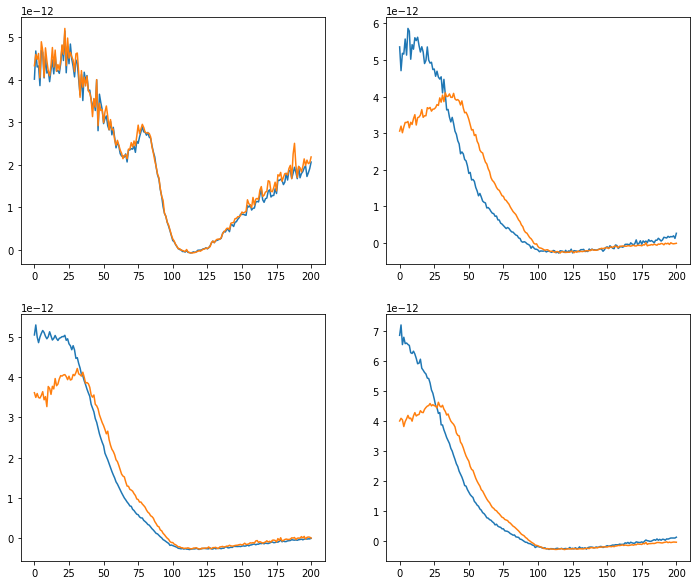

In [ ]:
# Testing the loading of the data

fig, ax = plt.subplots(2,2,figsize=(12,10))
ax[0,0].plot(np.mean(Spectra_C1P0_a[:,:],axis=0))
ax[0,0].plot(np.mean(Spectra_C1P0_b[:,:],axis=0))
ax[0,1].plot(np.mean(Spectra_C1P1_a[:,:],axis=0))
ax[0,1].plot(np.mean(Spectra_C1P1_b[:,:],axis=0))
ax[1,0].plot(np.mean(Spectra_C2P0_a[:,:],axis=0))
ax[1,0].plot(np.mean(Spectra_C2P0_b[:,:],axis=0))
ax[1,1].plot(np.mean(Spectra_C2P1_a[:,:],axis=0))
ax[1,1].plot(np.mean(Spectra_C2P1_b[:,:],axis=0))

[]

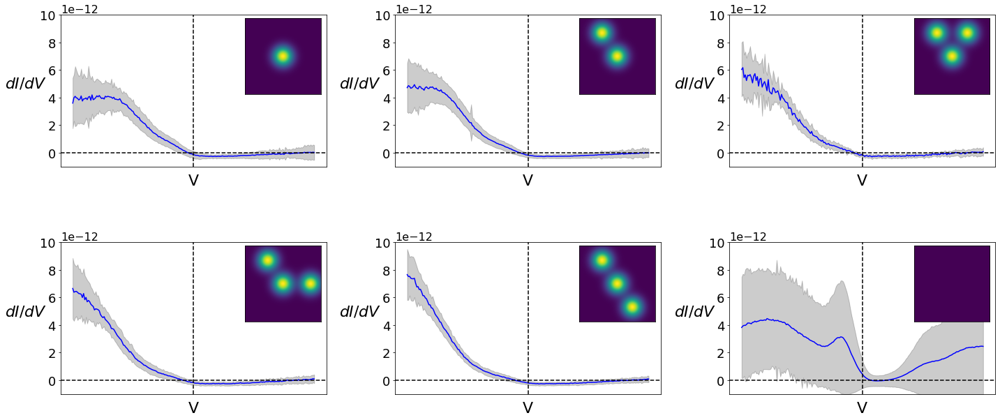

In [ ]:
plt.figure(figsize = (24,10))
gs = gridspec.GridSpec(2,6,hspace = 0.5, wspace = 0.7)
ax1 = plt.subplot(gs[0,0:2])
ax2 = plt.subplot(gs[0,2:4])
ax3 = plt.subplot(gs[0,4:6])
ax4 = plt.subplot(gs[1,0:2])
ax5 = plt.subplot(gs[1,2:4])
ax6 = plt.subplot(gs[1,4:6])

ax1.plot(z_axis,class1_mean, label = "Class 1", color = 'blue')
ax1.fill_between(z_axis, class1_mean-class1_stdev, class1_mean+class1_stdev, color = 'k', alpha = 0.2)
ax2.plot(z_axis,class2_mean, label = "Class 2", color = 'blue')
ax2.fill_between(z_axis, class2_mean-class2_stdev, class2_mean+class2_stdev, color = 'k', alpha = 0.2)
ax3.plot(z_axis,class3_mean, label = "Class 3", color = 'blue')
ax3.fill_between(z_axis, class3_mean-class3_stdev, class3_mean+class3_stdev, color = 'k', alpha = 0.2)
ax4.plot(z_axis,class4_mean, label = "Class 4", color = 'blue')
ax4.fill_between(z_axis, class4_mean-class4_stdev, class4_mean+class4_stdev, color = 'k', alpha = 0.2)
ax5.plot(z_axis,class5_mean, label = "Class 5", color = 'blue')
ax5.fill_between(z_axis, class5_mean-class5_stdev, class5_mean+class5_stdev, color = 'k', alpha = 0.2)


otheratoms_spec_mean = np.mean(otheratoms_spec, axis = 0)
otheratoms_spec_std = np.std(otheratoms_spec, axis = 0)


ax6.plot(z_axis,otheratoms_spec_mean, label = "Other", color = 'blue')
ax6.fill_between(z_axis, otheratoms_spec_mean-otheratoms_spec_std, otheratoms_spec_mean+otheratoms_spec_std, color = 'k', alpha = 0.2)

axs = [ax1,ax2,ax3,ax4,ax5, ax6]
ylim1, ylim2 = -0.1E-11,1E-11
for ii in range(len(axs)):
  axs[ii].set_xlabel('V', size = 22, labelpad = 10)
  axs[ii].set_ylabel('$dI/dV$', size = 22, rotation = 0, labelpad = 20)
  axs[ii].axhline(0, ls = '--', c='k')
  axs[ii].axvline(0, ls = '--', c='k')
  axs[ii].set_ylim(ylim1, ylim2)
  axs[ii].tick_params(labelsize = 18)
  axs[ii].yaxis.get_offset_text().set(size=16)


inset1 = inset_axes(ax1, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax1.transAxes)
inset2 = inset_axes(ax2, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax2.transAxes)
inset3 = inset_axes(ax3, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax3.transAxes)
inset4 = inset_axes(ax4, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax4.transAxes)
inset5 = inset_axes(ax5, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax5.transAxes)
inset6 = inset_axes(ax6, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax6.transAxes)


try:
  inset1.imshow(atom0)
  inset2.imshow(atom0 + atom1)
  inset3.imshow(atom0 + atom1 + atom2)
  inset4.imshow(atom0 + atom1 + atom3)
  inset5.imshow(atom0 + atom1 + atom4)
  inset6.imshow(np.zeros_like(atom0))

except NameError:
  inset1.imshow(class1_dict[1])
  inset2.imshow(class2_dict[1])
  inset3.imshow(class3_dict[1])
  inset4.imshow(class4_dict[1])
  inset5.imshow(class5_dict[1])
  inset6.imshow(np.zeros_like(class1_dict[1]))

plt.setp([inset1, inset2, inset3, inset4, inset5, inset6],xticks=[],yticks=[])


plt.setp([axs], xticks=[])

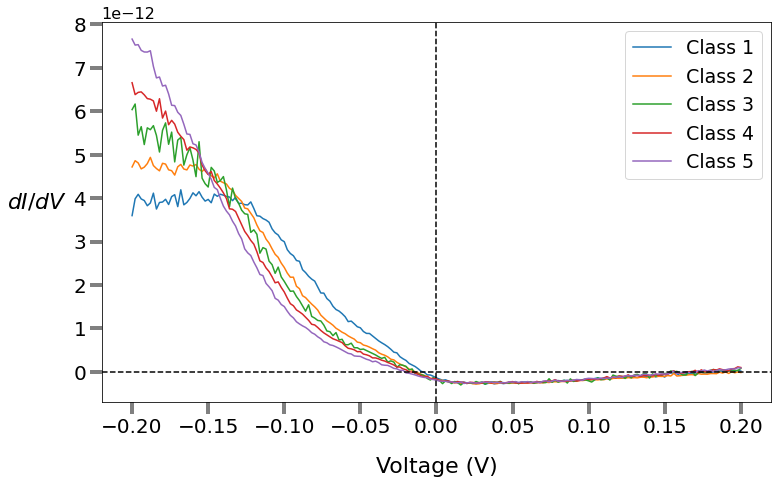

In [ ]:
fig, ax = plt.subplots(1,figsize=(12,7))
ax.plot(z_axis,class1_mean, label = "Class 1")
ax.plot(z_axis,class2_mean, label = "Class 2")
ax.plot(z_axis,class3_mean, label = "Class 3")
ax.plot(z_axis,class4_mean, label = "Class 4")
ax.plot(z_axis,class5_mean, label = "Class 5")
# ax.plot(z_axis,otheratoms_spec_mean, label = "Others")

ax.axvline(0,c='k',ls='--')
ax.axhline(0,c='k',ls='--')
ax.legend(fontsize = 19);

ax.set_xlabel('Voltage (V)', size = 22, labelpad = 20);
ax.set_ylabel('$dI/dV$', size = 22, rotation = 0, labelpad = 36);
ax.tick_params(labelsize = 20, size = 12, width = 4, color = 'gray')
ax.yaxis.get_offset_text().set(size=16)


<font size = 6>`Big Fig`</font>

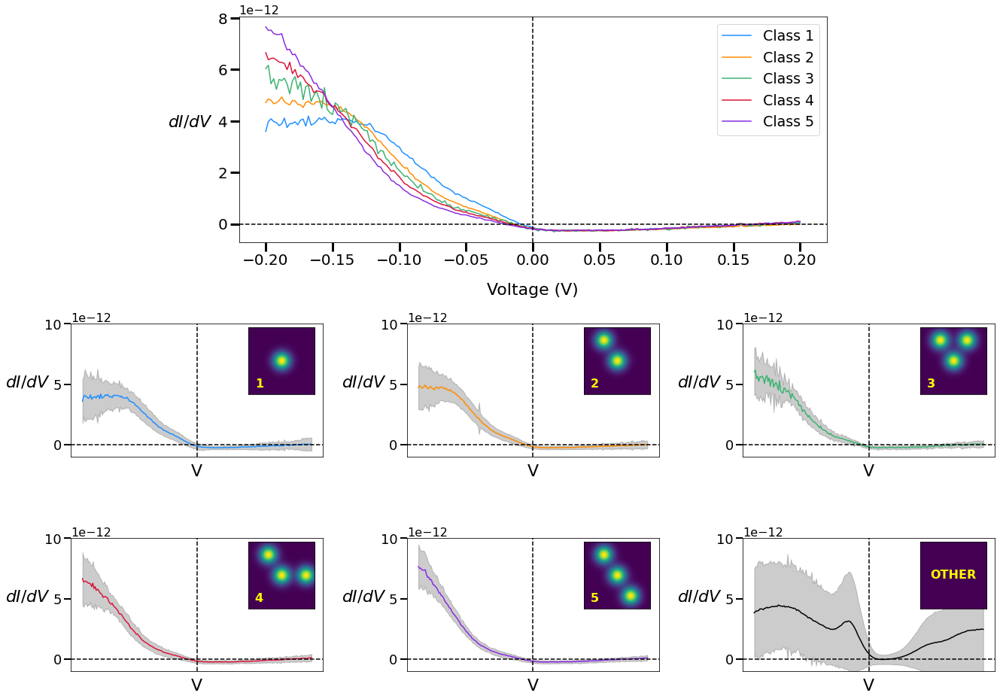

In [ ]:
colorlist = ['dodgerblue', 'darkorange', 'mediumseagreen', 'crimson', 'blueviolet', 'k']

plt.figure(figsize = (22,16))

gs = gridspec.GridSpec(3,6,hspace = 0.5, wspace = 1, height_ratios = [1.7,1,1])
ax0 = plt.subplot(gs[0,1:5])
ax1 = plt.subplot(gs[1,0:2])
ax2 = plt.subplot(gs[1,2:4])
ax3 = plt.subplot(gs[1,4:6])
ax4 = plt.subplot(gs[2,0:2])
ax5 = plt.subplot(gs[2,2:4])
ax6 = plt.subplot(gs[2,4:6])

ax1.plot(z_axis,class1_mean, label = "Class 1", color = colorlist[0])
ax1.fill_between(z_axis, class1_mean-class1_stdev, class1_mean+class1_stdev, color = 'k', alpha = 0.2)
ax2.plot(z_axis,class2_mean, label = "Class 2", color = colorlist[1])
ax2.fill_between(z_axis, class2_mean-class2_stdev, class2_mean+class2_stdev, color = 'k', alpha = 0.2)
ax3.plot(z_axis,class3_mean, label = "Class 3", color = colorlist[2])
ax3.fill_between(z_axis, class3_mean-class3_stdev, class3_mean+class3_stdev, color = 'k', alpha = 0.2)
ax4.plot(z_axis,class4_mean, label = "Class 4", color = colorlist[3])
ax4.fill_between(z_axis, class4_mean-class4_stdev, class4_mean+class4_stdev, color = 'k', alpha = 0.2)
ax5.plot(z_axis,class5_mean, label = "Class 5", color = colorlist[4])
ax5.fill_between(z_axis, class5_mean-class5_stdev, class5_mean+class5_stdev, color = 'k', alpha = 0.2)


otheratoms_spec_mean = np.mean(otheratoms_spec, axis = 0)
otheratoms_spec_std = np.std(otheratoms_spec, axis = 0)


ax6.plot(z_axis,otheratoms_spec_mean, label = "Other", color = colorlist[5])
ax6.fill_between(z_axis, otheratoms_spec_mean-otheratoms_spec_std, otheratoms_spec_mean+otheratoms_spec_std, color = 'k', alpha = 0.2)

axs = [ax1,ax2,ax3,ax4,ax5, ax6]
ylim1, ylim2 = -0.1E-11,1E-11
for ii in range(len(axs)):
  axs[ii].set_xlabel('V', size = 22, labelpad = 10)
  axs[ii].set_ylabel('$dI/dV$', size = 22, rotation = 0, labelpad = 22)
  axs[ii].axhline(0, ls = '--', c='k')
  axs[ii].axvline(0, ls = '--', c='k')
  axs[ii].set_ylim(ylim1, ylim2)
  axs[ii].tick_params(labelsize = 18, width = 2, size = 9)
  axs[ii].yaxis.get_offset_text().set(size=16)



inset1 = inset_axes(ax1, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax1.transAxes)
inset2 = inset_axes(ax2, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax2.transAxes)
inset3 = inset_axes(ax3, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax3.transAxes)
inset4 = inset_axes(ax4, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax4.transAxes)
inset5 = inset_axes(ax5, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax5.transAxes)
inset6 = inset_axes(ax6, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax6.transAxes)


try:
  inset1.imshow(atom0)
  inset2.imshow(atom0 + atom1)
  inset3.imshow(atom0 + atom1 + atom2)
  inset4.imshow(atom0 + atom1 + atom3)
  inset5.imshow(atom0 + atom1 + atom4)
  inset6.imshow(np.zeros_like(atom0))

# This try/except exists in case we start the notebook from a checkpoint, since atom0, atom1, etc are not defined with same name
except NameError:
  inset1.imshow(class1_dict[1])
  inset2.imshow(class2_dict[1])
  inset3.imshow(class3_dict[1])
  inset4.imshow(class4_dict[1])
  inset5.imshow(class5_dict[1])
  inset6.imshow(np.zeros_like(class1_dict[1]))

# Annotate insets with class number for clear identification
insets = [inset1, inset2, inset3, inset4, inset5, inset6]
for ii in range(len(insets)-1):
  insets[ii].annotate("{}".format(ii+1), (0.1,0.1), xycoords = 'axes fraction', color = 'yellow', fontsize = 16, weight ='bold')

# annotate the 'other' separately since it's a blank inset
insets[-1].annotate("OTHER", (0.5,0.5), xycoords = 'axes fraction', color = 'yellow', fontsize = 16, weight ='bold',ha='center', va = 'center')


plt.setp([inset1, inset2, inset3, inset4, inset5, inset6],xticks=[],yticks=[])


plt.setp([axs], xticks=[])


ax0.plot(z_axis,class1_mean, label = "Class 1", color = colorlist[0])
ax0.plot(z_axis,class2_mean, label = "Class 2", color = colorlist[1])
ax0.plot(z_axis,class3_mean, label = "Class 3", color = colorlist[2])
ax0.plot(z_axis,class4_mean, label = "Class 4", color = colorlist[3])
ax0.plot(z_axis,class5_mean, label = "Class 5", color = colorlist[4])
# ax0.plot(z_axis,otheratoms_spec_mean, label = "Others", color = colorlist[5])

ax0.axvline(0,c='k',ls='--')
ax0.axhline(0,c='k',ls='--')
ax0.legend(fontsize = 19);

ax0.set_xlabel('Voltage (V)', size = 22, labelpad = 20);
ax0.set_ylabel('$dI/dV$', size = 22, rotation = 0, labelpad = 36);
ax0.tick_params(labelsize = 20, size = 12, width = 3)
ax0.yaxis.get_offset_text().set(size=16)




## PCA space plots
* PCA for each structural class
* plot each spectrum represented by PCA component in PCA space (1-2, 1-3, etc)
* for each class show with different color to see how they overlap (or dont) in PCA space

In [ ]:
# print(Class2_PCA1_coords_a.shape, Class2_PCA1_coords_b.shape)  #25% threshold for PCA 1
# # class2_pca1_a[ii]
# # class2_pca1_b[ii]

(68, 2) (270, 2)


In [ ]:
# blobclass2[5]

7

In [ ]:
# class2_masked_flat.shape

(16384, 201)

In [ ]:
# pca = PCA()
# pca.fit(class2_masked_flat)
# explained_var = pca.explained_variance_ratio_

# nc = 3
# cmaps=[bOw, bPw, bBw, bRw, bGw, bBrw, bPiw, bYw, bLGw]
# colors=['DarkOrange','BlueViolet','DodgerBlue','Crimson','MediumSeaGreen','Tan','HotPink','Yellow','green', 'black']
# clf = PCA(n_components=nc)
# X_vec_t = clf.fit_transform(class2_masked_flat)
# components = clf.components_
# X_vec_t = X_vec_t.reshape(w, h, nc)

In [ ]:
# len(class3positions)
# class3positions[0]
# class2_pca1_a.shape,class3_masked_flat.shape
Coords_C2P1_a[0]

array([ 3, 85])

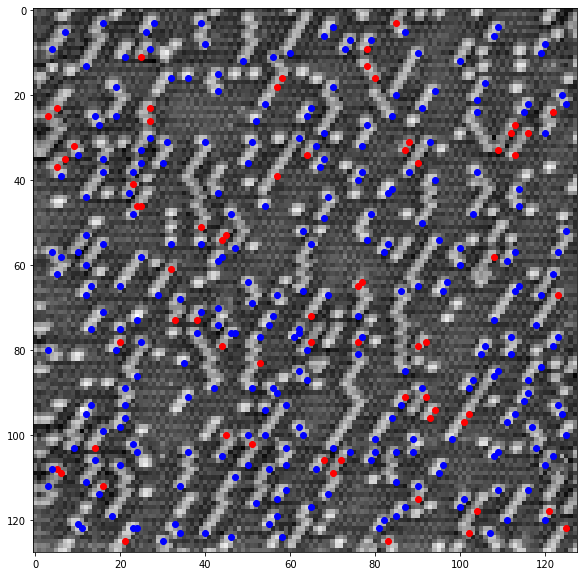

In [ ]:
plt.figure(figsize=(10,10))
plt.imshow(topo_f_n, cmap = 'gray')
plt.scatter(Coords_C2P1_a[:,1], Coords_C2P1_a[:,0], c = 'r')
plt.scatter(Coords_C2P1_b[:,1], Coords_C2P1_b[:,0], c = 'blue')

In [ ]:
# plt.figure(figsize=(10,10))
# plt.imshow(topo_f_n)
# plt.imshow(Mask2A, alpha = 0.3)

In [ ]:
# Flatten all the classes (only done 1 and 2 up to now)
# But repeat for all anyway
class1positions = []
class2positions = []
class3positions = []
class4positions = []
class5positions = []

for ii in range(blobclass1.shape[0]):
  class1positions.append((int(round(com[blobclass1[ii],1])),int(round(com[blobclass1[ii],0]))))
for ii in range(blobclass2.shape[0]):
  class2positions.append((int(round(com[blobclass2[ii],1])),int(round(com[blobclass2[ii],0]))))
for ii in range(blobclass3.shape[0]):
  class3positions.append((int(round(com[blobclass3[ii],1])),int(round(com[blobclass3[ii],0]))))
for ii in range(blobclass4.shape[0]):
  class4positions.append((int(round(com[blobclass4[ii],1])),int(round(com[blobclass4[ii],0]))))
for ii in range(blobclass5.shape[0]):
  class5positions.append((int(round(com[blobclass5[ii],1])),int(round(com[blobclass5[ii],0]))))


Mask1 = np.zeros_like(topo_f_n)
for ii in range(len(class1positions)):
    Mask1[int(round(com[blobclass1[ii],0]/4)),int(round(com[blobclass1[ii],1]/4))] = 1
Mask2 = np.zeros_like(topo_f_n)
for ii in range(len(class2positions)):
    Mask2[int(round(com[blobclass2[ii],0]/4)),int(round(com[blobclass2[ii],1]/4))] = 1
Mask3 = np.zeros_like(topo_f_n)
for ii in range(len(class3positions)):
    Mask3[int(round(com[blobclass3[ii],0]/4)),int(round(com[blobclass3[ii],1]/4))] = 1
Mask4 = np.zeros_like(topo_f_n)
for ii in range(len(class4positions)):
    Mask4[int(round(com[blobclass4[ii],0]/4)),int(round(com[blobclass4[ii],1]/4))] = 1
Mask5 = np.zeros_like(topo_f_n)
for ii in range(len(class5positions)):
    Mask5[int(round(com[blobclass5[ii],0]/4)),int(round(com[blobclass5[ii],1]/4))] = 1




## Mask the SPECTRAL data using the Mask array
test1 = np.tile(Mask1, (201,1,1))
test2 = np.tile(Mask2, (201,1,1))
test3 = np.tile(Mask3, (201,1,1))
test4 = np.tile(Mask4, (201,1,1))
test5 = np.tile(Mask5, (201,1,1))
test1_ = np.swapaxes(np.swapaxes(test1,0,1), 1,2)
test2_ = np.swapaxes(np.swapaxes(test2,0,1), 1,2)
test3_ = np.swapaxes(np.swapaxes(test3,0,1), 1,2)
test4_ = np.swapaxes(np.swapaxes(test4,0,1), 1,2)
test5_ = np.swapaxes(np.swapaxes(test5,0,1), 1,2)
class1_masked = test1_*exp_cits
class2_masked = test2_*exp_cits
class3_masked = test3_*exp_cits
class4_masked = test4_*exp_cits
class5_masked = test5_*exp_cits

XY1 = class1_masked.shape[:2]
XY2 = class2_masked.shape[:2]
XY3 = class3_masked.shape[:2]
XY4 = class4_masked.shape[:2]
XY5 = class5_masked.shape[:2]

class1_masked_flat=class1_masked.reshape((np.prod(XY1),class1_masked.shape[2]))
class2_masked_flat=class2_masked.reshape((np.prod(XY2),class2_masked.shape[2]))
class3_masked_flat=class3_masked.reshape((np.prod(XY3),class3_masked.shape[2]))
class4_masked_flat=class4_masked.reshape((np.prod(XY4),class4_masked.shape[2]))
class5_masked_flat=class5_masked.reshape((np.prod(XY5),class5_masked.shape[2]))

In [ ]:
# and for subclasses:

Mask2A = np.zeros_like(topo_f_n)
for ii in range(len(Coords_C2P1_a)):
    Mask2A[int(round(Coords_C2P1_a[ii,0])),int(round(Coords_C2P1_a[ii,1]))] = 1
           
Mask2B = np.zeros_like(topo_f_n)
for ii in range(len(Coords_C2P1_b)):
    Mask2B[int(round(Coords_C2P1_b[ii,0])),int(round(Coords_C2P1_b[ii,1]))] = 1

test2A = np.tile(Mask2A, (exp_cits.shape[2],1,1))
test2B = np.tile(Mask2B, (exp_cits.shape[2],1,1))
test2A_ = np.swapaxes(np.swapaxes(test2A,0,1), 1,2)
test2B_ = np.swapaxes(np.swapaxes(test2B,0,1), 1,2)
class2A_masked = test2A_*exp_cits
class2B_masked = test2B_*exp_cits

XY2A = class2A_masked.shape[:2]
XY2B = class2B_masked.shape[:2]

class2A_masked_flat=class2A_masked.reshape((np.prod(XY2A),class2A_masked.shape[2]))
class2B_masked_flat=class2B_masked.reshape((np.prod(XY2B),class2B_masked.shape[2]))

[]

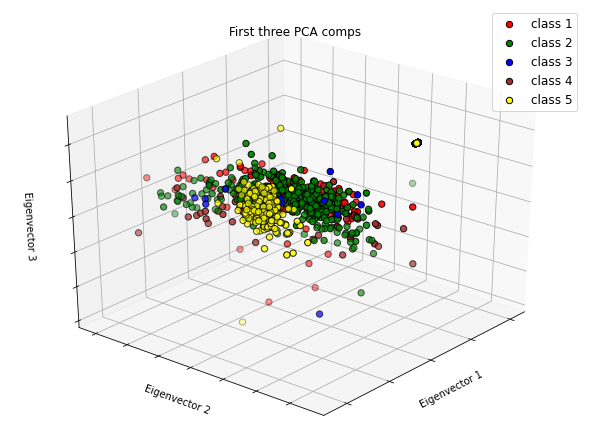

In [ ]:
# To getter a better understanding of interaction of the dimensions
# plot the first three PCA dimensions
fig = plt.figure(1, figsize=(8, 6))
ax = Axes3D(fig, elev=-150, azim=140)


X_reduced1 = PCA(n_components=3).fit_transform(class1_masked_flat)
ax.scatter(X_reduced1[:, 0], X_reduced1[:, 1], X_reduced1[:, 2], c= 'r',
           cmap=plt.cm.Set1, edgecolor='k', s=40, label ='class 1')
X_reduced2 = PCA(n_components=3).fit_transform(class2_masked_flat)
ax.scatter(X_reduced2[:, 0], X_reduced2[:, 1], X_reduced2[:, 2], c='g',
           cmap=plt.cm.Set1, edgecolor='k', s=40, label ='class 2')
X_reduced3 = PCA(n_components=3).fit_transform(class3_masked_flat)
ax.scatter(X_reduced3[:, 0], X_reduced3[:, 1], X_reduced3[:, 2], c= 'b',
           cmap=plt.cm.Set1, edgecolor='k', s=40, label ='class 3')
X_reduced4 = PCA(n_components=3).fit_transform(class4_masked_flat)
ax.scatter(X_reduced4[:, 0], X_reduced4[:, 1], X_reduced4[:, 2], c='brown',
           cmap=plt.cm.Set1, edgecolor='k', s=40, label ='class 4')
X_reduced5 = PCA(n_components=3).fit_transform(class5_masked_flat)
ax.scatter(X_reduced5[:, 0], X_reduced5[:, 1], X_reduced5[:, 2], c= 'yellow',
           cmap=plt.cm.Set1, edgecolor='k', s=40, label ='class 5')
ax.legend(fontsize=12)
ax.set_title("First three PCA comps")
ax.set_xlabel("Eigenvector 1")
ax.w_xaxis.set_ticklabels([])
ax.set_ylabel("Eigenvector 2")
ax.w_yaxis.set_ticklabels([])
ax.set_zlabel("Eigenvector 3")
ax.w_zaxis.set_ticklabels([])

In 2D instead (3D a bit much)

In [ ]:
# Normalize so limits easier to manipulate:

X_reduced1_n = (X_reduced1 - np.min(X_reduced1)) / np.ptp(X_reduced1)
X_reduced2_n = (X_reduced2 - np.min(X_reduced2)) / np.ptp(X_reduced2)
X_reduced3_n = (X_reduced3 - np.min(X_reduced3)) / np.ptp(X_reduced3)
X_reduced4_n = (X_reduced4 - np.min(X_reduced4)) / np.ptp(X_reduced4)
X_reduced5_n = (X_reduced5 - np.min(X_reduced5)) / np.ptp(X_reduced5)

In [ ]:
# X_reduced1.min(), X_reduced1.max()
# X_reduced1_n.min(), X_reduced1_n.max()

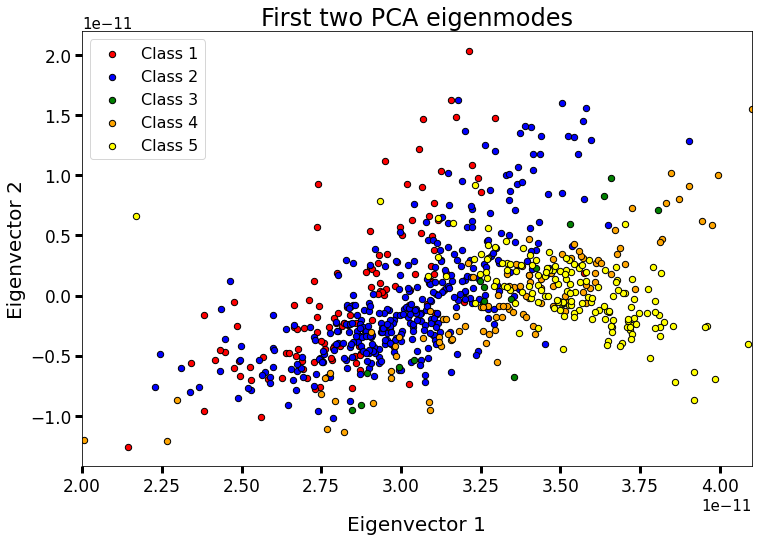

In [ ]:
fig,ax = plt.subplots(1, figsize=(12, 8))

comps = 2 # number PCA comps
clist = ['r', 'b', 'g', 'orange', 'yellow']
X_reduced1 = PCA(n_components=comps).fit_transform(class1_masked_flat)
X_reduced2 = PCA(n_components=comps).fit_transform(class2_masked_flat)
X_reduced3 = PCA(n_components=comps).fit_transform(class3_masked_flat)
X_reduced4 = PCA(n_components=comps).fit_transform(class4_masked_flat)
X_reduced5 = PCA(n_components=comps).fit_transform(class5_masked_flat)
# normalize 
# X_reduced1_n = (X_reduced1 - np.min(X_reduced1)) / np.ptp(X_reduced1)
# X_reduced2_n = (X_reduced2 - np.min(X_reduced2)) / np.ptp(X_reduced2)
# X_reduced3_n = (X_reduced3 - np.min(X_reduced3)) / np.ptp(X_reduced3)
# X_reduced4_n = (X_reduced4 - np.min(X_reduced4)) / np.ptp(X_reduced4)
# X_reduced5_n = (X_reduced5 - np.min(X_reduced5)) / np.ptp(X_reduced5)

# ax.scatter(X_reduced1_n[:, 0], X_reduced1_n[:, 1], c = clist[0], edgecolor='k', s=40, label ='Class 1')
# ax.scatter(X_reduced2_n[:, 0], X_reduced2_n[:, 1], c = clist[1], edgecolor='k', s=40, label ='Class 2')
# ax.scatter(X_reduced3_n[:, 0], X_reduced3_n[:, 1], c = clist[2], edgecolor='k', s=40, label ='Class 3')
# ax.scatter(X_reduced4_n[:, 0], X_reduced4_n[:, 1], c = clist[3], edgecolor='k', s=40, label ='Class 4')
# ax.scatter(X_reduced5_n[:, 0], X_reduced5_n[:, 1], c = clist[4], edgecolor='k', s=40, label ='Class 5')

ax.scatter(X_reduced1[:, 0], X_reduced1[:, 1], c = clist[0], edgecolor='k', s=40, label ='Class 1')
ax.scatter(X_reduced2[:, 0], X_reduced2[:, 1], c = clist[1], edgecolor='k', s=40, label ='Class 2')
ax.scatter(X_reduced3[:, 0], X_reduced3[:, 1], c = clist[2], edgecolor='k', s=40, label ='Class 3')
ax.scatter(X_reduced4[:, 0], X_reduced4[:, 1], c = clist[3], edgecolor='k', s=40, label ='Class 4')
ax.scatter(X_reduced5[:, 0], X_reduced5[:, 1], c = clist[4], edgecolor='k', s=40, label ='Class 5')

ax.legend(fontsize=16)
ax.set_title("First two PCA eigenmodes", fontsize = 24)
ax.set_xlabel("Eigenvector 1", fontsize = 20, labelpad = 20)
ax.set_ylabel("Eigenvector 2", fontsize = 20)
ax.tick_params(labelsize = 17, size = 7, width = 3)
ax.set_xlim(2E-11,4.1E-11)
ax.yaxis.get_offset_text().set_fontsize(15)
ax.xaxis.get_offset_text().set_fontsize(15)

(0.65, 1.0)

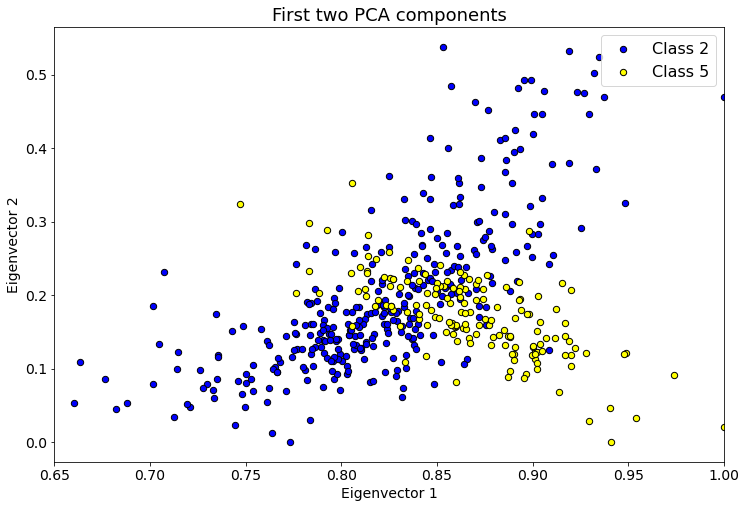

In [ ]:
fig,ax = plt.subplots(1, figsize=(12, 8))

comps = 3 # number PCA comps
clist = ['r', 'b', 'g', 'orange', 'yellow']
X_reduced1 = PCA(n_components=comps).fit_transform(class1_masked_flat)
X_reduced2 = PCA(n_components=comps).fit_transform(class2_masked_flat)
X_reduced3 = PCA(n_components=comps).fit_transform(class3_masked_flat)
X_reduced4 = PCA(n_components=comps).fit_transform(class4_masked_flat)
X_reduced5 = PCA(n_components=comps).fit_transform(class5_masked_flat)
# normalize 
X_reduced1_n = (X_reduced1 - np.min(X_reduced1)) / np.ptp(X_reduced1)
X_reduced2_n = (X_reduced2 - np.min(X_reduced2)) / np.ptp(X_reduced2)
X_reduced3_n = (X_reduced3 - np.min(X_reduced3)) / np.ptp(X_reduced3)
X_reduced4_n = (X_reduced4 - np.min(X_reduced4)) / np.ptp(X_reduced4)
X_reduced5_n = (X_reduced5 - np.min(X_reduced5)) / np.ptp(X_reduced5)

# ax.scatter(X_reduced1_n[:, 0], X_reduced1_n[:, 1], c = clist[0], edgecolor='k', s=40, label ='Class 1')
ax.scatter(X_reduced2_n[:, 0], X_reduced2_n[:, 1], c = clist[1], edgecolor='k', s=40, label ='Class 2')
# ax.scatter(X_reduced3_n[:, 0], X_reduced3_n[:, 1], c = clist[2], edgecolor='k', s=40, label ='Class 3')
# ax.scatter(X_reduced4_n[:, 0], X_reduced4_n[:, 1], c = clist[3], edgecolor='k', s=40, label ='Class 4')
ax.scatter(X_reduced5_n[:, 0], X_reduced5_n[:, 1], c = clist[4], edgecolor='k', s=40, label ='Class 5')

ax.legend(fontsize=16)
ax.set_title("Cluster Visualization in PCA space", fontsize = 18)
ax.set_xlabel("Eigenvector 1", fontsize = 14)
ax.set_ylabel("Eigenvector 2", fontsize = 14)
ax.tick_params(labelsize = 14)
ax.set_xlim(0.65,1)

In [ ]:
len(class1positions)

133

[]

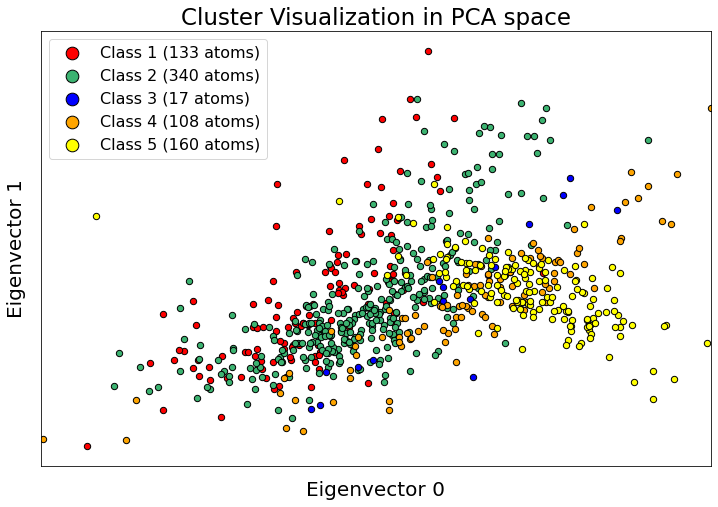

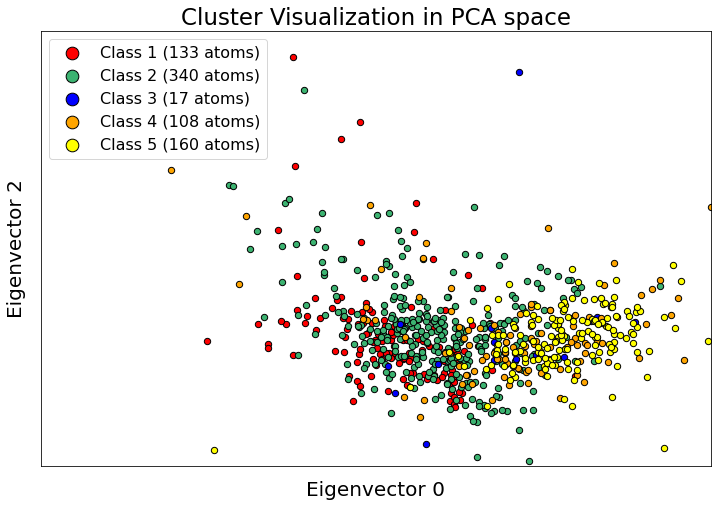

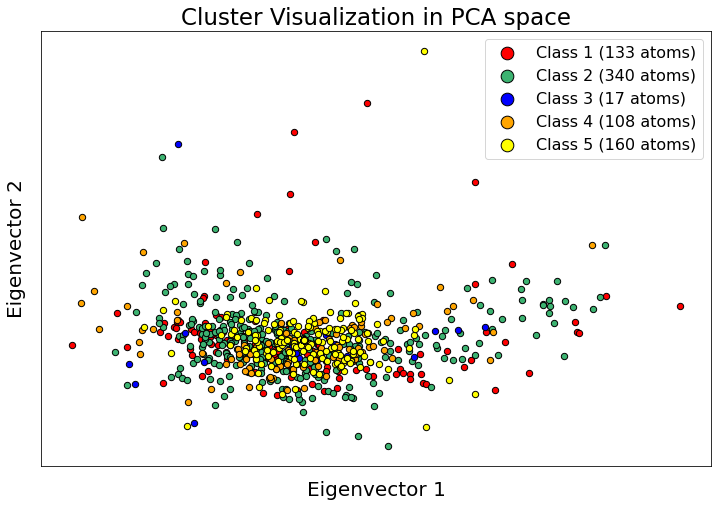

In [ ]:
fig,ax = plt.subplots(1, figsize=(12, 8))

comps = 3 # number PCA comps
axis_A, axis_B = 0, 1

clist = ['r', 'mediumseagreen', 'blue', 'orange', 'yellow', 'k']
X_reduced1 = PCA(n_components=comps).fit_transform(class1_masked_flat)
X_reduced2 = PCA(n_components=comps).fit_transform(class2_masked_flat)
X_reduced3 = PCA(n_components=comps).fit_transform(class3_masked_flat)
X_reduced4 = PCA(n_components=comps).fit_transform(class4_masked_flat)
X_reduced5 = PCA(n_components=comps).fit_transform(class5_masked_flat)

ax.scatter(X_reduced1[:, axis_A], X_reduced1[:, axis_B], c = clist[0], edgecolor='k', s=40, label ='Class 1 ({} atoms)'.format(len(class1positions)))
ax.scatter(X_reduced2[:, axis_A], X_reduced2[:, axis_B], c = clist[1], edgecolor='k', s=40, label ='Class 2 ({} atoms)'.format(len(class2positions)))
ax.scatter(X_reduced3[:, axis_A], X_reduced3[:, axis_B], c = clist[2], edgecolor='k', s=40, label ='Class 3 ({} atoms)'.format(len(class3positions)))
ax.scatter(X_reduced4[:, axis_A], X_reduced4[:, axis_B], c = clist[3], edgecolor='k', s=40, label ='Class 4 ({} atoms)'.format(len(class4positions)))
ax.scatter(X_reduced5[:, axis_A], X_reduced5[:, axis_B], c = clist[4], edgecolor='k', s=40, label ='Class 5 ({} atoms)'.format(len(class5positions)))

ax.legend(fontsize=16, markerscale = 2)
ax.set_title("Cluster Visualization in PCA space", fontsize = 23)
ax.set_xlabel("Eigenvector {}".format(axis_A), fontsize = 20, labelpad = 15)
ax.set_ylabel("Eigenvector {}".format(axis_B), fontsize = 20, labelpad = 15)
plt.setp([ax], xticks=[], yticks=[])
# ax.tick_params(labelsize = 14)
ax.set_xlim(2E-11, 4.1E-11)


fig,ax = plt.subplots(1, figsize=(12, 8))

comps = 3 # number PCA comps
axis_A, axis_B = 0, 2

clist = ['r', 'mediumseagreen', 'blue', 'orange', 'yellow', 'k']
X_reduced1 = PCA(n_components=comps).fit_transform(class1_masked_flat)
X_reduced2 = PCA(n_components=comps).fit_transform(class2_masked_flat)
X_reduced3 = PCA(n_components=comps).fit_transform(class3_masked_flat)
X_reduced4 = PCA(n_components=comps).fit_transform(class4_masked_flat)
X_reduced5 = PCA(n_components=comps).fit_transform(class5_masked_flat)

ax.scatter(X_reduced1[:, axis_A], X_reduced1[:, axis_B], c = clist[0], edgecolor='k', s=40, label ='Class 1 ({} atoms)'.format(len(class1positions)))
ax.scatter(X_reduced2[:, axis_A], X_reduced2[:, axis_B], c = clist[1], edgecolor='k', s=40, label ='Class 2 ({} atoms)'.format(len(class2positions)))
ax.scatter(X_reduced3[:, axis_A], X_reduced3[:, axis_B], c = clist[2], edgecolor='k', s=40, label ='Class 3 ({} atoms)'.format(len(class3positions)))
ax.scatter(X_reduced4[:, axis_A], X_reduced4[:, axis_B], c = clist[3], edgecolor='k', s=40, label ='Class 4 ({} atoms)'.format(len(class4positions)))
ax.scatter(X_reduced5[:, axis_A], X_reduced5[:, axis_B], c = clist[4], edgecolor='k', s=40, label ='Class 5 ({} atoms)'.format(len(class5positions)))

ax.legend(fontsize=16, markerscale = 2)
ax.set_title("Cluster Visualization in PCA space", fontsize = 23)
ax.set_xlabel("Eigenvector {}".format(axis_A), fontsize = 20, labelpad = 15)
ax.set_ylabel("Eigenvector {}".format(axis_B), fontsize = 20, labelpad = 15)
plt.setp([ax], xticks=[], yticks=[])
# ax.tick_params(labelsize = 14)
ax.set_xlim(1.5E-11, 4.1E-11)
ax.set_ylim(-0.65E-11, 1.5E-11)


fig,ax = plt.subplots(1, figsize=(12, 8))

comps = 3 # number PCA comps
axis_A, axis_B = 1, 2

clist = ['r', 'mediumseagreen', 'blue', 'orange', 'yellow', 'k']
X_reduced1 = PCA(n_components=comps).fit_transform(class1_masked_flat)
X_reduced2 = PCA(n_components=comps).fit_transform(class2_masked_flat)
X_reduced3 = PCA(n_components=comps).fit_transform(class3_masked_flat)
X_reduced4 = PCA(n_components=comps).fit_transform(class4_masked_flat)
X_reduced5 = PCA(n_components=comps).fit_transform(class5_masked_flat)

ax.scatter(X_reduced1[:, axis_A], X_reduced1[:, axis_B], c = clist[0], edgecolor='k', s=40, label ='Class 1 ({} atoms)'.format(len(class1positions)))
ax.scatter(X_reduced2[:, axis_A], X_reduced2[:, axis_B], c = clist[1], edgecolor='k', s=40, label ='Class 2 ({} atoms)'.format(len(class2positions)))
ax.scatter(X_reduced3[:, axis_A], X_reduced3[:, axis_B], c = clist[2], edgecolor='k', s=40, label ='Class 3 ({} atoms)'.format(len(class3positions)))
ax.scatter(X_reduced4[:, axis_A], X_reduced4[:, axis_B], c = clist[3], edgecolor='k', s=40, label ='Class 4 ({} atoms)'.format(len(class4positions)))
ax.scatter(X_reduced5[:, axis_A], X_reduced5[:, axis_B], c = clist[4], edgecolor='k', s=40, label ='Class 5 ({} atoms)'.format(len(class5positions)))

ax.legend(fontsize=16, markerscale = 2)
ax.set_title("Cluster Visualization in PCA space", fontsize = 23)
ax.set_xlabel("Eigenvector {}".format(axis_A), fontsize = 20, labelpad = 15)
ax.set_ylabel("Eigenvector {}".format(axis_B), fontsize = 20, labelpad = 15)
plt.setp([ax], xticks=[], yticks=[])
# ax.tick_params(labelsize = 14)
# ax.set_xlim(2E-11, 4.1E-11)


First two modes (0 and 1) show the clustering the best, I think

<font size = 6>`Big Fig v2 with PCA clustering`</font>

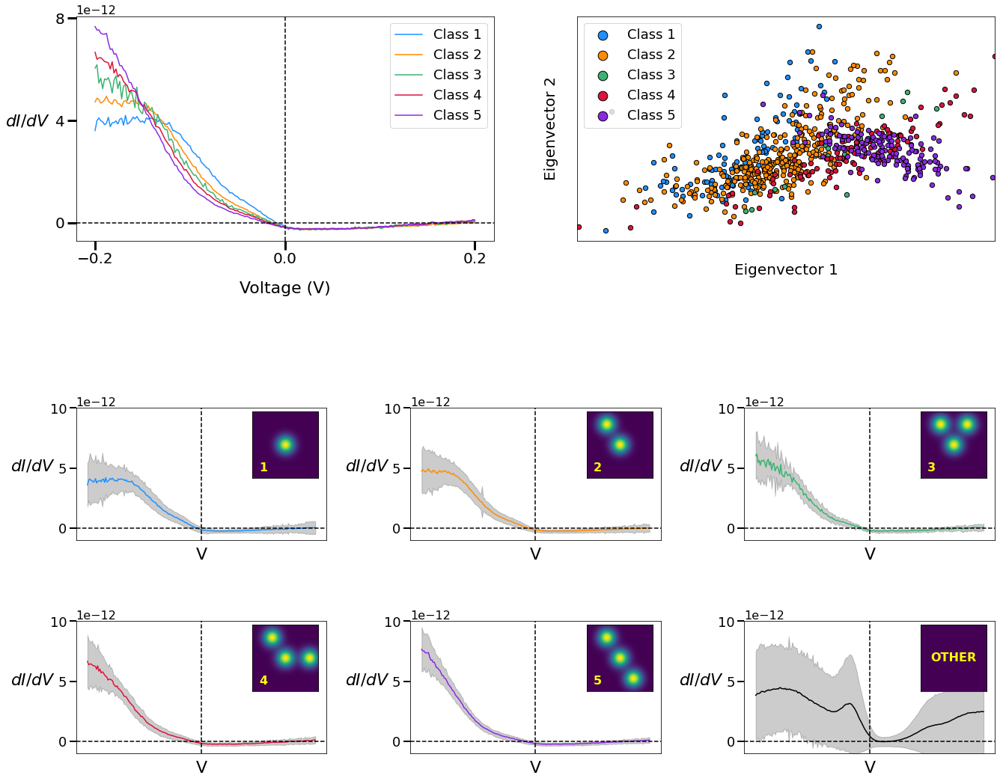

In [ ]:
colorlist = ['dodgerblue', 'darkorange', 'mediumseagreen', 'crimson', 'blueviolet', 'k']

plt.figure(figsize = (22,16))

gs = gridspec.GridSpec(3,6,hspace = 0.5, wspace = 1, height_ratios = [1.7,1,1])
ax00 = plt.subplot(gs[0,0:3])
ax01 = plt.subplot(gs[0,3:6])
ax1 = plt.subplot(gs[1,0:2])
ax2 = plt.subplot(gs[1,2:4])
ax3 = plt.subplot(gs[1,4:6])
ax4 = plt.subplot(gs[2,0:2])
ax5 = plt.subplot(gs[2,2:4])
ax6 = plt.subplot(gs[2,4:6])

ax1.plot(z_axis,class1_mean, label = "Class 1", color = colorlist[0])
ax1.fill_between(z_axis, class1_mean-class1_stdev, class1_mean+class1_stdev, color = 'k', alpha = 0.2)
ax2.plot(z_axis,class2_mean, label = "Class 2", color = colorlist[1])
ax2.fill_between(z_axis, class2_mean-class2_stdev, class2_mean+class2_stdev, color = 'k', alpha = 0.2)
ax3.plot(z_axis,class3_mean, label = "Class 3", color = colorlist[2])
ax3.fill_between(z_axis, class3_mean-class3_stdev, class3_mean+class3_stdev, color = 'k', alpha = 0.2)
ax4.plot(z_axis,class4_mean, label = "Class 4", color = colorlist[3])
ax4.fill_between(z_axis, class4_mean-class4_stdev, class4_mean+class4_stdev, color = 'k', alpha = 0.2)
ax5.plot(z_axis,class5_mean, label = "Class 5", color = colorlist[4])
ax5.fill_between(z_axis, class5_mean-class5_stdev, class5_mean+class5_stdev, color = 'k', alpha = 0.2)


otheratoms_spec_mean = np.mean(otheratoms_spec, axis = 0)
otheratoms_spec_std = np.std(otheratoms_spec, axis = 0)


ax6.plot(z_axis,otheratoms_spec_mean, label = "Other", color = colorlist[5])
ax6.fill_between(z_axis, otheratoms_spec_mean-otheratoms_spec_std, otheratoms_spec_mean+otheratoms_spec_std, color = 'k', alpha = 0.2)

axs = [ax1,ax2,ax3,ax4,ax5, ax6]
ylim1, ylim2 = -0.1E-11,1E-11
for ii in range(len(axs)):
  axs[ii].set_xlabel('V', size = 22, labelpad = 10)
  axs[ii].set_ylabel('$dI/dV$', size = 22, rotation = 0, labelpad = 22)
  axs[ii].axhline(0, ls = '--', c='k')
  axs[ii].axvline(0, ls = '--', c='k')
  axs[ii].set_ylim(ylim1, ylim2)
  axs[ii].tick_params(labelsize = 18, width = 2, size = 9)
  axs[ii].yaxis.get_offset_text().set(size=16)



inset1 = inset_axes(ax1, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax1.transAxes)
inset2 = inset_axes(ax2, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax2.transAxes)
inset3 = inset_axes(ax3, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax3.transAxes)
inset4 = inset_axes(ax4, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax4.transAxes)
inset5 = inset_axes(ax5, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax5.transAxes)
inset6 = inset_axes(ax6, width ='50%', height = '50%', bbox_to_anchor = (0.1, 0, 1, 1), bbox_transform = ax6.transAxes)


try:
  inset1.imshow(atom0)
  inset2.imshow(atom0 + atom1)
  inset3.imshow(atom0 + atom1 + atom2)
  inset4.imshow(atom0 + atom1 + atom3)
  inset5.imshow(atom0 + atom1 + atom4)
  inset6.imshow(np.zeros_like(atom0))

# This try/except exists in case we start the notebook from a checkpoint, since atom0, atom1, etc are not defined with same name
except NameError:
  inset1.imshow(class1_dict[1])
  inset2.imshow(class2_dict[1])
  inset3.imshow(class3_dict[1])
  inset4.imshow(class4_dict[1])
  inset5.imshow(class5_dict[1])
  inset6.imshow(np.zeros_like(class1_dict[1]))

# Annotate insets with class number for clear identification
insets = [inset1, inset2, inset3, inset4, inset5, inset6]
for ii in range(len(insets)-1):
  insets[ii].annotate("{}".format(ii+1), (0.1,0.1), xycoords = 'axes fraction', color = 'yellow', fontsize = 16, weight ='bold')

# annotate the 'other' separately since it's a blank inset
insets[-1].annotate("OTHER", (0.5,0.5), xycoords = 'axes fraction', color = 'yellow', fontsize = 16, weight ='bold',ha='center', va = 'center')


plt.setp([inset1, inset2, inset3, inset4, inset5, inset6],xticks=[],yticks=[])


plt.setp([axs], xticks=[])


ax00.plot(z_axis,class1_mean, label = "Class 1", color = colorlist[0])
ax00.plot(z_axis,class2_mean, label = "Class 2", color = colorlist[1])
ax00.plot(z_axis,class3_mean, label = "Class 3", color = colorlist[2])
ax00.plot(z_axis,class4_mean, label = "Class 4", color = colorlist[3])
ax00.plot(z_axis,class5_mean, label = "Class 5", color = colorlist[4])
# ax0.plot(z_axis,otheratoms_spec_mean, label = "Others", color = colorlist[5])

ax00.axvline(0,c='k',ls='--')
ax00.axhline(0,c='k',ls='--')
ax00.legend(fontsize = 18);

ax00.set_xlabel('Voltage (V)', size = 22, labelpad = 20);
ax00.set_ylabel('$dI/dV$', size = 22, rotation = 0, labelpad = 36);
ax00.tick_params(labelsize = 20, size = 12, width = 3)
ax00.yaxis.get_offset_text().set(size=16)

axis_A, axis_B = 0, 1

ax01.scatter(X_reduced1[:, axis_A], X_reduced1[:, axis_B], c = colorlist[0], edgecolor='k', s=40, label ='Class 1'.format(len(class1positions)))
ax01.scatter(X_reduced2[:, axis_A], X_reduced2[:, axis_B], c = colorlist[1], edgecolor='k', s=40, label ='Class 2'.format(len(class2positions)))
ax01.scatter(X_reduced3[:, axis_A], X_reduced3[:, axis_B], c = colorlist[2], edgecolor='k', s=40, label ='Class 3'.format(len(class3positions)))
ax01.scatter(X_reduced4[:, axis_A], X_reduced4[:, axis_B], c = colorlist[3], edgecolor='k', s=40, label ='Class 4'.format(len(class4positions)))
ax01.scatter(X_reduced5[:, axis_A], X_reduced5[:, axis_B], c = colorlist[4], edgecolor='k', s=40, label ='Class 5'.format(len(class5positions)))

ax01.legend(fontsize=18, markerscale = 2)
# ax01.set_title("Cluster Visualization in PCA space", fontsize = 23)
ax01.set_xlabel("Eigenvector {}".format(axis_A+1), fontsize = 20, labelpad = 30)
ax01.set_ylabel("Eigenvector {}".format(axis_B+1), fontsize = 20, labelpad = 25)
ax01.set_xlim(2E-11, 4.1E-11)
plt.setp([ax01], xticks=[], yticks=[])

ax00.set_xticks([z_axis.min(),0, z_axis.max()])
ax00.set_yticks([0,4E-12, 8E-12])



box00 = ax00.get_position()
box00.y0 = box00.y0 + 0.1
box00.y1 = box00.y1 + 0.1
ax00.set_position(box00)

box01 = ax01.get_position()
box01.y0 = box01.y0 + 0.1
box01.y1 = box01.y1 + 0.1
ax01.set_position(box01)

<font size = 6> And with SUBclasses </font>

[]

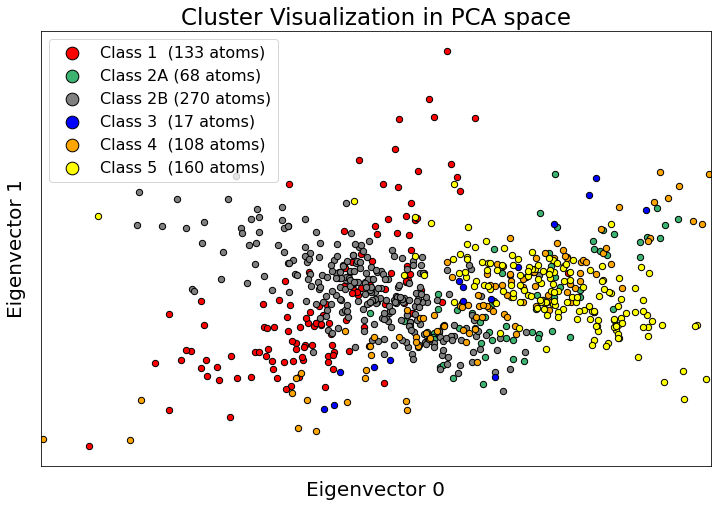

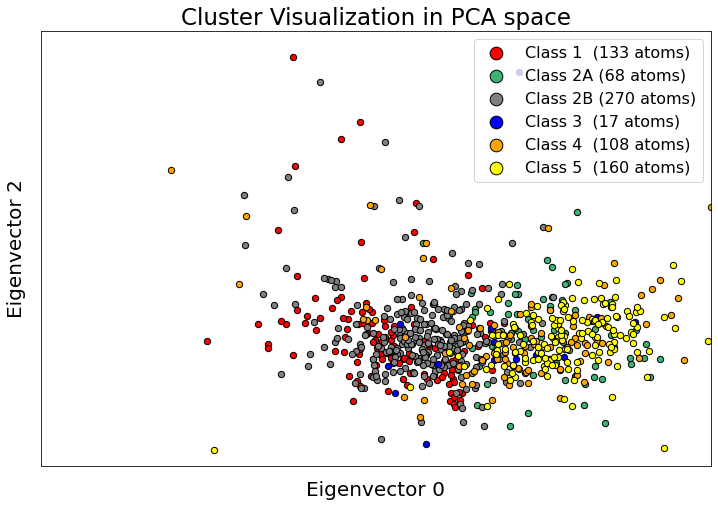

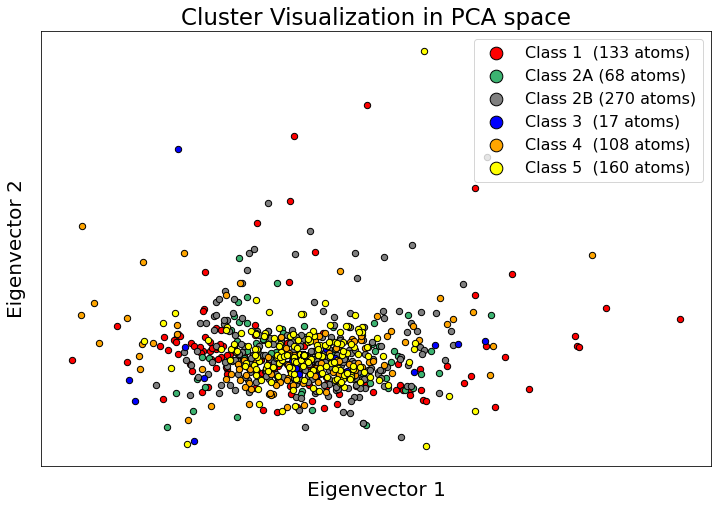

In [ ]:
fig,ax = plt.subplots(1, figsize=(12, 8))

comps = 3 # number PCA comps
axis_A, axis_B = 0, 1

clist = ['r', 'b', 'mediumseagreen', 'orange', 'yellow', 'gray']
X_reduced1 = PCA(n_components=comps).fit_transform(class1_masked_flat)
X_reduced2A = PCA(n_components=comps).fit_transform(class2A_masked_flat)
X_reduced2B = PCA(n_components=comps).fit_transform(class2B_masked_flat)
X_reduced3 = PCA(n_components=comps).fit_transform(class3_masked_flat)
X_reduced4 = PCA(n_components=comps).fit_transform(class4_masked_flat)
X_reduced5 = PCA(n_components=comps).fit_transform(class5_masked_flat)

ax.scatter(X_reduced1[:, axis_A], X_reduced1[:, axis_B], c = clist[0], edgecolor='k', s=40, label =  'Class 1  ({} atoms)'.format(len(class1positions)))
ax.scatter(X_reduced2A[:, axis_A], X_reduced2A[:, axis_B], c = clist[2], edgecolor='k', s=40, label ='Class 2A ({} atoms)'.format(len(Coords_C2P1_a)))
ax.scatter(X_reduced2B[:, axis_A], X_reduced2B[:, axis_B], c = clist[5], edgecolor='k', s=40, label ='Class 2B ({} atoms)'.format(len(Coords_C2P1_b)))
ax.scatter(X_reduced3[:, axis_A], X_reduced3[:, axis_B], c = clist[1], edgecolor='k', s=40, label =  'Class 3  ({} atoms)'.format(len(class3positions)))
ax.scatter(X_reduced4[:, axis_A], X_reduced4[:, axis_B], c = clist[3], edgecolor='k', s=40, label =  'Class 4  ({} atoms)'.format(len(class4positions)))
ax.scatter(X_reduced5[:, axis_A], X_reduced5[:, axis_B], c = clist[4], edgecolor='k', s=40, label =  'Class 5  ({} atoms)'.format(len(class5positions)))

ax.legend(fontsize=16, markerscale = 2)
ax.set_title("Cluster Visualization in PCA space", fontsize = 23)
ax.set_xlabel("Eigenvector {}".format(axis_A), fontsize = 20, labelpad = 15)
ax.set_ylabel("Eigenvector {}".format(axis_B), fontsize = 20, labelpad = 15)
ax.tick_params(labelsize = 14)
ax.set_xlim(2E-11, 4E-11)
plt.setp([ax], xticks = [], yticks = [])
#####################################################

fig,ax = plt.subplots(1, figsize=(12, 8))

comps = 3 # number PCA comps
axis_A, axis_B = 0, 2

clist = ['r', 'b', 'mediumseagreen', 'orange', 'yellow', 'gray']
X_reduced1 = PCA(n_components=comps).fit_transform(class1_masked_flat)
X_reduced2A = PCA(n_components=comps).fit_transform(class2A_masked_flat)
X_reduced2B = PCA(n_components=comps).fit_transform(class2B_masked_flat)
X_reduced3 = PCA(n_components=comps).fit_transform(class3_masked_flat)
X_reduced4 = PCA(n_components=comps).fit_transform(class4_masked_flat)
X_reduced5 = PCA(n_components=comps).fit_transform(class5_masked_flat)

ax.scatter(X_reduced1[:, axis_A], X_reduced1[:, axis_B], c = clist[0], edgecolor='k', s=40, label =  'Class 1  ({} atoms)'.format(len(class1positions)))
ax.scatter(X_reduced2A[:, axis_A], X_reduced2A[:, axis_B], c = clist[2], edgecolor='k', s=40, label ='Class 2A ({} atoms)'.format(len(Coords_C2P1_a)))
ax.scatter(X_reduced2B[:, axis_A], X_reduced2B[:, axis_B], c = clist[5], edgecolor='k', s=40, label ='Class 2B ({} atoms)'.format(len(Coords_C2P1_b)))
ax.scatter(X_reduced3[:, axis_A], X_reduced3[:, axis_B], c = clist[1], edgecolor='k', s=40, label =  'Class 3  ({} atoms)'.format(len(class3positions)))
ax.scatter(X_reduced4[:, axis_A], X_reduced4[:, axis_B], c = clist[3], edgecolor='k', s=40, label =  'Class 4  ({} atoms)'.format(len(class4positions)))
ax.scatter(X_reduced5[:, axis_A], X_reduced5[:, axis_B], c = clist[4], edgecolor='k', s=40, label =  'Class 5  ({} atoms)'.format(len(class5positions)))

ax.legend(fontsize=16, markerscale = 2)
ax.set_title("Cluster Visualization in PCA space", fontsize = 23)
ax.set_xlabel("Eigenvector {}".format(axis_A), fontsize = 20, labelpad = 15)
ax.set_ylabel("Eigenvector {}".format(axis_B), fontsize = 20, labelpad = 15)
ax.tick_params(labelsize = 14)
ax.set_xlim(1.5E-11, 4.1E-11)
ax.set_ylim(-0.65E-11, 1.5E-11)
plt.setp([ax], xticks = [], yticks = [])

######################################################

fig,ax = plt.subplots(1, figsize=(12, 8))

comps = 3 # number PCA comps
axis_A, axis_B = 1, 2

clist = ['r', 'b', 'mediumseagreen', 'orange', 'yellow', 'gray']
X_reduced1 = PCA(n_components=comps).fit_transform(class1_masked_flat)
X_reduced2A = PCA(n_components=comps).fit_transform(class2A_masked_flat)
X_reduced2B = PCA(n_components=comps).fit_transform(class2B_masked_flat)
X_reduced3 = PCA(n_components=comps).fit_transform(class3_masked_flat)
X_reduced4 = PCA(n_components=comps).fit_transform(class4_masked_flat)
X_reduced5 = PCA(n_components=comps).fit_transform(class5_masked_flat)

ax.scatter(X_reduced1[:, axis_A], X_reduced1[:, axis_B], c = clist[0], edgecolor='k', s=40, label =  'Class 1  ({} atoms)'.format(len(class1positions)))
ax.scatter(X_reduced2A[:, axis_A], X_reduced2A[:, axis_B], c = clist[2], edgecolor='k', s=40, label ='Class 2A ({} atoms)'.format(len(Coords_C2P1_a)))
ax.scatter(X_reduced2B[:, axis_A], X_reduced2B[:, axis_B], c = clist[5], edgecolor='k', s=40, label ='Class 2B ({} atoms)'.format(len(Coords_C2P1_b)))
ax.scatter(X_reduced3[:, axis_A], X_reduced3[:, axis_B], c = clist[1], edgecolor='k', s=40, label =  'Class 3  ({} atoms)'.format(len(class3positions)))
ax.scatter(X_reduced4[:, axis_A], X_reduced4[:, axis_B], c = clist[3], edgecolor='k', s=40, label =  'Class 4  ({} atoms)'.format(len(class4positions)))
ax.scatter(X_reduced5[:, axis_A], X_reduced5[:, axis_B], c = clist[4], edgecolor='k', s=40, label =  'Class 5  ({} atoms)'.format(len(class5positions)))

ax.legend(fontsize=16, markerscale = 2)
ax.set_title("Cluster Visualization in PCA space", fontsize = 23)
ax.set_xlabel("Eigenvector {}".format(axis_A), fontsize = 20, labelpad = 15)
ax.set_ylabel("Eigenvector {}".format(axis_B), fontsize = 20, labelpad = 15)
ax.tick_params(labelsize = 14)
# ax.set_xlim(2E-11, 4E-11)
plt.setp([ax], xticks = [], yticks = [])


(2e-11, 4e-11)

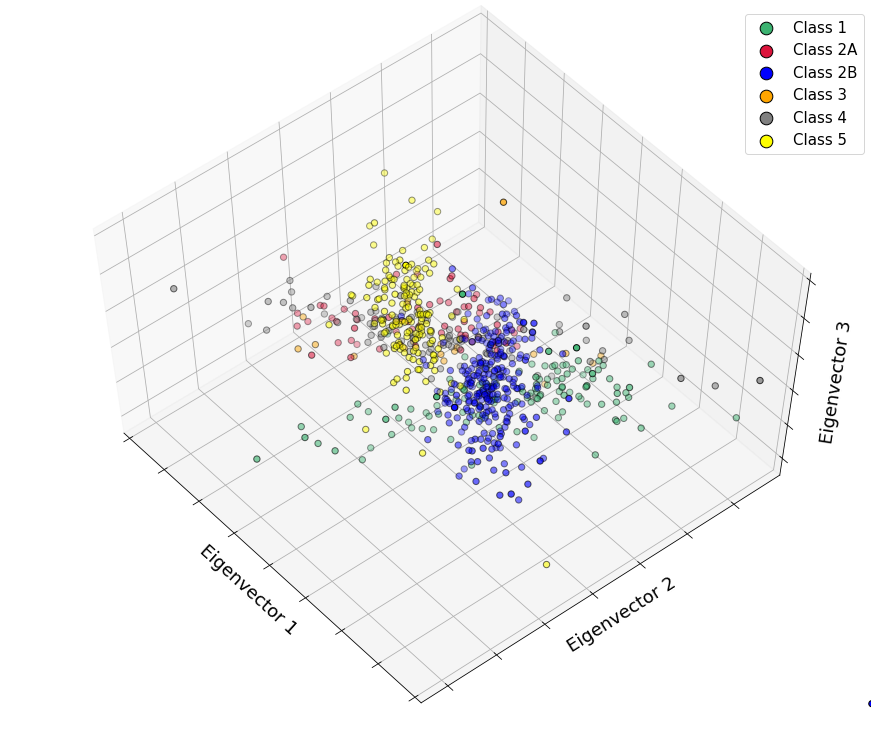

In [ ]:
# To getter a better understanding of interaction of the dimensions
# plot the first three PCA dimensions
fig = plt.figure(1, figsize=(12, 10))
ax = Axes3D(fig, elev=60, azim=140)

comps = 3

X_reduced1 = PCA(n_components=comps).fit_transform(class1_masked_flat)
X_reduced2A = PCA(n_components=comps).fit_transform(class2A_masked_flat)
X_reduced2B = PCA(n_components=comps).fit_transform(class2B_masked_flat)
X_reduced3 = PCA(n_components=comps).fit_transform(class3_masked_flat)
X_reduced4 = PCA(n_components=comps).fit_transform(class4_masked_flat)
X_reduced5 = PCA(n_components=comps).fit_transform(class5_masked_flat)

# Oh no, we must normalize EACH component!!! not the whole set of 3 at once.
# OR just don't normalize at all. It depends on how many components we have. Bleh
X_reduced1_1n = (X_reduced1 - np.min(X_reduced1)) / np.ptp(X_reduced1)
X_reduced2A_n = (X_reduced2A - np.min(X_reduced2A)) / np.ptp(X_reduced2A)
X_reduced2B_n = (X_reduced2B - np.min(X_reduced2B)) / np.ptp(X_reduced2B)
X_reduced3_n = (X_reduced3 - np.min(X_reduced3)) / np.ptp(X_reduced3)
X_reduced4_n = (X_reduced4 - np.min(X_reduced4)) / np.ptp(X_reduced4)
X_reduced5_n = (X_reduced5 - np.min(X_reduced5)) / np.ptp(X_reduced5)

ax.scatter(X_reduced1[:, 0], X_reduced1[:, 1], X_reduced1[:, 2], c= 'mediumseagreen',
           cmap=plt.cm.Set1, edgecolor='k', s=40, label ='Class 1')
ax.scatter(X_reduced2A[:, 0], X_reduced2A[:, 1], X_reduced2A[:, 2], c='crimson',
           cmap=plt.cm.Set1, edgecolor='k', s=40, label ='Class 2A')
ax.scatter(X_reduced2B[:, 0], X_reduced2B[:, 1], X_reduced2B[:, 2], c='b',
           cmap=plt.cm.Set1, edgecolor='k', s=40, label ='Class 2B')
ax.scatter(X_reduced3[:, 0], X_reduced3[:, 1], X_reduced3[:, 2], c= 'orange',
           cmap=plt.cm.Set1, edgecolor='k', s=40, label ='Class 3')
ax.scatter(X_reduced4[:, 0], X_reduced4[:, 1], X_reduced4[:, 2], c='gray',
           cmap=plt.cm.Set1, edgecolor='k', s=40, label ='Class 4')
ax.scatter(X_reduced5[:, 0], X_reduced5[:, 1], X_reduced5[:, 2], c= 'yellow',
           cmap=plt.cm.Set1, edgecolor='k', s=40, label ='Class 5')

ax.legend(fontsize=15, markerscale = 2)
# ax.set_title("First three PCA comps")
ax.set_xlabel("Eigenvector 1", fontsize = 18)
ax.w_xaxis.set_ticklabels([])
ax.set_ylabel("Eigenvector 2", fontsize = 18)
ax.w_yaxis.set_ticklabels([])
ax.set_zlabel("Eigenvector 3", fontsize = 18)
ax.w_zaxis.set_ticklabels([])

ax.set_xlim(2E-11, 4E-11)

[]

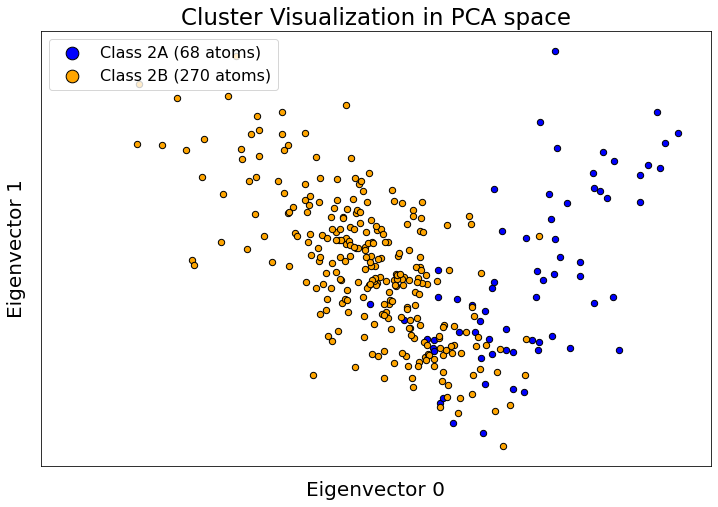

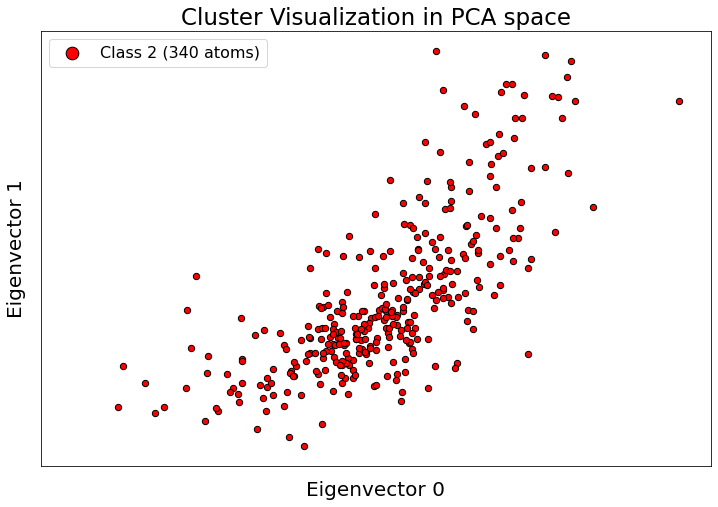

In [ ]:
# JUST class 2

fig,ax = plt.subplots(1, figsize=(12, 8))

comps = 3 # number PCA comps
axis_A, axis_B = 0, 1

clist = ['r', 'b', 'mediumseagreen', 'orange', 'yellow', 'gray']
X_reduced2A = PCA(n_components=comps).fit_transform(class2A_masked_flat)
X_reduced2B = PCA(n_components=comps).fit_transform(class2B_masked_flat)

ax.scatter(X_reduced2A[:, axis_A], X_reduced2A[:, axis_B], c = clist[1], edgecolor='k', s=40, label ='Class 2A ({} atoms)'.format(len(Coords_C2P1_a)))
ax.scatter(X_reduced2B[:, axis_A], X_reduced2B[:, axis_B], c = clist[3], edgecolor='k', s=40, label ='Class 2B ({} atoms)'.format(len(Coords_C2P1_b)))

ax.legend(fontsize=16, markerscale = 2,  loc = 'upper left')
ax.set_title("Cluster Visualization in PCA space", fontsize = 23)
ax.set_xlabel("Eigenvector {}".format(axis_A), fontsize = 20, labelpad = 15)
ax.set_ylabel("Eigenvector {}".format(axis_B), fontsize = 20, labelpad = 15)
ax.tick_params(labelsize = 14)
ax.set_xlim(2E-11, 4E-11)
plt.setp([ax], xticks = [], yticks = [])

fig,ax = plt.subplots(1, figsize=(12, 8))

X_reduced2 = PCA(n_components=comps).fit_transform(class2_masked_flat)
ax.scatter(X_reduced2[:, axis_A], X_reduced2[:, axis_B], c = clist[0], edgecolor='k', s=40, label ='Class 2 ({} atoms)'.format(len(class2positions)))
ax.legend(fontsize=16, markerscale = 2, loc = 'upper left')
ax.set_title("Cluster Visualization in PCA space", fontsize = 23)
ax.set_xlabel("Eigenvector {}".format(axis_A), fontsize = 20, labelpad = 15)
ax.set_ylabel("Eigenvector {}".format(axis_B), fontsize = 20, labelpad = 15)
ax.tick_params(labelsize = 14)
ax.set_xlim(2E-11, 4E-11)
plt.setp([ax], xticks = [], yticks = [])

Interesting, we certainly separated this class further

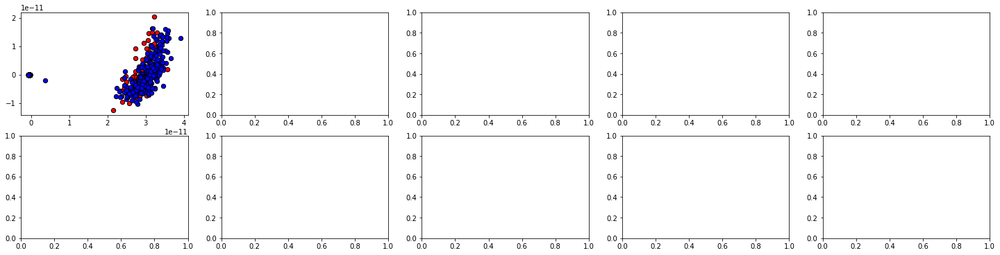

In [ ]:

comps = 3 # number PCA comps

# Viewing eigenvector axes (which two dimensions to view in 2D)
axis_A = 0
axis_B = 1

clist = ['r', 'b', 'g', 'orange', 'yellow', 'k']
X_reduced1 = PCA(n_components=comps).fit_transform(class1_masked_flat)
X_reduced2 = PCA(n_components=comps).fit_transform(class2_masked_flat)
X_reduced3 = PCA(n_components=comps).fit_transform(class3_masked_flat)
X_reduced4 = PCA(n_components=comps).fit_transform(class4_masked_flat)
X_reduced5 = PCA(n_components=comps).fit_transform(class5_masked_flat)

X_list = [X_reduced1, X_reduced2, X_reduced3, X_reduced4, X_reduced5]

num_classes = 5
uniquepairs = num_classes*(num_classes-1)/2

numplotsinrow = 5
numrows = int(uniquepairs/numplotsinrow)
numcols = int(uniquepairs/numrows)

fig,ax = plt.subplots(numrows, numcols, figsize = (5*numcols, 3*numrows))
# gs = gridspec.GridSpec(numrows, numcols)
ax[0,0].scatter(X_list[0][:, axis_A], X_list[0][:, axis_B], c = clist[0], edgecolor='k', s=40, label ='Class 1')
ax[0,0].scatter(X_list[1][:, axis_A], X_list[1][:, axis_B], c = clist[1], edgecolor='k', s=40, label ='Class 2')



# ax.legend(fontsize=16)
# ax.set_title("First two PCA components", fontsize = 18)
# ax.set_xlabel("Eigenvector {}".format(axis_A), fontsize = 14)
# ax.set_ylabel("Eigenvector {}".format(axis_B), fontsize = 14)
# ax.tick_params(labelsize = 14)
# ax.set_xlim(2E-11, 4E-11)


In [ ]:

comps = 3 # number PCA comps

# Viewing eigenvector axes (which two dimensions to view in 2D)
axis_A = 0
axis_B = 1

clist = ['r', 'b', 'g', 'orange', 'yellow', 'k']
X_reduced1 = PCA(n_components=comps).fit_transform(class1_masked_flat)
X_reduced2A = PCA(n_components=comps).fit_transform(class2A_masked_flat)
X_reduced2B = PCA(n_components=comps).fit_transform(class2B_masked_flat)
X_reduced3 = PCA(n_components=comps).fit_transform(class3_masked_flat)
X_reduced4 = PCA(n_components=comps).fit_transform(class4_masked_flat)
X_reduced5 = PCA(n_components=comps).fit_transform(class5_masked_flat)


ax.scatter(X_reduced1[:, axis_A], X_reduced1[:, axis_B], c = clist[0], edgecolor='k', s=40, label ='Class 1')
ax.scatter(X_reduced2A[:, axis_A], X_reduced2A[:, axis_B], c = clist[1], edgecolor='k', s=40, label ='Class 2A')
ax.scatter(X_reduced2B[:, axis_A], X_reduced2B[:, axis_B], c = clist[2], edgecolor='k', s=40, label ='Class 2B')
ax.scatter(X_reduced3[:, axis_A], X_reduced3[:, axis_B], c = clist[3], edgecolor='k', s=40, label ='Class 3')
ax.scatter(X_reduced4[:, axis_A], X_reduced4[:, axis_B], c = clist[4], edgecolor='k', s=40, label ='Class 4')
ax.scatter(X_reduced5[:, axis_A], X_reduced5[:, axis_B], c = clist[5], edgecolor='k', s=40, label ='Class 5')

ax.legend(fontsize=16)
ax.set_title("First two PCA components", fontsize = 18)
ax.set_xlabel("Eigenvector {}".format(axis_A), fontsize = 14)
ax.set_ylabel("Eigenvector {}".format(axis_B), fontsize = 14)
ax.tick_params(labelsize = 14)
# ax.set_xlim(2E-11, 4E-11)


(16384, 3)

## k-means clustering (wip)
* on structural classes 
* Am I using the correct masked object?
* Or should I use an object with smaller size and pixels only at the selected atoms ? (how is that done anyway)


In [ ]:
from sklearn.cluster import KMeans

In [ ]:
kmeans2 = KMeans(n_clusters=3, random_state=0).fit(X_reduced2)

# do we need to count 1 cluster as all the zeros? I hope not.

In [ ]:
# X_reduced2_128 = np.reshape(X_reduced2, (128,128))
X_reduced2[5]

array([-7.3486134e-13,  9.5433322e-15, -1.6086725e-15], dtype=float32)

## GMM on class 2: variable crop size
* double window length (4x the area) for now

First, create adatom image object of only class 2 adatoms 
( actually I think this is wrong to do, as this gets rid of other neighbors not in class 2, just use the original adatom image )
* Recreating the adatom filtered image (of all adatoms) from previously - it was not carried over as a saved variable, but can still be computed

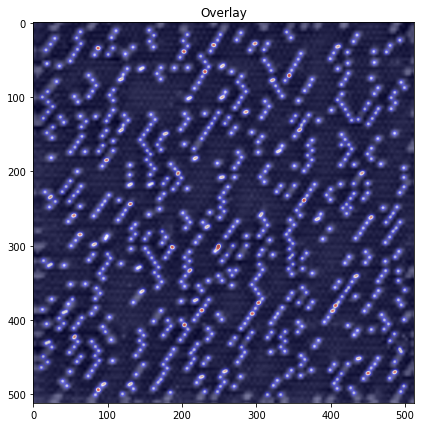

In [ ]:
resized = 512
topo_f_n_resized = resize(topo_f_n, (resized,resized))

arrsize = resized  # The same size as the image above
atomsize = 10
amplitude = 1

adatoms = np.zeros((arrsize,arrsize))

for kk in range(len(com)):
  adatoms += gauss2d_atom(com[kk][1],com[kk][0], amp = amplitude, sigma = atomsize, xlen = arrsize, ylen=arrsize, numpix = arrsize)

f,a = plt.subplots(1,figsize = (7,7))
a.imshow(topo_f_n_resized, cmap = 'gray')
a.imshow(adatoms, alpha = 0.5, cmap = 'seismic')
a.set_title('Overlay');

In [ ]:
class2coords = np.zeros((len(class2positions), 2))
for ii in range(len(class2positions)):
  class2coords[ii,0] = class2positions[ii][1]
  class2coords[ii,1] = class2positions[ii][0]

In [ ]:
# print(len(Spectra_C2P1_a) + len(Spectra_C2P1_b))
# print(len(class2coords))

Select window size

In [ ]:
crs = 18 # size of image to crop

imgstack_3, com3 = extract_subimages(adatoms, class2coords, crs)  # Using the adatom-only image 
# imgstack_3, com3 = extract_subimages(adatoms, class2coords, crs)  # Using the full topography image 

imgstack3 = np.zeros_like(imgstack_3)
for ii in range(imgstack_3.shape[0]):
  imgstack3[ii] = (imgstack_3[ii] - np.min(imgstack_3[ii]))/np.ptp(imgstack_3[ii])
imgstack3.shape

(317, 36, 36)

101

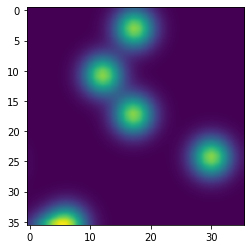

In [ ]:
plt.figure()

ii = np.random.randint(0,imgstack3.shape[0])
plt.imshow(imgstack3[ii], interpolation = 'gaussian')
ii

In [ ]:
d0, d1, d2 = imgstack3.shape
X_vec = imgstack3.reshape(d0, d1*d2)  # flatten for pca
X_vec.shape

(317, 1296)

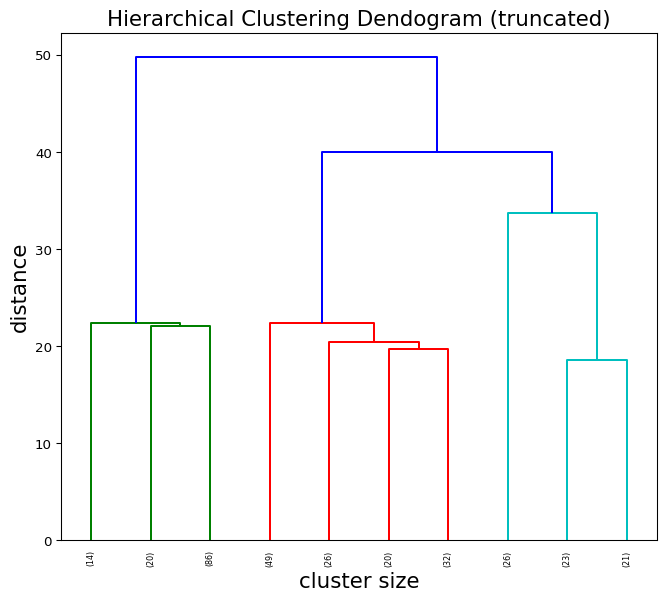

In [ ]:
Z = linkage(X_vec, method='ward')
plt.figure(figsize = (8,7), dpi = 96)
dendrogram(Z, truncate_mode='lastp', p=10, leaf_rotation=90.,leaf_font_size=6.,)
plt.title('Hierarchical Clustering Dendogram (truncated)', fontsize = 16)
plt.xlabel('cluster size', fontsize = 16)
plt.ylabel('distance', fontsize = 16)
plt.show()

(-1.0, 20.0)

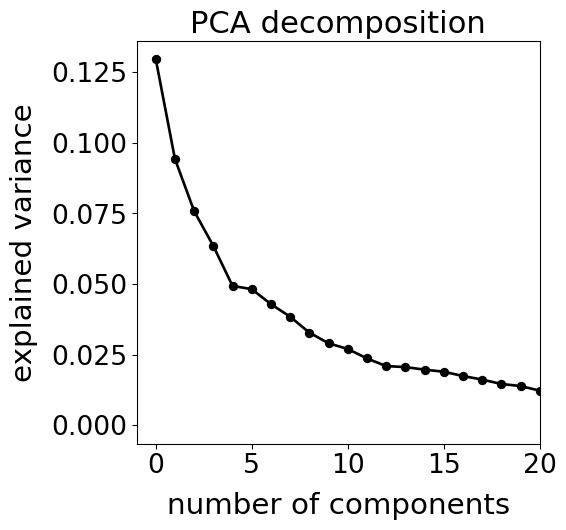

In [ ]:
pca = decomposition.PCA()
pca.fit(X_vec)
plt.figure(1, figsize=(6, 6), dpi = 96)
plt.clf()
plt.axes([.2, .2, .7, .7])
plt.plot(pca.explained_variance_ratio_,'o-', linewidth=2, c = 'black' )
# plt.axis('tight')
plt.xlabel('number of components', fontsize = 22, labelpad = 10)
plt.ylabel('explained variance', fontsize = 22, labelpad = 10)
plt.tick_params(axis='both', labelsize = 20)
plt.title("PCA decomposition", fontsize = 23)
plt.xlim(-1, 20)

In [ ]:
# There doesn't appear to be much variability with this large of a crop window. Let's just do 5 classes as an example

nc = 2
classifier = 'GMM'
# classifier = 'KMeans'


if classifier == 'GMM':
    clf = mixture.GaussianMixture(n_components=nc, covariance_type='diag', random_state = 8000).fit(X_vec)
else:
    clf = KMeans(n_clusters=nc).fit(X_vec)

class2subclasses = clf.predict(X_vec) + 1

In [ ]:
class2_1 = np.where(class2subclasses==1)[0]
class2_2 = np.where(class2subclasses==2)[0]
class2_3 = np.where(class2subclasses==3)[0]
class2_4 = np.where(class2subclasses==4)[0]
class2_5 = np.where(class2subclasses==5)[0]
# class2_6 = np.where(classes==6)[0]
# class2_7 = np.where(classes==7)[0]
# class2_8 = np.where(classes==8)[0]

* View classes by their "representative" image (which is an *average* of all images within a class)

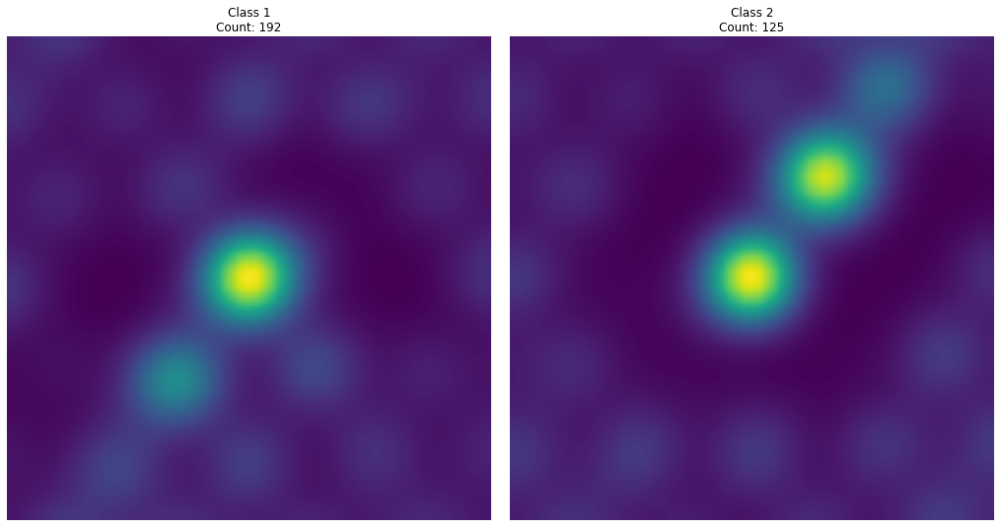

In [ ]:
cla = np.ndarray(shape=(np.amax(class2subclasses), int(crs*2), int(crs*2)))
fig = plt.figure(figsize=(18, 10))

rows = int(np.ceil(float(nc)/5))
cols = int(np.ceil(float(np.amax(class2subclasses))/rows))

gs1 = gridspec.GridSpec(rows, cols)

for i in range(np.amax(class2subclasses)):
    cl = imgstack3[class2subclasses == i + 1]
    cla[i] = np.mean(cl, axis=0)
    cla_en = np.copy(cla[i])
    ax = fig.add_subplot(gs1[i])
    ax.imshow(cla_en, Interpolation = 'Gaussian')
    
    ax.axis('off')
    ax.set_title('Class ' + str(i + 1) + '\nCount: ' + str(len(cl)))

plt.subplots_adjust(hspace=0.06, wspace=0.04)

I'm not sure what to do about this. Doesn't really show anything of interest that I can see.
* Again, does NOT appear to sort these adatoms distinctly
* Unless we use only two classes: does it actually appear to separate "closely packed" vs "sparsely packed" ?

Check the spectra! Get coordinates and then extract spectra at those coordinates

In [ ]:
# check spectra difference between these two and see if they correlate to the spectral difference obtained by PCA separation:

GMMClass2_A = np.zeros((len(class2_1),2))
GMMClass2_B = np.zeros((len(class2_2),2))


for ii in range(len(class2_1)):
  GMMClass2_A[ii,0] = com3[class2_1[ii]][0]
  GMMClass2_A[ii,1] = com3[class2_1[ii]][1]

for ii in range(len(class2_2)):
  GMMClass2_B[ii,0] = com3[class2_2[ii]][0]
  GMMClass2_B[ii,1] = com3[class2_2[ii]][1]


# GMMClass2_C = np.zeros((len(class2_3),2))
# GMMClass2_D = np.zeros((len(class2_4),2))
# GMMClass2_E = np.zeros((len(class2_5),2))

# for ii in range(len(class2_3)):
#   GMMClass2_C[ii,0] = com3[class2_3[ii]][0]
#   GMMClass2_C[ii,1] = com3[class2_3[ii]][1]

# for ii in range(len(class2_4)):
#   GMMClass2_D[ii,0] = com3[class2_4[ii]][0]
#   GMMClass2_D[ii,1] = com3[class2_4[ii]][1]

# for ii in range(len(class2_5)):
#   GMMClass2_E[ii,0] = com3[class2_5[ii]][0]
#   GMMClass2_E[ii,1] = com3[class2_5[ii]][1]

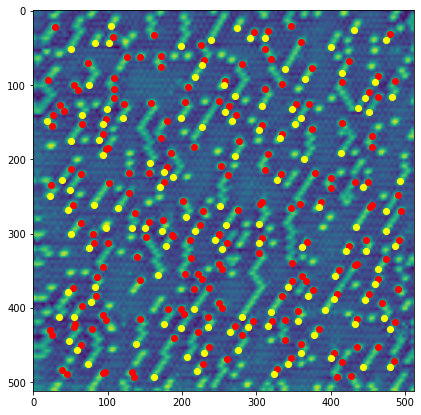

In [ ]:
plt.figure(figsize=(7,7))
plt.imshow(topo_f_n_resized)
plt.scatter(GMMClass2_A[:,1], GMMClass2_A[:,0], c= 'r')
plt.scatter(GMMClass2_B[:,1], GMMClass2_B[:,0], c= 'yellow')

In [ ]:
scalefactor

1

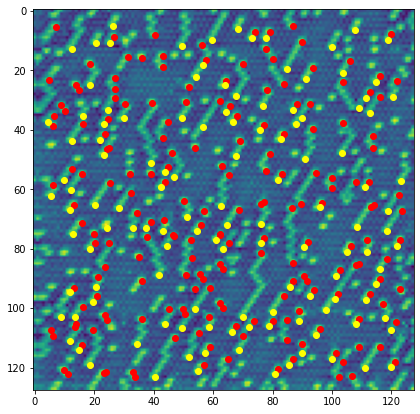

In [ ]:
# Rescale back down to 128x128 (factor of 4):
scalefactor = 4
try: 
  GMMClass2_A_128 = GMMClass2_A/scalefactor
  GMMClass2_B_128 = GMMClass2_B/scalefactor
except NameError:
  scalefactor = 4 # in case we have already defined this as something else for some reason
  GMMClass2_A_128 = GMMClass2_A/scalefactor
  GMMClass2_B_128 = GMMClass2_B/scalefactor

plt.figure(figsize=(7,7))
plt.imshow(topo_f_n)
plt.scatter(GMMClass2_A_128[:,1], GMMClass2_A_128[:,0], c= 'r')
plt.scatter(GMMClass2_B_128[:,1], GMMClass2_B_128[:,0], c= 'yellow')

# GMMClass2_C_128 = GMMClass2_C/scalefactor
# GMMClass2_D_128 = GMMClass2_D/scalefactor
# GMMClass2_E_128 = GMMClass2_E/scalefactor

In [ ]:
GMM_Spectra_Class2_A = np.zeros((len(GMMClass2_A_128), exp_cits.shape[2]))
GMM_Spectra_Class2_B = np.zeros((len(GMMClass2_B_128), exp_cits.shape[2]))

for ii in range(len(GMM_Spectra_Class2_A)):
  GMM_Spectra_Class2_A[ii] = exp_cits[int(round(GMMClass2_A_128[ii][0])), int(round(GMMClass2_A_128[ii][1]))]
for ii in range(len(GMM_Spectra_Class2_B)):
  GMM_Spectra_Class2_B[ii] = exp_cits[int(round(GMMClass2_B_128[ii][0])), int(round(GMMClass2_B_128[ii][1]))]


# GMM_Spectra_Class2_C = np.zeros((len(GMMClass2_C_128), exp_cits.shape[2]))
# GMM_Spectra_Class2_D = np.zeros((len(GMMClass2_D_128), exp_cits.shape[2]))
# GMM_Spectra_Class2_E = np.zeros((len(GMMClass2_E_128), exp_cits.shape[2]))
# for ii in range(len(GMM_Spectra_Class2_C)):
#   GMM_Spectra_Class2_C[ii] = exp_cits[int(round(GMMClass2_C_128[ii][0])), int(round(GMMClass2_C_128[ii][1]))]
# for ii in range(len(GMM_Spectra_Class2_D)):
#   GMM_Spectra_Class2_D[ii] = exp_cits[int(round(GMMClass2_D_128[ii][0])), int(round(GMMClass2_D_128[ii][1]))]
# for ii in range(len(GMM_Spectra_Class2_E)):
#   GMM_Spectra_Class2_E[ii] = exp_cits[int(round(GMMClass2_E_128[ii][0])), int(round(GMMClass2_E_128[ii][1]))]

(-5e-12, 2e-11)

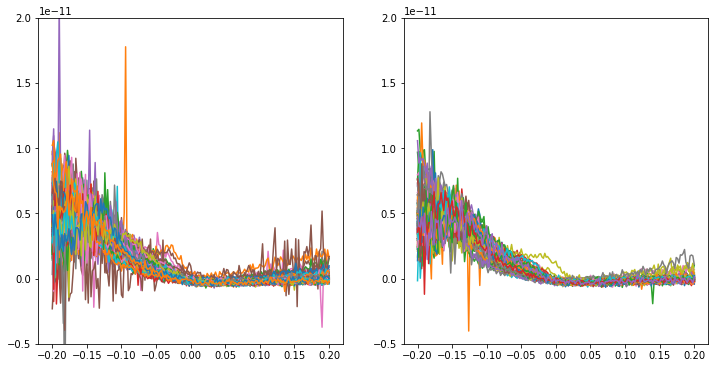

In [ ]:
fig,ax = plt.subplots(1,2,figsize=(12,6))

for ii in range(len(GMM_Spectra_Class2_A)):
  ax[0].plot(z_axis,GMM_Spectra_Class2_A[ii])
ax[0].set_ylim(-0.5E-11, 2E-11)

for ii in range(len(GMM_Spectra_Class2_B)):
  ax[1].plot(z_axis,GMM_Spectra_Class2_B[ii])
ax[1].set_ylim(-0.5E-11, 2E-11)

Average the classes as we have done previously

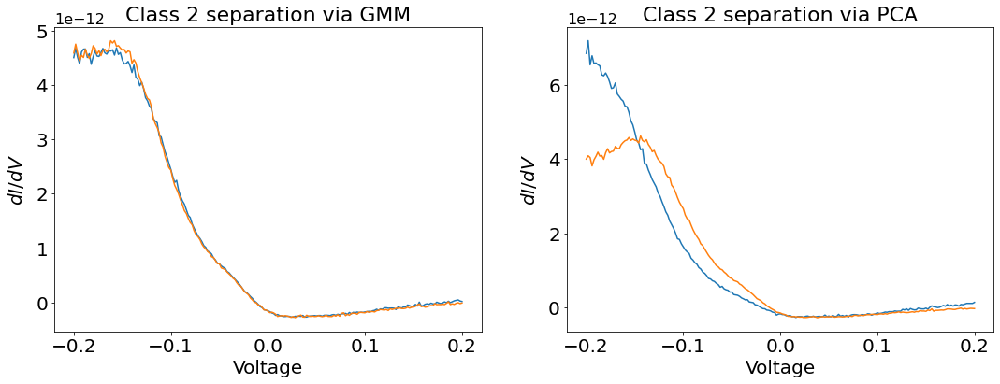

In [ ]:
GMM_Spectra_Class2_A_mean = np.mean(GMM_Spectra_Class2_A,axis=0)
GMM_Spectra_Class2_B_mean = np.mean(GMM_Spectra_Class2_B,axis=0)


# And compare to the means separated by PCA (if we don't have these variables anymore)
Spectra_C2P1_a_PCA_mean = np.mean(Spectra_C2P1_a, axis=0)
Spectra_C2P1_b_PCA_mean = np.mean(Spectra_C2P1_b, axis=0)

fig,ax = plt.subplots(1,2,figsize=(18,6))
ax[0].plot(z_axis,GMM_Spectra_Class2_A_mean)
ax[0].plot(z_axis,GMM_Spectra_Class2_B_mean)


ax[1].plot(z_axis,Spectra_C2P1_a_PCA_mean)
ax[1].plot(z_axis,Spectra_C2P1_b_PCA_mean)

ax[0].set_xlabel("Voltage", fontsize = 20)
ax[1].set_xlabel("Voltage", fontsize = 20)
ax[0].set_ylabel("$dI/dV$", fontsize = 20, labelpad = 10)
ax[1].set_ylabel("$dI/dV$", fontsize = 20, labelpad = 10)

ax[0].set_title('Class 2 separation via GMM', fontsize = 22)
ax[1].set_title('Class 2 separation via PCA', fontsize = 22)

ax[0].tick_params(labelsize = 20)
ax[1].tick_params(labelsize = 20)

ax[0].yaxis.get_offset_text().set(size=16)
ax[1].yaxis.get_offset_text().set(size=16)

# yaxis.get_offset_text().set(size=16)
# GMM_Spectra_Class2_C_mean = np.mean(GMM_Spectra_Class2_C,axis=0)
# GMM_Spectra_Class2_D_mean = np.mean(GMM_Spectra_Class2_D,axis=0)
# GMM_Spectra_Class2_E_mean = np.mean(GMM_Spectra_Class2_E,axis=0)
# ax[0].plot(z_axis,GMM_Spectra_Class2_C_mean)
# ax[0].plot(z_axis,GMM_Spectra_Class2_D_mean)
# ax[0].plot(z_axis,GMM_Spectra_Class2_E_mean)

I would say NOT a great correlation for structure-spectra relationship. Not from GMM at least.
* Ideas on why we cannot structurally subclassify this:

```
* different neighborhood size (maybe only make window slightly bigger to allow one more atom) --> Doesn't look like it. 
* Z dependence?
* strange lattice sites (need HR image to see them)
* Both Z difference and weird lattice site (site is not exactly hexagonal and actually offset in Z too because of it?)
* ...?
* Tried: 
    * different window sizes
    * KMeans vs GMM
    * number of classes 2-5 (none of classes can separate that higher dI/dV component)
* Makes me think I have used the wrong class or wrong data somewhere, but I don't think I have...
```

<font color = 'crimson'> Reminder to double check the data being used is correct </font>

In [ ]:
def center_crop(image, coordinates, size):
  
  winx, winy = coordinates[1], coordinates[0]
  xlow, xhigh = int(round(winx-size/2)), int(round(winx+size/2))
  ylow, yhigh = int(round(winy-size/2)), int(round(winy+size/2))
  cropped = image[ylow:yhigh, xlow:xhigh]
  return cropped

In [ ]:
def center_crop_pad(image, coordinates, size):
  # Pad it directly with same size as half window size 
  # so no matter what coordinate provided (even border coords), it will slice just fine.
  imagepad = np.pad(image, int(size/2)) 
  winx, winy = coordinates[1], coordinates[0]
  xlow, xhigh = int(round(winx)), int(round(winx+size))
  ylow, yhigh = int(round(winy)), int(round(winy+size))
  cropped = imagepad[ylow:yhigh, xlow:xhigh]
  return cropped

[5, 7, 8]

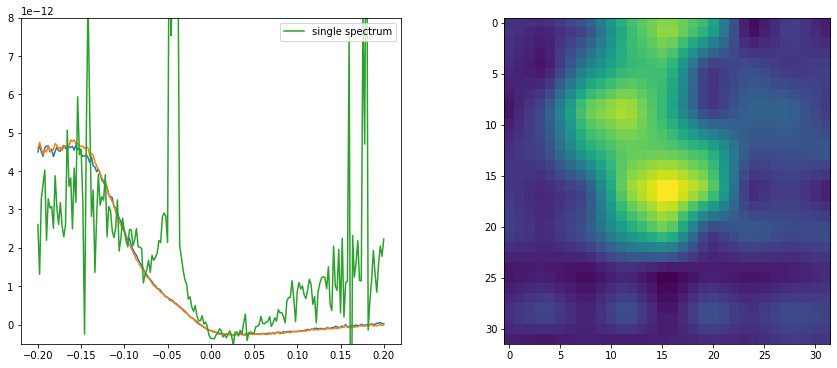

In [ ]:
ii = 14
fig,ax = plt.subplots(1,2,figsize=(15,6))
ax[0].plot(z_axis,GMM_Spectra_Class2_A_mean)
ax[0].plot(z_axis,GMM_Spectra_Class2_B_mean)
ax[0].plot(z_axis,exp_cits[int(round(class2coords[ii,1]/scalefactor)), 
                           int(round(class2coords[ii,0]/scalefactor))], 
           label = 'single spectrum')
ax[0].set_ylim(-0.5E-12, 8E-12)
ax[0].legend(loc = 'upper right')

testcrop = center_crop_pad(topo_f_n_resized, class2coords[ii], 32)
ax[1].imshow(testcrop)

[5,7,8]
# An interesting spectrum, strong peak at -50 mV

[5, 7, 8]

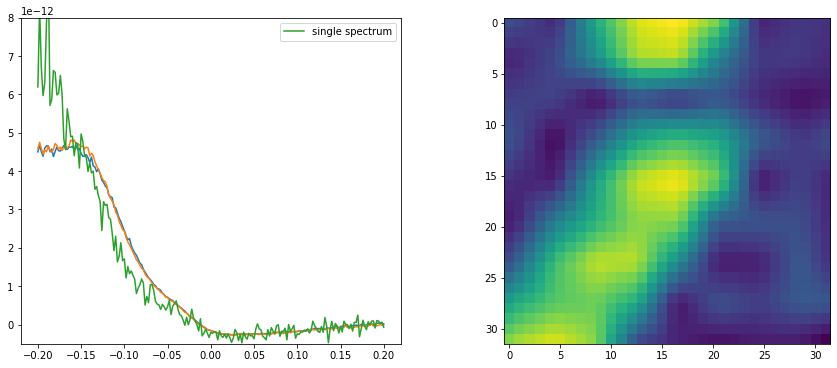

In [ ]:
ii = 8
fig,ax = plt.subplots(1,2,figsize=(15,6))
ax[0].plot(z_axis,GMM_Spectra_Class2_A_mean)
ax[0].plot(z_axis,GMM_Spectra_Class2_B_mean)
ax[0].plot(z_axis,exp_cits[int(round(class2coords[ii,1]/scalefactor)), 
                           int(round(class2coords[ii,0]/scalefactor))], 
           label = 'single spectrum')
ax[0].set_ylim(-0.5E-12, 8E-12)
ax[0].legend(loc = 'upper right')

testcrop = center_crop_pad(topo_f_n_resized, class2coords[ii], 32)
ax[1].imshow(testcrop)


[5,7,8]  # some indices of the *different* spectral features (that were separated by PCA)

# An interesting spectrum, strong peak at -50 mV

[5, 7, 8]

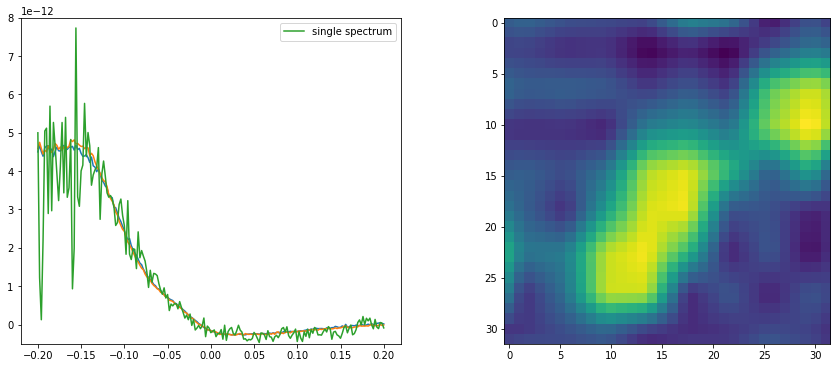

In [ ]:
ii = 13
fig,ax = plt.subplots(1,2,figsize=(15,6))
ax[0].plot(z_axis,GMM_Spectra_Class2_A_mean)
ax[0].plot(z_axis,GMM_Spectra_Class2_B_mean)
ax[0].plot(z_axis,exp_cits[int(round(class2coords[ii,1]/scalefactor)), 
                           int(round(class2coords[ii,0]/scalefactor))], 
           label = 'single spectrum')
ax[0].set_ylim(-0.5E-12, 8E-12)
ax[0].legend(loc = 'upper right')

testcrop = center_crop_pad(topo_f_n_resized, class2coords[ii], 32)
ax[1].imshow(testcrop)


[5,7,8]  # some indices of the *different* spectral features (that were separated by PCA)

# An interesting spectrum for index 14, strong peak at -50 mV

Sanity check: <font color = 'crimson'>Yes</font>, there are spectral features that do indeed look like the one in PCA we see (

## Window size changes for the GMM subclass:


In [ ]:
# playing with:

# 1. size of window
# 2. which image to use (topo image or adatom filtered image)
# 3. number classes

(512, 512)

In [ ]:
crs = 22 # size of image to crop

imgstack_3, com3 = extract_subimages(topo_f_n_resized, class2coords, crs)     # use topo image
# imgstack_3, com3 = extract_subimages(adatoms_C2, class2coords, crs)         # use adatom filtered image




imgstack3 = np.zeros_like(imgstack_3)
for ii in range(imgstack_3.shape[0]):
  imgstack3[ii] = (imgstack_3[ii] - np.min(imgstack_3[ii]))/np.ptp(imgstack_3[ii])
imgstack3.shape

(305, 44, 44)

7

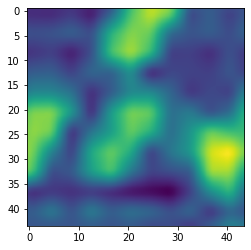

In [ ]:
plt.figure()

ii = np.random.randint(0,imgstack3.shape[0])
plt.imshow(imgstack3[ii], interpolation = 'gaussian')
ii

In [ ]:
d0, d1, d2 = imgstack3.shape
X_vec = imgstack3.reshape(d0, d1*d2)  # flatten for pca
X_vec.shape

(305, 1936)

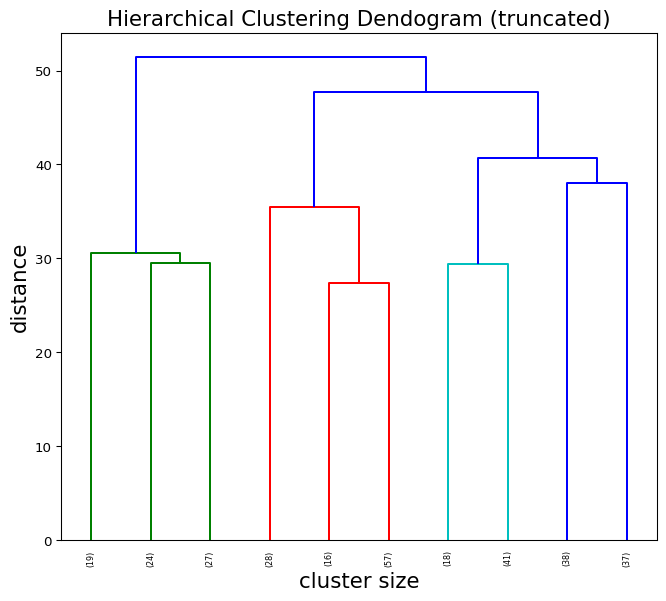

In [ ]:
Z = linkage(X_vec, method='ward')
plt.figure(figsize = (8,7), dpi = 96)
dendrogram(Z, truncate_mode='lastp', p=10, leaf_rotation=90.,leaf_font_size=6.,)
plt.title('Hierarchical Clustering Dendogram (truncated)', fontsize = 16)
plt.xlabel('cluster size', fontsize = 16)
plt.ylabel('distance', fontsize = 16)
plt.show()

(-1.0, 20.0)

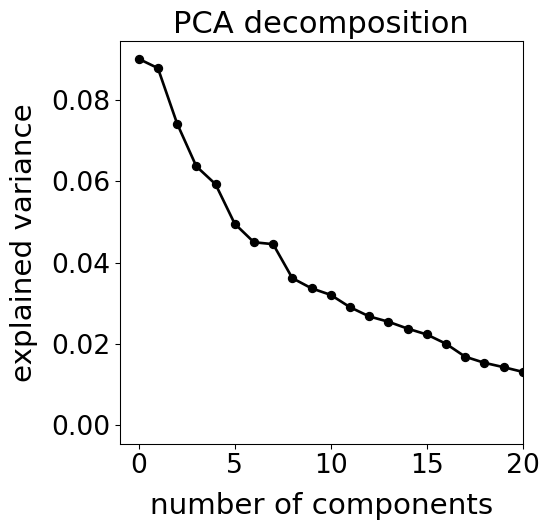

In [ ]:
pca = decomposition.PCA()
pca.fit(X_vec)
plt.figure(1, figsize=(6, 6), dpi = 96)
plt.clf()
plt.axes([.2, .2, .7, .7])
plt.plot(pca.explained_variance_ratio_,'o-', linewidth=2, c = 'black' )
# plt.axis('tight')
plt.xlabel('number of components', fontsize = 22, labelpad = 10)
plt.ylabel('explained variance', fontsize = 22, labelpad = 10)
plt.tick_params(axis='both', labelsize = 20)
plt.title("PCA decomposition", fontsize = 23)
plt.xlim(-1, 20)

In [ ]:
# There doesn't appear to be much variability with this large of a crop window. Let's just do 5 classes as an example

nc = 2
classifier = 'GMM'

if classifier == 'GMM':
    clf = mixture.GaussianMixture(n_components=nc, covariance_type='diag', random_state = 8000).fit(X_vec)
else:
    clf = KMeans(n_clusters=nc).fit(X_vec)

class2subclasses = clf.predict(X_vec) + 1

In [ ]:
class2_1 = np.where(class2subclasses==1)[0]
class2_2 = np.where(class2subclasses==2)[0]
class2_3 = np.where(class2subclasses==3)[0]
class2_4 = np.where(class2subclasses==4)[0]
class2_5 = np.where(class2subclasses==5)[0]
# class2_6 = np.where(classes==6)[0]
# class2_7 = np.where(classes==7)[0]
# class2_8 = np.where(classes==8)[0]

* View classes by their "representative" image (which is an *average* of all images within a class)

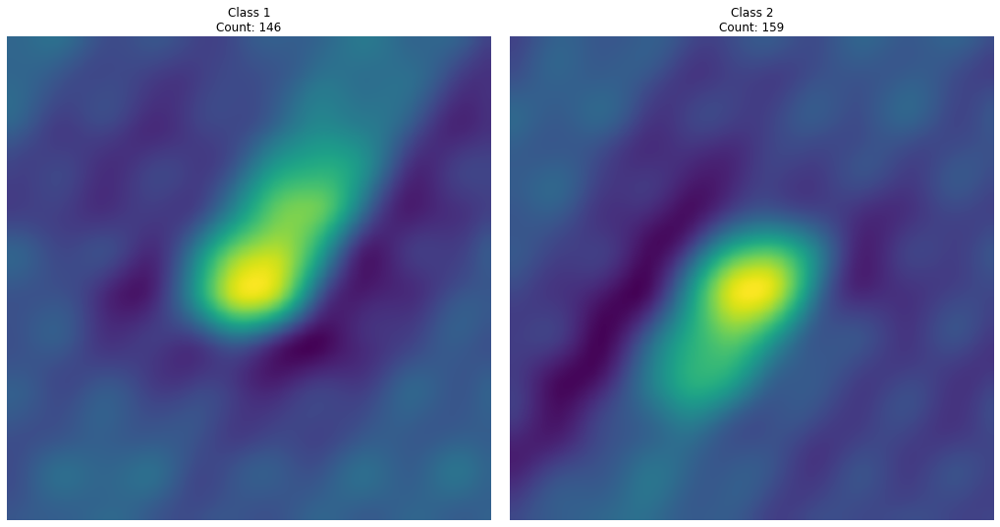

In [ ]:
cla = np.ndarray(shape=(np.amax(class2subclasses), int(crs*2), int(crs*2)))
fig = plt.figure(figsize=(18, 10))

rows = int(np.ceil(float(nc)/5))
cols = int(np.ceil(float(np.amax(class2subclasses))/rows))

gs1 = gridspec.GridSpec(rows, cols)

for i in range(np.amax(class2subclasses)):
    cl = imgstack3[class2subclasses == i + 1]
    cla[i] = np.mean(cl, axis=0)
    cla_en = np.copy(cla[i])
    ax = fig.add_subplot(gs1[i])
    ax.imshow(cla_en, Interpolation = 'Gaussian')
    
    ax.axis('off')
    ax.set_title('Class ' + str(i + 1) + '\nCount: ' + str(len(cl)))

plt.subplots_adjust(hspace=0.06, wspace=0.04)

I'm not sure what to do about this. Doesn't really show anything of interest that I can see.
* Again, does NOT appear to sort these adatoms distinctly
* Unless we use only two classes: does it actually appear to separate "closely packed" vs "sparsely packed" ?

Check the spectra! Get coordinates and then extract spectra at those coordinates

In [ ]:
# check spectra difference between these two and see if they correlate to the spectral difference obtained by PCA separation:

GMMClass2_A = np.zeros((len(class2_1),2))
GMMClass2_B = np.zeros((len(class2_2),2))

for ii in range(len(class2_1)):
  GMMClass2_A[ii,0] = com3[class2_1[ii]][0]
  GMMClass2_A[ii,1] = com3[class2_1[ii]][1]

for ii in range(len(class2_2)):
  GMMClass2_B[ii,0] = com3[class2_2[ii]][0]
  GMMClass2_B[ii,1] = com3[class2_2[ii]][1]

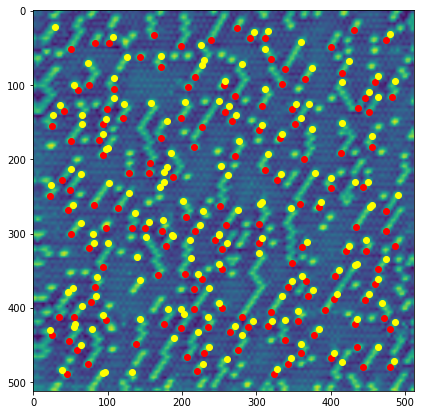

In [ ]:
plt.figure(figsize=(7,7))
plt.imshow(topo_f_n_resized)
plt.scatter(GMMClass2_A[:,1], GMMClass2_A[:,0], c= 'r')
plt.scatter(GMMClass2_B[:,1], GMMClass2_B[:,0], c= 'yellow')

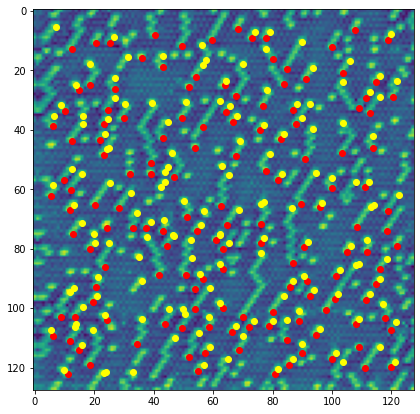

In [ ]:
# Rescale back down to 128x128 (factor of 4):

GMMClass2_A_128 = GMMClass2_A/scalefactor
GMMClass2_B_128 = GMMClass2_B/scalefactor

plt.figure(figsize=(7,7))
plt.imshow(topo_f_n)
plt.scatter(GMMClass2_A_128[:,1], GMMClass2_A_128[:,0], c= 'r')
plt.scatter(GMMClass2_B_128[:,1], GMMClass2_B_128[:,0], c= 'yellow')

In [ ]:
GMM_Spectra_Class2_A = np.zeros((len(GMMClass2_A_128), exp_cits.shape[2]))
GMM_Spectra_Class2_B = np.zeros((len(GMMClass2_B_128), exp_cits.shape[2]))

for ii in range(len(GMM_Spectra_Class2_A)):
  GMM_Spectra_Class2_A[ii] = exp_cits[int(round(GMMClass2_A_128[ii][0])), int(round(GMMClass2_A_128[ii][1]))]
for ii in range(len(GMM_Spectra_Class2_B)):
  GMM_Spectra_Class2_B[ii] = exp_cits[int(round(GMMClass2_B_128[ii][0])), int(round(GMMClass2_B_128[ii][1]))]


(-5e-12, 2e-11)

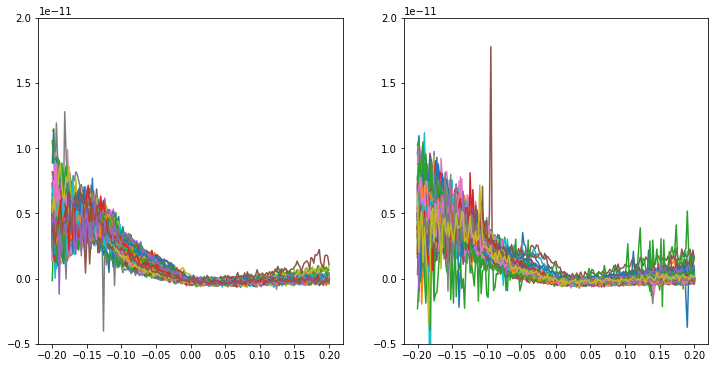

In [ ]:
fig,ax = plt.subplots(1,2,figsize=(12,6))

for ii in range(len(GMM_Spectra_Class2_A)):
  ax[0].plot(z_axis,GMM_Spectra_Class2_A[ii])
ax[0].set_ylim(-0.5E-11, 2E-11)

for ii in range(len(GMM_Spectra_Class2_B)):
  ax[1].plot(z_axis,GMM_Spectra_Class2_B[ii])
ax[1].set_ylim(-0.5E-11, 2E-11)

Average the classes as we have done previously

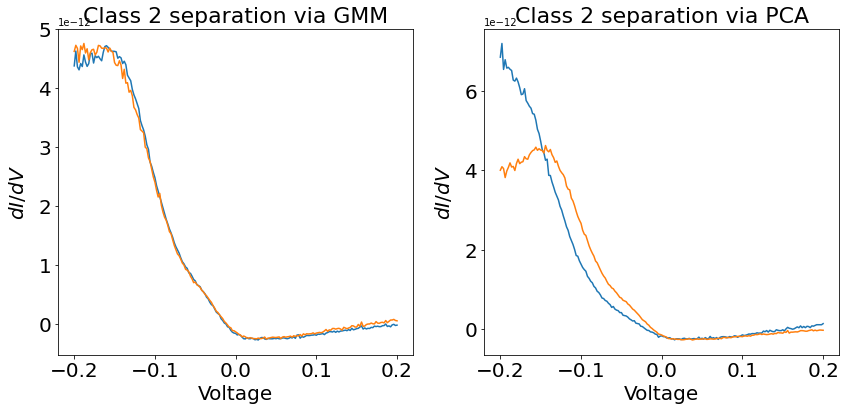

In [ ]:
GMM_Spectra_Class2_A_mean = np.mean(GMM_Spectra_Class2_A,axis=0)
GMM_Spectra_Class2_B_mean = np.mean(GMM_Spectra_Class2_B,axis=0)

# And compare to the means separated by PCA (if we don't have these variables anymore)
Spectra_C2P1_a_PCA_mean = np.mean(Spectra_C2P1_a, axis=0)
Spectra_C2P1_b_PCA_mean = np.mean(Spectra_C2P1_b, axis=0)

fig,ax = plt.subplots(1,2,figsize=(14,6))
ax[0].plot(z_axis,GMM_Spectra_Class2_A_mean)
ax[0].plot(z_axis,GMM_Spectra_Class2_B_mean)

ax[1].plot(z_axis,Spectra_C2P1_a_PCA_mean)
ax[1].plot(z_axis,Spectra_C2P1_b_PCA_mean)

ax[0].set_xlabel("Voltage", fontsize = 20)
ax[1].set_xlabel("Voltage", fontsize = 20)
ax[0].set_ylabel("$dI/dV$", fontsize = 20, labelpad = 10)
ax[1].set_ylabel("$dI/dV$", fontsize = 20, labelpad = 10)

ax[0].set_title('Class 2 separation via GMM', fontsize = 22)
ax[1].set_title('Class 2 separation via PCA', fontsize = 22)

ax[0].tick_params(labelsize = 20)
ax[1].tick_params(labelsize = 20)

# Obsolete methods (not working as well as they should)

## Using Gaussian Model Mixturing to classify classes (<font color = 'crimson'>unsupervised learning</font>)

We can try GMM on this data now to see how that performs, given the fact that we search for **5 classes**

In [ ]:
from sklearn.decomposition import PCA

#classifying blobs/atoms
from sklearn.cluster import KMeans
from scipy.cluster.hierarchy import linkage, fcluster, dendrogram
from sklearn import mixture
from sklearn import decomposition

In [ ]:
d0, d1, d2 = imgstack.shape
X_vec = imgstack.reshape(d0, d1*d2)  # flatten for pca
X_vec.shape

(825, 484)

(-1, 20)

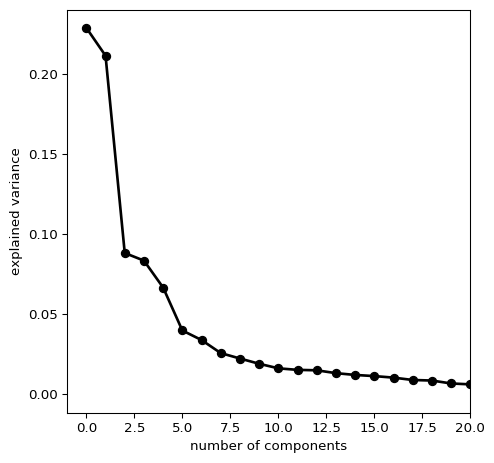

In [ ]:
pca = decomposition.PCA()
pca.fit(X_vec)
plt.figure(1, figsize=(6, 6), dpi = 96)
plt.clf()
plt.axes([.2, .2, .7, .7])
plt.plot(pca.explained_variance_ratio_,'o-', linewidth=2, c = 'black' )
plt.axis('tight')
plt.xlabel('number of components')
plt.ylabel('explained variance')
plt.xlim(-1, 20)

* We know we want 5 classes (which the PCA abundance map seems to show also), so that will be our input
* The problem, however, as we will see, is that there are certain rotations of the same configuration of atoms that we consider to be the same class. * Consider for example the two cropped subimages below. We would classify these as the **same class**, however, the GMM is not as clever

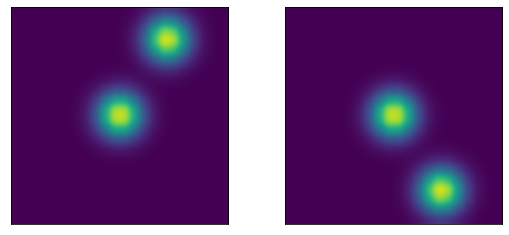

In [ ]:
testamp, testsize, cropsize = 1, 5, 22 
class2ex_1 = gauss2d_atom(cropsize/2, cropsize/2, amp = testamp, sigma = testsize, xlen = cropsize, ylen=cropsize, numpix = cropsize) +\
             gauss2d_atom(16, 3, amp = testamp, sigma = testsize, xlen = cropsize, ylen=cropsize, numpix = cropsize)
class2ex_2 = gauss2d_atom(cropsize/2, cropsize/2, amp = testamp, sigma = testsize, xlen = cropsize, ylen=cropsize, numpix = cropsize) +\
             gauss2d_atom(16, 19, amp = testamp, sigma = testsize, xlen = cropsize, ylen=cropsize, numpix = cropsize)
f,a = plt.subplots(1,2,figsize=(9,4))
a[0].imshow(class2ex_1, interpolation = 'gaussian')
a[1].imshow(class2ex_2, interpolation = 'gaussian')
plt.setp([a[0],a[1]],xticks=[],yticks=[]);

* So, the above should be classified together as one class ("end of chain")
* Let's show how GMM works for this and all classes:

In [ ]:
nc = 5
classifier = 'GMM'

if classifier == 'GMM':
    clf = mixture.GaussianMixture(n_components=nc, covariance_type='diag', random_state = 8000).fit(X_vec)
else:
    clf = KMeans(n_clusters=nc).fit(X_vec)

classes = clf.predict(X_vec) + 1

In [ ]:
class1 = np.where(classes==1)[0]
class2 = np.where(classes==2)[0]
class3 = np.where(classes==3)[0]
class4 = np.where(classes==4)[0]
class5 = np.where(classes==5)[0]

In [ ]:
cla = np.ndarray(shape=(np.amax(classes), int(crs*2), int(crs*2)))
fig = plt.figure(figsize=(18, 10))

rows = int(np.ceil(float(nc)/5))
cols = int(np.ceil(float(np.amax(classes))/rows))

gs1 = gridspec.GridSpec(rows, cols)

for i in range(np.amax(classes)):
    cl = imgstack[classes == i + 1]
    cla[i] = np.mean(cl, axis=0)
    cla_en = np.copy(cla[i])
    ax = fig.add_subplot(gs1[i])
    ax.imshow(cla_en, Interpolation = 'Gaussian')
    
    ax.axis('off')
    ax.set_title('Class ' + str(i + 1) + '\nCount: ' + str(len(cl)))

plt.subplots_adjust(hspace=0.06, wspace=0.04)

ValueError: ignored

<Figure size 1296x720 with 0 Axes>

* What we want to be classified doesn't translate well into what actually occurs via GMM
* This could be due to a number of reasons, such as 
  * the neural network atom finder - it thinks several atoms are where only one should be (hence the difference in contrast in the classes)
  * There are a fewer amount of the trimer configurations, for example, (only about 6 in this dataset), so that doesn't even make it to the "top 5" list.
  * Single, isolated adatoms are not a class here either.

# Additional tests for paper
1. Downsample experimental data to see how poor of quality the NN can work with
2. PCA on the individual classes after classified (class 1 and 2 seem to have a bit of variability, maybe there is further classification we haven't thought of)
3. ???